## Import Necessary Libraries

In [1]:
import matplotlib.pyplot as plt 
from datetime import datetime
import pandas as pd
import numpy as np
import pygad
import numpy
import glob
import wntr
import os

In [2]:
plt.rcParams['figure.figsize'] = (12,8)

In [3]:
import warnings
import shutil
warnings.filterwarnings('ignore')

In [5]:
# wipe all solutions in the directory

try:
    shutil.rmtree('../leak_location_results/add_leak_node2/each-node-optimization-results-csvs-new/')
    shutil.rmtree('../leak_location_results/add_leak_node2/each-node-optimization-plots-new/')
    shutil.rmtree('../leak_location_results/add_leak_node2/merged_results-new/')
    print('Folders Deleted')
except FileNotFoundError as e:
    print(e)

# recreate deleted folders
os.makedirs('../leak_location_results/add_leak_node2/each-node-optimization-results-csvs-new')
os.makedirs('../leak_location_results/add_leak_node2/each-node-optimization-plots-new')
os.makedirs('../leak_location_results/add_leak_node2/merged_results-new')


# Uncomment and run the above code if you want to re-optimze this project otherwise, go ahead.
# Recommendation: Uncomment and run the code if you want re-optimize.

Folders Deleted


## Read Inp File

In [6]:
class Config:
    num_generations =100 #Number of generations.
    num_parents_mating = 1 # Number of solutions to be selected as parents in the mating pool.
    sol_per_pop = 20 # Number of solutions in the population.
    num_genes = 1 #len(function_inputs) --> this can be an array
    init_range_low = 0
    init_range_high = 1
    parent_selection_type = "sss" # Type of parent selection.
    keep_parents = -1 # Number of parents to keep in the next population. -1 means keep all parents and 0 means keep nothing.
    crossover_type = "single_point" # Type of the crossover operator. 
    mutation_type = "random" # Type of the mutation operator.
    mutation_num_genes=1 # Type of the mutation operator.
    last_fitness = 0
    
    inp_file_path = r"../data/Real_Synthetic_Net.inp" 
    function_inputs = None
    desired_output = None

In [7]:
class WaterLeakModel(Config):
    
    def __init__(self, node:str):
        ''' 
            node: node/junction ID in the network
        '''
        
        # Check if node is junction_name 
        wn = wntr.network.WaterNetworkModel(self.inp_file_path)
        assert wn.junction_name_list.count(node) == 1, "Node not found in the network"
        self.node_index = wn.junction_name_list.index(node)
        
        self.node = node
        
        #Setup all neccessary folders we need to work with, i.e. create them if they don't exist
        if not os.path.exists('../leak_location_results/add_leak_node2/each-node-optimization-results-csvs-new/solutions_for_'+self.node):
            os.mkdir('../leak_location_results/add_leak_node2/each-node-optimization-results-csvs-new/solutions_for_'+self.node)
            
        if not os.path.exists('../leak_location_results/add_leak_node2/each-node-optimization-plots-new/plots_for_'+self.node):
            os.mkdir('../leak_location_results/add_leak_node2/each-node-optimization-plots-new/plots_for_'+self.node)


        if not os.path.exists('../leak_location_results/add_leak_node2/merged_results-new'):
            os.mkdir('../leak_location_results/add_leak_node2/merged_results-new')
            
        self.temp_dir = '../leak_location_results/add_leak_node2/each-node-optimization-results-csvs-new/solutions_for_'+self.node
        self.plots_dir = '../leak_location_results/add_leak_node2/each-node-optimization-plots-new/plots_for_'+self.node
        self.merged_result = '../leak_location_results/add_leak_node2/merged_results-new'

    def simulate(self, wn, plot_graph=True):
        """
        If plot_graph is set to true, a graph of the network is plotted after simulation
        """
        # Plot pressure after add leak to node
            
        sim = wntr.sim.WNTRSimulator(wn)
        results = sim.run_sim()
        
        if plot_graph:
            pressure = results.node['pressure']
            pressure_at_N6 = pressure.loc[:,wn.junction_name_list[self.node_index]]
            wntr.graphics.plot_network(wn, node_attribute=pressure.any(), node_size=150, title='Pressure at 0 hours')
        
        return results
    
    def change_discharge_coefficient(self, wn, emitter_value):
        """
        This function changes the emitter coefficient for selected node in the network, and create a 
        structured representation of our data, a csv.
        
        parameters
        ----------
        wn: wntr network object
        emitter_value: the emitter coefficient value
        """
        
        if emitter_value>1:
            emitter_value=emitter_value%1
            
        # Change emitter coefficient
        node = wn.get_node(str(self.node))
        node.add_leak(wn, area=0.00015, start_time=0, end_time=1, discharge_coeff=emitter_value)
        return self.simulate(wn, plot_graph=False)
    
    def export_results(self, solutions:list, name:str, path=None):
        """
        Concatenates all solutions generated and exports as a single csv file
        
        parameters
        ----------
        solution: a list of all paths to the solutions csv files
        path: path where concatenated solution will be exported to
        name: name to be assigned to exported file
        """
        
        if not os.path.exists(path):
            os.mkdir(path)
        
        temp = pd.DataFrame()
        for i in solutions:
            data = pd.read_csv(i)
            if i == 0:
                temp = data
            else:
                temp = pd.concat([temp, data])
        name+=".csv"
        try:
            temp.to_csv(os.path.join(path,name),index=False)
            print(f'File Exported Successfully to path: {os.path.join(path, name)}')
        except Exception as e:
            print(e)
            
    def run(self, leak_area=0.00015, start_time=0, end_time=1, discharge_coeff=.5, function_inputs=0.5, plot_graph=True):
        """
        Adds a leak to node passed to WaterLeakModel() object and simulates
        
        parameters
        ----------
        leak_area: area of the leak
        start_time: time in seconds to start the leak
        end_time: time in seconds to end the leak
        discharge_coeff: Leak discharge coefficient; Takes on values between 0 and 1.
        function_inputs = inputs for optimization, can be array of numbers
        plot_graph: If plot_graph is set to true, a graph of the network is plotted after simulation
        """
        
        # Add leak and simulate
        wn = wntr.network.WaterNetworkModel(self.inp_file_path)
        node = wn.get_node(self.node)
        node.add_leak(wn, area=leak_area, start_time=start_time, end_time=end_time, discharge_coeff=.5)
        self.simulate(wn, plot_graph=plot_graph)

        self.function_inputs = function_inputs
        self.desired_output = node.head - node.elevation
            

In [8]:
# Instantiate the pygad optimization class
water_model = WaterLeakModel(node='N2')

In [9]:
def fitness_function(solution, solution_idx):
    global current_node
    
    wn = wntr.network.WaterNetworkModel(water_model.inp_file_path)
    
    emitter_coeff = solution[0]*water_model.function_inputs

    results = water_model.change_discharge_coefficient(wn, emitter_value=abs(emitter_coeff)) #change emitter coefficient

    pressure = results.node['pressure']
    pressure_output = pressure.loc[:,water_model.node]

    demands=results.node['demand']
    demand_output = demands.loc[:,water_model.node]
    
    fitness = 1.0 / (np.abs(pressure_output - water_model.desired_output) + 0.000001)

    # Structure and export the output of the fitness
    data = pd.DataFrame(columns=['EMITTER_COEFFICIENT_SOLUTION','PRESSURE_OUTPUT','OUTPUT_DEMAND','FITNESS'])
    
    emitter_coeff=abs(solution[0]) 
    
    if emitter_coeff>1:
        emitter_coeff=emitter_coeff%1

    data = data.append({'EMITTER_COEFFICIENT_SOLUTION':abs(emitter_coeff),\
                        'PRESSURE_OUTPUT':list(pressure_output)[0],'FITNESS':list(fitness)[0],\
                        'OUTPUT_DEMAND':(list(demand_output) [0]*1000),\
                        'NODE': current_node},ignore_index=True)
    
    data.to_csv(f"{water_model.temp_dir}/FITNESS_SOLUTION_{current_node}_{str(abs(solution[0]))}.csv",index=False) 

    print('=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========')
    print ('======|', abs(round(solution[0],3)),'|===========|',\
           list(round(pressure_output,3))[0],\
           '|==================|',list(round(fitness, 3))[0],'|==========|',\
           current_node,'|==========')
    
    print('***********************************'*2)

    return list(fitness)[0]

In [10]:
#################### Create a Callback Function ########################
last_fitness = 0
def callback_generation(ga_instance): # This function prints algorithm progress
    global last_fitness
    print("Generation = {generation}".format(generation=ga_instance.generations_completed)) 
    print("Fitness = {fitness}".format(fitness=ga_instance.best_solution()[1]))
    print("Change = {change}".format(change=ga_instance.best_solution()[1] - last_fitness)) 

    data =pd.DataFrame(columns=['GENERATION','FITNESS'])
    data =data.append({'GENERATION':ga_instance.generations_completed,'FITNESS': ga_instance.best_solution ()[1],'NODE':current_node},ignore_index=True)
    data.to_csv(f"{water_model.temp_dir}/GENERATION_{current_node}_{str(ga_instance.generations_completed)}.csv",index=False) 
    last_fitness = ga_instance.best_solution()[1]

In [11]:
wn = wntr.network.WaterNetworkModel(water_model.inp_file_path)
model_nodes = wn.junction_name_list

In [12]:
model_nodes

['N1',
 'N5',
 'N10',
 'N7',
 'N2',
 'N6',
 'N3',
 'N8',
 'N13',
 'N9',
 'N14',
 'N4',
 'N11',
 'N12',
 'N15',
 'N16']

In [13]:
choosen_nodes_for_leak = ['N2'] #nodes we want to add leak

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 9.357 |==================| 74.42 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 9.363 |==================| 126.226 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 9.361 |==================| 103.902 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 9.37 |==================| 940.603 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 9.369 |==================| 794.952 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 9.368 |==================| 330.641 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 9.362 |==================| 110.746 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 9.358 |==================| 81.331 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 9.36 |==================| 90.981 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 9.36 |==================| 96.785 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 9.369 |==================| 608.775 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 9.369 |==================| 755.757 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 9.361 |==================| 107.552 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 9.36 |==================| 94.89 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 9.362 |==================| 120.432 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 9.364 |==================| 146.708 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 9.365 |==================| 191.543 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 9.359 |==================| 85.604 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 9.356 |==================| 70.213 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 9.363 |==================| 125.482 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 9.36 |==================| 90.745 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 9.364 |==================| 157.081 |==========| N1 |==========
**********************************************************************
Change = 3114.257858785993
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 9.36 |==================| 92.043 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 9.365 |==================| 191.543 |==========| N1 |==========
************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 9.358 |==================| 77.976 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 9.369 |==================| 896.028 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 9.364 |==================| 145.891 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 9.37 |==================| 4054.861 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 9.361 |==================| 107.275 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 9.362 |==================| 116.491 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 9.359 |==================| 82.66 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 9.357 |==================| 71.043 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 9.359 |==================| 83.237 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 9.37 |==================| 1010.057 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 9.365 |==================| 172.844 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 9.361 |==================| 107.275 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 9.368 |==================| 390.956 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 9.356 |==================| 69.46 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 9.363 |==================| 127.505 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 9.36 |==================| 93.795 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 9.37 |==================| 1076.512 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 9.356 |==================| 67.001 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 9.36 |==================| 95.638 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 9.36 |==================| 91.821 |==========| N1 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 9.359 |==================| 87.606 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 9.356 |==================| 68.371 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 9.368 |==================| 339.3 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 9.37 |==================| 1076.512 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 9.363 |==================| 139.519 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 9.361 |==================| 101.362 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 9.369 |==================| 520.317 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 9.366 |==================| 235.57 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 9.359 |==================| 87.66 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 9.36 |==================| 97.329 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 9.363 |==================| 134.644 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 9.367 |==================| 281.232 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 9.356 |==================| 68.927 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 9.366 |==================| 207.785 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 9.362 |==================| 112.009 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 9.359 |==================| 87.66 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 9.367 |==================| 283.794 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 9.362 |==================| 118.187 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 9.361 |==================| 100.713 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 9.357 |==================| 75.473 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 9.358 |==================| 78.526 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 9.355 |==================| 64.236 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 9.362 |==================| 116.355 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 9.367 |==================| 283.794 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 9.366 |==================| 241.463 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 9.364 |==================| 156.873 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 9.363 |==================| 135.593 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 9.365 |==================| 166.154 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 9.365 |==================| 168.339 |==========| N1 |==========
**********************************************************************
Generation = 7
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 9.366 |==================| 211.22 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 9.363 |==================| 123.481 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 9.365 |==================| 172.008 |==========| N1 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 9.369 |==================| 474.336 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 9.366 |==================| 212.201 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 9.365 |==================| 172.296 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 9.364 |==================| 147.622 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 9.356 |==================| 70.297 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 9.362 |==================| 120.602 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 9.362 |==================| 112.404 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 9.36 |==================| 93.287 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 9.368 |==================| 331.848 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 9.361 |==================| 100.503 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 9.365 |==================| 171.713 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 9.367 |==================| 285.227 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 9.36 |==================| 97.705 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 9.364 |==================| 141.79 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 9.36 |==================| 98.444 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 9.358 |==================| 81.814 |==========| N1 |==========
****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 9.367 |==================| 319.157 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 9.365 |==================| 173.878 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 9.361 |==================| 98.967 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 9.37 |==================| 1062.695 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 9.368 |==================| 414.773 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 9.367 |==================| 304.982 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 9.362 |==================| 118.782 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 9.366 |==================| 204.942 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 9.364 |==================| 148.808 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 9.357 |==================| 75.028 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 9.361 |==================| 100.206 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 9.368 |==================| 414.773 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 9.356 |==================| 70.03 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 9.364 |==================| 152.628 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 9.361 |==================| 108.958 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 9.367 |==================| 266.671 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 9.363 |==================| 133.554 |==========| N1 |==========
**********************************************************************
Fitness = 4054.861198745447
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 9.367 |==================| 245.351 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 9.357 |==================| 74.432 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 9.369 |==================| 487.846 |==========| N1 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 9.36 |==================| 98.664 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 9.357 |==================| 76.156 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 9.357 |==================| 71.905 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 9.363 |==================| 129.533 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 9.357 |==================| 71.505 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 9.356 |==================| 66.958 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 9.362 |==================| 117.441 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 9.358 |==================| 79.519 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 9.363 |==================| 134.838 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 9.356 |==================| 66.868 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 9.36 |==================| 91.013 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 9.363 |==================| 125.464 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 9.367 |==================| 253.515 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 9.362 |==================| 121.433 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 9.364 |==================| 144.244 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 9.363 |==================| 134.838 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 9.355 |==================| 65.116 |==========| N1 |==========
**********************************************************************
Generation = 12
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 9.356 |==================| 68.494 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 9.359 |==================| 85.261 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 9.364 |==================| 151.432 |==========| N1 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 9.363 |==================| 123.526 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 9.371 |==================| 10253.428 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 9.365 |==================| 169.28 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 9.355 |==================| 65.116 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 9.364 |==================| 161.815 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 9.36 |==================| 93.839 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 9.361 |==================| 104.851 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 9.363 |==================| 123.526 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 9.37 |==================| 1339.987 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 9.368 |==================| 388.871 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 9.362 |==================| 119.577 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 9.356 |==================| 66.821 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 9.362 |==================| 115.508 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 9.363 |==================| 131.785 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 9.364 |==================| 157.176 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 9.37 |==================| 1339.987 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 9.359 |==================| 84.037 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 9.365 |==================| 184.833 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 9.359 |==================| 89.979 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 9.369 |==================| 774.337 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 9.361 |==================| 105.94 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 9.363 |==================| 128.06 |==========| N1 |==========
**********************************************************************
Fitness = 10253.427504076768
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 9.365 |==================| 169.189 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 9.365 |==================| 194.88 |==========| N1 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 9.362 |==================| 114.722 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 9.366 |==================| 208.612 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 9.362 |==================| 115.561 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 9.37 |==================| 977.595 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 9.355 |==================| 65.847 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 9.358 |==================| 78.521 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 9.366 |==================| 214.833 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 9.363 |==================| 137.316 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 9.367 |==================| 269.721 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 9.359 |==================| 82.732 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 9.369 |==================| 785.079 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 9.355 |==================| 65.847 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 9.363 |==================| 136.552 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 9.357 |==================| 74.19 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 9.367 |==================| 269.721 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 9.359 |==================| 82.732 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 9.358 |==================| 78.714 |==========| N1 |==========
**********************************************************************
Generation = 16
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 9.359 |==================| 89.815 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 9.362 |==================| 112.469 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 9.36 |==================| 90.101 |==========| N1 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 9.371 |==================| 15382.194 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 9.362 |==================| 116.774 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 9.364 |==================| 151.19 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 9.358 |==================| 78.714 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 9.364 |==================| 162.095 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 9.36 |==================| 96.603 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 9.364 |==================| 145.046 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 9.367 |==================| 258.932 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 9.369 |==================| 844.089 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 9.365 |==================| 179.528 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 9.355 |==================| 64.655 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 9.366 |==================| 200.779 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 9.362 |==================| 120.385 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 9.369 |==================| 734.139 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 9.358 |==================| 79.594 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 9.369 |==================| 844.089 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 9.366 |==================| 217.586 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 9.361 |==================| 101.515 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 9.37 |==================| 2963.178 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 9.362 |==================| 114.976 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 9.366 |==================| 241.51 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 9.368 |==================| 342.058 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 9.361 |==================| 101.866 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 9.359 |==================| 86.471 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 9.367 |==================| 281.582 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 9.361 |==================| 107.164 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 9.37 |==================| 1096.615 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 9.368 |==================| 438.825 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 9.362 |==================| 118.477 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 9.362 |==================| 110.44 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 9.36 |==================| 95.547 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 9.36 |==================| 90.281 |==========| N1 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 9.368 |==================| 324.439 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 9.359 |==================| 89.439 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 9.364 |==================| 157.917 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 9.36 |==================| 97.844 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 9.362 |==================| 122.764 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 9.356 |==================| 68.452 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 9.368 |==================| 469.795 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 9.357 |==================| 70.966 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 9.363 |==================| 133.484 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 9.358 |==================| 76.289 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 9.37 |==================| 3264.998 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 9.365 |==================| 168.584 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 9.367 |==================| 244.685 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 9.356 |==================| 69.47 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 9.356 |==================| 67.354 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 9.359 |==================| 86.007 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.004 |===========| 9.355 |==================| 63.739 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 9.365 |==================| 182.298 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 9.37 |==================| 1004.27 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 9.367 |==================| 244.685 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 9.367 |==================| 266.832 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 9.363 |==================| 135.209 |==========| N1 |==========
**********************************************************************
Generation = 21
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 9.369 |==================| 754.121 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 9.356 |==================| 66.336 |==========| N1 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 9.364 |==================| 163.56 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 9.365 |==================| 194.522 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 9.36 |==================| 92.458 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 9.361 |==================| 101.908 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 9.364 |==================| 160.417 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 9.36 |==================| 90.249 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 9.357 |==================| 71.349 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 9.371 |==================| 35549.14 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 9.365 |==================| 169.287 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 9.37 |==================| 1115.195 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 9.37 |==================| 1484.373 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 9.368 |==================| 387.68 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 9.369 |==================| 796.438 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 9.365 |==================| 189.632 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 9.368 |==================| 336.67 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 9.356 |==================| 70.166 |==========| N1 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 9.366 |==================| 212.143 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 9.362 |==================| 118.052 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 9.363 |==================| 123.714 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 9.369 |==================| 796.438 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 9.366 |==================| 202.414 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 9.355 |==================| 64.814 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 9.361 |==================| 100.434 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 9.365 |==================| 170.553 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 9.361 |==================| 100.975 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 9.36 |==================| 97.278 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 9.358 |==================| 77.365 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 9.362 |==================| 120.445 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 9.362 |==================| 123.195 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 9.355 |==================| 64.812 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 9.359 |==================| 85.223 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 9.367 |==================| 310.629 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 9.366 |==================| 213.558 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 9.37 |==================| 2083.465 |==========| N1 |==========
**********************************************************************
Fitness = 35549.14023165436
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 9.368 |==================| 353.771 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 9.371 |==================| 16215.478 |==========| N1 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 9.37 |==================| 1936.651 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 9.355 |==================| 65.096 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 9.36 |==================| 94.732 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 9.366 |==================| 213.558 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 9.361 |==================| 100.553 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 9.357 |==================| 71.467 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 9.361 |==================| 105.112 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 9.365 |==================| 176.825 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 9.358 |==================| 80.96 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 9.365 |==================| 181.526 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 9.363 |==================| 129.607 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 9.356 |==================| 66.648 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 9.36 |==================| 98.026 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 9.36 |==================| 90.683 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 9.359 |==================| 87.503 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 9.358 |==================| 80.96 |==========| N1 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 9.369 |==================| 585.187 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 9.365 |==================| 171.533 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 9.367 |==================| 273.954 |==========| N1 |==========
**********************************************************************
Generation = 26
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 9.366 |==================| 230.271 |==========| N1 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 9.361 |==================| 104.259 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 9.364 |==================| 145.65 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 9.357 |==================| 74.541 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 9.359 |==================| 83.581 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 9.358 |==================| 82.5 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 9.363 |==================| 139.351 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 9.366 |==================| 229.948 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 9.368 |==================| 382.976 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 9.355 |==================| 64.432 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 9.365 |==================| 190.234 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 9.357 |==================| 74.141 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 9.358 |==================| 80.937 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 9.362 |==================| 112.788 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 9.363 |==================| 124.539 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 9.37 |==================| 1812.813 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 9.365 |==================| 191.464 |==========| N1 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 9.359 |==================| 83.271 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 9.36 |==================| 97.548 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 9.362 |==================| 116.981 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 9.357 |==================| 74.94 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 9.362 |==================| 115.026 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 9.367 |==================| 320.638 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 9.361 |==================| 103.279 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 9.364 |==================| 161.701 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 9.361 |==================| 101.875 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 9.356 |==================| 67.22 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 9.369 |==================| 712.712 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 9.367 |==================| 253.658 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 9.361 |==================| 103.27 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 9.369 |==================| 503.28 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 9.366 |==================| 213.182 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 9.362 |==================| 118.759 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 9.36 |==================| 90.941 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 9.365 |==================| 178.925 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 9.359 |==================| 87.674 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 9.364 |==================| 158.702 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 9.363 |==================| 129.391 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 9.36 |==================| 91.211 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 9.356 |==================| 68.545 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 9.36 |==================| 90.941 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 9.368 |==================| 328.217 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 9.367 |==================| 276.267 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 9.363 |==================| 138.887 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 9.364 |==================| 163.581 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 9.357 |==================| 72.658 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 9.37 |==================| 1121.086 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 9.36 |==================| 95.28 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 9.361 |==================| 101.114 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 9.364 |==================| 141.004 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 9.362 |==================| 120.897 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 9.356 |==================| 69.937 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 9.357 |==================| 72.658 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 9.361 |==================| 99.619 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 9.361 |==================| 100.971 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 9.36 |==================| 98.212 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 9.366 |==================| 222.463 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 9.365 |==================| 194.367 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 9.356 |==================| 68.963 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 9.365 |==================| 164.665 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 9.365 |==================| 171.351 |==========| N1 |==========
**********************************************************************
===

======| 0.791 |===========| 9.358 |==================| 80.981 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 9.361 |==================| 106.224 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 9.358 |==================| 82.556 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 9.365 |==================| 163.685 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 9.356 |==================| 68.992 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 9.355 |==================| 65.606 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 9.359 |==================| 83.76 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 9.364 |==================| 156.161 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 9.358 |==================| 81.27 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 9.359 |==================| 84.713 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 9.362 |==================| 120.906 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 9.357 |==================| 74.9 |==========| N1 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 9.365 |==================| 180.734 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 9.367 |==================| 315.288 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 9.359 |==================| 83.299 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 9.364 |==================| 143.531 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 9.365 |==================| 166.843 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 9.368 |==================| 414.054 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 9.362 |==================| 120.762 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 9.357 |==================| 72.852 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 9.359 |==================| 85.435 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 9.365 |==================| 192.858 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 9.361 |==================| 99.24 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 9.365 |==================| 166.843 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 9.369 |==================| 737.228 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 9.363 |==================| 127.19 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 9.37 |==================| 1894.639 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 9.365 |==================| 173.669 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 9.362 |==================| 121.312 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 9.367 |==================| 315.727 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 9.369 |==================| 599.255 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 9.356 |==================| 66.712 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 9.36 |==================| 90.797 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 9.363 |==================| 137.242 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 9.365 |==================| 168.591 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 9.358 |==================| 82.175 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 9.369 |==================| 523.749 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 9.37 |==================| 908.194 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 9.36 |==================| 91.844 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 9.358 |==================| 76.342 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 9.356 |==================| 68.844 |==========| N1 |==========
**********************************************************************
Fitness = 35549.14023165436
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 9.365 |==================| 164.9 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 9.364 |==================| 161.373 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 9.357 |==================| 70.906 |==========| N1 |==========
************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 9.363 |==================| 127.37 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 9.364 |==================| 142.149 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 9.368 |==================| 421.691 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 9.365 |==================| 184.226 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 9.37 |==================| 1759.833 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 9.369 |==================| 780.543 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 9.359 |==================| 87.282 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 9.359 |==================| 87.941 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 9.358 |==================| 79.046 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 9.368 |==================| 324.745 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 9.368 |==================| 433.237 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 9.361 |==================| 105.939 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 9.366 |==================| 208.031 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 9.37 |==================| 899.053 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 9.356 |==================| 66.927 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 9.358 |==================| 79.046 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 9.368 |==================| 389.637 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 9.36 |==================| 91.989 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 9.36 |==================| 90.947 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 9.359 |==================| 88.64 |==========| N1 |==========
**********************************************************************
Genera

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 9.368 |==================| 457.005 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 9.366 |==================| 232.3 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 9.369 |==================| 489.089 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 9.36 |==================| 96.155 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 9.362 |==================| 110.588 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 9.368 |==================| 344.509 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 9.355 |==================| 65.698 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 9.368 |==================| 457.005 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 9.368 |==================| 455.774 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 9.359 |==================| 83.136 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 9.36 |==================| 92.542 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 9.356 |==================| 67.457 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 9.357 |==================| 73.156 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 9.361 |==================| 108.105 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 9.358 |==================| 80.665 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 9.358 |==================| 81.604 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 9.364 |==================| 147.074 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 9.369 |==================| 501.007 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 9.356 |==================| 69.244 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 9.363 |==================| 132.382 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 9.358 |==================| 79.653 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 9.363 |==================| 128.717 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 9.356 |==================| 70.839 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 9.37 |==================| 981.682 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 9.365 |==================| 186.065 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 9.363 |==================| 125.248 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 9.362 |==================| 114.057 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 9.358 |==================| 79.653 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 9.364 |==================| 157.571 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 9.365 |==================| 191.356 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 9.364 |==================| 158.727 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 9.365 |==================| 190.627 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 9.357 |==================| 73.603 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 9.361 |==================| 102.959 |==========| N1 |==========
**********************************************************************
Fitness = 79603.9496102319
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 9.37 |==================| 1807.053 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 9.357 |==================| 71.257 |==========| N1 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 9.359 |==================| 89.299 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 9.366 |==================| 198.822 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 9.357 |==================| 72.077 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 9.367 |==================| 252.366 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 9.363 |==================| 131.045 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 9.356 |==================| 67.622 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 9.364 |==================| 143.866 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 9.37 |==================| 7181.517 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 9.363 |==================| 128.248 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 9.365 |==================| 193.107 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 9.361 |==================| 108.525 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 9.359 |==================| 86.188 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 9.363 |==================| 125.62 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 9.364 |==================| 143.993 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 9.367 |==================| 313.001 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 9.363 |==================| 128.248 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 9.363 |==================| 134.314 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 9.365 |==================| 181.245 |==========| N1 |==========
**********************************************************************
Generation = 42
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 9.356 |==================| 66.261 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 9.364 |==================| 160.912 |==========| N1 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 9.358 |==================| 80.256 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 9.358 |==================| 80.077 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 9.359 |==================| 83.95 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 9.36 |==================| 94.868 |==========| N1 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 9.37 |==================| 2167.445 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 9.357 |==================| 71.253 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 9.362 |==================| 118.614 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 9.364 |==================| 162.048 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 9.363 |==================| 127.813 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 9.368 |==================| 383.141 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 9.358 |==================| 78.289 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 9.364 |==================| 148.576 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 9.37 |==================| 1389.712 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 9.369 |==================| 523.356 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 9.362 |==================| 114.191 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 9.363 |==================| 127.813 |==========| N1 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 9.356 |==================| 68.32 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 9.362 |==================| 111.157 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 9.361 |==================| 107.062 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 9.37 |==================| 1389.712 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 9.362 |==================| 121.332 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 9.369 |==================| 581.592 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 9.367 |==================| 306.894 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 9.368 |==================| 406.752 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 9.356 |==================| 69.791 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 9.366 |==================| 231.709 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 9.362 |==================| 116.212 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 9.366 |==================| 206.581 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 9.361 |==================| 99.68 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 9.369 |==================| 504.549 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 9.361 |==================| 108.659 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 9.368 |==================| 456.986 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 9.356 |==================| 70.252 |==========| N1 |==========
**********************************************************************
Fitness = 79603.9496102319
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 9.37 |==================| 8428.493 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 9.363 |==================| 136.426 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 9.361 |==================| 99.68 |==========| N1 |==========
************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 9.357 |==================| 74.763 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 9.369 |==================| 800.62 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 9.356 |==================| 66.608 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 9.359 |==================| 89.014 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 9.36 |==================| 91.752 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 9.369 |==================| 565.217 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 9.364 |==================| 161.217 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 9.358 |==================| 79.238 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 9.364 |==================| 147.888 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 9.368 |==================| 462.202 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 9.367 |==================| 291.047 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 9.37 |==================| 2035.917 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 9.366 |==================| 214.166 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 9.359 |==================| 87.756 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 9.368 |==================| 410.562 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 9.369 |==================| 675.799 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 9.368 |==================| 394.779 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 9.361 |==================| 99.589 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 9.356 |==================| 70.0 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 9.357 |==================| 72.102 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 9.367 |==================| 260.813 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 9.364 |==================| 143.679 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 9.362 |==================| 116.501 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 9.355 |==================| 64.594 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 9.369 |==================| 636.929 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 9.367 |==================| 246.33 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 9.369 |==================| 691.833 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 9.367 |==================| 260.813 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 9.363 |==================| 137.079 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 9.368 |==================| 387.901 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 9.367 |==================| 314.376 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 9.356 |==================| 66.469 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 9.364 |==================| 155.062 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 9.357 |==================| 71.353 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 9.365 |==================| 179.666 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 9.358 |==================| 82.314 |==========| N1 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 9.358 |==================| 77.269 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 9.358 |==================| 81.418 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 9.369 |==================| 478.689 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 9.368 |==================| 332.599 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 9.357 |==================| 72.521 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 9.362 |==================| 117.336 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 9.37 |==================| 7530.583 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 9.359 |==================| 85.088 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 9.363 |==================| 126.843 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 9.364 |==================| 147.918 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 9.368 |==================| 340.224 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 9.358 |==================| 80.676 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 9.356 |==================| 70.553 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 9.366 |==================| 201.315 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 9.36 |==================| 98.718 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 9.359 |==================| 83.699 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 9.362 |==================| 112.104 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 9.369 |==================| 619.207 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 9.359 |==================| 84.642 |==========| N1 |==========
**********************************************************************
Fitness = 79603.9496102319
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 9.368 |==================| 437.337 |==========| N1 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 9.36 |==================| 95.612 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 9.358 |==================| 80.486 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 9.362 |==================| 110.436 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 9.366 |==================| 206.339 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 9.356 |==================| 70.512 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 9.359 |==================| 89.469 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 9.365 |==================| 168.948 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 9.362 |==================| 114.121 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 9.368 |==================| 361.218 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 9.36 |==================| 92.311 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 9.368 |==================| 340.552 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 9.356 |==================| 70.512 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 9.355 |==================| 65.577 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 9.364 |==================| 155.772 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 9.355 |==================| 64.673 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 9.368 |==================| 361.218 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 9.362 |==================| 120.171 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 9.363 |==================| 140.206 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 9.364 |==================| 159.634 |==========| N1 |==========
**********************************************************************
Generation = 52
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 9.371 |==================| 9726.0 |==========| N1 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 9.361 |==================| 100.98 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 9.355 |==================| 64.696 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 9.363 |==================| 139.638 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 9.37 |==================| 953.756 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 9.367 |==================| 253.955 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 9.367 |==================| 251.667 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 9.362 |==================| 111.74 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 9.369 |==================| 755.317 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 9.366 |==================| 211.188 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 9.37 |==================| 910.473 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 9.358 |==================| 80.067 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 9.363 |==================| 132.744 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 9.356 |==================| 70.132 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 9.358 |==================| 77.822 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 9.367 |==================| 266.893 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 9.367 |==================| 260.489 |==========| N1 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 9.365 |==================| 176.849 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 9.367 |==================| 250.554 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 9.361 |==================| 108.648 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 9.358 |==================| 77.716 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 9.369 |==================| 488.241 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 9.355 |==================| 64.634 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 9.359 |==================| 85.446 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 9.36 |==================| 98.182 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 9.362 |==================| 122.656 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 9.356 |==================| 67.96 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 9.359 |==================| 83.134 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 9.358 |==================| 77.225 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 9.366 |==================| 217.545 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 9.368 |==================| 348.902 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 9.365 |==================| 164.25 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 9.36 |==================| 92.971 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 9.36 |==================| 92.722 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 9.357 |==================| 75.104 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 9.355 |==================| 64.763 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 9.363 |==================| 138.775 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 9.366 |==================| 222.983 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 9.365 |==================| 174.549 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 9.366 |==================| 239.586 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 9.363 |==================| 128.826 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 9.366 |==================| 220.421 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 9.36 |==================| 91.045 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 9.362 |==================| 117.859 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 9.357 |==================| 73.801 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 9.355 |==================| 65.68 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 9.362 |==================| 111.937 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 9.357 |==================| 72.42 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 9.371 |==================| 9542.33 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 9.358 |==================| 81.904 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 9.362 |==================| 117.938 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 9.365 |==================| 193.508 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 9.358 |==================| 80.167 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 9.366 |==================| 228.229 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 9.362 |==================| 119.885 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 9.363 |==================| 127.989 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 9.36 |==================| 96.484 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 9.355 |==================| 65.974 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 9.36 |==================| 92.978 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 9.37 |==================| 2995.068 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 9.368 |==================| 388.534 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 9.367 |==================| 254.307 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 9.359 |==================| 87.702 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 9.37 |==================| 8665.885 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 9.359 |==================| 86.625 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 9.369 |==================| 587.564 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 9.364 |==================| 152.924 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 9.362 |==================| 117.423 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 9.366 |==================| 239.892 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 9.358 |==================| 77.76 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 9.359 |==================| 85.929 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 9.355 |==================| 65.123 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 9.355 |==================| 64.407 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 9.365 |==================| 183.057 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 9.37 |==================| 1509.84 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 9.358 |==================| 80.594 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 9.355 |==================| 64.406 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 9.369 |==================| 495.65 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 9.369 |==================| 480.713 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 9.365 |==================| 195.475 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 9.361 |==================| 106.959 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 9.365 |==================| 164.207 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 9.357 |==================| 71.465 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 9.357 |==================| 72.415 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 9.37 |==================| 1059.525 |==========| N1 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 9.369 |==================| 575.667 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 9.359 |==================| 83.877 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 9.365 |==================| 169.403 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 9.357 |==================| 72.814 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 9.362 |==================| 121.217 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 9.356 |==================| 68.976 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 9.357 |==================| 76.172 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 9.359 |==================| 88.604 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 9.367 |==================| 279.554 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 9.359 |==================| 85.946 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 9.37 |==================| 1353.542 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 9.358 |==================| 79.996 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 9.364 |==================| 155.73 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 9.358 |==================| 80.225 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 9.37 |==================| 2319.37 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 9.356 |==================| 68.109 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 9.361 |==================| 99.863 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 9.355 |==================| 65.953 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 9.36 |==================| 91.165 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 9.367 |==================| 316.929 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 9.358 |==================| 77.422 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 9.36 |==================| 96.232 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 9.367 |==================| 289.366 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 9.361 |==================| 101.382 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 9.357 |==================| 72.758 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 9.361 |==================| 105.787 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 9.363 |==================| 139.936 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 9.357 |==================| 75.49 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 9.367 |==================| 255.268 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 9.361 |==================| 109.716 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 9.365 |==================| 163.917 |==========| N1 |==========
**********************************************************************
Fitness = 79603.9496102319
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 9.356 |==================| 69.224 |==========| N1 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 9.364 |==================| 143.127 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 9.36 |==================| 94.757 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 9.363 |==================| 124.273 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 9.362 |==================| 117.883 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 9.363 |==================| 132.156 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 9.36 |==================| 98.325 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 9.369 |==================| 641.711 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 9.36 |==================| 95.305 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 9.359 |==================| 85.233 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 9.368 |==================| 410.428 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 9.357 |==================| 71.872 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 9.365 |==================| 165.407 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 9.367 |==================| 265.309 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 9.361 |==================| 107.845 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 9.365 |==================| 191.22 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 9.359 |==================| 88.176 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 9.369 |==================| 718.546 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 9.368 |==================| 324.453 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 9.367 |==================| 293.302 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 9.363 |==================| 130.56 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 9.368 |==================| 362.412 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 9.356 |==================| 70.463 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 9.36 |==================| 95.176 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 9.357 |==================| 72.534 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 9.359 |==================| 86.194 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 9.364 |==================| 158.801 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 9.366 |==================| 217.219 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 9.355 |==================| 64.61 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 9.368 |==================| 448.218 |==========| N1 |==========
**********************************************************************
Generation = 65
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 9.366 |==================| 226.247 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 9.37 |==================| 2558.171 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 9.355 |==================| 64.083 |==========| N1 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 9.362 |==================| 116.266 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 9.358 |==================| 79.213 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 9.368 |==================| 354.278 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 9.361 |==================| 100.771 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 9.355 |==================| 65.836 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 9.367 |==================| 277.874 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 9.36 |==================| 97.944 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 9.362 |==================| 117.367 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 9.356 |==================| 66.303 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 9.37 |==================| 1266.414 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 9.37 |==================| 953.227 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 9.368 |==================| 343.771 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 9.359 |==================| 86.64 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 9.369 |==================| 712.757 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 9.357 |==================| 72.918 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 9.364 |==================| 142.693 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 9.366 |==================| 241.36 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 9.361 |==================| 104.94 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 9.366 |==================| 225.38 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 9.362 |==================| 123.071 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 9.361 |==================| 102.557 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 9.364 |==================| 147.113 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 9.357 |==================| 75.738 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 9.365 |==================| 174.105 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 9.361 |==================| 105.071 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 9.368 |==================| 354.723 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 9.368 |==================| 332.738 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 9.367 |==================| 318.172 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 9.368 |==================| 416.805 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 9.36 |==================| 97.191 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 9.365 |==================| 184.495 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 9.363 |==================| 128.703 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 9.36 |==================| 96.442 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 9.361 |==================| 109.252 |==========| N1 |==========
**********************************************************************
Fitness = 79603.9496102319
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 9.361 |==================| 102.784 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 9.367 |==================| 269.072 |==========| N1 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 9.355 |==================| 64.938 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 9.369 |==================| 856.248 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 9.368 |==================| 401.05 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 9.37 |==================| 3387.55 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 9.366 |==================| 204.289 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 9.362 |==================| 117.395 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 9.359 |==================| 83.774 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 9.36 |==================| 92.055 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 9.355 |==================| 64.043 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 9.361 |==================| 104.642 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 9.357 |==================| 74.234 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 9.365 |==================| 190.3 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 9.369 |==================| 735.81 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 9.369 |==================| 532.535 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 9.366 |==================| 207.726 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 9.368 |==================| 403.611 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 9.368 |==================| 458.904 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 9.37 |==================| 1161.217 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 9.355 |==================| 64.748 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 9.367 |==================| 286.708 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 9.369 |==================| 675.909 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 9.368 |==================| 371.546 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 9.356 |==================| 67.333 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 9.37 |==================| 6266.845 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 9.365 |==================| 194.73 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 9.357 |==================| 71.567 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 9.37 |==================| 1929.77 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 9.366 |==================| 197.376 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 9.364 |==================| 163.439 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 9.366 |==================| 201.963 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 9.367 |==================| 255.147 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 9.36 |==================| 90.697 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 9.366 |==================| 222.9 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 9.363 |==================| 136.633 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 9.366 |==================| 234.86 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 9.365 |==================| 195.311 |==========| N1 |==========
**********************************************************************
Cha

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 9.366 |==================| 237.874 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 9.363 |==================| 135.358 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 9.358 |==================| 78.101 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 9.361 |==================| 99.822 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 9.37 |==================| 1109.041 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 9.357 |==================| 74.608 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 9.369 |==================| 590.972 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 9.36 |==================| 93.213 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 9.362 |==================| 122.761 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 9.37 |==================| 1469.746 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 9.369 |==================| 663.754 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 9.356 |==================| 67.574 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 9.357 |==================| 74.19 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 9.363 |==================| 124.792 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 9.366 |==================| 217.354 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 9.358 |==================| 78.406 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 9.369 |==================| 792.996 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 9.363 |==================| 133.143 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 9.367 |==================| 302.677 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 9.368 |==================| 423.423 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 9.356 |==================| 66.497 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 9.365 |==================| 179.953 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 9.369 |==================| 843.58 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 9.363 |==================| 131.542 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 9.361 |==================| 109.046 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 9.358 |==================| 79.098 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 9.366 |==================| 214.925 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 9.365 |==================| 168.836 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 9.357 |==================| 75.933 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 9.361 |==================| 105.752 |==========| N1 |==========
**********************************************************************
Fitness = 79603.9496102319
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 9.356 |==================| 67.575 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 9.362 |==================| 109.83 |==========| N1 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 9.362 |==================| 114.23 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 9.359 |==================| 86.855 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 9.369 |==================| 489.883 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 9.368 |==================| 380.598 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 9.36 |==================| 90.37 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 9.361 |==================| 99.797 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 9.356 |==================| 66.469 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 9.356 |==================| 70.471 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 9.368 |==================| 321.427 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 9.357 |==================| 71.192 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 9.359 |==================| 85.131 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 9.358 |==================| 78.042 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 9.361 |==================| 102.395 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 9.369 |==================| 567.69 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 9.355 |==================| 65.377 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 9.357 |==================| 75.729 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 9.358 |==================| 81.133 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 9.364 |==================| 144.67 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 9.37 |==================| 1223.193 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 9.357 |==================| 75.863 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 9.365 |==================| 185.636 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 9.357 |==================| 71.112 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 9.357 |==================| 73.743 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 9.367 |==================| 296.703 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 9.362 |==================| 112.636 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 9.358 |==================| 78.137 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 9.357 |==================| 72.317 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 9.36 |==================| 95.118 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 9.362 |==================| 122.263 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 9.358 |==================| 76.751 |==========| N1 |==========
**********************************************************************
Generation = 77
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 9.363 |==================| 133.088 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 9.368 |==================| 375.352 |==========| N1 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 9.365 |==================| 175.791 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 9.362 |==================| 110.877 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 9.364 |==================| 158.135 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 9.369 |==================| 492.264 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 9.369 |==================| 500.797 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 9.362 |==================| 116.751 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 9.358 |==================| 76.506 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 9.365 |==================| 175.791 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 9.36 |==================| 93.6 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 9.359 |==================| 83.543 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 9.363 |==================| 126.352 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 9.37 |==================| 1036.774 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 9.364 |==================| 153.47 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 9.355 |==================| 64.251 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 9.357 |==================| 76.135 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 9.366 |==================| 222.769 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 9.363 |==================| 128.447 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 9.368 |==================| 353.251 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 9.363 |==================| 123.837 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 9.366 |==================| 219.626 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 9.359 |==================| 88.842 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 9.362 |==================| 112.778 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 9.369 |==================| 588.757 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 9.369 |==================| 483.571 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 9.368 |==================| 366.888 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 9.36 |==================| 92.441 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 9.358 |==================| 80.197 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 9.37 |==================| 975.68 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 9.36 |==================| 92.485 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 9.369 |==================| 770.076 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 9.367 |==================| 262.777 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 9.37 |==================| 6872.738 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 9.365 |==================| 185.615 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 9.362 |==================| 113.472 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 9.359 |==================| 85.164 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 9.365 |==================| 183.748 |==========| N1 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 9.365 |==================| 194.028 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 9.369 |==================| 476.695 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 9.358 |==================| 78.841 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 9.359 |==================| 84.709 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 9.359 |==================| 89.428 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 9.362 |==================| 112.019 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 9.37 |==================| 1551.73 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 9.37 |==================| 1807.295 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 9.365 |==================| 165.302 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 9.359 |==================| 83.571 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 9.361 |==================| 104.394 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 9.364 |==================| 148.314 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 9.358 |==================| 81.341 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 9.364 |==================| 142.102 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 9.369 |==================| 519.714 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 9.366 |==================| 204.658 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 9.367 |==================| 270.023 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 9.363 |==================| 131.228 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 9.357 |==================| 74.987 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 9.362 |==================| 114.758 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 9.359 |==================| 88.209 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 9.356 |==================| 67.048 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 9.362 |==================| 112.185 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 9.362 |==================| 119.584 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 9.359 |==================| 89.868 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 9.364 |==================| 152.925 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 9.365 |==================| 176.463 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 9.356 |==================| 69.384 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 9.362 |==================| 114.432 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 9.361 |==================| 101.119 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 9.361 |==================| 109.23 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 9.367 |==================| 319.211 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 9.357 |==================| 75.495 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 9.369 |==================| 527.243 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 9.356 |==================| 70.067 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 9.362 |==================| 114.42 |==========| N1 |==========
**********************************************************************
Chan

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 9.367 |==================| 269.528 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 9.359 |==================| 86.487 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 9.368 |==================| 437.627 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 9.364 |==================| 159.215 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 9.367 |==================| 310.457 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 9.369 |==================| 690.649 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 9.357 |==================| 72.753 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 9.361 |==================| 106.545 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 9.357 |==================| 76.128 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 9.36 |==================| 98.429 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 9.364 |==================| 160.307 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 9.36 |==================| 90.409 |==========| N1 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 9.357 |==================| 71.9 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 9.365 |==================| 178.226 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 9.356 |==================| 69.76 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 9.363 |==================| 124.806 |==========| N1 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 9.359 |==================| 85.949 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 9.368 |==================| 340.525 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 9.367 |==================| 266.995 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 9.366 |==================| 221.433 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 9.363 |==================| 129.608 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 9.366 |==================| 238.455 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 9.363 |==================| 132.742 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 9.362 |==================| 117.357 |==========| N1 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 9.367 |==================| 244.403 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 9.363 |==================| 131.085 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 9.358 |==================| 76.762 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 9.364 |==================| 146.512 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 9.364 |==================| 154.105 |==========| N1 |==========
**********************************************************************
Fitness = 481888.82212871127
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 9.364 |==================| 142.614 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 9.364 |==================| 152.205 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 9.369 |==================| 626.164 |==========| N1 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 9.355 |==================| 64.074 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 9.356 |==================| 68.888 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 9.366 |==================| 222.656 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 9.357 |==================| 75.181 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 9.358 |==================| 79.097 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 9.355 |==================| 64.52 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 9.366 |==================| 226.084 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 9.365 |==================| 184.031 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 9.357 |==================| 72.064 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 9.36 |==================| 96.616 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 9.363 |==================| 132.558 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 9.366 |==================| 221.362 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 9.367 |==================| 310.56 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 9.367 |==================| 315.301 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 9.36 |==================| 98.055 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 9.362 |==================| 111.731 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 9.363 |==================| 126.833 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 9.355 |==================| 65.202 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 9.361 |==================| 101.03 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 9.355 |==================| 64.878 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 9.369 |==================| 815.977 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 9.365 |==================| 192.169 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 9.368 |==================| 450.162 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 9.359 |==================| 86.296 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 9.357 |==================| 73.667 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 9.363 |==================| 131.596 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 9.358 |==================| 77.049 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 9.363 |==================| 133.738 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 9.369 |==================| 760.309 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 9.37 |==================| 2077.152 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 9.355 |==================| 64.326 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 9.355 |==================| 65.409 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 9.358 |==================| 79.224 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 9.37 |==================| 2773.869 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 9.361 |==================| 104.25 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 9.364 |==================| 147.243 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 9.367 |==================| 264.763 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 9.36 |==================| 94.904 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 9.363 |==================| 135.848 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 9.358 |==================| 79.224 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 9.362 |==================| 112.088 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 9.37 |==================| 3697.577 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 9.361 |==================| 105.191 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 9.358 |==================| 77.837 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 9.362 |==================| 110.855 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 9.361 |==================| 109.302 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 9.37 |==================| 1194.221 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 9.37 |==================| 973.218 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 9.365 |==================| 185.612 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 9.369 |==================| 823.394 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 9.356 |==================| 68.76 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 9.358 |==================| 80.658 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 9.362 |==================| 115.081 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 9.358 |==================| 77.494 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 9.368 |==================| 452.684 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 9.364 |==================| 144.336 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 9.362 |==================| 112.352 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 9.36 |==================| 90.941 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 9.36 |==================| 97.564 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 9.362 |==================| 117.108 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 9.356 |==================| 66.336 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 9.369 |==================| 619.433 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 9.359 |==================| 89.679 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 9.364 |==================| 159.377 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 9.369 |==================| 737.089 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 9.368 |==================| 402.675 |==========| N1 |==========
**********************************************************************
Fitness = 481888.82212871127
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 9.37 |==================| 2460.903 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 9.361 |==================| 108.217 |==========| N1 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 9.357 |==================| 73.172 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 9.357 |==================| 73.412 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 9.357 |==================| 74.436 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 9.367 |==================| 267.99 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 9.369 |==================| 559.28 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 9.36 |==================| 92.872 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 9.357 |==================| 71.954 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 9.366 |==================| 220.639 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 9.362 |==================| 113.028 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 9.364 |==================| 158.172 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 9.364 |==================| 144.387 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 9.369 |==================| 848.08 |==========| N1 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 9.368 |==================| 444.676 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 9.363 |==================| 132.788 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 9.365 |==================| 181.378 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 9.358 |==================| 79.07 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 9.356 |==================| 69.119 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 9.355 |==================| 65.235 |==========| N1 |==========
**********************************************************************
Generation = 94
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 9.369 |==================| 783.146 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 9.37 |==================| 4143.569 |==========| N1 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 9.363 |==================| 131.979 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 9.37 |==================| 2067.46 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 9.362 |==================| 111.895 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 9.355 |==================| 64.958 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 9.37 |==================| 5703.677 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 9.36 |==================| 96.153 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 9.369 |==================| 687.507 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 9.366 |==================| 221.207 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 9.357 |==================| 71.575 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 9.368 |==================| 407.491 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 9.357 |==================| 71.85 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 9.36 |==================| 92.68 |==========| N1 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 9.363 |==================| 133.775 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 9.36 |==================| 91.795 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 9.357 |==================| 74.231 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 9.358 |==================| 77.66 |==========| N1 |==========
***************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 9.366 |==================| 231.622 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 9.366 |==================| 230.719 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 9.369 |==================| 496.133 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 9.359 |==================| 88.992 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 9.361 |==================| 101.219 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 9.356 |==================| 69.458 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 9.369 |==================| 523.888 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 9.36 |==================| 98.751 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 9.366 |==================| 196.739 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 9.359 |==================| 88.931 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 9.358 |==================| 79.248 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 9.361 |==================| 101.219 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 9.37 |==================| 2903.062 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 9.368 |==================| 332.887 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 9.365 |==================| 170.48 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 9.358 |==================| 80.517 |==========| N1 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 9.36 |==================| 96.846 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 9.361 |==================| 102.306 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 9.356 |==================| 70.227 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 9.367 |==================| 260.478 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 9.362 |==================| 115.636 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 9.362 |==================| 117.214 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 9.362 |==================| 121.035 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 9.36 |==================| 96.846 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 9.356 |==================| 69.827 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 9.364 |==================| 161.87 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 9.359 |==================| 85.482 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 9.355 |==================| 64.118 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 9.367 |==================| 305.403 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 9.364 |==================| 144.902 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 9.36 |==================| 93.13 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 9.361 |==================| 104.602 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 9.359 |==================| 83.193 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 9.359 |==================| 84.029 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 9.361 |==================| 105.875 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 9.36 |==================| 91.103 |==========| N1 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 9.358 |==================| 78.147 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 9.368 |==================| 415.541 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 9.368 |==================| 350.394 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 9.356 |==================| 68.774 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 9.369 |==================| 805.662 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 9.36 |==================| 92.499 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 9.362 |==================| 122.673 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 9.356 |==================| 70.672 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 9.366 |==================| 206.74 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 9.364 |==================| 142.847 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 9.363 |==================| 131.417 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 9.365 |==================| 169.38 |==========| N1 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 9.363 |==================| 139.364 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 9.359 |==================| 83.564 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 9.362 |==================| 112.065 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 9.36 |==================| 95.388 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 9.36 |==================| 94.044 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 9.36 |==================| 92.85 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 9.368 |==================| 401.482 |==========| N1 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 9.358 |==================| 78.86 |==========| N1 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 9.368 |==================| 406.675 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 9.364 |==================| 143.064 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 9.364 |==================| 154.371 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 9.366 |==================| 237.878 |==========| N1 |==========
**********************************************************************
=

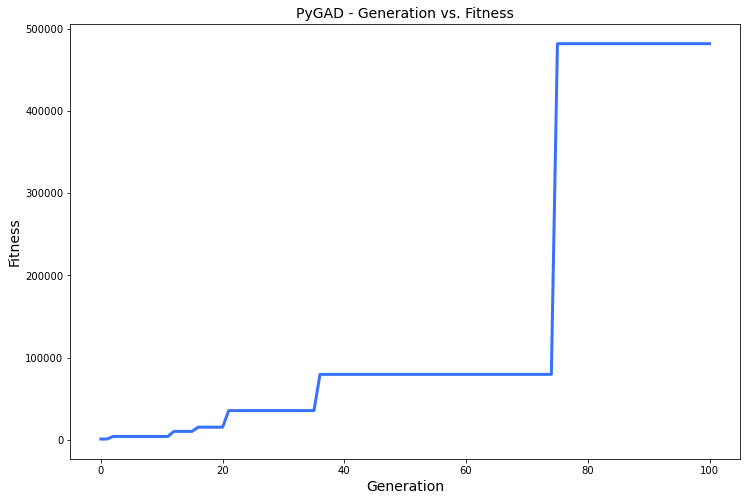

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 9.358 |==================| 78.86 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 9.363 |==================| 139.364 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 9.359 |==================| 83.564 |==========| N1 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 9.362 |==================| 112.065 |==========| N1 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 23.983 |==================| 24.482 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 24.008 |==================| 65.262 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 24.021 |==================| 328.083 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 23.975 |==================| 20.736 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 23.999 |==================| 40.237 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 24.009 |==================| 68.833 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 24.012 |==================| 89.421 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.016 |==================| 137.932 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 24.013 |==================| 93.464 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 23.986 |==================| 26.434 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 23.988 |==================| 28.069 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.008 |==================| 62.51 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 23.99 |==================| 30.052 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 24.018 |==================| 181.039 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 23.99 |==================| 29.418 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.013 |==================| 98.151 |==========| N5 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 24.009 |==================| 69.883 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 23.993 |==================| 32.761 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 24.011 |==================| 79.529 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 23.983 |==================| 24.805 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 23.981 |==================| 23.22 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 23.998 |==================| 39.047 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 23.99 |==================| 29.627 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 23.977 |==================| 21.228 |==========| N5 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 23.986 |==================| 26.395 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 23.973 |==================| 19.567 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 24.002 |==================| 46.965 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 23.979 |==================| 22.22 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 23.996 |==================| 36.407 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 23.987 |==================| 27.646 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 23.989 |==================| 28.652 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 24.021 |==================| 328.514 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 23.998 |==================| 39.264 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 24.0 |==================| 42.227 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 24.017 |==================| 152.605 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 24.019 |==================| 215.268 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.017 |==================| 141.506 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 24.012 |==================| 83.568 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 23.98 |==================| 23.084 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 23.999 |==================| 41.363 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 23.988 |==================| 28.134 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 23.994 |==================| 34.117 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.012 |==================| 82.921 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 23.976 |==================| 21.121 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 24.021 |==================| 429.965 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 24.01 |==================| 73.129 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.001 |===========| 23.972 |==================| 19.457 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 24.021 |==================| 402.594 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 24.023 |==================| 1081.576 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 23.98 |==================| 22.908 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 23.99 |==================| 29.983 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 24.01 |==================| 75.668 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 24.015 |==================| 114.2 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 23.997 |==================| 37.726 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 23.978 |==================| 21.741 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 24.005 |==================| 53.898 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 23.973 |==================| 19.882 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 23.98 |==================| 23.118 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 24.005 |==================| 54.451 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 24.019 |==================| 221.844 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 24.016 |==================| 125.522 |==========| N5 |==========
**********************************************************************
Generation = 6
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 24.019 |==================| 218.736 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 24.0 |==================| 42.687 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 23.987 |==================| 27.532 |==========| N5 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 24.01 |==================| 75.8 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 23.986 |==================| 26.74 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 24.019 |==================| 221.705 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 24.003 |==================| 47.427 |==========| N5 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 23.977 |==================| 21.279 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 24.011 |==================| 81.055 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 24.021 |==================| 454.01 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 23.981 |==================| 23.225 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 23.973 |==================| 19.584 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 23.979 |==================| 22.216 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 24.009 |==================| 68.075 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 23.996 |==================| 36.004 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 23.992 |==================| 31.547 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 24.013 |==================| 92.283 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.002 |==================| 45.842 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 24.012 |==================| 84.445 |==========| N5 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 24.015 |==================| 120.0 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 23.999 |==================| 39.843 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 23.986 |==================| 26.577 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 23.976 |==================| 21.03 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 23.986 |==================| 26.433 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 24.001 |==================| 44.662 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 23.974 |==================| 20.101 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 24.023 |==================| 4075.375 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 24.004 |==================| 51.277 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 23.987 |==================| 27.038 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 24.011 |==================| 76.627 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 24.009 |==================| 69.264 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 23.988 |==================| 28.061 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 24.009 |==================| 69.303 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.022 |==================| 501.662 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 23.973 |==================| 19.58 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 24.001 |==================| 44.869 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 23.997 |==================| 37.23 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 24.016 |==================| 137.807 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.01 |==================| 73.53 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 24.008 |==================| 64.557 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 24.022 |==================| 608.445 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 23.977 |==================| 21.478 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 24.02 |==================| 287.513 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 23.988 |==================| 28.275 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 23.996 |==================| 36.029 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 23.984 |==================| 25.008 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 24.017 |==================| 146.706 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 23.976 |==================| 20.78 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 24.0 |==================| 41.445 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 24.021 |==================| 324.137 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 23.99 |==================| 29.411 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 23.98 |==================| 22.853 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 24.008 |==================| 64.443 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 24.015 |==================| 119.279 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 23.996 |==================| 36.329 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.018 |==================| 171.105 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 23.992 |==================| 31.358 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 23.973 |==================| 19.847 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 23.973 |==================| 19.562 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 23.987 |==================| 27.523 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 24.012 |==================| 86.543 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 24.009 |==================| 66.68 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 23.976 |==================| 20.976 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 24.013 |==================| 92.587 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 24.022 |==================| 812.272 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 23.973 |==================| 19.774 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 24.003 |==================| 48.823 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 24.018 |==================| 181.84 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 23.994 |==================| 33.588 |==========| N5 |==========
**********************************************************************
Generation = 12
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 24.023 |==================| 2237.868 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 23.978 |==================| 21.879 |==========| N5 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 23.976 |==================| 21.15 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 24.004 |==================| 50.998 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 24.021 |==================| 413.297 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 23.973 |==================| 19.652 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 24.008 |==================| 63.657 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 23.987 |==================| 27.662 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 23.984 |==================| 25.103 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 24.004 |==================| 50.812 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.019 |==================| 237.885 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 23.983 |==================| 24.48 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 24.015 |==================| 112.212 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 23.996 |==================| 36.433 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 23.979 |==================| 22.452 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 23.987 |==================| 27.112 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 24.012 |==================| 87.338 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 24.003 |==================| 48.873 |==========| N5 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 23.975 |==================| 20.462 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 24.016 |==================| 132.598 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 23.986 |==================| 26.769 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 23.984 |==================| 25.236 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 23.986 |==================| 26.495 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 23.986 |==================| 26.24 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 24.022 |==================| 490.567 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 23.993 |==================| 32.629 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 23.997 |==================| 37.975 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 24.013 |==================| 92.491 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 23.982 |==================| 24.083 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 23.978 |==================| 21.832 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 24.009 |==================| 70.409 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 23.999 |==================| 39.808 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 24.006 |==================| 55.813 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 23.995 |==================| 35.524 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 23.981 |==================| 23.285 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 23.999 |==================| 40.793 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 23.975 |==================| 20.545 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 23.981 |==================| 23.67 |==========| N5 |==========
**********************************************************************
Fi

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 24.005 |==================| 52.426 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 23.977 |==================| 21.409 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 23.997 |==================| 37.133 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 24.018 |==================| 163.086 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 23.98 |==================| 22.833 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 23.995 |==================| 35.392 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 23.982 |==================| 23.877 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 23.995 |==================| 34.642 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 24.018 |==================| 179.93 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 24.0 |==================| 41.51 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 23.989 |==================| 28.545 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 23.989 |==================| 28.455 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 24.019 |==================| 239.037 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 23.992 |==================| 31.45 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 23.987 |==================| 26.977 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 24.007 |==================| 61.626 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 23.991 |==================| 30.584 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 24.005 |==================| 53.622 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 24.0 |==================| 42.697 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 23.99 |==================| 29.762 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 23.991 |==================| 31.101 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 24.014 |==================| 105.153 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 23.992 |==================| 31.925 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 24.012 |==================| 85.64 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 24.017 |==================| 150.661 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 24.015 |==================| 120.599 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.001 |==================| 44.771 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 23.991 |==================| 31.101 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 24.022 |==================| 467.476 |==========| N5 |==========
**********************************************************************
Generation = 18
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 24.021 |==================| 331.312 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 23.983 |==================| 24.677 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.014 |==================| 100.937 |==========| N5 |==========
****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 23.976 |==================| 21.109 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 24.016 |==================| 125.574 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 24.023 |==================| 2103.11 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.013 |==================| 98.335 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 23.998 |==================| 38.41 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 23.991 |==================| 30.95 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 24.023 |==================| 4191.721 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 24.005 |==================| 54.053 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 23.973 |==================| 19.82 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 24.013 |==================| 96.496 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 23.972 |==================| 19.512 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 23.98 |==================| 22.989 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 24.015 |==================| 111.654 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 24.006 |==================| 55.47 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 24.019 |==================| 200.811 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 24.018 |==================| 184.131 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 23.981 |==================| 23.373 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 23.984 |==================| 25.484 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 23.997 |==================| 37.281 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 23.986 |==================| 26.795 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 23.999 |==================| 41.068 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 24.0 |==================| 42.029 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 24.007 |==================| 59.941 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 24.001 |==================| 44.068 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 24.001 |==================| 43.733 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 23.979 |==================| 22.214 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 24.008 |==================| 63.53 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 24.005 |==================| 54.906 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 23.977 |==================| 21.534 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 23.986 |==================| 26.915 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 24.018 |==================| 188.928 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 24.019 |==================| 221.646 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 23.979 |==================| 22.275 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 24.006 |==================| 56.666 |==========| N5 |==========
**********************************************************************
Fitness = 11556.268505882124
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 23.98 |==================| 22.747 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 24.001 |==================| 43.283 |==========| N5 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 23.978 |==================| 21.977 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 23.978 |==================| 21.832 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 23.979 |==================| 22.505 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 24.02 |==================| 275.944 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 23.978 |==================| 21.847 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 23.999 |==================| 40.662 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.008 |==================| 62.509 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 24.017 |==================| 149.358 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 23.985 |==================| 25.595 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 24.02 |==================| 288.483 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 24.015 |==================| 118.654 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 23.983 |==================| 24.678 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 24.022 |==================| 474.401 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 23.982 |==================| 24.04 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 24.004 |==================| 50.115 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 23.994 |==================| 33.187 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 23.987 |==================| 27.632 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 23.998 |==================| 39.304 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 23.99 |==================| 29.683 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 23.994 |==================| 33.947 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 23.994 |==================| 33.781 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 23.999 |==================| 41.321 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 23.994 |==================| 33.522 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 23.975 |==================| 20.578 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 23.989 |==================| 29.274 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 23.994 |==================| 33.709 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 24.019 |==================| 230.283 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 23.998 |==================| 38.743 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 24.02 |==================| 244.654 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 24.0 |==================| 41.555 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 24.005 |==================| 54.981 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 23.997 |==================| 36.887 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 23.998 |==================| 38.297 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 23.985 |==================| 25.775 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 24.01 |==================| 72.564 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 24.007 |==================| 60.714 |==========| N5 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 23.988 |==================| 28.137 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 24.018 |==================| 163.383 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 24.018 |==================| 184.309 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 23.998 |==================| 38.297 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 23.981 |==================| 23.36 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 23.984 |==================| 25.007 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 23.983 |==================| 24.485 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 24.002 |==================| 47.134 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 23.991 |==================| 30.731 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 23.973 |==================| 19.684 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 24.011 |==================| 80.444 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 23.992 |==================| 31.662 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 23.981 |==================| 23.441 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 24.023 |==================| 1180.412 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 23.99 |==================| 30.155 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 24.018 |==================| 183.24 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 23.983 |==================| 24.602 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 23.997 |==================| 37.788 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 24.007 |==================| 60.731 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 24.021 |==================| 341.519 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 24.01 |==================| 74.103 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 24.009 |==================| 68.145 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 24.01 |==================| 70.733 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 23.985 |==================| 26.206 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 23.999 |==================| 40.935 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 23.974 |==================| 20.048 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 23.984 |==================| 24.999 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 24.007 |==================| 58.332 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.011 |==================| 82.195 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 23.993 |==================| 32.722 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 24.015 |==================| 114.018 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 24.011 |==================| 79.798 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 24.004 |==================| 49.836 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 23.975 |==================| 20.72 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 24.005 |==================| 53.233 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 23.983 |==================| 24.314 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 23.973 |==================| 19.776 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 24.014 |==================| 104.292 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 23.994 |==================| 33.332 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 23.996 |==================| 35.72 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 23.982 |==================| 24.075 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 23.99 |==================| 29.916 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 24.015 |==================| 110.441 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 23.977 |==================| 21.497 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 24.021 |==================| 381.434 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 23.985 |==================| 25.715 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 23.983 |==================| 24.904 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 24.014 |==================| 109.019 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 24.013 |==================| 91.157 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 24.021 |==================| 363.116 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.008 |==================| 63.055 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.02 |==================| 296.589 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 23.972 |==================| 19.533 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 23.983 |==================| 24.784 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 23.977 |==================| 21.287 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 24.015 |==================| 116.142 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 23.979 |==================| 22.2 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 23.978 |==================| 21.673 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 24.021 |==================| 319.058 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 23.994 |==================| 34.063 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 23.996 |==================| 36.639 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 23.979 |==================| 22.615 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 23.988 |==================| 28.409 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.013 |==================| 98.045 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 24.007 |==================| 61.19 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 23.982 |==================| 24.035 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 24.009 |==================| 68.676 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 24.014 |==================| 105.771 |==========| N5 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 23.978 |==================| 21.736 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 23.999 |==================| 40.183 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 23.988 |==================| 28.113 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 24.01 |==================| 72.521 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 23.977 |==================| 21.213 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 23.986 |==================| 26.38 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 23.994 |==================| 33.244 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 24.004 |==================| 50.757 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 24.023 |==================| 1955.299 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 24.003 |==================| 47.445 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 24.022 |==================| 679.433 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 24.008 |==================| 64.878 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.003 |==================| 48.219 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 23.999 |==================| 41.21 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 23.982 |==================| 23.825 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 24.022 |==================| 621.184 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 24.023 |==================| 1031.989 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 23.984 |==================| 25.093 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 24.022 |==================| 530.76 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 23.988 |==================| 28.0 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.018 |==================| 168.043 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 23.997 |==================| 37.135 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 23.976 |==================| 20.892 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 23.978 |==================| 22.05 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 24.003 |==================| 49.468 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 23.978 |==================| 21.76 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 24.02 |==================| 284.07 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 24.008 |==================| 64.85 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 23.999 |==================| 41.371 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 23.984 |==================| 24.983 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 23.976 |==================| 21.039 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 23.997 |==================| 37.405 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 24.015 |==================| 115.534 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 23.999 |==================| 40.065 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 24.007 |==================| 59.427 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 23.996 |==================| 35.581 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 23.988 |==================| 27.837 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 23.992 |==================| 31.396 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 23.988 |==================| 28.284 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 23.984 |==================| 25.232 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 23.977 |==================| 21.261 |==========| N5 |==========
**********************************************************************
Fitness = 147606.95386323892
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 23.992 |==================| 31.801 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.02 |==================| 259.984 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 23.975 |==================| 20.746 |==========| N5 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 23.986 |==================| 26.707 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 24.005 |==================| 52.386 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 23.995 |==================| 35.166 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 24.014 |==================| 108.462 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 24.007 |==================| 61.048 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 23.983 |==================| 24.525 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 23.973 |==================| 19.748 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 24.006 |==================| 58.028 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 24.013 |==================| 91.581 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 23.981 |==================| 23.578 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 24.017 |==================| 148.949 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 24.02 |==================| 313.783 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 23.995 |==================| 34.395 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 23.981 |==================| 23.632 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 24.0 |==================| 42.241 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 23.991 |==================| 30.32 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 23.982 |==================| 23.947 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 23.979 |==================| 22.169 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 24.022 |==================| 652.862 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 23.979 |==================| 22.178 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 23.984 |==================| 25.151 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 24.007 |==================| 58.553 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 23.998 |==================| 38.341 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.0 |==================| 42.154 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 24.008 |==================| 64.343 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 23.982 |==================| 24.052 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 24.01 |==================| 72.734 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 24.004 |==================| 51.404 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 24.022 |==================| 685.137 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 23.984 |==================| 25.318 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 24.016 |==================| 132.594 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 24.0 |==================| 42.478 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 23.982 |==================| 24.082 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 23.991 |==================| 30.459 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 23.984 |==================| 25.283 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 24.012 |==================| 89.086 |==========| N5 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 24.011 |==================| 77.103 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 23.997 |==================| 37.726 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 24.002 |==================| 46.346 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 23.999 |==================| 39.954 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 24.018 |==================| 190.639 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 23.989 |==================| 29.004 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 24.016 |==================| 136.888 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 23.984 |==================| 25.307 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 24.002 |==================| 45.512 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 23.974 |==================| 20.077 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 24.011 |==================| 78.973 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 23.982 |==================| 24.254 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 23.981 |==================| 23.293 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.004 |==================| 50.398 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 23.999 |==================| 40.948 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.018 |==================| 170.238 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 23.974 |==================| 20.252 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 23.996 |==================| 35.744 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 24.019 |==================| 204.843 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 23.975 |==================| 20.458 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 24.023 |==================| 6050.95 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 24.004 |==================| 51.805 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 23.984 |==================| 25.087 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 24.009 |==================| 67.774 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 23.996 |==================| 35.61 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 24.021 |==================| 349.982 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 23.998 |==================| 39.572 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 23.981 |==================| 23.27 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 23.988 |==================| 27.972 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 23.986 |==================| 26.417 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 24.021 |==================| 375.348 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 24.005 |==================| 53.074 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 23.98 |==================| 22.854 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 23.983 |==================| 24.487 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.002 |==================| 46.213 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 23.992 |==================| 31.347 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 23.98 |==================| 22.933 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 24.016 |==================| 123.328 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 24.019 |==================| 240.491 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 24.015 |==================| 111.412 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 23.998 |==================| 39.379 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 23.982 |==================| 23.95 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 24.021 |==================| 438.738 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 23.992 |==================| 31.843 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.01 |==================| 74.447 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 23.982 |==================| 24.279 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 23.994 |==================| 33.879 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 24.004 |==================| 51.259 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.018 |==================| 176.674 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.007 |==================| 61.575 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 23.983 |==================| 24.476 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.018 |==================| 176.726 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 23.984 |==================| 25.186 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 24.02 |==================| 312.334 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 23.982 |==================| 23.826 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 23.977 |==================| 21.226 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 24.002 |==================| 46.408 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.008 |==================| 62.042 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 23.986 |==================| 26.712 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 23.979 |==================| 22.47 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 23.986 |==================| 26.57 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 24.018 |==================| 165.25 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 23.985 |==================| 25.615 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 24.022 |==================| 525.375 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 24.019 |==================| 197.664 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 23.996 |==================| 36.281 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 23.973 |==================| 19.577 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 23.997 |==================| 38.019 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 23.973 |==================| 19.657 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 24.013 |==================| 93.339 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 24.005 |==================| 55.041 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 24.018 |==================| 166.38 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 23.983 |==================| 24.577 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.01 |==================| 71.994 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 23.976 |==================| 21.005 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 24.016 |==================| 129.366 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 23.993 |==================| 32.878 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.002 |==================| 45.246 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 24.001 |==================| 43.915 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 23.987 |==================| 26.996 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 23.982 |==================| 24.249 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 24.023 |==================| 1026.971 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 23.994 |==================| 33.28 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 24.002 |==================| 45.97 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 23.977 |==================| 21.24 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 23.978 |==================| 21.855 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 23.974 |==================| 20.151 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 23.984 |==================| 24.913 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 24.012 |==================| 86.025 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 23.998 |==================| 39.589 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 23.997 |==================| 37.645 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 24.004 |==================| 50.22 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 23.992 |==================| 31.23 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 23.999 |==================| 40.892 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 23.976 |==================| 20.929 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.02 |==================| 257.451 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 24.016 |==================| 135.911 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 23.986 |==================| 26.675 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 24.01 |==================| 75.382 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 23.998 |==================| 39.669 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 23.979 |==================| 22.617 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 24.005 |==================| 53.894 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 23.985 |==================| 25.857 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 23.977 |==================| 21.423 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 23.988 |==================| 28.43 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 24.006 |==================| 56.606 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 23.984 |==================| 25.369 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 23.984 |==================| 25.198 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 23.983 |==================| 24.53 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 24.017 |==================| 152.626 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 24.01 |==================| 71.063 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 23.993 |==================| 32.802 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 24.009 |==================| 70.214 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 23.983 |==================| 24.779 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 23.974 |==================| 20.294 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 23.978 |==================| 22.053 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 23.988 |==================| 27.953 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 23.976 |==================| 21.135 |==========| N5 |==========
**********************************************************************
Generation = 48
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 23.999 |==================| 41.337 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 24.003 |==================| 47.393 |==========| N5 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 23.991 |==================| 30.823 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 23.979 |==================| 22.402 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 24.007 |==================| 60.579 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 23.987 |==================| 27.028 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 23.985 |==================| 26.06 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 23.973 |==================| 19.923 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 23.99 |==================| 29.579 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 24.018 |==================| 191.158 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 24.002 |==================| 46.413 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 24.011 |==================| 79.246 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 24.012 |==================| 84.172 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 24.003 |==================| 49.124 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 24.019 |==================| 238.731 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 24.012 |==================| 87.372 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 24.002 |==================| 47.038 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.019 |==================| 206.902 |==========| N5 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 23.986 |==================| 26.242 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 24.017 |==================| 143.094 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 23.987 |==================| 27.522 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 23.99 |==================| 30.075 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 23.985 |==================| 25.656 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 24.01 |==================| 72.017 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 23.976 |==================| 21.137 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 23.973 |==================| 19.599 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 23.99 |==================| 29.601 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 24.013 |==================| 91.592 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 23.99 |==================| 30.168 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 23.99 |==================| 29.425 |==========| N5 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 24.018 |==================| 184.348 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 23.986 |==================| 26.465 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 24.008 |==================| 62.817 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 24.022 |==================| 597.705 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 24.024 |==================| 7016.593 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 24.011 |==================| 81.457 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.012 |==================| 82.779 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 23.976 |==================| 21.035 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 23.98 |==================| 22.921 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 24.01 |==================| 72.486 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 23.994 |==================| 33.386 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 23.982 |==================| 24.251 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 24.018 |==================| 164.573 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 24.009 |==================| 69.517 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 23.983 |==================| 24.305 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 23.993 |==================| 32.694 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 23.983 |==================| 24.802 |==========| N5 |==========
**********************************************************************
Fitness = 147606.95386323892
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 23.975 |==================| 20.52 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 24.017 |==================| 160.27 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 23.988 |==================| 27.726 |==========| N5 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 24.011 |==================| 76.669 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 23.999 |==================| 40.388 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 24.014 |==================| 106.093 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 23.984 |==================| 25.007 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 23.996 |==================| 36.627 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 23.98 |==================| 23.022 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 24.003 |==================| 48.136 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 23.975 |==================| 20.384 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 23.979 |==================| 22.359 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 23.986 |==================| 26.611 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.01 |==================| 74.221 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 24.004 |==================| 50.799 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 23.999 |==================| 39.923 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 23.992 |==================| 31.366 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 23.986 |==================| 26.546 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 24.006 |==================| 56.021 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 24.006 |==================| 58.286 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 23.989 |==================| 28.987 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 24.023 |==================| 3599.554 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 23.987 |==================| 27.49 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 24.009 |==================| 69.296 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 23.986 |==================| 26.341 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 23.987 |==================| 27.151 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 24.016 |==================| 139.032 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 24.016 |==================| 136.634 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 23.993 |==================| 32.576 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 23.98 |==================| 22.975 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.011 |==================| 77.833 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 23.974 |==================| 20.34 |==========| N5 |==========
**********************************************************************
Generation = 55
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 23.974 |==================| 20.342 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 23.973 |==================| 19.623 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 24.021 |==================| 397.017 |==========| N5 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.008 |==================| 62.049 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 23.973 |==================| 19.781 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 24.009 |==================| 70.47 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 24.015 |==================| 113.47 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 24.005 |==================| 55.064 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 23.994 |==================| 33.534 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 24.023 |==================| 1715.371 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 24.009 |==================| 70.646 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 24.003 |==================| 48.109 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 23.997 |==================| 37.901 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 23.994 |==================| 33.816 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 23.986 |==================| 26.721 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 24.023 |==================| 916.6 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 23.974 |==================| 20.202 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 23.987 |==================| 27.646 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 24.023 |==================| 1892.06 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.007 |==================| 61.454 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 24.021 |==================| 434.467 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 23.987 |==================| 27.098 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 23.997 |==================| 37.022 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 23.98 |==================| 23.148 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 24.0 |==================| 42.378 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 23.996 |==================| 35.605 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 23.98 |==================| 22.867 |==========| N5 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 23.996 |==================| 36.468 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 24.003 |==================| 48.692 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 24.013 |==================| 90.255 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 23.991 |==================| 30.698 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 23.988 |==================| 28.087 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 23.983 |==================| 24.901 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 23.98 |==================| 23.121 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 23.979 |==================| 22.284 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 24.017 |==================| 161.148 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 23.99 |==================| 29.897 |==========| N5 |==========
**********************************************************************
Fitness = 147606.95386323892
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 24.02 |==================| 274.993 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 23.997 |==================| 37.83 |==========| N5 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 24.023 |==================| 1278.965 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 24.023 |==================| 5902.995 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 24.008 |==================| 64.78 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 23.989 |==================| 28.869 |==========| N5 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 23.976 |==================| 20.941 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 23.976 |==================| 21.175 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 24.016 |==================| 133.163 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 23.974 |==================| 20.119 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 23.984 |==================| 25.444 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 23.982 |==================| 23.887 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 24.019 |==================| 217.69 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 23.99 |==================| 30.109 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.02 |==================| 281.052 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 24.019 |==================| 208.641 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 24.009 |==================| 67.842 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 24.006 |==================| 58.058 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 23.981 |==================| 23.241 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 23.975 |==================| 20.432 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 23.977 |==================| 21.441 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 23.976 |==================| 20.904 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 24.002 |==================| 46.731 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 24.023 |==================| 2212.544 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 23.991 |==================| 30.881 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 23.999 |==================| 41.162 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 23.985 |==================| 26.035 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 24.003 |==================| 47.703 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 23.979 |==================| 22.56 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 23.982 |==================| 24.123 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 23.99 |==================| 30.102 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 23.978 |==================| 21.76 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 23.992 |==================| 31.508 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 23.991 |==================| 30.797 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 24.01 |==================| 71.25 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 23.976 |==================| 20.842 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 23.992 |==================| 31.895 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 23.992 |==================| 31.169 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 23.987 |==================| 27.212 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 24.008 |==================| 63.355 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 24.008 |==================| 64.607 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 24.013 |==================| 90.546 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 23.98 |==================| 23.177 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.002 |==================| 45.326 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 24.021 |==================| 377.296 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 24.017 |==================| 148.851 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 23.975 |==================| 20.566 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 24.003 |==================| 48.427 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 24.007 |==================| 61.872 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 24.005 |==================| 55.051 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 23.996 |==================| 35.548 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 23.975 |==================| 20.74 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 24.011 |==================| 79.862 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 24.007 |==================| 61.329 |==========| N5 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 23.978 |==================| 22.098 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 23.995 |==================| 34.516 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 23.997 |==================| 38.142 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 24.006 |==================| 57.658 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 24.013 |==================| 94.314 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 23.992 |==================| 32.022 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 23.975 |==================| 20.565 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 24.023 |==================| 896.086 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 23.989 |==================| 28.487 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.018 |==================| 170.674 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 23.986 |==================| 26.273 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 24.015 |==================| 115.285 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 23.989 |==================| 29.074 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 23.984 |==================| 25.444 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 23.999 |==================| 41.041 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 23.984 |==================| 25.038 |==========| N5 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 23.99 |==================| 29.402 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 24.019 |==================| 240.719 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 24.015 |==================| 116.057 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 24.022 |==================| 607.438 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.007 |==================| 60.913 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 23.996 |==================| 36.058 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 23.984 |==================| 25.024 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 23.99 |==================| 29.375 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 23.976 |==================| 20.944 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 24.016 |==================| 130.735 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 23.978 |==================| 22.104 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 23.979 |==================| 22.326 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 23.999 |==================| 40.829 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 23.998 |==================| 38.884 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 23.989 |==================| 28.78 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 24.02 |==================| 288.459 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 23.991 |==================| 30.495 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 24.023 |==================| 1364.52 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 23.986 |==================| 26.75 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 23.978 |==================| 21.794 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 23.975 |==================| 20.67 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 23.993 |==================| 32.845 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 24.017 |==================| 155.343 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 24.021 |==================| 347.799 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 23.983 |==================| 24.852 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 24.014 |==================| 107.891 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 24.003 |==================| 48.447 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.007 |==================| 61.562 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 23.999 |==================| 40.903 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 24.014 |==================| 99.083 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 24.018 |==================| 163.511 |==========| N5 |==========
**********************************************************************
Generation = 67
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 24.024 |==================| 7003.524 |==========| N5 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 23.988 |==================| 28.045 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 23.992 |==================| 31.404 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 24.019 |==================| 210.532 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 24.005 |==================| 53.426 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.008 |==================| 63.03 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 23.975 |==================| 20.506 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 23.976 |==================| 20.848 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 23.978 |==================| 21.8 |==========| N5 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 23.993 |==================| 32.232 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 23.993 |==================| 33.107 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 23.983 |==================| 24.61 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 23.992 |==================| 31.579 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 24.017 |==================| 140.318 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.001 |==================| 43.977 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 24.008 |==================| 63.396 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 24.005 |==================| 53.815 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.014 |==================| 99.704 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 23.999 |==================| 41.347 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 24.023 |==================| 1362.661 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 24.006 |==================| 55.841 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 24.013 |==================| 95.093 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 24.01 |==================| 71.057 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.014 |==================| 99.934 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 23.995 |==================| 34.907 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 24.01 |==================| 75.364 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 24.009 |==================| 66.168 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.014 |==================| 100.795 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.008 |==================| 62.47 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 24.011 |==================| 79.56 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 24.009 |==================| 67.298 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 24.012 |==================| 86.308 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 23.976 |==================| 20.843 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 23.977 |==================| 21.213 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 23.975 |==================| 20.621 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 24.013 |==================| 96.854 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 23.973 |==================| 19.616 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 24.009 |==================| 68.055 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 24.017 |==================| 151.198 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 23.973 |==================| 19.692 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 24.003 |==================| 49.277 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 23.989 |==================| 28.549 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 24.012 |==================| 88.399 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 23.994 |==================| 33.637 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 23.995 |==================| 35.378 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 23.999 |==================| 41.302 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 23.985 |==================| 25.595 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 23.985 |==================| 25.612 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 24.022 |==================| 834.613 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 23.996 |==================| 36.339 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 24.02 |==================| 262.726 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 23.976 |==================| 20.785 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 23.983 |==================| 24.707 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.017 |==================| 145.338 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 24.008 |==================| 65.462 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 23.986 |==================| 26.38 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 23.993 |==================| 33.04 |==========| N5 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 24.02 |==================| 283.413 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 23.978 |==================| 22.149 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 23.977 |==================| 21.332 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 23.987 |==================| 27.11 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 23.985 |==================| 25.776 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 23.996 |==================| 36.39 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 23.989 |==================| 28.552 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 24.019 |==================| 232.095 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 23.994 |==================| 33.372 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 23.992 |==================| 31.829 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 23.98 |==================| 22.841 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 24.01 |==================| 75.049 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 23.983 |==================| 24.318 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 23.987 |==================| 27.1 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 24.006 |==================| 57.41 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 23.981 |==================| 23.319 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 23.981 |==================| 23.688 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 24.021 |==================| 408.014 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 24.001 |==================| 43.629 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 24.023 |==================| 1465.941 |==========| N5 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 23.982 |==================| 23.942 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 23.973 |==================| 19.726 |==========| N5 |==========
**********************************************************************
Generation = 74
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 23.986 |==================| 26.882 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 24.021 |==================| 398.532 |==========| N5 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 23.995 |==================| 34.631 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 23.98 |==================| 23.013 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 24.018 |==================| 184.414 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.001 |==================| 44.045 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 23.989 |==================| 28.525 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 23.995 |==================| 34.448 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 23.977 |==================| 21.371 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 23.984 |==================| 25.364 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 24.015 |==================| 119.27 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.005 |==================| 53.661 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.003 |==================| 48.319 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 24.021 |==================| 354.169 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 23.975 |==================| 20.531 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 23.991 |==================| 30.242 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 23.974 |==================| 20.168 |==========| N5 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 23.978 |==================| 21.929 |==========| N5 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 24.019 |==================| 204.958 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 24.006 |==================| 55.275 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 24.021 |==================| 440.431 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 24.01 |==================| 73.886 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 23.979 |==================| 22.295 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 23.996 |==================| 35.981 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 24.017 |==================| 147.664 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 23.973 |==================| 19.683 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 24.007 |==================| 59.567 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 24.013 |==================| 91.391 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 24.019 |==================| 213.275 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 23.99 |==================| 30.07 |==========| N5 |==========
**********************************************************************
==

======| 0.834 |===========| 23.981 |==================| 23.394 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 24.016 |==================| 124.145 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 23.999 |==================| 41.31 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 23.999 |==================| 41.353 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 23.983 |==================| 24.345 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 24.013 |==================| 96.513 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 23.986 |==================| 26.854 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 23.993 |==================| 33.105 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 24.012 |==================| 87.398 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 23.981 |==================| 23.428 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 23.989 |==================| 28.887 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 23.974 |==================| 20.216 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 23.997 |==================| 37.38 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 23.987 |==================| 27.293 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 24.007 |==================| 61.746 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 23.999 |==================| 40.44 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 23.987 |==================| 27.59 |==========| N5 |==========
**********************************************************************
Fitness = 147606.95386323892
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 23.973 |==================| 19.793 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.001 |==================| 43.823 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.01 |==================| 73.538 |==========| N5 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 23.989 |==================| 28.923 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 24.017 |==================| 146.562 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 23.984 |==================| 25.35 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 24.009 |==================| 69.022 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 24.003 |==================| 48.135 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.019 |==================| 237.757 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 23.991 |==================| 30.242 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 23.987 |==================| 27.547 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 23.998 |==================| 39.404 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 23.979 |==================| 22.381 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 23.994 |==================| 34.063 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 23.982 |==================| 24.117 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 23.998 |==================| 39.361 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 23.988 |==================| 27.734 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 24.0 |==================| 42.488 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 24.005 |==================| 53.097 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 23.993 |==================| 32.919 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 23.999 |==================| 40.849 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 24.0 |==================| 42.917 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 24.01 |==================| 73.713 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 24.004 |==================| 51.437 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 23.984 |==================| 25.195 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 24.004 |==================| 52.178 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 23.987 |==================| 27.203 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 23.973 |==================| 19.658 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 23.999 |==================| 40.945 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 24.005 |==================| 54.632 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 23.994 |==================| 33.618 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 23.996 |==================| 35.922 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 24.013 |==================| 97.445 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 23.974 |==================| 20.149 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 23.998 |==================| 38.987 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 23.987 |==================| 27.455 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 24.001 |==================| 44.285 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 23.986 |==================| 26.5 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 23.975 |==================| 20.399 |==========| N5 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 23.98 |==================| 22.979 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 24.007 |==================| 59.283 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 24.01 |==================| 71.137 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 23.987 |==================| 26.952 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 24.009 |==================| 66.193 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 23.997 |==================| 37.595 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 23.977 |==================| 21.429 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 23.987 |==================| 27.243 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 23.996 |==================| 36.816 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 23.997 |==================| 37.933 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 23.993 |==================| 32.228 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 24.003 |==================| 47.357 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 24.0 |==================| 42.509 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 24.015 |==================| 115.511 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 23.994 |==================| 34.242 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 23.999 |==================| 41.153 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 23.983 |==================| 24.354 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 23.975 |==================| 20.365 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 24.002 |==================| 46.729 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 24.009 |==================| 66.563 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 23.995 |==================| 35.123 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 23.986 |==================| 26.505 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 23.999 |==================| 39.78 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 24.009 |==================| 67.221 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 23.99 |==================| 30.144 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 24.011 |==================| 80.398 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 23.986 |==================| 26.38 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 23.999 |==================| 41.363 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 24.006 |==================| 56.097 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 23.976 |==================| 21.013 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 23.996 |==================| 35.554 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 23.998 |==================| 39.157 |==========| N5 |==========
**********************************************************************
Fitn

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 23.994 |==================| 34.071 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 24.014 |==================| 103.795 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 23.996 |==================| 35.72 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 23.973 |==================| 19.725 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 23.978 |==================| 21.979 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 23.983 |==================| 24.565 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 24.001 |==================| 44.353 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 23.999 |==================| 40.583 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 23.994 |==================| 33.572 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 23.976 |==================| 21.16 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.0 |==================| 41.906 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 23.989 |==================| 28.689 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.017 |==================| 141.543 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 24.012 |==================| 88.868 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 24.016 |==================| 137.102 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 23.997 |==================| 38.016 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 24.003 |==================| 49.019 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 24.0 |==================| 42.803 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 23.983 |==================| 24.664 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 23.973 |==================| 19.737 |==========| N5 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 24.019 |==================| 228.643 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 23.997 |==================| 37.273 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.008 |==================| 62.051 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 23.986 |==================| 26.804 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 23.978 |==================| 22.093 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 23.981 |==================| 23.398 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 24.015 |==================| 109.533 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 24.019 |==================| 238.7 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 23.98 |==================| 23.001 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 23.978 |==================| 21.671 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 23.99 |==================| 29.54 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 23.981 |==================| 23.626 |==========| N5 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 23.984 |==================| 24.975 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 24.016 |==================| 124.215 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 23.988 |==================| 28.194 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 23.982 |==================| 24.183 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 23.986 |==================| 26.886 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 24.001 |==================| 44.374 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 24.024 |==================| 6918.027 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 24.009 |==================| 66.504 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 24.014 |==================| 106.782 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 24.016 |==================| 126.19 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 23.994 |==================| 33.271 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 24.0 |==================| 41.43 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 23.979 |==================| 22.478 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.016 |==================| 138.53 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 23.98 |==================| 22.726 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 24.022 |==================| 605.144 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 23.998 |==================| 38.586 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 24.012 |==================| 88.296 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 24.012 |==================| 89.011 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 24.018 |==================| 177.998 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 23.995 |==================| 35.181 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 24.02 |==================| 268.4 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 24.023 |==================| 1588.015 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 24.018 |==================| 165.321 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 24.005 |==================| 54.549 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 23.974 |==================| 20.044 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 23.985 |==================| 25.592 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 23.998 |==================| 38.875 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 24.017 |==================| 151.511 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 24.007 |==================| 59.204 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 23.981 |==================| 23.604 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 24.004 |==================| 50.564 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 23.988 |==================| 28.164 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 24.002 |==================| 46.604 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 24.0 |==================| 42.544 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 23.993 |==================| 32.856 |==========| N5 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 23.999 |==================| 41.28 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 23.978 |==================| 21.944 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 24.008 |==================| 63.541 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 23.986 |==================| 26.67 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 23.999 |==================| 39.854 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.01 |==================| 71.78 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 24.0 |==================| 41.504 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 24.012 |==================| 83.398 |==========| N5 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 24.02 |==================| 272.209 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 24.016 |==================| 131.088 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 23.997 |==================| 37.615 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 24.023 |==================| 1730.87 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 23.978 |==================| 21.928 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 23.98 |==================| 22.953 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.019 |==================| 236.242 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 23.977 |==================| 21.399 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 24.013 |==================| 97.713 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 23.973 |==================| 19.828 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 23.991 |==================| 30.824 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 24.008 |==================| 64.89 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 24.018 |==================| 191.965 |==========| N5 |==========
**********************************************************************
Fitness = 147606.95386323892
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 23.994 |==================| 33.378 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 24.003 |==================| 49.515 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 23.985 |==================| 25.866 |==========| N5 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 23.989 |==================| 29.184 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 23.983 |==================| 24.694 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 24.01 |==================| 75.302 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 24.012 |==================| 85.034 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 23.99 |==================| 29.638 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 23.984 |==================| 25.308 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 23.989 |==================| 28.964 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 23.987 |==================| 27.037 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 24.011 |==================| 77.612 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 23.995 |==================| 35.277 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 23.997 |==================| 37.382 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 24.007 |==================| 61.231 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 23.991 |==================| 30.576 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 24.004 |==================| 51.097 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 24.014 |==================| 107.306 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 23.999 |==================| 40.105 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 23.981 |==================| 23.509 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 23.994 |==================| 34.0 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 24.023 |==================| 1137.955 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 23.999 |==================| 40.566 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.02 |==================| 303.704 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 23.979 |==================| 22.604 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 24.005 |==================| 52.58 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 23.98 |==================| 22.696 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 23.988 |==================| 28.286 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 23.995 |==================| 34.687 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 23.998 |==================| 38.77 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 23.984 |==================| 25.03 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 23.997 |==================| 37.771 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 23.977 |==================| 21.216 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 24.015 |==================| 118.759 |==========| N5 |==========
**********************************************************************
Generation = 95
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 24.003 |==================| 47.353 |==========| N5 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 23.974 |==================| 20.233 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 23.998 |==================| 39.551 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 24.008 |==================| 65.216 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 23.993 |==================| 32.115 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 24.001 |==================| 43.918 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 23.998 |==================| 39.548 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 23.979 |==================| 22.39 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 24.009 |==================| 69.425 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 24.023 |==================| 1086.189 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 23.995 |==================| 35.473 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.003 |==================| 48.274 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.001 |==================| 43.987 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.005 |==================| 52.868 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 24.002 |==================| 46.657 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 24.02 |==================| 283.495 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 24.017 |==================| 144.79 |==========| N5 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 23.995 |==================| 34.531 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 24.005 |==================| 54.453 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 23.986 |==================| 26.734 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 23.981 |==================| 23.714 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 23.988 |==================| 27.844 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 23.996 |==================| 35.66 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 23.984 |==================| 24.933 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 24.023 |==================| 1674.463 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 23.99 |==================| 29.832 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 23.999 |==================| 40.729 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 23.983 |==================| 24.322 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 24.009 |==================| 68.215 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.02 |==================| 296.768 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 23.986 |==================| 26.599 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 24.011 |==================| 76.631 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 24.012 |==================| 84.598 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 24.006 |==================| 57.098 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 24.023 |==================| 3379.451 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 24.009 |==================| 66.337 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 23.979 |==================| 22.562 |==========| N5 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 23.979 |==================| 22.359 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 24.001 |==================| 45.07 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 24.003 |==================| 47.541 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 23.983 |==================| 24.903 |==========| N5 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.0 |==================| 41.952 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 23.986 |==================| 26.55 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 23.996 |==================| 36.521 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 23.975 |==================| 20.591 |==========| N5 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 23.974 |==================| 20.291 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 23.973 |==================| 19.578 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 23.987 |==================| 27.583 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 23.992 |==================| 31.29 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 23.986 |==================| 26.862 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 23.982 |==================| 23.802 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 24.01 |==================| 74.673 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 23.996 |==================| 36.476 |==========| N5 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.001 |==================| 44.699 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 24.004 |==================| 50.633 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 23.978 |==================| 21.687 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 23.986 |==================| 26.216 |==========| N5 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 24.001 |==================| 44.976 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 24.011 |==================| 80.734 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 24.016 |==================| 132.726 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 24.004 |==================| 51.354 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 24.003 |==================| 48.174 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 24.023 |==================| 2965.557 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 24.002 |==================| 45.526 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 23.977 |==================| 21.288 |==========| N5 |==========
**********************************************************************

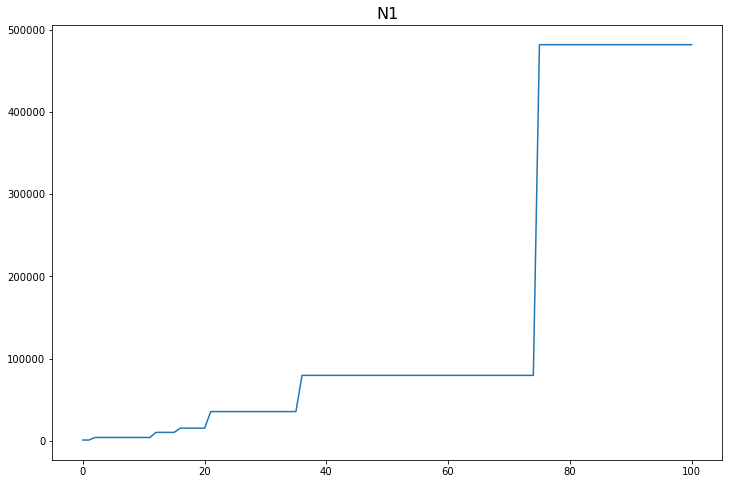

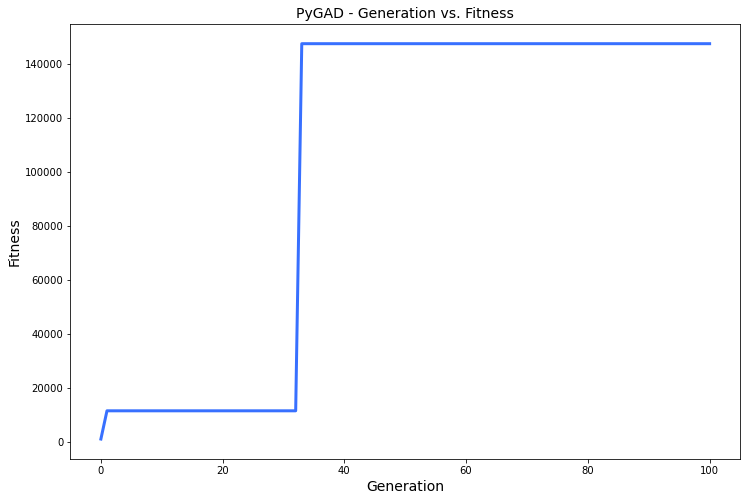

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 24.001 |==================| 44.976 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 24.011 |==================| 80.734 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 24.016 |==================| 132.726 |==========| N5 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 24.004 |==================| 51.354 |==========| N5 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 28.864 |==================| 9.404 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 28.916 |==================| 18.501 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 28.966 |==================| 245.303 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 28.878 |==================| 10.841 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 28.884 |==================| 11.682 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 28.917 |==================| 18.698 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 28.97 |==================| 5054.902 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 28.938 |==================| 31.429 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 28.896 |==================| 13.453 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 28.895 |==================| 13.323 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 28.907 |==================| 15.971 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 28.941 |==================| 34.349 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 28.97 |==================| 2118.701 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 28.896 |==================| 13.538 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 28.891 |==================| 12.615 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 28.891 |==================| 12.667 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 28.956 |==================| 69.52 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 28.857 |==================| 8.825 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 28.898 |==================| 13.93 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 28.963 |==================| 141.255 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 28.882 |==================| 11.332 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 28.918 |==================| 19.168 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 28.902 |==================| 14.777 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 28.856 |==================| 8.802 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 28.936 |==================| 29.72 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 28.876 |==================| 10.604 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 28.965 |==================| 193.046 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 28.966 |==================| 239.692 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 28.855 |==================| 8.704 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 28.942 |==================| 35.137 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 28.909 |==================| 16.375 |==========| N10 |==========
**********************************************************************
Fitness = 5054.9022691481405
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 28.941 |==================| 34.02 |==========| N10 |==========
****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 28.954 |==================| 62.166 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 28.955 |==================| 67.991 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 28.958 |==================| 84.512 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 28.875 |==================| 10.476 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 28.87 |==================| 9.968 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 28.873 |==================| 10.309 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 28.904 |==================| 15.059 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 28.902 |==================| 14.619 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 28.862 |==================| 9.217 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 28.966 |==================| 231.184 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 28.876 |==================| 10.675 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 28.872 |==================| 10.222 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 28.887 |==================| 11.973 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 28.886 |==================| 11.877 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 28.915 |==================| 18.08 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 28.969 |==================| 832.132 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 28.959 |==================| 89.632 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 28.963 |==================| 141.276 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 28.861 |==================| 9.144 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 28.958 |==================| 83.697 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 28.954 |==================| 61.333 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 28.895 |==================| 13.332 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 28.959 |==================| 88.28 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 28.949 |==================| 46.937 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 28.956 |==================| 70.463 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 28.88 |==================| 11.072 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 28.97 |==================| 2163.868 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 28.945 |==================| 39.346 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 28.883 |==================| 11.501 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 28.918 |==================| 19.153 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 28.957 |==================| 76.168 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 28.869 |==================| 9.88 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 28.883 |==================| 11.514 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 28.89 |==================| 12.452 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 28.874 |==================| 10.355 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 28.912 |==================| 17.12 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 28.943 |==================| 37.169 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 28.905 |==================| 15.331 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 28.856 |==================| 8.741 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 28.958 |==================| 83.241 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 28.946 |==================| 40.816 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 28.898 |==================| 13.899 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 28.957 |==================| 73.748 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 28.921 |==================| 20.343 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 28.863 |==================| 9.327 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 28.93 |==================| 24.929 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 28.923 |==================| 21.148 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 28.893 |==================| 12.918 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 28.934 |==================| 27.425 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 28.964 |==================| 169.751 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 28.903 |==================| 14.952 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 28.874 |==================| 10.376 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 28.876 |==================| 10.651 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 28.884 |==================| 11.55 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 28.927 |==================| 23.323 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 28.865 |==================| 9.476 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 28.947 |==================| 43.548 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 28.912 |==================| 17.106 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 28.967 |==================| 300.717 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 28.935 |==================| 28.387 |==========| N10 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 28.966 |==================| 231.041 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 28.926 |==================| 22.713 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 28.87 |==================| 9.994 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 28.942 |==================| 35.446 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 28.966 |==================| 275.599 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 28.858 |==================| 8.883 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 28.953 |==================| 59.838 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 28.918 |==================| 19.311 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 28.947 |==================| 44.13 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 28.865 |==================| 9.476 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 28.863 |==================| 9.353 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 28.94 |==================| 32.785 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 28.927 |==================| 23.439 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 28.892 |==================| 12.858 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 28.864 |==================| 9.421 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 28.942 |==================| 35.786 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 28.952 |==================| 55.178 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 28.953 |==================| 58.833 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 28.945 |==================| 40.016 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 28.936 |==================| 28.906 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 28.911 |==================| 16.778 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 28.869 |==================| 9.907 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 28.901 |==================| 14.458 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 28.947 |==================| 43.69 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 28.938 |==================| 30.977 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 28.917 |==================| 18.805 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 28.906 |==================| 15.595 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 28.86 |==================| 9.107 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 28.964 |==================| 171.764 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 28.911 |==================| 17.044 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 28.878 |==================| 10.834 |==========| N10 |==========
**********************************************************************
Fitness = 5054.9022691481405
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 28.881 |==================| 11.214 |==========| N10 |==========
**************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 28.858 |==================| 8.929 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 28.96 |==================| 97.524 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 28.957 |==================| 74.618 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 28.885 |==================| 11.713 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 28.965 |==================| 206.425 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 28.959 |==================| 90.977 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 28.949 |==================| 47.873 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 28.961 |==================| 116.009 |==========| N10 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 28.915 |==================| 18.311 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 28.866 |==================| 9.607 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 28.857 |==================| 8.807 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 28.889 |==================| 12.356 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 28.895 |==================| 13.23 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 28.865 |==================| 9.506 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 28.893 |==================| 13.012 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 28.966 |==================| 247.523 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 28.96 |==================| 103.483 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 28.876 |==================| 10.623 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 28.875 |==================| 10.551 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 28.86 |==================| 9.08 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 28.961 |==================| 108.94 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 28.932 |==================| 26.515 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 28.926 |==================| 22.593 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 28.966 |==================| 248.258 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 28.857 |==================| 8.848 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 28.922 |==================| 20.77 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 28.879 |==================| 11.026 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 28.896 |==================| 13.455 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 28.924 |==================| 21.601 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 28.929 |==================| 24.048 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 28.864 |==================| 9.434 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 28.957 |==================| 78.255 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 28.919 |==================| 19.695 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 28.947 |==================| 42.591 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 28.932 |==================| 26.405 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 28.941 |==================| 33.876 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 28.968 |==================| 386.896 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 28.917 |==================| 18.698 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 28.954 |==================| 62.659 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 28.934 |==================| 28.014 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 28.891 |==================| 12.618 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 28.925 |==================| 22.29 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 28.866 |==================| 9.646 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 28.901 |==================| 14.444 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 28.901 |==================| 14.559 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 28.875 |==================| 10.544 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 28.92 |==================| 19.784 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 28.894 |==================| 13.069 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 28.946 |==================| 41.998 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 28.907 |==================| 15.82 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 28.966 |==================| 248.044 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 28.896 |==================| 13.485 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 28.874 |==================| 10.454 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 28.864 |==================| 9.428 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 28.884 |==================| 11.591 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 28.932 |==================| 26.531 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 28.956 |==================| 70.785 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 28.964 |==================| 172.806 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 28.941 |==================| 34.714 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 28.869 |==================| 9.893 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 28.925 |==================| 21.978 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 28.876 |==================| 10.607 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 28.901 |==================| 14.496 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 28.955 |==================| 65.649 |==========| N10 |==========
*******************************************************************

======| 0.691 |===========| 28.892 |==================| 12.848 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 28.911 |==================| 16.871 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 28.92 |==================| 19.826 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 28.956 |==================| 73.392 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 28.883 |==================| 11.529 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 28.888 |==================| 12.212 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 28.92 |==================| 19.877 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 28.892 |==================| 12.725 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 28.865 |==================| 9.501 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 28.914 |==================| 17.774 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 28.969 |==================| 666.571 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 28.914 |==================| 17.821 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 28.92 |==================| 20.13 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 28.906 |==================| 15.527 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 28.878 |==================| 10.863 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 28.955 |==================| 65.291 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 28.958 |==================| 85.609 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 28.865 |==================| 9.48 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 28.892 |==================| 12.851 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 28.962 |==================| 117.64 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 28.921 |==================| 20.526 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 28.938 |==================| 31.564 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 28.957 |==================| 74.882 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 28.858 |==================| 8.921 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 28.967 |==================| 281.192 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 28.928 |==================| 23.488 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 28.916 |==================| 18.499 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 28.956 |==================| 69.072 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 28.947 |==================| 43.312 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 28.942 |==================| 35.847 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 28.858 |==================| 8.933 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 28.888 |==================| 12.131 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 28.943 |==================| 37.302 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 28.884 |==================| 11.621 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 28.903 |==================| 14.867 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 28.855 |==================| 8.663 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 28.861 |==================| 9.134 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 28.901 |==================| 14.55 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 28.879 |==================| 10.971 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 28.938 |==================| 31.639 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 28.942 |==================| 35.584 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 28.87 |==================| 9.999 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 28.899 |==================| 14.022 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 28.941 |==================| 34.308 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 28.954 |==================| 61.974 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 28.879 |==================| 10.928 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 28.876 |==================| 10.573 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 28.901 |==================| 14.379 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 28.935 |==================| 28.159 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 28.958 |==================| 84.076 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 28.962 |==================| 118.819 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 28.868 |==================| 9.818 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 28.855 |==================| 8.661 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 28.858 |==================| 8.893 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 28.952 |==================| 55.091 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 28.956 |==================| 70.417 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 28.938 |==================| 31.545 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 28.933 |==================| 27.233 |==========| N10 |==========
**********************************************************************
Generation = 22
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 28.899 |==================| 14.054 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 28.935 |==================| 28.785 |==========| N10 |==========
****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 28.856 |==================| 8.783 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 28.878 |==================| 10.82 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 28.873 |==================| 10.269 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 28.917 |==================| 18.783 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 28.874 |==================| 10.458 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 28.884 |==================| 11.604 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 28.952 |==================| 55.675 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 28.918 |==================| 19.139 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 28.96 |==================| 100.293 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 28.955 |==================| 66.466 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 28.891 |==================| 12.604 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 28.891 |==================| 12.699 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 28.966 |==================| 253.322 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 28.86 |==================| 9.062 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 28.888 |==================| 12.132 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 28.926 |==================| 22.686 |==========| N10 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 28.938 |==================| 31.337 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 28.953 |==================| 57.58 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 28.966 |==================| 221.251 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 28.904 |==================| 15.056 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 28.913 |==================| 17.57 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 28.924 |==================| 21.794 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 28.858 |==================| 8.934 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 28.913 |==================| 17.479 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 28.929 |==================| 24.332 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 28.867 |==================| 9.716 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 28.917 |==================| 18.908 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 28.873 |==================| 10.33 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 28.943 |==================| 36.673 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 28.945 |==================| 40.258 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 28.922 |==================| 20.715 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 28.967 |==================| 303.711 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 28.91 |==================| 16.748 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 28.96 |==================| 99.337 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 28.944 |==================| 38.57 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 28.96 |==================| 95.442 |==========| N10 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 28.877 |==================| 10.724 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 28.866 |==================| 9.64 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 28.872 |==================| 10.18 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 28.856 |==================| 8.799 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 28.903 |==================| 14.805 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 28.935 |==================| 28.359 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 28.957 |==================| 78.04 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 28.92 |==================| 20.028 |==========| N10 |==========
**********************************************************************

======| 0.413 |===========| 28.925 |==================| 22.067 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 28.871 |==================| 10.094 |==========| N10 |==========
**********************************************************************
Fitness = 5054.9022691481405
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 28.958 |==================| 81.479 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 28.95 |==================| 49.343 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FIT

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 28.924 |==================| 21.547 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 28.864 |==================| 9.455 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 28.879 |==================| 11.025 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 28.959 |==================| 92.014 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 28.948 |==================| 45.893 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 28.863 |==================| 9.348 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 28.941 |==================| 33.855 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 28.861 |==================| 9.182 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 28.858 |==================| 8.951 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 28.907 |==================| 15.871 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 28.938 |==================| 31.253 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 28.9 |==================| 14.166 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 28.915 |==================| 18.272 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 28.867 |==================| 9.729 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 28.922 |==================| 20.711 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 28.949 |==================| 46.302 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 28.954 |==================| 60.94 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 28.859 |==================| 8.993 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 28.943 |==================| 37.313 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 28.876 |==================| 10.603 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 28.854 |==================| 8.642 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 28.889 |==================| 12.327 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 28.879 |==================| 11.031 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 28.969 |==================| 819.102 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 28.886 |==================| 11.901 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 28.855 |==================| 8.714 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 28.875 |==================| 10.56 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 28.911 |==================| 16.88 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 28.879 |==================| 11.012 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 28.948 |==================| 44.749 |==========| N10 |==========
**********************************************************************
Generation = 29
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 28.924 |==================| 21.61 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 28.903 |==================| 14.867 |==========| N10 |==========
****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 28.927 |==================| 23.156 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 28.928 |==================| 23.937 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 28.877 |==================| 10.78 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 28.893 |==================| 12.982 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 28.856 |==================| 8.766 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 28.937 |==================| 29.821 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 28.886 |==================| 11.904 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 28.855 |==================| 8.653 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 28.885 |==================| 11.739 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 28.903 |==================| 14.954 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 28.929 |==================| 24.306 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 28.903 |==================| 14.906 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 28.874 |==================| 10.38 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 28.933 |==================| 26.849 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 28.893 |==================| 12.998 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 28.936 |==================| 29.154 |==========| N10 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 28.928 |==================| 23.623 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 28.872 |==================| 10.24 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 28.909 |==================| 16.344 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 28.96 |==================| 94.443 |==========| N10 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 28.873 |==================| 10.313 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 28.926 |==================| 22.791 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 28.946 |==================| 41.575 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 28.869 |==================| 9.935 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 28.963 |==================| 148.766 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 28.963 |==================| 133.27 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 28.899 |==================| 13.969 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 28.923 |==================| 21.283 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 28.946 |==================| 41.671 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 28.925 |==================| 22.395 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 28.965 |==================| 202.874 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 28.966 |==================| 268.653 |==========| N10 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 28.856 |==================| 8.761 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 28.887 |==================| 11.999 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 28.877 |==================| 10.746 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 28.932 |==================| 26.576 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 28.957 |==================| 75.648 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 28.879 |==================| 11.021 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 28.942 |==================| 35.778 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 28.958 |==================| 85.939 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 28.905 |==================| 15.463 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 28.871 |==================| 10.121 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 28.935 |==================| 28.754 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 28.964 |==================| 176.991 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 28.885 |==================| 11.771 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 28.918 |==================| 19.366 |==========| N10 |==========
**********************************************************************
Fitness = 5054.9022691481405
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 28.956 |==================| 72.737 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 28.945 |==================| 40.383 |==========| N10 |==========
****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 28.907 |==================| 15.914 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 28.872 |==================| 10.192 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 28.903 |==================| 14.877 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 28.882 |==================| 11.31 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 28.857 |==================| 8.823 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 28.907 |==================| 15.86 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 28.916 |==================| 18.611 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 28.911 |==================| 16.987 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 28.95 |==================| 49.719 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 28.916 |==================| 18.44 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 28.882 |==================| 11.312 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 28.957 |==================| 73.954 |==========| N10 |==========
*********************************************************************

======| 0.135 |===========| 28.956 |==================| 69.33 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 28.964 |==================| 168.157 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 28.958 |==================| 81.911 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 28.968 |==================| 495.077 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 28.858 |==================| 8.942 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 28.876 |==================| 10.651 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 28.876 |==================| 10.615 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 28.872 |==================| 10.186 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 28.897 |==================| 13.605 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 28.958 |==================| 82.623 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 28.935 |==================| 28.169 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 28.931 |==================| 25.405 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 28.859 |==================| 9.006 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 28.869 |==================| 9.917 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 28.945 |==================| 39.736 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 28.894 |==================| 13.208 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 28.919 |==================| 19.575 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 28.889 |==================| 12.278 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 28.936 |==================| 29.028 |==========| N10 |==========
**********************************************************************
Generation = 36
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 28.948 |==================| 44.599 |==========| N10 |==========
***************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 28.913 |==================| 17.517 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 28.894 |==================| 13.173 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 28.928 |==================| 23.484 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 28.945 |==================| 40.581 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 28.868 |==================| 9.827 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 28.875 |==================| 10.462 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 28.913 |==================| 17.656 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 28.866 |==================| 9.568 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 28.951 |==================| 51.537 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 28.858 |==================| 8.909 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 28.864 |==================| 9.464 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 28.949 |==================| 47.835 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 28.876 |==================| 10.605 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 28.855 |==================| 8.685 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 28.881 |==================| 11.199 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 28.908 |==================| 16.153 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 28.888 |==================| 12.199 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 28.94 |==================| 32.746 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 28.906 |==================| 15.523 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 28.964 |==================| 164.792 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 28.962 |==================| 120.503 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 28.908 |==================| 16.152 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 28.922 |==================| 20.819 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 28.914 |==================| 17.726 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 28.918 |==================| 19.19 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 28.923 |==================| 21.117 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 28.944 |==================| 38.573 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 28.888 |==================| 12.245 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 28.908 |==================| 16.143 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 28.944 |==================| 38.5 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 28.961 |==================| 108.27 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 28.96 |==================| 103.551 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 28.904 |==================| 15.033 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 28.943 |==================| 37.312 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 28.895 |==================| 13.288 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 28.935 |==================| 28.507 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 28.894 |==================| 13.203 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 28.874 |==================| 10.41 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 28.94 |==================| 33.633 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 28.898 |==================| 13.909 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 28.919 |==================| 19.709 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 28.876 |==================| 10.661 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 28.893 |==================| 12.991 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 28.969 |==================| 953.55 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 28.898 |==================| 13.778 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 28.897 |==================| 13.635 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 28.896 |==================| 13.405 |==========| N10 |==========
**********************************************************************
Fitness = 5054.9022691481405
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 28.92 |==================| 19.775 |==========| N10 |==========
***************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 28.944 |==================| 38.595 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 28.865 |==================| 9.515 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 28.906 |==================| 15.638 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 28.957 |==================| 74.929 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 28.952 |==================| 56.557 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 28.925 |==================| 21.937 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 28.969 |==================| 1388.411 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 28.918 |==================| 19.266 |==========| N10 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 28.873 |==================| 10.278 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 28.889 |==================| 12.393 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 28.858 |==================| 8.953 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 28.924 |==================| 21.833 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 28.954 |==================| 60.939 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 28.966 |==================| 247.112 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 28.88 |==================| 11.118 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 28.898 |==================| 13.93 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 28.893 |==================| 12.981 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 28.865 |==================| 9.515 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 28.951 |==================| 51.925 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 28.909 |==================| 16.47 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 28.89 |==================| 12.419 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 28.969 |==================| 684.968 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 28.898 |==================| 13.9 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 28.937 |==================| 30.609 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 28.871 |==================| 10.105 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 28.88 |==================| 11.112 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 28.913 |==================| 17.545 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 28.911 |==================| 17.045 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 28.899 |==================| 14.006 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 28.916 |==================| 18.383 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 28.967 |==================| 338.07 |==========| N10 |==========
**********************************************************************
Generation = 43
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 28.957 |==================| 77.374 |==========| N10 |==========
***************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 28.882 |==================| 11.414 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 28.889 |==================| 12.378 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 28.931 |==================| 25.628 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 28.954 |==================| 61.863 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 28.879 |==================| 11.005 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 28.939 |==================| 31.646 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 28.94 |==================| 32.71 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 28.931 |==================| 25.66 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 28.918 |==================| 19.15 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 28.898 |==================| 13.802 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 28.882 |==================| 11.4 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 28.933 |==================| 27.25 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 28.938 |==================| 30.859 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 28.925 |==================| 22.063 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 28.876 |==================| 10.623 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 28.91 |==================| 16.574 |==========| N10 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 28.862 |==================| 9.251 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 28.908 |==================| 16.13 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 28.907 |==================| 15.828 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 28.929 |==================| 24.549 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 28.952 |==================| 56.25 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 28.855 |==================| 8.69 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 28.932 |==================| 26.03 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 28.907 |==================| 15.951 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 28.965 |==================| 210.274 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 28.864 |==================| 9.412 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 28.954 |==================| 63.334 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 28.91 |==================| 16.56 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 28.907 |==================| 15.947 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 28.946 |==================| 41.753 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 28.966 |==================| 258.2 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 28.905 |==================| 15.39 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 28.965 |==================| 208.581 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 28.878 |==================| 10.831 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 28.957 |==================| 75.743 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 28.915 |==================| 18.141 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 28.921 |==================| 20.5 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 28.911 |==================| 17.059 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 28.919 |==================| 19.733 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 28.939 |==================| 32.533 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 28.873 |==================| 10.279 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 28.863 |==================| 9.325 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 28.911 |==================| 16.934 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 28.933 |==================| 26.726 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 28.855 |==================| 8.679 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 28.927 |==================| 23.267 |==========| N10 |==========
**********************************************************************
Fitness = 5054.9022691481405
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 28.946 |==================| 42.27 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 28.946 |==================| 41.088 |==========| N10 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 28.939 |==================| 32.511 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 28.915 |==================| 18.231 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 28.933 |==================| 26.703 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 28.865 |==================| 9.479 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 28.859 |==================| 9.001 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 28.96 |==================| 95.288 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 28.965 |==================| 182.523 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 28.946 |==================| 41.56 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 28.964 |==================| 154.219 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 28.943 |==================| 36.9 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 28.937 |==================| 30.272 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 28.895 |==================| 13.264 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 28.929 |==================| 24.348 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 28.969 |==================| 1424.214 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 28.904 |==================| 15.166 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 28.917 |==================| 18.811 |==========| N10 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 28.957 |==================| 77.299 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 28.859 |==================| 9.022 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 28.914 |==================| 17.841 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 28.94 |==================| 33.56 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 28.957 |==================| 75.33 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 28.887 |==================| 12.082 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 28.947 |==================| 42.618 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 28.925 |==================| 22.368 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 28.923 |==================| 21.13 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 28.956 |==================| 68.545 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 28.953 |==================| 60.145 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 28.898 |==================| 13.931 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 28.966 |==================| 226.074 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 28.888 |==================| 12.221 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 28.901 |==================| 14.381 |==========| N10 |==========
**********************************************************************
Generation = 50
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 28.866 |==================| 9.622 |==========| N10 |==========
***************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 28.911 |==================| 17.058 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 28.959 |==================| 86.972 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 28.858 |==================| 8.939 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 28.866 |==================| 9.563 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 28.871 |==================| 10.114 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 28.875 |==================| 10.552 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 28.946 |==================| 40.704 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 28.946 |==================| 41.34 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 28.955 |==================| 65.392 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 28.926 |==================| 22.659 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 28.881 |==================| 11.208 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 28.953 |==================| 59.288 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 28.912 |==================| 17.228 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 28.935 |==================| 28.753 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 28.906 |==================| 15.619 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 28.88 |==================| 11.085 |==========| N10 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 28.951 |==================| 51.443 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 28.886 |==================| 11.84 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 28.896 |==================| 13.557 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 28.908 |==================| 16.042 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 28.963 |==================| 151.201 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 28.902 |==================| 14.75 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 28.956 |==================| 72.269 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 28.967 |==================| 367.691 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 28.932 |==================| 25.956 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 28.938 |==================| 30.989 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 28.922 |==================| 20.913 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 28.96 |==================| 96.965 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 28.91 |==================| 16.706 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 28.89 |==================| 12.421 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 28.892 |==================| 12.863 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 28.93 |==================| 24.736 |==========| N10 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 28.866 |==================| 9.575 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 28.954 |==================| 61.563 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 28.937 |==================| 30.109 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 28.874 |==================| 10.439 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 28.866 |==================| 9.606 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 28.855 |==================| 8.708 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 28.907 |==================| 15.908 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 28.936 |==================| 29.631 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 28.918 |==================| 19.314 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 28.941 |==================| 34.268 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 28.935 |==================| 28.114 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 28.872 |==================| 10.212 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 28.924 |==================| 21.588 |==========| N10 |==========
**********************************************************************
Fitness = 5054.9022691481405
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 28.866 |==================| 9.634 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 28.871 |==================| 10.128 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 28.97 |==================| 3892.865 |==========| N10 |==========
**************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 28.886 |==================| 11.942 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 28.961 |==================| 114.388 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.859 |==================| 8.974 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 28.858 |==================| 8.891 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 28.955 |==================| 67.024 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 28.908 |==================| 16.076 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 28.896 |==================| 13.423 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 28.868 |==================| 9.752 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 28.868 |==================| 9.788 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 28.903 |==================| 14.797 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 28.924 |==================| 21.761 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 28.961 |==================| 110.32 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 28.916 |==================| 18.39 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 28.898 |==================| 13.925 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 28.929 |==================| 24.285 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 28.962 |==================| 121.561 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 28.898 |==================| 13.862 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 28.912 |==================| 17.068 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 28.956 |==================| 69.162 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 28.931 |==================| 25.61 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 28.959 |==================| 88.283 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 28.958 |==================| 80.736 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 28.92 |==================| 19.803 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 28.936 |==================| 29.246 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 28.943 |==================| 36.789 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 28.94 |==================| 33.097 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 28.944 |==================| 37.679 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 28.87 |==================| 10.036 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 28.955 |==================| 67.18 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 28.876 |==================| 10.594 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 28.916 |==================| 18.345 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 28.962 |==================| 120.127 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 28.966 |==================| 234.409 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 28.931 |==================| 25.888 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 28.958 |==================| 80.74 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 28.875 |==================| 10.532 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 28.931 |==================| 25.884 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 28.915 |==================| 18.053 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 28.879 |==================| 11.029 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 28.894 |==================| 13.138 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 28.961 |==================| 112.786 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 28.864 |==================| 9.435 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 28.962 |==================| 120.499 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 28.935 |==================| 28.638 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 28.946 |==================| 41.576 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 28.917 |==================| 19.007 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 28.961 |==================| 113.684 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 28.957 |==================| 75.364 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 28.888 |==================| 12.17 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 28.958 |==================| 84.555 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 28.89 |==================| 12.455 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 28.909 |==================| 16.495 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 28.956 |==================| 69.223 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 28.962 |==================| 122.348 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 28.952 |==================| 54.308 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 28.875 |==================| 10.496 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 28.906 |==================| 15.608 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 28.903 |==================| 14.816 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 28.946 |==================| 42.135 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 28.937 |==================| 30.668 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 28.93 |==================| 24.704 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 28.967 |==================| 317.459 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 28.879 |==================| 11.013 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 28.963 |==================| 139.736 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 28.859 |==================| 9.033 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 28.907 |==================| 15.923 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 28.934 |==================| 27.341 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 28.872 |==================| 10.24 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 28.927 |==================| 23.082 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 28.889 |==================| 12.283 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 28.943 |==================| 36.955 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 28.913 |==================| 17.523 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 28.933 |==================| 27.234 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 28.924 |==================| 21.514 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 28.86 |==================| 9.119 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 28.958 |==================| 82.021 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 28.97 |==================| 11086.266 |==========| N10 |==========
**********************************************************************
Fitness = 11086.265768674159
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 28.956 |==================| 72.375 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 28.948 |==================| 46.195 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 28.889 |==================| 12.301 |==========| N10 |==========
**************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 28.968 |==================| 444.8 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 28.885 |==================| 11.796 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 28.859 |==================| 8.972 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 28.91 |==================| 16.638 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 28.896 |==================| 13.561 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 28.957 |==================| 74.238 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 28.87 |==================| 10.023 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 28.963 |==================| 148.69 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 28.959 |==================| 90.046 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 28.884 |==================| 11.609 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 28.941 |==================| 34.14 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 28.922 |==================| 20.957 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 28.937 |==================| 29.946 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 28.937 |==================| 29.809 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 28.888 |==================| 12.188 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 28.911 |==================| 16.793 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 28.942 |==================| 36.079 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 28.898 |==================| 13.87 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 28.928 |==================| 23.588 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 28.953 |==================| 56.889 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 28.944 |==================| 38.547 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 28.913 |==================| 17.383 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 28.882 |==================| 11.409 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 28.935 |==================| 28.355 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 28.948 |==================| 45.202 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 28.855 |==================| 8.666 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 28.899 |==================| 14.147 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 28.915 |==================| 18.223 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 28.87 |==================| 9.973 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 28.912 |==================| 17.076 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 28.937 |==================| 30.383 |==========| N10 |==========
**********************************************************************
Generation = 64
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 28.954 |==================| 61.305 |==========| N10 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 28.938 |==================| 30.705 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 28.913 |==================| 17.64 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 28.938 |==================| 31.357 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 28.909 |==================| 16.416 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 28.857 |==================| 8.819 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 28.929 |==================| 24.606 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 28.95 |==================| 49.511 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 28.894 |==================| 13.076 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 28.856 |==================| 8.749 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 28.862 |==================| 9.285 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 28.965 |==================| 190.011 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 28.943 |==================| 36.265 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 28.96 |==================| 102.598 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 28.904 |==================| 15.019 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 28.97 |==================| 3083.218 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 28.869 |==================| 9.867 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 28.895 |==================| 13.371 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 28.881 |==================| 11.22 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 28.96 |==================| 101.855 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 28.935 |==================| 28.403 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 28.878 |==================| 10.821 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 28.922 |==================| 20.612 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 28.881 |==================| 11.256 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 28.967 |==================| 377.11 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 28.905 |==================| 15.426 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 28.915 |==================| 18.293 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 28.911 |==================| 16.841 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 28.915 |==================| 18.194 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 28.922 |==================| 20.979 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 28.883 |==================| 11.513 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 28.862 |==================| 9.251 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 28.857 |==================| 8.861 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 28.91 |==================| 16.621 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 28.883 |==================| 11.508 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 28.891 |==================| 12.59 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 28.899 |==================| 14.147 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 28.932 |==================| 26.356 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 28.913 |==================| 17.434 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 28.923 |==================| 21.189 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 28.892 |==================| 12.849 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 28.912 |==================| 17.312 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 28.907 |==================| 15.741 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 28.963 |==================| 149.62 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 28.887 |==================| 11.969 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 28.905 |==================| 15.412 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 28.863 |==================| 9.322 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 28.881 |==================| 11.236 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 28.931 |==================| 25.797 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 28.881 |==================| 11.199 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 28.94 |==================| 33.058 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 28.967 |==================| 336.844 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 28.878 |==================| 10.84 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 28.86 |==================| 9.1 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 28.946 |==================| 40.674 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 28.87 |==================| 9.955 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 28.964 |==================| 163.493 |==========| N10 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 28.855 |==================| 8.683 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 28.911 |==================| 17.024 |==========| N10 |==========
**********************************************************************
Fitness = 11086.265768674159
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 28.931 |==================| 25.792 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 28.861 |==================| 9.163 |==========| N10 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 28.943 |==================| 37.06 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 28.943 |==================| 36.725 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 28.966 |==================| 274.597 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 28.854 |==================| 8.631 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 28.924 |==================| 21.466 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 28.883 |==================| 11.461 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 28.953 |==================| 59.752 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 28.918 |==================| 19.28 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 28.913 |==================| 17.396 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 28.957 |==================| 75.271 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 28.931 |==================| 25.817 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 28.948 |==================| 45.553 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 28.883 |==================| 11.457 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 28.953 |==================| 57.79 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 28.882 |==================| 11.385 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 28.944 |==================| 37.932 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 28.948 |==================| 45.666 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 28.934 |==================| 27.644 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 28.906 |==================| 15.685 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 28.942 |==================| 35.865 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 28.883 |==================| 11.45 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 28.934 |==================| 27.612 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 28.923 |==================| 21.428 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 28.874 |==================| 10.444 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 28.86 |==================| 9.075 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 28.871 |==================| 10.063 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 28.958 |==================| 82.197 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 28.858 |==================| 8.953 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 28.902 |==================| 14.786 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 28.871 |==================| 10.059 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 28.903 |==================| 14.826 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 28.892 |==================| 12.878 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 28.903 |==================| 14.895 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 28.908 |==================| 16.121 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 28.869 |==================| 9.893 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 28.894 |==================| 13.205 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 28.87 |==================| 10.0 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 28.969 |==================| 708.873 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 28.856 |==================| 8.772 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 28.943 |==================| 36.734 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 28.937 |==================| 30.318 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 28.943 |==================| 37.587 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 28.9 |==================| 14.27 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 28.959 |==================| 88.954 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 28.909 |==================| 16.31 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 28.861 |==================| 9.155 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 28.953 |==================| 59.74 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 28.868 |==================| 9.784 |==========| N10 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 28.931 |==================| 25.287 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 28.893 |==================| 13.033 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 28.913 |==================| 17.56 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 28.957 |==================| 75.201 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 28.911 |==================| 16.815 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 28.943 |==================| 37.248 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 28.878 |==================| 10.898 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 28.9 |==================| 14.215 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 28.881 |==================| 11.277 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 28.966 |==================| 234.566 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 28.921 |==================| 20.528 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 28.889 |==================| 12.274 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 28.923 |==================| 21.097 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 28.944 |==================| 38.407 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 28.924 |==================| 21.834 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 28.903 |==================| 14.837 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 28.925 |==================| 22.366 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 28.924 |==================| 21.718 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 28.963 |==================| 147.272 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 28.905 |==================| 15.317 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 28.902 |==================| 14.601 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 28.962 |==================| 119.42 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 28.938 |==================| 31.612 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 28.896 |==================| 13.568 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 28.963 |==================| 145.682 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 28.929 |==================| 24.126 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 28.959 |==================| 92.955 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 28.902 |==================| 14.754 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 28.882 |==================| 11.372 |==========| N10 |==========
**********************************************************************
Fitness = 11086.265768674159
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 28.929 |==================| 24.426 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 28.911 |==================| 16.811 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 28.935 |==================| 28.302 |==========| N10 |==========
**************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 28.895 |==================| 13.323 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 28.924 |==================| 21.597 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 28.922 |==================| 20.829 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 28.862 |==================| 9.255 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 28.874 |==================| 10.415 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 28.939 |==================| 32.03 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 28.866 |==================| 9.652 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 28.893 |==================| 13.036 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 28.912 |==================| 17.107 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 28.915 |==================| 18.081 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 28.913 |==================| 17.457 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 28.966 |==================| 277.087 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 28.956 |==================| 71.622 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 28.943 |==================| 36.869 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 28.859 |==================| 8.974 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 28.951 |==================| 51.729 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 28.892 |==================| 12.734 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 28.958 |==================| 82.073 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 28.878 |==================| 10.865 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 28.912 |==================| 17.242 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 28.941 |==================| 34.367 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 28.946 |==================| 41.101 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 28.938 |==================| 31.186 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 28.962 |==================| 119.115 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 28.941 |==================| 34.203 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 28.952 |==================| 55.03 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 28.872 |==================| 10.196 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 28.872 |==================| 10.201 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 28.883 |==================| 11.534 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 28.931 |==================| 25.26 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 28.955 |==================| 68.477 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 28.946 |==================| 41.348 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 28.893 |==================| 12.932 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 28.955 |==================| 66.876 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 28.905 |==================| 15.262 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 28.917 |==================| 18.983 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 28.966 |==================| 228.924 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 28.967 |==================| 335.974 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 28.966 |==================| 222.983 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 28.902 |==================| 14.62 |==========| N10 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 28.89 |==================| 12.482 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 28.914 |==================| 17.926 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 28.965 |==================| 201.341 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 28.875 |==================| 10.546 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 28.887 |==================| 12.022 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 28.903 |==================| 14.892 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 28.88 |==================| 11.078 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 28.964 |==================| 177.554 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 28.922 |==================| 20.802 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 28.951 |==================| 51.824 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 28.961 |==================| 111.024 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 28.941 |==================| 34.876 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 28.907 |==================| 15.862 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 28.854 |==================| 8.638 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 28.917 |==================| 18.676 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 28.968 |==================| 415.919 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 28.928 |==================| 23.763 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 28.925 |==================| 22.045 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 28.94 |==================| 32.89 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 28.89 |==================| 12.432 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 28.917 |==================| 18.741 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 28.874 |==================| 10.372 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 28.892 |==================| 12.78 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 28.894 |==================| 13.179 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 28.918 |==================| 19.371 |==========| N10 |==========
**********************************************************************
Fitness = 11086.265768674159
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 28.906 |==================| 15.663 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 28.862 |==================| 9.277 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 28.867 |==================| 9.668 |==========| N10 |==========
****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 28.945 |==================| 39.168 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 28.886 |==================| 11.841 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 28.961 |==================| 105.492 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 28.865 |==================| 9.535 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 28.856 |==================| 8.762 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 28.93 |==================| 24.668 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 28.928 |==================| 23.861 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 28.903 |==================| 14.8 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 28.965 |==================| 210.134 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 28.864 |==================| 9.401 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 28.858 |==================| 8.914 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 28.871 |==================| 10.053 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 28.931 |==================| 25.547 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 28.872 |==================| 10.146 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 28.894 |==================| 13.1 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 28.86 |==================| 9.072 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 28.882 |==================| 11.298 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 28.956 |==================| 69.696 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 28.928 |==================| 23.945 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 28.874 |==================| 10.437 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 28.884 |==================| 11.586 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 28.95 |==================| 50.875 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 28.953 |==================| 58.05 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 28.968 |==================| 455.217 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 28.965 |==================| 183.263 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 28.942 |==================| 35.186 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 28.921 |==================| 20.195 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 28.883 |==================| 11.498 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 28.92 |==================| 20.066 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 28.936 |==================| 29.428 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 28.877 |==================| 10.785 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 28.87 |==================| 9.943 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 28.949 |==================| 48.443 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 28.962 |==================| 118.668 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 28.925 |==================| 22.15 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 28.958 |==================| 82.818 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 28.894 |==================| 13.112 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 28.918 |==================| 19.074 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 28.919 |==================| 19.461 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 28.927 |==================| 23.195 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 28.859 |==================| 8.996 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 28.967 |==================| 327.303 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 28.898 |==================| 13.885 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 28.911 |==================| 16.909 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 28.899 |==================| 14.143 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 28.868 |==================| 9.807 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 28.924 |==================| 21.654 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 28.923 |==================| 21.067 |==========| N10 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 28.9 |==================| 14.356 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 28.912 |==================| 17.316 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 28.926 |==================| 22.629 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 28.875 |==================| 10.556 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 28.917 |==================| 18.681 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 28.938 |==================| 31.077 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 28.92 |==================| 19.793 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 28.932 |==================| 26.478 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 28.858 |==================| 8.914 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 28.862 |==================| 9.211 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 28.86 |==================| 9.111 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 28.928 |==================| 23.568 |==========| N10 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 28.88 |==================| 11.069 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 28.921 |==================| 20.238 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 28.96 |==================| 99.636 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 28.866 |==================| 9.614 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 28.947 |==================| 42.378 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 28.883 |==================| 11.439 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 28.881 |==================| 11.233 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 28.909 |==================| 16.341 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 28.965 |==================| 196.586 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 28.912 |==================| 17.119 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 28.936 |==================| 29.451 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 28.918 |==================| 19.022 |==========| N10 |==========
******************************************************************

**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 28.877 |==================| 10.773 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 28.865 |==================| 9.515 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 28.91 |==================| 16.553 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 28.887 |==================| 12.059 |==========| N10 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 28.864 |==================| 9.459 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 28.961 |==================| 110.587 |==========| N10 |==========
**********************************************************************
Fitness = 33382.33134006028
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 28.952 |==================| 54.85 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 28.963 |==================| 137.176 |==========| N10 |==========
****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 28.895 |==================| 13.343 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 28.913 |==================| 17.373 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 28.967 |==================| 285.643 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 28.908 |==================| 16.139 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 28.929 |==================| 24.596 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 28.935 |==================| 28.225 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 28.892 |==================| 12.813 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 28.916 |==================| 18.349 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 28.903 |==================| 14.978 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 28.876 |==================| 10.574 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 28.945 |==================| 40.627 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 28.869 |==================| 9.92 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 28.904 |==================| 15.038 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 28.941 |==================| 33.88 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 28.896 |==================| 13.425 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 28.917 |==================| 19.01 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 28.947 |==================| 42.673 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 28.907 |==================| 15.917 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 28.962 |==================| 129.814 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 28.87 |==================| 10.013 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 28.925 |==================| 21.949 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 28.887 |==================| 12.009 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 28.914 |==================| 17.779 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 28.95 |==================| 49.315 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 28.873 |==================| 10.33 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 28.903 |==================| 14.864 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 28.874 |==================| 10.391 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 28.92 |==================| 19.782 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 28.926 |==================| 22.873 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 28.925 |==================| 22.12 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 28.965 |==================| 187.729 |==========| N10 |==========
**********************************************************************
Generation = 92
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 28.87 |==================| 9.946 |==========| N10 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 28.872 |==================| 10.169 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 28.905 |==================| 15.286 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 28.871 |==================| 10.046 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 28.925 |==================| 22.01 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 28.925 |==================| 22.407 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 28.864 |==================| 9.416 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 28.891 |==================| 12.629 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 28.916 |==================| 18.587 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 28.904 |==================| 15.232 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 28.926 |==================| 22.482 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 28.923 |==================| 21.008 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 28.965 |==================| 195.639 |==========| N10 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 28.949 |==================| 46.538 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 28.952 |==================| 54.627 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 28.915 |==================| 18.213 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 28.924 |==================| 21.65 |==========| N10 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 28.946 |==================| 41.964 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 28.929 |==================| 24.209 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 28.879 |==================| 11.019 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 28.915 |==================| 18.275 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 28.929 |==================| 24.463 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 28.865 |==================| 9.56 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 28.953 |==================| 59.062 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 28.944 |==================| 38.453 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 28.954 |==================| 60.582 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 28.855 |==================| 8.703 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 28.943 |==================| 36.499 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 28.958 |==================| 80.125 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 28.901 |==================| 14.384 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 28.962 |==================| 128.759 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 28.856 |==================| 8.755 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 28.916 |==================| 18.503 |==========| N10 |==========
*******************************************************************

======| 0.299 |===========| 28.938 |==================| 30.874 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 28.855 |==================| 8.698 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 28.907 |==================| 15.735 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 28.872 |==================| 10.223 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 28.876 |==================| 10.612 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 28.95 |==================| 50.549 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 28.867 |==================| 9.673 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 28.966 |==================| 230.103 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 28.967 |==================| 345.805 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 28.925 |==================| 22.348 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 28.923 |==================| 21.163 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 28.94 |==================| 32.89 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 28.867 |==================| 9.736 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 28.867 |==================| 9.724 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 28.925 |==================| 22.195 |==========| N10 |==========
**********************************************************************
Fitness = 33382.33134006028
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 28.873 |==================| 10.268 |==========| N10 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 28.922 |==================| 20.871 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 28.881 |==================| 11.286 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 28.855 |==================| 8.69 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 28.862 |==================| 9.221 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 28.858 |==================| 8.904 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 28.873 |==================| 10.348 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 28.898 |==================| 13.91 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 28.947 |==================| 43.306 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 28.958 |==================| 84.969 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 28.912 |==================| 17.082 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 28.898 |==================| 13.927 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 28.875 |==================| 10.543 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 28.89 |==================| 12.531 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 28.937 |==================| 30.206 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 28.942 |==================| 36.227 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 28.861 |==================| 9.148 |==========| N10 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 28.876 |==================| 10.667 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 28.869 |==================| 9.891 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 28.9 |==================| 14.223 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 28.966 |==================| 247.13 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 28.904 |==================| 15.016 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 28.868 |==================| 9.762 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 28.955 |==================| 64.27 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 28.859 |==================| 9.019 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 28.955 |==================| 68.346 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 28.953 |==================| 59.033 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 28.871 |==================| 10.054 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 28.88 |==================| 11.092 |==========| N10 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 28.955 |==================| 66.45 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 28.928 |==================| 23.755 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 28.89 |==================| 12.55 |==========| N10 |==========
**********************************************************************
Generation = 99
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 28.941 |==================| 34.406 |==========| N10 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 28.941 |==================| 34.547 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 28.954 |==================| 62.508 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 28.911 |==================| 16.84 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 28.912 |==================| 17.34 |==========| N10 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 28.951 |==================| 51.648 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 28.949 |==================| 47.711 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 28.917 |==================| 18.695 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 28.925 |==================| 22.112 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 28.888 |==================| 12.132 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 28.942 |==================| 35.337 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 28.883 |==================| 11.493 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 28.884 |==================| 11.552 |==========| N10 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 28.963 |==================| 141.482 |==========| N10 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 28.948 |==================| 44.639 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 28.884 |==================| 11.647 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 28.867 |==================| 9.672 |==========| N10 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 28.951 |==================| 51.876 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 28.962 |==================| 126.243 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 28.925 |==================| 22.279 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 28.91 |==================| 16.711 |==========| N10 |==========
********************************************************************

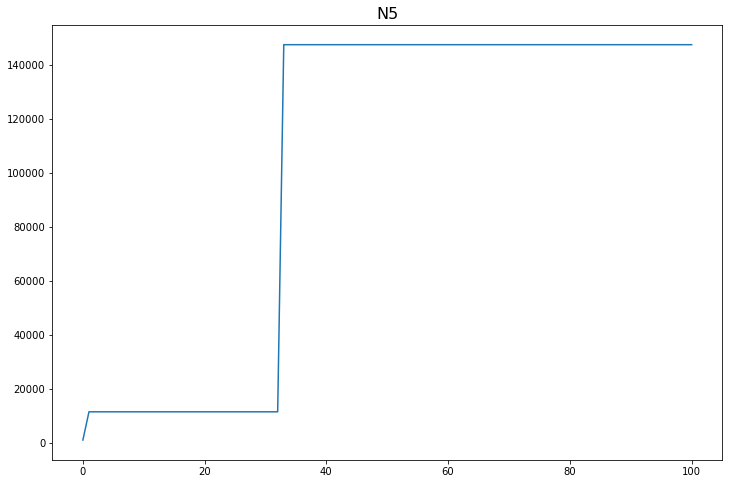

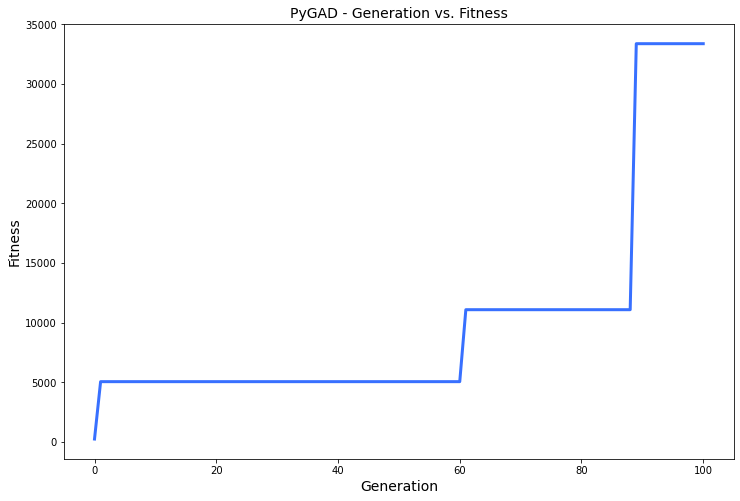

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 28.948 |==================| 44.639 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 28.884 |==================| 11.647 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 28.867 |==================| 9.672 |==========| N10 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 28.888 |==================| 12.132 |==========| N10 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 27.223 |==================| 29.943 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 27.199 |==================| 17.344 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 27.108 |==================| 6.729 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 27.098 |==================| 6.334 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 27.181 |==================| 13.379 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 27.188 |==================| 14.681 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 27.191 |==================| 15.375 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 27.173 |==================| 12.07 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 27.135 |==================| 8.245 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 27.15 |==================| 9.43 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 27.128 |==================| 7.78 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 27.096 |==================| 6.235 |==========| N7 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 27.121 |==================| 7.389 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 27.204 |==================| 19.248 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 27.104 |==================| 6.578 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 27.255 |==================| 740.203 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 27.084 |==================| 5.808 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 27.131 |==================| 7.974 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 27.142 |==================| 8.727 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 27.239 |==================| 59.438 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 27.117 |==================| 7.189 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 27.114 |==================| 7.057 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 27.184 |==================| 13.758 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 27.221 |==================| 28.164 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 27.063 |==================| 5.184 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 27.067 |==================| 5.279 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 27.157 |==================| 10.062 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 27.153 |==================| 9.738 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 27.199 |==================| 17.413 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 27.069 |==================| 5.341 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 27.211 |==================| 22.227 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 27.041 |==================| 4.654 |==========| N7 |==========
**********************************************************************
Fi

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 27.023 |==================| 4.284 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 27.164 |==================| 10.796 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 27.15 |==================| 9.386 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 27.252 |==================| 226.326 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 27.239 |==================| 58.664 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 27.134 |==================| 8.159 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 27.167 |==================| 11.16 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 27.048 |==================| 4.802 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 27.08 |==================| 5.671 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 27.22 |==================| 27.425 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 27.192 |==================| 15.666 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 27.06 |==================| 5.093 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 27.211 |==================| 22.119 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 27.018 |==================| 4.206 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 27.11 |==================| 6.855 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 27.068 |==================| 5.305 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 27.1 |==================| 6.423 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 27.027 |==================| 4.367 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 27.031 |==================| 4.446 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 27.222 |==================| 28.852 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 27.086 |==================| 5.877 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 27.249 |==================| 130.338 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 27.135 |==================| 8.218 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 27.198 |==================| 17.332 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 27.187 |==================| 14.533 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 27.115 |==================| 7.059 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 27.087 |==================| 5.898 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 27.111 |==================| 6.88 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 27.213 |==================| 23.148 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 27.224 |==================| 30.951 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 27.167 |==================| 11.241 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 27.049 |==================| 4.833 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 27.161 |==================| 10.51 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 27.21 |==================| 21.801 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 27.168 |==================| 11.37 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 27.138 |==================| 8.426 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 27.141 |==================| 8.691 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.177 |==================| 12.681 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 27.114 |==================| 7.045 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 27.07 |==================| 5.383 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 27.104 |==================| 6.571 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 27.103 |==================| 6.53 |==========| N7 |==========
**********************************************************************
Generation = 7
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 27.214 |==================| 23.89 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 27.064 |==================| 5.198 |==========| N7 |==========
***************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 27.205 |==================| 19.546 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 27.106 |==================| 6.642 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 27.029 |==================| 4.392 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 27.024 |==================| 4.303 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 27.169 |==================| 11.533 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 27.051 |==================| 4.88 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 27.183 |==================| 13.727 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 27.047 |==================| 4.783 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 27.026 |==================| 4.335 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 27.085 |==================| 5.825 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 27.021 |==================| 4.261 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 27.165 |==================| 10.911 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 27.189 |==================| 14.97 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 27.167 |==================| 11.175 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 27.018 |==================| 4.207 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 27.143 |==================| 8.853 |==========| N7 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 27.241 |==================| 64.787 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 27.204 |==================| 18.982 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 27.22 |==================| 27.578 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 27.132 |==================| 8.066 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 27.137 |==================| 8.414 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 27.19 |==================| 15.212 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 27.095 |==================| 6.202 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 27.067 |==================| 5.295 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 27.07 |==================| 5.361 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 27.128 |==================| 7.772 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 27.044 |==================| 4.723 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 27.146 |==================| 9.049 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 27.078 |==================| 5.609 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 27.044 |==================| 4.717 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 27.085 |==================| 5.848 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.191 |==================| 15.254 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 27.1 |==================| 6.389 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 27.172 |==================| 11.888 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 27.206 |==================| 19.856 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 27.043 |==================| 4.69 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 27.173 |==================| 11.95 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 27.231 |==================| 39.7 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 27.171 |==================| 11.675 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 27.07 |==================| 5.36 |==========| N7 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 27.249 |==================| 130.805 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 27.218 |==================| 25.963 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 27.189 |==================| 14.966 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 27.081 |==================| 5.712 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 27.021 |==================| 4.258 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 27.104 |==================| 6.578 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 27.151 |==================| 9.491 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 27.016 |==================| 4.168 |==========| N7 |==========
**********************************************************************
Fitne

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 27.082 |==================| 5.755 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 27.041 |==================| 4.656 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 27.139 |==================| 8.515 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 27.181 |==================| 13.338 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 27.067 |==================| 5.296 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 27.135 |==================| 8.259 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 27.09 |==================| 6.005 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 27.102 |==================| 6.5 |==========| N7 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 27.102 |==================| 6.489 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 27.058 |==================| 5.054 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 27.027 |==================| 4.36 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 27.101 |==================| 6.444 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 27.087 |==================| 5.915 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 27.183 |==================| 13.755 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 27.172 |==================| 11.926 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 27.052 |==================| 4.897 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 27.159 |==================| 10.332 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 27.029 |==================| 4.398 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 27.093 |==================| 6.13 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 27.148 |==================| 9.277 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 27.132 |==================| 8.024 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 27.249 |==================| 140.641 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 27.079 |==================| 5.656 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 27.256 |==================| 1778.282 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 27.029 |==================| 4.409 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 27.214 |==================| 23.775 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 27.137 |==================| 8.397 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 27.07 |==================| 5.384 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 27.245 |==================| 86.986 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 27.139 |==================| 8.553 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 27.094 |==================| 6.17 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 27.163 |==================| 10.761 |==========| N7 |==========
**********************************************************************
Gen

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 27.231 |==================| 39.299 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 27.144 |==================| 8.894 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 27.099 |==================| 6.373 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 27.132 |==================| 8.082 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 27.177 |==================| 12.653 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 27.141 |==================| 8.707 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 27.134 |==================| 8.184 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 27.123 |==================| 7.51 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 27.025 |==================| 4.316 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 27.119 |==================| 7.3 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 27.107 |==================| 6.685 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 27.188 |==================| 14.639 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 27.094 |==================| 6.16 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 27.05 |==================| 4.843 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 27.233 |==================| 44.049 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 27.254 |==================| 396.161 |==========| N7 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 27.037 |==================| 4.556 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 27.198 |==================| 17.214 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 27.04 |==================| 4.631 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 27.105 |==================| 6.601 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 27.084 |==================| 5.797 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.217 |==================| 25.519 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 27.142 |==================| 8.785 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 27.247 |==================| 110.745 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 27.251 |==================| 187.049 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 27.145 |==================| 8.961 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 27.225 |==================| 32.312 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 27.102 |==================| 6.471 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 27.032 |==================| 4.452 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 27.155 |==================| 9.906 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 27.029 |==================| 4.405 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 27.054 |==================| 4.956 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 27.138 |==================| 8.437 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 27.11 |==================| 6.838 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 27.196 |==================| 16.712 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 27.198 |==================| 17.279 |==========| N7 |==========
**********************************************************************
====

======| 0.105 |===========| 27.231 |==================| 40.002 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 27.235 |==================| 48.222 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 27.177 |==================| 12.576 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 27.188 |==================| 14.625 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 27.045 |==================| 4.731 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 27.229 |==================| 37.459 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 27.046 |==================| 4.758 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 27.237 |==================| 51.324 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 27.069 |==================| 5.33 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 27.195 |==================| 16.272 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 27.246 |==================| 98.708 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 27.154 |==================| 9.809 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 27.092 |==================| 6.08 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 27.252 |==================| 262.79 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 27.112 |==================| 6.939 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 27.147 |==================| 9.182 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 27.165 |==================| 10.984 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 27.05 |==================| 4.855 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 27.167 |==================| 11.205 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 27.069 |==================| 5.337 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 27.162 |==================| 10.652 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 27.184 |==================| 13.813 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 27.076 |==================| 5.563 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 27.199 |==================| 17.516 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 27.037 |==================| 4.556 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 27.036 |==================| 4.535 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 27.236 |==================| 48.516 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 27.229 |==================| 36.801 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.196 |==================| 16.658 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 27.149 |==================| 9.294 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 27.223 |==================| 29.761 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.217 |==================| 25.485 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 27.029 |==================| 4.41 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 27.227 |==================| 33.75 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 27.25 |==================| 174.82 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 27.027 |==================| 4.361 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 27.206 |==================| 20.082 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 27.221 |==================| 28.631 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 27.039 |==================| 4.606 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 27.171 |==================| 11.678 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 27.19 |==================| 15.132 |==========| N7 |==========
**********************************************************************
Generation = 21
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 27.244 |==================| 79.626 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 27.114 |==================| 7.011 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 27.153 |==================| 9.731 |==========| N7 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 27.102 |==================| 6.479 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 27.028 |==================| 4.39 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 27.15 |==================| 9.426 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 27.112 |==================| 6.942 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 27.131 |==================| 8.019 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 27.217 |==================| 25.69 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 27.242 |==================| 68.288 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 27.112 |==================| 6.939 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.185 |==================| 14.044 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 27.142 |==================| 8.764 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 27.053 |==================| 4.927 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 27.034 |==================| 4.499 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 27.109 |==================| 6.81 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 27.203 |==================| 18.747 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 27.169 |==================| 11.515 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 27.211 |==================| 22.081 |==========| N7 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 27.04 |==================| 4.632 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 27.102 |==================| 6.474 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 27.232 |==================| 42.195 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 27.102 |==================| 6.468 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 27.252 |==================| 228.613 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 27.16 |==================| 10.418 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 27.089 |==================| 5.996 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 27.183 |==================| 13.664 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 27.246 |==================| 97.828 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 27.151 |==================| 9.515 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 27.073 |==================| 5.452 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 27.138 |==================| 8.428 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 27.107 |==================| 6.685 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 27.249 |==================| 145.388 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 27.03 |==================| 4.413 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 27.049 |==================| 4.828 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 27.131 |==================| 7.98 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 27.195 |==================| 16.467 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 27.252 |==================| 264.859 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 27.175 |==================| 12.359 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 27.058 |==================| 5.054 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 27.057 |==================| 5.016 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 27.074 |==================| 5.497 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 27.1 |==================| 6.411 |==========| N7 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 27.21 |==================| 21.503 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 27.121 |==================| 7.393 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 27.194 |==================| 16.057 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 27.127 |==================| 7.715 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 27.079 |==================| 5.633 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 27.146 |==================| 9.096 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 27.176 |==================| 12.498 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 27.08 |==================| 5.668 |==========| N7 |==========
**********************************************************************
Fitne

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 27.064 |==================| 5.209 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 27.036 |==================| 4.543 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 27.131 |==================| 7.965 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 27.019 |==================| 4.21 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 27.147 |==================| 9.173 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 27.208 |==================| 20.782 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 27.108 |==================| 6.743 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 27.248 |==================| 115.585 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 27.075 |==================| 5.509 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 27.196 |==================| 16.487 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 27.228 |==================| 35.855 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 27.22 |==================| 27.83 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 27.157 |==================| 10.037 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 27.111 |==================| 6.9 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 27.171 |==================| 11.768 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 27.225 |==================| 32.488 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 27.143 |==================| 8.831 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 27.046 |==================| 4.757 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 27.043 |==================| 4.699 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 27.176 |==================| 12.46 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 27.054 |==================| 4.948 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 27.175 |==================| 12.258 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 27.072 |==================| 5.428 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 27.22 |==================| 27.938 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 27.164 |==================| 10.792 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 27.141 |==================| 8.716 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 27.206 |==================| 19.841 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.189 |==================| 14.855 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 27.175 |==================| 12.389 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 27.029 |==================| 4.407 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 27.119 |==================| 7.304 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 27.11 |==================| 6.855 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 27.208 |==================| 20.606 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 27.239 |==================| 58.955 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 27.185 |==================| 13.949 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 27.243 |==================| 75.363 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 27.102 |==================| 6.484 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 27.116 |==================| 7.14 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 27.044 |==================| 4.717 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 27.226 |==================| 33.26 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 27.212 |==================| 22.491 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 27.073 |==================| 5.449 |==========| N7 |==========
**********************************************************************
Generation = 29
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 27.068 |==================| 5.32 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 27.155 |==================| 9.903 |==========| N7 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 27.05 |==================| 4.846 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 27.108 |==================| 6.765 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 27.169 |==================| 11.505 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 27.182 |==================| 13.491 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 27.254 |==================| 376.69 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 27.026 |==================| 4.35 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 27.196 |==================| 16.58 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 27.227 |==================| 34.457 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.166 |==================| 11.065 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.189 |==================| 14.848 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 27.083 |==================| 5.775 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 27.032 |==================| 4.455 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 27.143 |==================| 8.855 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 27.089 |==================| 5.967 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 27.167 |==================| 11.214 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 27.09 |==================| 6.022 |==========| N7 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 27.215 |==================| 24.367 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 27.198 |==================| 17.331 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 27.134 |==================| 8.177 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 27.067 |==================| 5.293 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 27.159 |==================| 10.267 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 27.25 |==================| 162.501 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 27.211 |==================| 22.29 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 27.061 |==================| 5.133 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 27.224 |==================| 31.372 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 27.108 |==================| 6.733 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 27.088 |==================| 5.957 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 27.153 |==================| 9.718 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 27.196 |==================| 16.548 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 27.215 |==================| 24.502 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 27.137 |==================| 8.357 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 27.128 |==================| 7.812 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 27.024 |==================| 4.316 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 27.222 |==================| 28.989 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 27.023 |==================| 4.295 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 27.229 |==================| 36.831 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 27.153 |==================| 9.705 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 27.025 |==================| 4.333 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 27.097 |==================| 6.287 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 27.189 |==================| 14.899 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 27.246 |==================| 94.32 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 27.203 |==================| 18.652 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 27.113 |==================| 6.988 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 27.026 |==================| 4.346 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 27.172 |==================| 11.818 |==========| N7 |==========
**********************************************************************
Fitness = 1778.28216283639
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 27.227 |==================| 34.049 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 27.109 |==================| 6.793 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 27.246 |==================| 93.758 |==========| N7 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 27.126 |==================| 7.656 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 27.168 |==================| 11.387 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 27.183 |==================| 13.588 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 27.216 |==================| 24.822 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 27.234 |==================| 44.145 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 27.208 |==================| 20.716 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 27.133 |==================| 8.14 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 27.104 |==================| 6.556 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 27.087 |==================| 5.906 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 27.082 |==================| 5.756 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 27.132 |==================| 8.047 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 27.092 |==================| 6.089 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 27.141 |==================| 8.676 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 27.23 |==================| 38.492 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 27.254 |==================| 498.486 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 27.05 |==================| 4.842 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 27.132 |==================| 8.038 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 27.214 |==================| 23.98 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 27.015 |==================| 4.147 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 27.126 |==================| 7.7 |==========| N7 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 27.224 |==================| 30.675 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 27.101 |==================| 6.453 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 27.242 |==================| 72.956 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 27.122 |==================| 7.443 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 27.029 |==================| 4.396 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 27.034 |==================| 4.507 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 27.131 |==================| 7.979 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 27.046 |==================| 4.754 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 27.183 |==================| 13.624 |==========| N7 |==========
**********************************************************************
Generation = 36
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 27.088 |==================| 5.934 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 27.053 |==================| 4.912 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 27.206 |==================| 20.032 |==========| N7 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 27.067 |==================| 5.273 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 27.209 |==================| 21.363 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 27.089 |==================| 5.984 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 27.134 |==================| 8.193 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 27.153 |==================| 9.653 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 27.177 |==================| 12.629 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 27.139 |==================| 8.517 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 27.222 |==================| 29.145 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 27.077 |==================| 5.591 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 27.112 |==================| 6.923 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 27.143 |==================| 8.806 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 27.084 |==================| 5.797 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 27.17 |==================| 11.549 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 27.132 |==================| 8.081 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 27.019 |==================| 4.221 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 27.126 |==================| 7.692 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 27.039 |==================| 4.609 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 27.047 |==================| 4.786 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 27.219 |==================| 26.902 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 27.025 |==================| 4.322 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 27.029 |==================| 4.41 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 27.078 |==================| 5.602 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 27.098 |==================| 6.314 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 27.05 |==================| 4.854 |==========| N7 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 27.125 |==================| 7.647 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 27.136 |==================| 8.297 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 27.179 |==================| 13.015 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 27.243 |==================| 73.125 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 27.166 |==================| 11.089 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 27.086 |==================| 5.883 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 27.092 |==================| 6.092 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 27.068 |==================| 5.321 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 27.196 |==================| 16.542 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 27.058 |==================| 5.036 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 27.118 |==================| 7.249 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 27.105 |==================| 6.628 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 27.204 |==================| 19.074 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 27.237 |==================| 51.55 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 27.157 |==================| 10.061 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 27.193 |==================| 15.715 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 27.151 |==================| 9.505 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.185 |==================| 14.082 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 27.236 |==================| 49.133 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 27.183 |==================| 13.702 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 27.124 |==================| 7.555 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 27.135 |==================| 8.22 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 27.164 |==================| 10.809 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 27.015 |==================| 4.151 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 27.187 |==================| 14.35 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 27.038 |==================| 4.578 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 27.092 |==================| 6.088 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 27.083 |==================| 5.775 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 27.052 |==================| 4.904 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 27.077 |==================| 5.574 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 27.161 |==================| 10.456 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 27.114 |==================| 7.018 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 27.129 |==================| 7.876 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 27.043 |==================| 4.681 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 27.175 |==================| 12.267 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.25 |==================| 167.928 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 27.139 |==================| 8.544 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 27.171 |==================| 11.767 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 27.198 |==================| 17.168 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 27.179 |==================| 13.015 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 27.059 |==================| 5.072 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 27.079 |==================| 5.631 |==========| N7 |==========
**********************************************************************
Generation = 42
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 27.025 |==================| 4.324 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 27.175 |==================| 12.302 |==========| N7 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 27.216 |==================| 24.928 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 27.143 |==================| 8.826 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 27.078 |==================| 5.61 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 27.233 |==================| 42.679 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 27.019 |==================| 4.209 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 27.199 |==================| 17.564 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 27.031 |==================| 4.448 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 27.174 |==================| 12.221 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 27.096 |==================| 6.259 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 27.019 |==================| 4.215 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 27.221 |==================| 28.27 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 27.019 |==================| 4.212 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 27.215 |==================| 24.417 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 27.235 |==================| 47.563 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 27.145 |==================| 9.006 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 27.173 |==================| 11.991 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 27.164 |==================| 10.872 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 27.231 |==================| 40.392 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 27.034 |==================| 4.509 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 27.066 |==================| 5.248 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 27.157 |==================| 10.035 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 27.017 |==================| 4.181 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 27.039 |==================| 4.608 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 27.127 |==================| 7.736 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 27.193 |==================| 15.888 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 27.037 |==================| 4.562 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 27.177 |==================| 12.571 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 27.157 |==================| 10.035 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 27.149 |==================| 9.342 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 27.093 |==================| 6.11 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 27.153 |==================| 9.672 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 27.054 |==================| 4.935 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 27.201 |==================| 18.194 |==========| N7 |==========
**********************************************************************
Fitness = 1778.28216283639
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 27.204 |==================| 18.987 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 27.186 |==================| 14.304 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 27.025 |==================| 4.334 |==========| N7 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 27.211 |==================| 22.251 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 27.183 |==================| 13.636 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 27.122 |==================| 7.44 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 27.115 |==================| 7.076 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 27.193 |==================| 15.796 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 27.188 |==================| 14.758 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 27.096 |==================| 6.258 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 27.064 |==================| 5.206 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 27.228 |==================| 35.644 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 27.075 |==================| 5.516 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 27.069 |==================| 5.351 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.182 |==================| 13.407 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 27.221 |==================| 28.759 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 27.218 |==================| 26.396 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 27.148 |==================| 9.237 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 27.171 |==================| 11.757 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 27.025 |==================| 4.317 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 27.104 |==================| 6.555 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 27.111 |==================| 6.887 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 27.211 |==================| 21.909 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 27.249 |==================| 138.43 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 27.198 |==================| 17.248 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 27.159 |==================| 10.264 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 27.234 |==================| 45.053 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 27.239 |==================| 59.618 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 27.129 |==================| 7.884 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 27.1 |==================| 6.386 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 27.046 |==================| 4.748 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 27.069 |==================| 5.356 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 27.204 |==================| 19.249 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 27.157 |==================| 10.114 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 27.112 |==================| 6.956 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 27.183 |==================| 13.582 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 27.054 |==================| 4.935 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 27.07 |==================| 5.361 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 27.115 |==================| 7.066 |==========| N7 |==========
***************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 27.086 |==================| 5.866 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 27.243 |==================| 77.349 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 27.074 |==================| 5.487 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 27.029 |==================| 4.399 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 27.104 |==================| 6.556 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 27.107 |==================| 6.681 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 27.226 |==================| 33.528 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 27.109 |==================| 6.786 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 27.22 |==================| 27.888 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 27.211 |==================| 22.256 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 27.192 |==================| 15.621 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 27.226 |==================| 32.744 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 27.096 |==================| 6.239 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 27.022 |==================| 4.272 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 27.233 |==================| 43.055 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 27.032 |==================| 4.457 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 27.167 |==================| 11.215 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 27.059 |==================| 5.061 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 27.19 |==================| 15.013 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 27.217 |==================| 25.56 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 27.068 |==================| 5.31 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 27.05 |==================| 4.85 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 27.021 |==================| 4.261 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 27.082 |==================| 5.734 |==========| N7 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 27.111 |==================| 6.904 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 27.098 |==================| 6.332 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 27.045 |==================| 4.726 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 27.136 |==================| 8.353 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 27.201 |==================| 18.169 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 27.16 |==================| 10.406 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 27.152 |==================| 9.554 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 27.176 |==================| 12.399 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 27.065 |==================| 5.232 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 27.033 |==================| 4.478 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 27.201 |==================| 18.061 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 27.104 |==================| 6.553 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 27.107 |==================| 6.721 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 27.182 |==================| 13.54 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 27.158 |==================| 10.155 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 27.233 |==================| 43.609 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 27.025 |==================| 4.333 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 27.237 |==================| 52.992 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 27.119 |==================| 7.308 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 27.055 |==================| 4.968 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 27.2 |==================| 17.736 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 27.058 |==================| 5.038 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 27.141 |==================| 8.675 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 27.251 |==================| 200.556 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 27.234 |==================| 44.53 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 27.017 |==================| 4.188 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 27.164 |==================| 10.8 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 27.249 |==================| 132.533 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 27.034 |==================| 4.504 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 27.163 |==================| 10.723 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 27.082 |==================| 5.726 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 27.099 |==================| 6.36 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 27.086 |==================| 5.883 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 27.234 |==================| 46.006 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 27.037 |==================| 4.563 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 27.121 |==================| 7.402 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 27.128 |==================| 7.816 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 27.073 |==================| 5.473 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 27.044 |==================| 4.715 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 27.083 |==================| 5.791 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 27.04 |==================| 4.618 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 27.016 |==================| 4.159 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 27.027 |==================| 4.367 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 27.041 |==================| 4.639 |==========| N7 |==========
**********************************************************************
Change

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 27.196 |==================| 16.526 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 27.083 |==================| 5.771 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 27.185 |==================| 14.019 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 27.191 |==================| 15.423 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 27.025 |==================| 4.333 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 27.042 |==================| 4.666 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 27.22 |==================| 27.434 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 27.123 |==================| 7.534 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 27.144 |==================| 8.908 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 27.228 |==================| 35.623 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 27.089 |==================| 5.996 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 27.246 |==================| 101.078 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 27.124 |==================| 7.542 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 27.126 |==================| 7.669 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 27.196 |==================| 16.507 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 27.11 |==================| 6.857 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 27.035 |==================| 4.524 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 27.076 |==================| 5.561 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 27.135 |==================| 8.274 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.201 |==================| 18.283 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 27.137 |==================| 8.374 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 27.089 |==================| 5.978 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 27.089 |==================| 5.994 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 27.167 |==================| 11.191 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 27.224 |==================| 31.061 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 27.03 |==================| 4.426 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 27.253 |==================| 357.696 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 27.217 |==================| 25.664 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 27.016 |==================| 4.156 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 27.134 |==================| 8.169 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 27.231 |==================| 40.354 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 27.101 |==================| 6.441 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 27.018 |==================| 4.192 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 27.074 |==================| 5.493 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 27.158 |==================| 10.151 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 27.231 |==================| 39.842 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 27.133 |==================| 8.122 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 27.17 |==================| 11.58 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 27.157 |==================| 10.098 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 27.185 |==================| 14.011 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 27.021 |==================| 4.259 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 27.119 |==================| 7.277 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 27.1 |==================| 6.417 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 27.046 |==================| 4.763 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 27.085 |==================| 5.84 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 27.206 |==================| 20.123 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 27.225 |==================| 31.702 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 27.171 |==================| 11.798 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 27.198 |==================| 17.226 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 27.13 |==================| 7.948 |==========| N7 |==========
**********************************************************************
Generation = 59
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 27.116 |==================| 7.14 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 27.207 |==================| 20.346 |==========| N7 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 27.184 |==================| 13.801 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 27.016 |==================| 4.164 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 27.201 |==================| 18.272 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 27.154 |==================| 9.746 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 27.039 |==================| 4.602 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 27.06 |==================| 5.108 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 27.115 |==================| 7.061 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 27.071 |==================| 5.406 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 27.241 |==================| 64.359 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 27.079 |==================| 5.65 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 27.216 |==================| 24.982 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 27.24 |==================| 62.311 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 27.099 |==================| 6.362 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 27.113 |==================| 7.006 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 27.028 |==================| 4.377 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 27.178 |==================| 12.867 |==========| N7 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 27.203 |==================| 18.742 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 27.241 |==================| 65.318 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 27.121 |==================| 7.403 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 27.112 |==================| 6.913 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 27.242 |==================| 69.818 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 27.231 |==================| 40.202 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 27.141 |==================| 8.662 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 27.178 |==================| 12.769 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 27.2 |==================| 17.712 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 27.08 |==================| 5.662 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 27.157 |==================| 10.099 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 27.172 |==================| 11.895 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 27.187 |==================| 14.481 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 27.091 |==================| 6.051 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 27.148 |==================| 9.238 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 27.226 |==================| 33.018 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 27.17 |==================| 11.641 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 27.09 |==================| 6.027 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 27.07 |==================| 5.372 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 27.021 |==================| 4.257 |==========| N7 |==========
**********************************************************************
Fitness

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 27.117 |==================| 7.192 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 27.209 |==================| 21.14 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 27.248 |==================| 120.343 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 27.23 |==================| 38.638 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 27.177 |==================| 12.595 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 27.183 |==================| 13.627 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 27.227 |==================| 34.552 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 27.066 |==================| 5.246 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 27.106 |==================| 6.636 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 27.124 |==================| 7.559 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 27.213 |==================| 23.1 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 27.035 |==================| 4.52 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 27.144 |==================| 8.935 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 27.134 |==================| 8.152 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 27.218 |==================| 26.049 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 27.111 |==================| 6.898 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 27.226 |==================| 33.457 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 27.12 |==================| 7.345 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 27.24 |==================| 61.747 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 27.253 |==================| 279.012 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 27.108 |==================| 6.768 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.196 |==================| 16.672 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 27.235 |==================| 47.33 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 27.02 |==================| 4.236 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 27.034 |==================| 4.5 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.166 |==================| 11.077 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 27.055 |==================| 4.958 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 27.12 |==================| 7.361 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 27.134 |==================| 8.181 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 27.127 |==================| 7.711 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 27.077 |==================| 5.582 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 27.142 |==================| 8.758 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 27.24 |==================| 61.252 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 27.089 |==================| 5.999 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 27.154 |==================| 9.813 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 27.087 |==================| 5.897 |==========| N7 |==========
**********************************************************************
Chan

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 27.021 |==================| 4.244 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 27.072 |==================| 5.425 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 27.221 |==================| 28.26 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 27.241 |==================| 63.968 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 27.089 |==================| 5.975 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 27.19 |==================| 15.201 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 27.104 |==================| 6.561 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 27.033 |==================| 4.487 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 27.163 |==================| 10.783 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 27.049 |==================| 4.825 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 27.029 |==================| 4.397 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 27.168 |==================| 11.367 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 27.095 |==================| 6.201 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 27.17 |==================| 11.543 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 27.185 |==================| 13.999 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 27.033 |==================| 4.472 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.25 |==================| 169.991 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.129 |==================| 7.843 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 27.078 |==================| 5.61 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 27.105 |==================| 6.619 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 27.224 |==================| 30.75 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 27.156 |==================| 9.951 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 27.185 |==================| 14.021 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 27.088 |==================| 5.949 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 27.186 |==================| 14.192 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 27.018 |==================| 4.2 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 27.048 |==================| 4.813 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 27.244 |==================| 83.158 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 27.256 |==================| 4763.034 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 27.065 |==================| 5.22 |==========| N7 |==========
**********************************************************************
Fitness = 4763.033735543291
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 27.248 |==================| 127.326 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 27.186 |==================| 14.192 |==========| N7 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 27.256 |==================| 1581.995 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 27.137 |==================| 8.401 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 27.154 |==================| 9.799 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 27.088 |==================| 5.959 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 27.197 |==================| 16.951 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 27.059 |==================| 5.079 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 27.075 |==================| 5.51 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 27.132 |==================| 8.071 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 27.072 |==================| 5.426 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 27.038 |==================| 4.591 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 27.026 |==================| 4.351 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 27.168 |==================| 11.329 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 27.053 |==================| 4.926 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 27.182 |==================| 13.514 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 27.133 |==================| 8.132 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 27.072 |==================| 5.426 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 27.176 |==================| 12.394 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 27.237 |==================| 52.086 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 27.171 |==================| 11.779 |==========| N7 |==========
**********************************************************************
Generation = 70
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 27.181 |==================| 13.369 |==========| N7 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 27.165 |==================| 10.925 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 27.231 |==================| 40.142 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 27.151 |==================| 9.543 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 27.207 |==================| 20.432 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 27.251 |==================| 200.723 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 27.237 |==================| 52.91 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 27.134 |==================| 8.179 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 27.098 |==================| 6.319 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 27.231 |==================| 39.892 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 27.188 |==================| 14.695 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 27.106 |==================| 6.679 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 27.154 |==================| 9.743 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 27.173 |==================| 12.068 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 27.25 |==================| 175.373 |==========| N7 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 27.177 |==================| 12.65 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 27.063 |==================| 5.185 |==========| N7 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 27.069 |==================| 5.341 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 27.156 |==================| 9.96 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 27.136 |==================| 8.309 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 27.106 |==================| 6.638 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 27.071 |==================| 5.391 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 27.03 |==================| 4.425 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 27.227 |==================| 34.811 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 27.07 |==================| 5.367 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 27.094 |==================| 6.151 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.196 |==================| 16.635 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 27.221 |==================| 28.785 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 27.071 |==================| 5.391 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 27.212 |==================| 22.731 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 27.05 |==================| 4.838 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 27.076 |==================| 5.559 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 27.173 |==================| 11.996 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 27.085 |==================| 5.83 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 27.022 |==================| 4.274 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.252 |==================| 248.076 |==========| N7 |==========
**********************************************************************
Fitness = 4763.033735543291
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 27.124 |==================| 7.583 |==========| N7 |==========
************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 27.23 |==================| 38.305 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 27.168 |==================| 11.323 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 27.135 |==================| 8.227 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 27.098 |==================| 6.331 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 27.017 |==================| 4.176 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 27.227 |==================| 33.861 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 27.058 |==================| 5.038 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 27.246 |==================| 99.34 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 27.2 |==================| 17.799 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 27.122 |==================| 7.43 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 27.131 |==================| 8.013 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 27.244 |==================| 79.471 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 27.138 |==================| 8.445 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 27.1 |==================| 6.395 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 27.104 |==================| 6.582 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 27.215 |==================| 24.51 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 27.045 |==================| 4.736 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 27.028 |==================| 4.381 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 27.122 |==================| 7.425 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 27.113 |==================| 6.97 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 27.016 |==================| 4.159 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 27.051 |==================| 4.876 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 27.176 |==================| 12.435 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 27.045 |==================| 4.736 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 27.114 |==================| 7.016 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 27.063 |==================| 5.177 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 27.1 |==================| 6.396 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 27.137 |==================| 8.385 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 27.209 |==================| 21.276 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 27.24 |==================| 63.629 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 27.111 |==================| 6.865 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 27.103 |==================| 6.539 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 27.145 |==================| 9.003 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 27.127 |==================| 7.733 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 27.046 |==================| 4.758 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 27.016 |==================| 4.163 |==========| N7 |==========
**********************************************************************
Chang

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 27.193 |==================| 15.84 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.182 |==================| 13.414 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 27.065 |==================| 5.223 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 27.19 |==================| 15.138 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 27.237 |==================| 51.984 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 27.064 |==================| 5.212 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 27.076 |==================| 5.535 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 27.218 |==================| 26.219 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 27.246 |==================| 93.804 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 27.043 |==================| 4.691 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 27.102 |==================| 6.488 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 27.237 |==================| 51.984 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 27.219 |==================| 26.601 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 27.256 |==================| 8101.422 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 27.221 |==================| 28.265 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 27.077 |==================| 5.592 |==========| N7 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 27.245 |==================| 87.359 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 27.225 |==================| 31.692 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 27.127 |==================| 7.738 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 27.138 |==================| 8.491 |==========| N7 |==========
**********************************************************************
Fi

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 27.147 |==================| 9.127 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 27.072 |==================| 5.43 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 27.233 |==================| 43.106 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 27.245 |==================| 87.359 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 27.237 |==================| 52.61 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 27.041 |==================| 4.652 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 27.067 |==================| 5.277 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 27.205 |==================| 19.695 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 27.034 |==================| 4.501 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 27.213 |==================| 23.108 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 27.083 |==================| 5.772 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 27.091 |==================| 6.066 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 27.059 |==================| 5.061 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 27.132 |==================| 8.059 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 27.042 |==================| 4.676 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 27.154 |==================| 9.759 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 27.175 |==================| 12.375 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 27.231 |==================| 39.012 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 27.112 |==================| 6.95 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 27.216 |==================| 24.893 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 27.063 |==================| 5.166 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.191 |==================| 15.261 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 27.194 |==================| 16.183 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 27.201 |==================| 18.136 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 27.078 |==================| 5.617 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 27.104 |==================| 6.565 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 27.113 |==================| 7.008 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 27.069 |==================| 5.351 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 27.216 |==================| 24.81 |==========| N7 |==========
**********************************************************************
Generation = 81
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 27.17 |==================| 11.61 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 27.146 |==================| 9.042 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 27.059 |==================| 5.062 |==========| N7 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 27.034 |==================| 4.494 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 27.224 |==================| 30.91 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 27.214 |==================| 23.466 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 27.216 |==================| 24.81 |==========| N7 |==========
**********************************************************************
Cha

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 27.025 |==================| 4.324 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 27.211 |==================| 22.088 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 27.111 |==================| 6.867 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 27.24 |==================| 62.78 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 27.166 |==================| 11.126 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 27.127 |==================| 7.75 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 27.219 |==================| 26.546 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 27.25 |==================| 156.525 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 27.045 |==================| 4.737 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 27.102 |==================| 6.48 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 27.159 |==================| 10.241 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 27.154 |==================| 9.741 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 27.054 |==================| 4.951 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 27.113 |==================| 7.007 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 27.177 |==================| 12.571 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 27.21 |==================| 21.515 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 27.063 |==================| 5.165 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 27.149 |==================| 9.356 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 27.146 |==================| 9.109 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 27.148 |==================| 9.215 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 27.223 |==================| 29.854 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 27.222 |==================| 29.546 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 27.076 |==================| 5.559 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 27.213 |==================| 22.936 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 27.136 |==================| 8.305 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.252 |==================| 244.595 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 27.082 |==================| 5.749 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 27.24 |==================| 62.039 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 27.06 |==================| 5.11 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 27.024 |==================| 4.307 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 27.066 |==================| 5.256 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 27.201 |==================| 17.97 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 27.25 |==================| 155.421 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 27.124 |==================| 7.56 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 27.159 |==================| 10.316 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 27.168 |==================| 11.39 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 27.034 |==================| 4.493 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 27.202 |==================| 18.49 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 27.192 |==================| 15.516 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 27.059 |==================| 5.062 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 27.028 |==================| 4.378 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 27.109 |==================| 6.772 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 27.176 |==================| 12.508 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 27.147 |==================| 9.153 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 27.024 |==================| 4.31 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 27.047 |==================| 4.779 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 27.022 |==================| 4.276 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 27.205 |==================| 19.6 |==========| N7 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 27.115 |==================| 7.094 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 27.052 |==================| 4.903 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 27.144 |==================| 8.908 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 27.17 |==================| 11.641 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 27.046 |==================| 4.759 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 27.239 |==================| 58.009 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 27.059 |==================| 5.076 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 27.201 |==================| 17.982 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 27.131 |==================| 7.978 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 27.155 |==================| 9.852 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 27.065 |==================| 5.238 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 27.113 |==================| 7.007 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 27.087 |==================| 5.909 |==========| N7 |==========
**********************************************************************
Generation = 87
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 27.076 |==================| 5.537 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 27.222 |==================| 29.517 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 27.196 |==================| 16.683 |==========| N7 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 27.151 |==================| 9.489 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 27.174 |==================| 12.161 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 27.06 |==================| 5.108 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 27.078 |==================| 5.615 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 27.222 |==================| 29.42 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 27.211 |==================| 21.968 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 27.086 |==================| 5.868 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 27.018 |==================| 4.203 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 27.095 |==================| 6.214 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 27.226 |==================| 33.166 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 27.069 |==================| 5.333 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 27.097 |==================| 6.274 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.252 |==================| 241.664 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 27.156 |==================| 10.027 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 27.146 |==================| 9.054 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 27.095 |==================| 6.214 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 27.125 |==================| 7.628 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 27.204 |==================| 19.311 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 27.108 |==================| 6.727 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 27.079 |==================| 5.644 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 27.198 |==================| 17.171 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 27.088 |==================| 5.959 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 27.238 |==================| 56.022 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.189 |==================| 14.837 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 27.214 |==================| 23.769 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 27.129 |==================| 7.893 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 27.183 |==================| 13.702 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 27.082 |==================| 5.735 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 27.019 |==================| 4.212 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 27.042 |==================| 4.672 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 27.228 |==================| 35.278 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 27.143 |==================| 8.812 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 27.019 |==================| 4.209 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 27.155 |==================| 9.913 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 27.121 |==================| 7.412 |==========| N7 |==========
**********************************************************************
Fitness = 8101.422384228586
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 27.223 |==================| 30.533 |==========| N7 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 27.163 |==================| 10.783 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 27.246 |==================| 102.944 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 27.225 |==================| 32.431 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 27.114 |==================| 7.013 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 27.16 |==================| 10.345 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 27.045 |==================| 4.728 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 27.016 |==================| 4.158 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 27.022 |==================| 4.264 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 27.059 |==================| 5.073 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 27.137 |==================| 8.381 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 27.067 |==================| 5.281 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 27.061 |==================| 5.11 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 27.165 |==================| 10.923 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 27.231 |==================| 39.578 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 27.052 |==================| 4.892 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 27.222 |==================| 29.604 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 27.018 |==================| 4.199 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 27.167 |==================| 11.18 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 27.256 |==================| 2799.836 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 27.105 |==================| 6.631 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 27.218 |==================| 26.202 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 27.092 |==================| 6.084 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 27.072 |==================| 5.44 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 27.185 |==================| 13.951 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 27.199 |==================| 17.533 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 27.195 |==================| 16.397 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 27.197 |==================| 16.895 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 27.115 |==================| 7.066 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 27.028 |==================| 4.389 |==========| N7 |==========
**********************************************************************
Generation = 93
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 27.155 |==================| 9.847 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 27.016 |==================| 4.156 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 27.23 |==================| 38.305 |==========| N7 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 27.238 |==================| 54.083 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 27.235 |==================| 46.242 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 27.098 |==================| 6.303 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 27.134 |==================| 8.206 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 27.063 |==================| 5.189 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 27.054 |==================| 4.948 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 27.246 |==================| 101.551 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 27.244 |==================| 81.37 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 27.116 |==================| 7.155 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 27.098 |==================| 6.333 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 27.079 |==================| 5.641 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 27.169 |==================| 11.511 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 27.155 |==================| 9.855 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 27.168 |==================| 11.279 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 27.216 |==================| 24.923 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 27.116 |==================| 7.155 |==========| N7 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 27.147 |==================| 9.171 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 27.044 |==================| 4.724 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 27.227 |==================| 34.009 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 27.088 |==================| 5.946 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 27.093 |==================| 6.146 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 27.184 |==================| 13.944 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 27.088 |==================| 5.931 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 27.244 |==================| 78.875 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 27.117 |==================| 7.17 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.177 |==================| 12.677 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 27.185 |==================| 13.979 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 27.093 |==================| 6.146 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 27.13 |==================| 7.906 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 27.037 |==================| 4.559 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 27.113 |==================| 6.987 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 27.058 |==================| 5.046 |==========| N7 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 27.245 |==================| 90.523 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 27.073 |==================| 5.447 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 27.107 |==================| 6.712 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 27.05 |==================| 4.849 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 27.095 |==================| 6.222 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 27.017 |==================| 4.185 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 27.039 |==================| 4.61 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 27.044 |==================| 4.709 |==========| N7 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 27.183 |==================| 13.601 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 27.16 |==================| 10.442 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 27.132 |==================| 8.03 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 27.101 |==================| 6.447 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 27.123 |==================| 7.536 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 27.035 |==================| 4.526 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 27.218 |==================| 26.309 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.166 |==================| 11.07 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 27.117 |==================| 7.177 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 27.184 |==================| 13.936 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 27.142 |==================| 8.745 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 27.071 |==================| 5.386 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 27.218 |==================| 26.53 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 27.206 |==================| 19.759 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 27.235 |==================| 46.18 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 27.078 |==================| 5.61 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 27.234 |==================| 44.948 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 27.169 |==================| 11.506 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 27.038 |==================| 4.583 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 27.047 |==================| 4.776 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 27.254 |==================| 571.47 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 27.197 |==================| 16.871 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 27.17 |==================| 11.63 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 27.234 |==================| 44.948 |==========| N7 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 27.11 |==================| 6.846 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 27.212 |==================| 22.637 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 27.243 |==================| 77.275 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 27.248 |==================| 124.534 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 27.202 |==================| 18.621 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 27.017 |==================| 4.182 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 27.098 |==================| 6.318 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 27.228 |==================| 35.026 |==========| N7 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 27.196 |==================| 16.676 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 27.213 |==================| 23.011 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 27.019 |==================| 4.217 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 27.181 |==================| 13.375 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 27.23 |==================| 38.7 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 27.23 |==================| 38.721 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 27.17 |==================| 11.609 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 27.239 |==================| 59.015 |==========| N7 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 27.163 |==================| 10.77 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 27.254 |==================| 423.984 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.189 |==================| 14.877 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 27.115 |==================| 7.08 |==========| N7 |==========
**********************************************************************
===

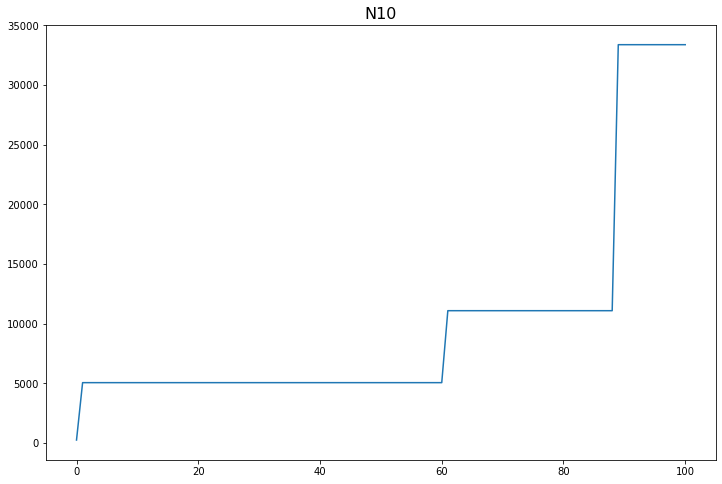

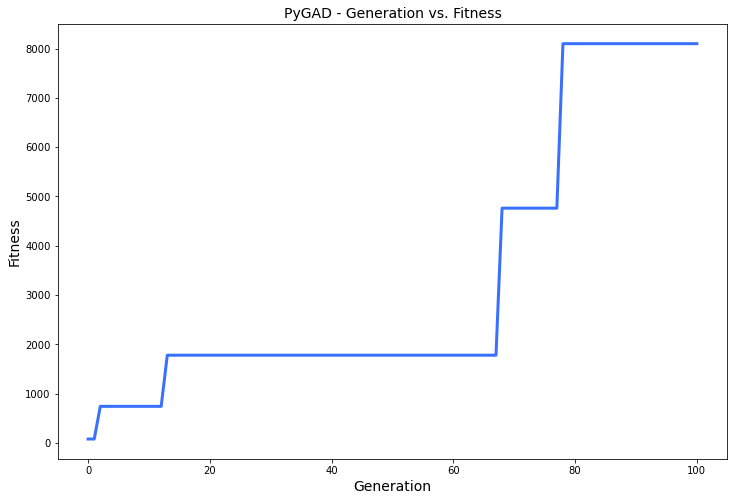

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 27.181 |==================| 13.375 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 27.131 |==================| 7.996 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 27.159 |==================| 10.288 |==========| N7 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 27.188 |==================| 14.626 |==========| N7 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 24.86 |==================| 21.861 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 24.845 |==================| 33.164 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 24.857 |==================| 23.655 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 24.84 |==================| 38.54 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.673 |===========| 24.776 |==================| 26.176 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.86 |===========| 24.766 |==================| 20.453 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.567 |===========| 24.782 |==================| 31.077 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 24.828 |==================| 72.431 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 24.831 |==================| 60.868 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 24.819 |==================| 219.002 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.494 |===========| 24.786 |==================| 35.711 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 24.862 |==================| 21.01 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 24.851 |==================| 27.507 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 24.837 |==================| 44.827 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.62 |===========| 24.779 |==================| 28.417 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 24.834 |==================| 51.545 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 24.834 |==================| 51.174 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.838 |===========| 24.767 |==================| 20.975 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.179 |===========| 24.804 |==================| 98.75 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.079 |===========| 24.81 |==================| 222.641 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.029 |===========| 24.813 |==================| 604.341 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.411 |===========| 24.791 |==================| 42.917 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 24.821 |==================| 153.544 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.005 |===========| 24.814 |==================| 3576.786 |==========| N2 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 24.825 |==================| 91.289 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 24.843 |==================| 35.364 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.962 |===========| 24.76 |==================| 18.25 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 24.835 |==================| 48.248 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 24.836 |==================| 46.906 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.679 |===========| 24.776 |==================| 25.945 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 24.856 |==================| 23.807 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.756 |===========| 24.771 |==================| 23.29 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 24.82 |==================| 168.192 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.823 |==================| 122.819 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.598 |===========| 24.781 |==================| 29.484 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.666 |===========| 24.777 |==================| 26.452 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 24.84 |==================| 39.17 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.101 |===========| 24.809 |==================| 174.407 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.488 |===========| 24.787 |==================| 36.112 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 24.815 |==================| 2235.364 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 24.854 |==================| 25.566 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.422 |===========| 24.791 |==================| 41.819 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.401 |===========| 24.792 |==================| 44.022 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.897 |===========| 24.763 |==================| 19.6 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.767 |===========| 24.771 |==================| 22.953 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 24.826 |==================| 84.554 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 24.86 |==================| 22.024 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 24.862 |==================| 21.101 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.27 |===========| 24.799 |==================| 65.382 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 24.829 |==================| 67.976 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 24.867 |==================| 19.057 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 24.831 |==================| 59.568 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.73 |===========| 24.773 |==================| 24.116 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 24.859 |==================| 22.661 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.832 |===========| 24.767 |==================| 21.144 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.321 |===========| 24.796 |==================| 55.039 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.153 |===========| 24.806 |==================| 115.875 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.847 |==================| 31.058 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 24.869 |==================| 18.484 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.368 |===========| 24.794 |==================| 47.965 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.611 |===========| 24.78 |==================| 28.841 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 24.852 |==================| 26.841 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 24.822 |==================| 126.807 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.789 |===========| 24.77 |==================| 22.307 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 24.828 |==================| 71.118 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.439 |===========| 24.79 |==================| 40.23 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 24.863 |==================| 20.387 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.86 |==================| 22.168 |==========| N2 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.512 |===========| 24.785 |==================| 34.452 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 24.854 |==================| 25.408 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.216 |===========| 24.802 |==================| 81.768 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 24.847 |==================| 30.45 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.918 |===========| 24.762 |==================| 19.146 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 24.828 |==================| 72.506 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 24.839 |==================| 41.166 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 24.827 |==================| 79.698 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.304 |===========| 24.797 |==================| 58.126 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.472 |===========| 24.788 |==================| 37.348 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 24.87 |==================| 17.967 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 24.817 |==================| 465.013 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.986 |===========| 24.758 |==================| 17.816 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.846 |===========| 24.766 |==================| 20.774 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 24.82 |==================| 181.079 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.372 |===========| 24.793 |==================| 47.402 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 24.816 |==================| 702.115 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 24.836 |==================| 45.819 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.681 |===========| 24.776 |==================| 25.856 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.046 |===========| 24.812 |==================| 382.974 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 24.828 |==================| 71.827 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.959 |===========| 24.76 |==================| 18.317 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.392 |===========| 24.792 |==================| 44.978 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.248 |===========| 24.8 |==================| 71.175 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.049 |===========| 24.812 |==================| 359.501 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.612 |===========| 24.78 |==================| 28.783 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 24.823 |==================| 110.235 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 24.815 |==================| 1795.581 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 24.819 |==================| 211.82 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 24.842 |==================| 36.666 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 24.844 |==================| 33.842 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.143 |===========| 24.806 |==================| 123.689 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.147 |===========| 24.806 |==================| 120.273 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 24.863 |==================| 20.669 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 24.823 |==================| 113.883 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.234 |===========| 24.801 |==================| 75.562 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.808 |===========| 24.768 |==================| 21.774 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 24.817 |==================| 438.876 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.573 |===========| 24.782 |==================| 30.75 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.976 |===========| 24.759 |==================| 18.001 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.244 |===========| 24.801 |==================| 72.569 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.624 |===========| 24.779 |==================| 28.215 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.117 |===========| 24.808 |==================| 150.682 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.954 |===========| 24.76 |==================| 18.416 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.331 |===========| 24.796 |==================| 53.315 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 24.867 |==================| 19.086 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 24.849 |==================| 28.687 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.85 |==================| 28.336 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 24.833 |==================| 53.11 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.166 |===========| 24.805 |==================| 106.845 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 24.834 |==================| 50.141 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 24.83 |==================| 65.546 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 24.822 |==================| 125.077 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.936 |===========| 24.761 |==================| 18.768 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.619 |===========| 24.779 |==================| 28.444 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 24.858 |==================| 22.777 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.394 |===========| 24.792 |==================| 44.746 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.639 |===========| 24.778 |==================| 27.544 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 24.855 |==================| 24.454 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.513 |===========| 24.785 |==================| 34.353 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.823 |==================| 123.232 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.793 |===========| 24.769 |==================| 22.194 |==========| N2 |==========
**********************************************************************
Generation = 12
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 24.83 |==================| 65.029 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 24.835 |==================| 48.996 |==========| N2 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 24.853 |==================| 25.722 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 24.839 |==================| 41.447 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.663 |===========| 24.777 |==================| 26.571 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.387 |===========| 24.792 |==================| 45.595 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.931 |===========| 24.761 |==================| 18.876 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.571 |===========| 24.782 |==================| 30.856 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 24.835 |==================| 47.848 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.036 |===========| 24.812 |==================| 490.077 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 24.845 |==================| 33.103 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 24.841 |==================| 37.042 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.107 |===========| 24.808 |==================| 165.529 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.446 |===========| 24.789 |==================| 39.547 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.296 |===========| 24.798 |==================| 59.663 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 24.843 |==================| 34.571 |==========| N2 |==========
**********************************************************************
Change = 1077.9031042972474
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.929 |===========| 24.762 |==================| 18.917 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 24.869 |==================| 18.359 |==========| N2 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.62 |===========| 24.779 |==================| 28.428 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 24.838 |==================| 42.565 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 24.86 |==================| 21.789 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.004 |===========| 24.814 |==================| 4654.689 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 24.833 |==================| 52.919 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.32 |===========| 24.796 |==================| 55.13 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.026 |===========| 24.813 |==================| 686.59 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.322 |===========| 24.796 |==================| 54.93 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.565 |===========| 24.782 |==================| 31.218 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 24.832 |==================| 57.831 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 24.832 |==================| 57.744 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.467 |===========| 24.788 |==================| 37.75 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.032 |===========| 24.813 |==================| 545.251 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 24.825 |==================| 96.668 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 24.821 |==================| 143.129 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 24.847 |==================| 30.375 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 24.855 |==================| 24.506 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 24.821 |==================| 147.775 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 24.834 |==================| 52.144 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 24.829 |==================| 68.593 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.847 |==================| 31.05 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 24.82 |==================| 183.85 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.15 |===========| 24.806 |==================| 117.602 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 24.856 |==================| 24.26 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.354 |===========| 24.794 |==================| 49.864 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.109 |===========| 24.808 |==================| 162.881 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 24.843 |==================| 35.241 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 24.848 |==================| 29.792 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.644 |===========| 24.778 |==================| 27.335 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.863 |==================| 20.723 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.975 |===========| 24.759 |==================| 18.004 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.088 |===========| 24.809 |==================| 200.071 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 24.857 |==================| 23.475 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.507 |===========| 24.786 |==================| 34.776 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.357 |===========| 24.794 |==================| 49.492 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.867 |==================| 19.114 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 24.851 |==================| 27.384 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.99 |===========| 24.758 |==================| 17.732 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.224 |===========| 24.802 |==================| 79.049 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.709 |===========| 24.774 |==================| 24.828 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.926 |===========| 24.762 |==================| 18.971 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 24.826 |==================| 84.685 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.98 |===========| 24.759 |==================| 17.924 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 24.864 |==================| 20.325 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 24.823 |==================| 112.287 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 24.834 |==================| 50.444 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 24.868 |==================| 18.825 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.806 |===========| 24.769 |==================| 21.808 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.013 |===========| 24.814 |==================| 1406.07 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.256 |===========| 24.8 |==================| 69.043 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 24.868 |==================| 18.582 |==========| N2 |==========
**********************************************************************
Generation = 18
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.942 |===========| 24.761 |==================| 18.648 |==========| N2 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 24.818 |==================| 266.16 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 24.82 |==================| 172.818 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 24.843 |==================| 34.48 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.907 |===========| 24.763 |==================| 19.371 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.679 |===========| 24.776 |==================| 25.925 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 2.003 |===========| 24.87 |==================| 17.926 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 24.825 |==================| 94.543 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.015 |===========| 24.814 |==================| 1150.228 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.518 |===========| 24.785 |==================| 34.015 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.28 |===========| 24.799 |==================| 63.021 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 24.849 |==================| 28.759 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 24.851 |==================| 26.969 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 24.857 |==================| 23.41 |==========| N2 |==========
**********************************************************************
Change = 636.2893167081338
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.945 |===========| 24.761 |==================| 18.582 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 24.833 |==================| 53.725 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.867 |===========| 24.765 |==================| 20.27 |==========| N2 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.864 |==================| 20.088 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 24.869 |==================| 18.193 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 24.829 |==================| 70.364 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 24.857 |==================| 23.41 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.032 |===========| 24.813 |==================| 553.134 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 24.842 |==================| 36.139 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.2 |===========| 24.803 |==================| 88.295 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 24.856 |==================| 23.943 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.562 |===========| 24.783 |==================| 31.336 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 24.844 |==================| 34.325 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 24.833 |==================| 53.186 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.487 |===========| 24.787 |==================| 36.228 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.859 |==================| 22.208 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 24.833 |==================| 53.62 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.059 |===========| 24.811 |==================| 298.624 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 24.863 |==================| 20.764 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.51 |===========| 24.786 |==================| 34.602 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.85 |==================| 28.052 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.276 |===========| 24.799 |==================| 63.976 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.842 |==================| 35.785 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.138 |===========| 24.807 |==================| 128.518 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 24.87 |==================| 17.962 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 24.822 |==================| 139.982 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.515 |===========| 24.785 |==================| 34.225 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 24.823 |==================| 112.331 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 24.861 |==================| 21.635 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.865 |===========| 24.765 |==================| 20.315 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 24.861 |==================| 21.307 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.576 |===========| 24.782 |==================| 30.596 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.059 |===========| 24.811 |==================| 300.76 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.087 |===========| 24.81 |==================| 203.41 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 24.828 |==================| 71.723 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 24.831 |==================| 61.649 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.631 |===========| 24.779 |==================| 27.931 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.423 |===========| 24.79 |==================| 41.682 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.992 |===========| 24.758 |==================| 17.694 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.821 |==================| 164.314 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 24.816 |==================| 852.06 |==========| N2 |==========
**********************************************************************
Generation = 23
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.143 |===========| 24.806 |==================| 123.875 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.573 |===========| 24.782 |==================| 30.763 |==========| N2 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 24.869 |==================| 18.421 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.399 |===========| 24.792 |==================| 44.205 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 24.835 |==================| 48.493 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 24.842 |==================| 36.839 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 24.822 |==================| 132.553 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 24.861 |==================| 21.485 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 24.829 |==================| 70.558 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 24.815 |==================| 1652.221 |==========| N2 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.529 |===========| 24.784 |==================| 33.325 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.107 |===========| 24.808 |==================| 165.699 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 24.861 |==================| 21.367 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.341 |===========| 24.795 |==================| 51.814 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 24.821 |==================| 152.792 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 24.852 |==================| 26.871 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.036 |===========| 24.812 |==================| 498.303 |==========| N2 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.859 |==================| 22.297 |==========| N2 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 24.86 |==================| 22.085 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.279 |===========| 24.799 |==================| 63.312 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 24.832 |==================| 58.298 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.634 |===========| 24.778 |==================| 27.799 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.071 |===========| 24.81 |==================| 250.883 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 24.816 |==================| 481.577 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 24.847 |==================| 30.647 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.745 |===========| 24.772 |==================| 23.608 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 24.861 |==================| 21.51 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.119 |===========| 24.808 |==================| 148.875 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 24.841 |==================| 37.536 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 24.836 |==================| 46.41 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.591 |===========| 24.781 |==================| 29.827 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 24.87 |==================| 18.062 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.806 |===========| 24.769 |==================| 21.832 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 24.863 |==================| 20.469 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.11 |===========| 24.808 |==================| 160.994 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 24.819 |==================| 227.921 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 24.83 |==================| 63.121 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.377 |===========| 24.793 |==================| 46.839 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 24.833 |==================| 52.527 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.947 |===========| 24.761 |==================| 18.548 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.877 |===========| 24.765 |==================| 20.043 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 24.865 |==================| 19.78 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 24.844 |==================| 33.44 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 24.838 |==================| 42.989 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 24.818 |==================| 265.187 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.585 |===========| 24.781 |==================| 30.117 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.952 |===========| 24.76 |==================| 18.46 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 24.86 |==================| 22.003 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.264 |===========| 24.799 |==================| 66.886 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 24.838 |==================| 42.203 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.235 |===========| 24.801 |==================| 75.067 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.686 |===========| 24.775 |==================| 25.662 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.195 |===========| 24.803 |==================| 90.639 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 24.843 |==================| 35.448 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.313 |===========| 24.797 |==================| 56.404 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.391 |===========| 24.792 |==================| 45.141 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 24.826 |==================| 83.408 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.597 |===========| 24.781 |==================| 29.53 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 24.82 |==================| 168.049 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 24.857 |==================| 23.286 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 24.863 |==================| 20.78 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 24.839 |==================| 40.145 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.762 |===========| 24.771 |==================| 23.083 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.481 |===========| 24.787 |==================| 36.633 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.514 |===========| 24.785 |==================| 34.318 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.852 |==================| 26.448 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 24.851 |==================| 27.491 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.518 |===========| 24.785 |==================| 34.053 |==========| N2 |==========
**********************************************************************
Generation = 29
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 24.815 |==================| 1836.037 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.679 |===========| 24.776 |==================| 25.943 |==========| N2 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 24.852 |==================| 26.909 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.932 |===========| 24.761 |==================| 18.855 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 24.85 |==================| 27.956 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.068 |===========| 24.811 |==================| 259.809 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.722 |===========| 24.773 |==================| 24.377 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.459 |===========| 24.788 |==================| 38.451 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.697 |===========| 24.775 |==================| 25.27 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 24.826 |==================| 83.939 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 24.868 |==================| 18.813 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 24.831 |==================| 59.423 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.519 |===========| 24.785 |==================| 33.985 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.29 |===========| 24.798 |==================| 60.839 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.289 |===========| 24.798 |==================| 61.221 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.144 |===========| 24.806 |==================| 122.604 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 24.826 |==================| 85.722 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.162 |===========| 24.805 |==================| 109.353 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.489 |===========| 24.787 |==================| 36.057 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.182 |===========| 24.804 |==================| 97.148 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.314 |===========| 24.797 |==================| 56.193 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 24.845 |==================| 32.83 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 24.816 |==================| 565.72 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 24.852 |==================| 26.335 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 24.834 |==================| 49.941 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.262 |===========| 24.8 |==================| 67.439 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.657 |===========| 24.777 |==================| 26.799 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 24.851 |==================| 27.081 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 24.827 |==================| 80.553 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.011 |===========| 24.814 |==================| 1630.142 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 24.837 |==================| 44.182 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.912 |===========| 24.763 |==================| 19.265 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 24.83 |==================| 63.877 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 24.819 |==================| 211.75 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 24.845 |==================| 33.238 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.895 |===========| 24.764 |==================| 19.645 |==========| N2 |==========
**********************************************************************
Fitness = 5290.978029466645
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 24.819 |==================| 236.081 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.686 |===========| 24.775 |==================| 25.671 |==========| N2 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 24.815 |==================| 1073.359 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.366 |===========| 24.794 |==================| 48.18 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 24.837 |==================| 44.182 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.497 |===========| 24.786 |==================| 35.471 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.234 |===========| 24.801 |==================| 75.496 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 24.834 |==================| 50.762 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.449 |===========| 24.789 |==================| 39.285 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 24.848 |==================| 29.458 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 24.849 |==================| 29.087 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 24.856 |==================| 23.813 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 24.867 |==================| 19.137 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 24.837 |==================| 45.071 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.361 |===========| 24.794 |==================| 48.895 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 24.869 |==================| 18.299 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 24.83 |==================| 62.65 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 24.816 |==================| 655.919 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 24.864 |==================| 20.163 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.261 |===========| 24.8 |==================| 67.631 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.442 |===========| 24.789 |==================| 39.951 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.259 |===========| 24.8 |==================| 68.121 |==========| N2 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.249 |===========| 24.8 |==================| 71.004 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.372 |===========| 24.793 |==================| 47.467 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 24.821 |==================| 159.522 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.123 |===========| 24.807 |==================| 144.387 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.757 |===========| 24.771 |==================| 23.231 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 24.847 |==================| 30.469 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.642 |===========| 24.778 |==================| 27.445 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.562 |===========| 24.783 |==================| 31.37 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 24.845 |==================| 33.015 |==========| N2 |==========
**********************************************************************
Generation = 35
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 24.831 |==================| 61.653 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.65 |===========| 24.778 |==================| 27.105 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 24.844 |==================| 34.06 |==========| N2 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.842 |==================| 36.248 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.409 |===========| 24.791 |==================| 43.146 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 24.837 |==================| 43.451 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 24.831 |==================| 58.615 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 24.857 |==================| 23.261 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 24.849 |==================| 29.33 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 24.855 |==================| 24.82 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 24.837 |==================| 43.86 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.839 |==================| 41.212 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.211 |===========| 24.802 |==================| 83.678 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.859 |==================| 22.314 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 24.832 |==================| 57.315 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.857 |==================| 23.378 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.913 |===========| 24.762 |==================| 19.237 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.842 |==================| 35.769 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 24.843 |==================| 34.978 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.122 |===========| 24.808 |==================| 144.932 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.987 |===========| 24.758 |==================| 17.793 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.721 |===========| 24.773 |==================| 24.399 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.985 |===========| 24.758 |==================| 17.826 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.245 |===========| 24.801 |==================| 72.242 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.524 |===========| 24.785 |==================| 33.663 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.527 |===========| 24.785 |==================| 33.433 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 24.834 |==================| 50.052 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 24.852 |==================| 26.613 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.134 |===========| 24.807 |==================| 132.164 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.759 |===========| 24.771 |==================| 23.167 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.867 |==================| 19.097 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 24.818 |==================| 258.072 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 24.853 |==================| 25.89 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 24.86 |==================| 21.706 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.392 |===========| 24.792 |==================| 44.984 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.867 |==================| 19.13 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.212 |===========| 24.802 |==================| 83.408 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.204 |===========| 24.803 |==================| 86.744 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.008 |===========| 24.814 |==================| 2116.63 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.476 |===========| 24.787 |==================| 37.052 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.395 |===========| 24.792 |==================| 44.691 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 24.844 |==================| 34.08 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.105 |===========| 24.809 |==================| 169.107 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 24.86 |==================| 21.932 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 24.84 |==================| 38.677 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 24.844 |==================| 33.326 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 24.833 |==================| 53.227 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 24.855 |==================| 24.934 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 24.855 |==================| 24.359 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 24.862 |==================| 21.162 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 24.863 |==================| 20.609 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 24.852 |==================| 26.854 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.64 |===========| 24.778 |==================| 27.542 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.791 |===========| 24.769 |==================| 22.232 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 24.826 |==================| 85.458 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.539 |===========| 24.784 |==================| 32.696 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.846 |==================| 31.666 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.177 |===========| 24.804 |==================| 100.051 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.518 |===========| 24.785 |==================| 34.065 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.734 |===========| 24.773 |==================| 23.968 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.835 |===========| 24.767 |==================| 21.057 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 24.842 |==================| 36.021 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 24.865 |==================| 19.713 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.583 |===========| 24.781 |==================| 30.219 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 24.847 |==================| 31.103 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 24.846 |==================| 31.496 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.171 |===========| 24.805 |==================| 103.147 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.513 |===========| 24.785 |==================| 34.364 |==========| N2 |==========
**********************************************************************
Generation = 41
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.823 |==================| 122.994 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.3 |===========| 24.797 |==================| 58.843 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.724 |===========| 24.773 |==================| 24.294 |==========| N2 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 24.833 |==================| 52.472 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.049 |===========| 24.812 |==================| 358.785 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 24.816 |==================| 482.33 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.524 |===========| 24.785 |==================| 33.649 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.744 |===========| 24.772 |==================| 23.65 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.844 |==================| 34.217 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.665 |===========| 24.777 |==================| 26.481 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 24.854 |==================| 24.949 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.127 |===========| 24.807 |==================| 139.387 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.314 |===========| 24.797 |==================| 56.267 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 24.849 |==================| 28.817 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.773 |===========| 24.77 |==================| 22.748 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 24.847 |==================| 31.12 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.965 |===========| 24.759 |==================| 18.192 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 24.832 |==================| 58.345 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.127 |===========| 24.807 |==================| 139.387 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.253 |===========| 24.8 |==================| 69.94 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.576 |===========| 24.782 |==================| 30.613 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.773 |===========| 24.77 |==================| 22.759 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 24.833 |==================| 54.479 |==========| N2 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 24.819 |==================| 236.322 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.261 |===========| 24.8 |==================| 67.773 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 24.836 |==================| 46.847 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 24.82 |==================| 165.733 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.671 |===========| 24.776 |==================| 26.224 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.471 |===========| 24.788 |==================| 37.462 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.55 |===========| 24.783 |==================| 32.027 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 24.841 |==================| 37.957 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.368 |===========| 24.794 |==================| 47.948 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.714 |===========| 24.774 |==================| 24.655 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 24.854 |==================| 25.437 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 24.822 |==================| 128.071 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 24.837 |==================| 45.221 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 24.842 |==================| 35.743 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.492 |===========| 24.786 |==================| 35.812 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 24.824 |==================| 107.269 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.678 |===========| 24.776 |==================| 25.961 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 24.822 |==================| 138.312 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.733 |===========| 24.773 |==================| 23.997 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.262 |===========| 24.8 |==================| 67.538 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.294 |===========| 24.798 |==================| 60.027 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.755 |===========| 24.772 |==================| 23.315 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.233 |===========| 24.801 |==================| 75.852 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.757 |===========| 24.771 |==================| 23.247 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.823 |==================| 121.983 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 24.84 |==================| 39.229 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 24.819 |==================| 197.006 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.866 |==================| 19.289 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.452 |===========| 24.789 |==================| 38.99 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.202 |===========| 24.803 |==================| 87.386 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 24.839 |==================| 40.348 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 24.831 |==================| 62.139 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.016 |===========| 24.813 |==================| 1086.293 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 24.867 |==================| 18.897 |==========| N2 |==========
**********************************************************************
Generation = 46
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 24.83 |==================| 64.768 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 24.856 |==================| 23.793 |==========| N2 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 24.858 |==================| 23.055 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 24.818 |==================| 300.333 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 24.85 |==================| 27.928 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.84 |==================| 39.308 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 24.845 |==================| 32.845 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.371 |===========| 24.793 |==================| 47.609 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 24.843 |==================| 34.81 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 24.856 |==================| 23.865 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.327 |===========| 24.796 |==================| 54.064 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 24.837 |==================| 44.051 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 24.867 |==================| 19.076 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 24.829 |==================| 67.175 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.815 |===========| 24.768 |==================| 21.586 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.831 |===========| 24.767 |==================| 21.155 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.842 |==================| 36.23 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 24.826 |==================| 84.622 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.337 |===========| 24.795 |==================| 52.416 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.052 |===========| 24.812 |==================| 343.153 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.093 |===========| 24.809 |==================| 190.806 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 24.868 |==================| 18.733 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.866 |==================| 19.297 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 24.841 |==================| 38.105 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 24.82 |==================| 174.193 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 24.835 |==================| 48.163 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 24.84 |==================| 39.436 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.588 |===========| 24.781 |==================| 29.986 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 24.841 |==================| 37.81 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 24.843 |==================| 34.572 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.892 |===========| 24.764 |==================| 19.698 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 24.832 |==================| 58.189 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.224 |===========| 24.802 |==================| 78.836 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 24.857 |==================| 23.543 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 24.855 |==================| 24.618 |==========| N2 |==========
**********************************************************************
Fitness = 5290.978029466645
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 24.841 |==================| 37.357 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.941 |===========| 24.761 |==================| 18.672 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.531 |===========| 24.784 |==================| 33.213 |==========| N2 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.685 |===========| 24.776 |==================| 25.7 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 24.851 |==================| 27.162 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 24.825 |==================| 96.925 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 24.864 |==================| 20.025 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.802 |===========| 24.769 |==================| 21.94 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.254 |===========| 24.8 |==================| 69.472 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 24.856 |==================| 23.918 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.59 |===========| 24.781 |==================| 29.868 |==========| N2 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.062 |===========| 24.811 |==================| 283.428 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.067 |===========| 24.811 |==================| 266.125 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.09 |===========| 24.809 |==================| 196.032 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.018 |===========| 24.813 |==================| 967.667 |==========| N2 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.223 |===========| 24.802 |==================| 79.23 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.121 |===========| 24.808 |==================| 146.389 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.203 |===========| 24.803 |==================| 87.279 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.007 |===========| 24.814 |==================| 2428.223 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.074 |===========| 24.81 |==================| 239.67 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.931 |===========| 24.761 |==================| 18.878 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.842 |==================| 35.799 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 24.819 |==================| 222.801 |==========| N2 |==========
**********************************************************************
G

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.496 |===========| 24.786 |==================| 35.556 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.489 |===========| 24.787 |==================| 36.061 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 24.868 |==================| 18.802 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.863 |==================| 20.639 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 24.867 |==================| 18.907 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.898 |===========| 24.763 |==================| 19.575 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 24.85 |==================| 28.167 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.496 |===========| 24.786 |==================| 35.556 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 24.86 |==================| 22.117 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 24.87 |==================| 17.997 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 24.854 |==================| 25.144 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.871 |===========| 24.765 |==================| 20.183 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 24.862 |==================| 21.163 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 24.834 |==================| 50.993 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.003 |===========| 24.814 |==================| 5979.358 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 24.86 |==================| 22.117 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.429 |===========| 24.79 |==================| 41.11 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.489 |===========| 24.787 |==================| 36.06 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.653 |===========| 24.777 |==================| 26.968 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.598 |===========| 24.781 |==================| 29.486 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.272 |===========| 24.799 |==================| 65.043 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.495 |===========| 24.786 |==================| 35.606 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 24.837 |==================| 43.652 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 24.84 |==================| 38.771 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.144 |===========| 24.806 |==================| 123.162 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 24.848 |==================| 29.724 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.518 |===========| 24.785 |==================| 34.042 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.784 |===========| 24.77 |==================| 22.446 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 24.847 |==================| 31.107 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 24.852 |==================| 26.482 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.422 |===========| 24.791 |==================| 41.823 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.171 |===========| 24.805 |==================| 103.229 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.314 |===========| 24.797 |==================| 56.228 |==========| N2 |==========
**********************************************************************
Fitness = 5979.357812777232
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.67 |===========| 24.776 |==================| 26.264 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 24.858 |==================| 22.889 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.933 |===========| 24.761 |==================| 18.827 |==========| N2 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 24.853 |==================| 26.015 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 24.854 |==================| 25.413 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 24.82 |==================| 177.27 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 24.869 |==================| 18.457 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 24.841 |==================| 37.029 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.452 |===========| 24.789 |==================| 38.99 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 24.819 |==================| 197.563 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 24.824 |==================| 104.015 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.414 |===========| 24.791 |==================| 42.656 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 24.816 |==================| 580.614 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 24.816 |==================| 763.492 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 24.869 |==================| 18.373 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.482 |===========| 24.787 |==================| 36.564 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 24.818 |==================| 255.148 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.78 |===========| 24.77 |==================| 22.566 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.195 |===========| 24.803 |==================| 90.892 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.05 |===========| 24.812 |==================| 356.991 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.435 |===========| 24.79 |==================| 40.522 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 24.86 |==================| 21.753 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 24.838 |==================| 41.706 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.659 |===========| 24.777 |==================| 26.733 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.45 |===========| 24.789 |==================| 39.206 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.812 |===========| 24.768 |==================| 21.662 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.443 |===========| 24.789 |==================| 39.799 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 24.847 |==================| 30.617 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 24.82 |==================| 186.152 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.271 |===========| 24.799 |==================| 65.272 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 24.821 |==================| 160.997 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.328 |===========| 24.796 |==================| 53.906 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 24.87 |==================| 18.025 |==========| N2 |==========
**********************************************************************
Generation = 57
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 24.847 |==================| 30.248 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.366 |===========| 24.794 |==================| 48.28 |==========| N2 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.238 |===========| 24.801 |==================| 74.324 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.173 |===========| 24.805 |==================| 102.188 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.595 |===========| 24.781 |==================| 29.611 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.717 |===========| 24.774 |==================| 24.544 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.623 |===========| 24.779 |==================| 28.282 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 24.845 |==================| 32.422 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.049 |===========| 24.812 |==================| 358.745 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 24.842 |==================| 36.157 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.768 |===========| 24.771 |==================| 22.899 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.283 |===========| 24.798 |==================| 62.393 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 24.821 |==================| 147.165 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 24.857 |==================| 23.698 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.315 |===========| 24.797 |==================| 56.066 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 24.82 |==================| 170.663 |==========| N2 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.256 |===========| 24.8 |==================| 68.93 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.021 |===========| 24.813 |==================| 858.71 |==========| N2 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.853 |==================| 25.866 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 24.861 |==================| 21.293 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 24.825 |==================| 92.275 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 24.849 |==================| 28.867 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.083 |===========| 24.81 |==================| 213.278 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 24.839 |==================| 40.469 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 24.868 |==================| 18.493 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 24.84 |==================| 39.793 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 2.001 |===========| 24.87 |==================| 17.888 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.862 |==================| 20.811 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.725 |===========| 24.773 |==================| 24.264 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.063 |===========| 24.811 |==================| 279.161 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 24.857 |==================| 23.308 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.152 |===========| 24.806 |==================| 116.585 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 24.833 |==================| 53.872 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.009 |===========| 24.814 |==================| 1917.478 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 24.827 |==================| 77.163 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 24.833 |==================| 53.381 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.587 |===========| 24.781 |==================| 29.998 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.378 |===========| 24.793 |==================| 46.659 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 24.837 |==================| 43.699 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.852 |==================| 26.434 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.787 |===========| 24.77 |==================| 22.353 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 24.827 |==================| 77.163 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.715 |===========| 24.774 |==================| 24.609 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.448 |===========| 24.789 |==================| 39.338 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.621 |===========| 24.779 |==================| 28.386 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.716 |===========| 24.774 |==================| 24.594 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 24.857 |==================| 23.27 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.9 |===========| 24.763 |==================| 19.519 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.99 |===========| 24.758 |==================| 17.735 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.454 |===========| 24.789 |==================| 38.833 |==========| N2 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 24.852 |==================| 26.52 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 24.832 |==================| 55.998 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.072 |===========| 24.81 |==================| 245.872 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.455 |===========| 24.789 |==================| 38.778 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.203 |===========| 24.803 |==================| 87.065 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.592 |===========| 24.781 |==================| 29.775 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 24.823 |==================| 120.082 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.342 |===========| 24.795 |==================| 51.696 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.357 |===========| 24.794 |==================| 49.47 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.646 |===========| 24.778 |==================| 27.251 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.864 |===========| 24.765 |==================| 20.352 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.299 |===========| 24.798 |==================| 59.177 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.583 |===========| 24.781 |==================| 30.235 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 24.818 |==================| 282.85 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.895 |===========| 24.764 |==================| 19.646 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.706 |===========| 24.774 |==================| 24.925 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.823 |==================| 121.9 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 24.863 |==================| 20.541 |==========| N2 |==========
**********************************************************************
Generation = 63
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.795 |===========| 24.769 |==================| 22.117 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.606 |===========| 24.78 |==================| 29.074 |==========| N2 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 24.829 |==================| 68.626 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.844 |==================| 33.368 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 24.821 |==================| 151.887 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.052 |===========| 24.811 |==================| 337.179 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 24.869 |==================| 18.268 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 24.856 |==================| 24.199 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.283 |===========| 24.798 |==================| 62.443 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 24.814 |==================| 13569.875 |==========| N2 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 24.835 |==================| 47.458 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.956 |===========| 24.76 |==================| 18.38 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.821 |===========| 24.768 |==================| 21.411 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 24.829 |==================| 70.586 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 24.824 |==================| 106.914 |==========| N2 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 24.854 |==================| 25.584 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.91 |===========| 24.763 |==================| 19.301 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.565 |===========| 24.782 |==================| 31.218 |==========| N2 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.976 |===========| 24.759 |==================| 17.986 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.613 |===========| 24.78 |==================| 28.729 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.546 |===========| 24.783 |==================| 32.293 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 24.837 |==================| 43.56 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.115 |===========| 24.808 |==================| 154.5 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.846 |==================| 32.053 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.261 |===========| 24.8 |==================| 67.751 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 24.816 |==================| 816.358 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.291 |===========| 24.798 |==================| 60.796 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 24.854 |==================| 25.495 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.172 |===========| 24.805 |==================| 102.998 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 24.854 |==================| 25.129 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 24.821 |==================| 145.053 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 24.843 |==================| 34.395 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 24.864 |==================| 20.372 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 24.828 |==================| 72.688 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 24.832 |==================| 55.539 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 24.869 |==================| 18.451 |==========| N2 |==========
**********************************************************************
Fitness = 13569.87496930618
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 24.837 |==================| 45.153 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 24.855 |==================| 24.355 |==========| N2 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 24.85 |==================| 27.746 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.789 |===========| 24.77 |==================| 22.306 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 24.817 |==================| 326.296 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 24.858 |==================| 23.098 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 24.852 |==================| 26.318 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.687 |===========| 24.775 |==================| 25.641 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.377 |===========| 24.793 |==================| 46.814 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.993 |===========| 24.758 |==================| 17.691 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.936 |===========| 24.761 |==================| 18.772 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 24.863 |==================| 20.398 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.946 |===========| 24.761 |==================| 18.568 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.127 |===========| 24.807 |==================| 138.855 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 24.832 |==================| 56.866 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.095 |===========| 24.809 |==================| 186.943 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 24.85 |==================| 28.032 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 24.858 |==================| 22.889 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.358 |===========| 24.794 |==================| 49.273 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 24.86 |==================| 21.918 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.551 |===========| 24.783 |==================| 32.019 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 24.831 |==================| 59.981 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 24.856 |==================| 24.053 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 24.85 |==================| 28.029 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 24.858 |==================| 22.967 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.863 |==================| 20.634 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.705 |===========| 24.774 |==================| 24.96 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 24.825 |==================| 98.834 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 24.87 |==================| 17.924 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 24.856 |==================| 24.053 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 24.831 |==================| 59.759 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 24.833 |==================| 54.805 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.873 |===========| 24.765 |==================| 20.137 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.019 |===========| 24.813 |==================| 933.689 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 24.838 |==================| 41.72 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 24.86 |==================| 22.06 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.515 |===========| 24.785 |==================| 34.236 |==========| N2 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 24.831 |==================| 59.759 |==========| N2 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.513 |===========| 24.785 |==================| 34.343 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.17 |===========| 24.805 |==================| 104.125 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 24.854 |==================| 25.059 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.15 |===========| 24.806 |==================| 118.216 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.922 |===========| 24.762 |==================| 19.052 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.448 |===========| 24.789 |==================| 39.395 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.853 |==================| 25.867 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 24.867 |==================| 18.927 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.272 |===========| 24.799 |==================| 65.027 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 24.825 |==================| 94.583 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.663 |===========| 24.777 |==================| 26.562 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.712 |===========| 24.774 |==================| 24.728 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.675 |===========| 24.776 |==================| 26.091 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 24.858 |==================| 23.139 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.828 |===========| 24.767 |==================| 21.241 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 24.837 |==================| 45.151 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.667 |===========| 24.777 |==================| 26.398 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 24.842 |==================| 36.396 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.817 |===========| 24.768 |==================| 21.515 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 24.827 |==================| 77.366 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 24.835 |==================| 47.489 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.202 |===========| 24.803 |==================| 87.53 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.227 |===========| 24.802 |==================| 77.818 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 24.845 |==================| 32.608 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.918 |===========| 24.762 |==================| 19.149 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.994 |===========| 24.758 |==================| 17.674 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 24.822 |==================| 137.445 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.285 |===========| 24.798 |==================| 62.03 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.298 |===========| 24.798 |==================| 59.303 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.685 |===========| 24.775 |==================| 25.689 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.894 |===========| 24.764 |==================| 19.654 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.745 |===========| 24.772 |==================| 23.608 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 24.851 |==================| 27.168 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.082 |===========| 24.81 |==================| 214.976 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.219 |===========| 24.802 |==================| 80.671 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.298 |===========| 24.798 |==================| 59.303 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.972 |===========| 24.759 |==================| 18.077 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 24.834 |==================| 50.626 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.152 |===========| 24.806 |==================| 116.202 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.664 |===========| 24.777 |==================| 26.509 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 24.825 |==================| 92.268 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 24.87 |==================| 18.154 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 24.827 |==================| 76.815 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 24.836 |==================| 45.698 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.033 |===========| 24.813 |==================| 531.069 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 24.84 |==================| 38.569 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 24.839 |==================| 40.914 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 24.868 |==================| 18.606 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 24.844 |==================| 34.062 |==========| N2 |==========
**********************************************************************
Generation = 74
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 24.823 |==================| 116.59 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.576 |===========| 24.782 |==================| 30.617 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.85 |==================| 28.323 |==========| N2 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.978 |===========| 24.759 |==================| 17.959 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 24.859 |==================| 22.426 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.31 |===========| 24.797 |==================| 56.922 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.051 |===========| 24.812 |==================| 344.064 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 24.842 |==================| 36.15 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.501 |===========| 24.786 |==================| 35.167 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 24.861 |==================| 21.425 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 24.851 |==================| 27.361 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.222 |===========| 24.802 |==================| 79.457 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 24.867 |==================| 18.857 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 24.817 |==================| 364.743 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.976 |===========| 24.759 |==================| 17.991 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 24.829 |==================| 66.361 |==========| N2 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.743 |===========| 24.772 |==================| 23.68 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.458 |===========| 24.788 |==================| 38.557 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.329 |===========| 24.796 |==================| 53.711 |==========| N2 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 24.84 |==================| 38.537 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 24.832 |==================| 55.426 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 24.851 |==================| 27.703 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.325 |===========| 24.796 |==================| 54.32 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.93 |===========| 24.761 |==================| 18.889 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.704 |===========| 24.774 |==================| 25.012 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 24.816 |==================| 802.657 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.743 |===========| 24.772 |==================| 23.695 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.148 |===========| 24.806 |==================| 119.322 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.845 |===========| 24.766 |==================| 20.81 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.675 |===========| 24.776 |==================| 26.084 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.282 |===========| 24.798 |==================| 62.606 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.877 |===========| 24.765 |==================| 20.036 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 24.842 |==================| 36.408 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 24.839 |==================| 41.162 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.601 |===========| 24.78 |==================| 29.323 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.723 |===========| 24.773 |==================| 24.335 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.575 |===========| 24.782 |==================| 30.654 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.162 |===========| 24.805 |==================| 109.011 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.824 |==================| 99.551 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.217 |===========| 24.802 |==================| 81.402 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 24.848 |==================| 29.45 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.587 |===========| 24.781 |==================| 30.041 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.04 |===========| 24.812 |==================| 438.029 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.967 |===========| 24.759 |==================| 18.164 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.378 |===========| 24.793 |==================| 46.761 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 24.815 |==================| 3571.497 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 24.819 |==================| 210.78 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 24.853 |==================| 26.253 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.119 |===========| 24.808 |==================| 148.215 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 24.825 |==================| 90.505 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 24.83 |==================| 65.237 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 24.839 |==================| 41.115 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 24.846 |==================| 31.283 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.333 |===========| 24.796 |==================| 53.066 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.689 |===========| 24.775 |==================| 25.558 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 24.869 |==================| 18.235 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 24.844 |==================| 33.477 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 24.833 |==================| 55.006 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.808 |===========| 24.768 |==================| 21.767 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 24.829 |==================| 66.532 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.581 |===========| 24.781 |==================| 30.326 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.134 |===========| 24.807 |==================| 132.139 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.193 |===========| 24.804 |==================| 91.733 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.023 |===========| 24.813 |==================| 771.286 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 24.821 |==================| 153.939 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 24.834 |==================| 50.86 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 24.829 |==================| 66.532 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 24.817 |==================| 378.688 |==========| N2 |==========
**********************************************************************
Generation = 80
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 24.832 |==================| 57.764 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.86 |==================| 22.175 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.942 |===========| 24.761 |==================| 18.642 |==========| N2 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.392 |===========| 24.792 |==================| 45.075 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.501 |===========| 24.786 |==================| 35.228 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 24.816 |==================| 517.961 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.263 |===========| 24.8 |==================| 67.19 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 24.837 |==================| 44.383 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.139 |===========| 24.807 |==================| 127.595 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.805 |===========| 24.769 |==================| 21.858 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 24.823 |==================| 113.411 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.277 |===========| 24.799 |==================| 63.789 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.379 |===========| 24.793 |==================| 46.55 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.017 |===========| 24.813 |==================| 1065.912 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.032 |===========| 24.813 |==================| 551.119 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 24.819 |==================| 218.659 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.942 |===========| 24.761 |==================| 18.645 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.148 |===========| 24.806 |==================| 119.256 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.986 |===========| 24.758 |==================| 17.804 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 24.862 |==================| 21.106 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.07 |===========| 24.81 |==================| 253.679 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.81 |===========| 24.768 |==================| 21.716 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.45 |===========| 24.789 |==================| 39.173 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 24.845 |==================| 32.265 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.687 |===========| 24.775 |==================| 25.628 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.676 |===========| 24.776 |==================| 26.04 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 24.816 |==================| 504.061 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 24.815 |==================| 1603.206 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 24.848 |==================| 29.521 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.756 |===========| 24.771 |==================| 23.263 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 24.863 |==================| 20.595 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 24.843 |==================| 35.44 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 24.842 |==================| 36.025 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.663 |===========| 24.777 |==================| 26.557 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.633 |===========| 24.778 |==================| 27.822 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.724 |===========| 24.773 |==================| 24.304 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.911 |===========| 24.763 |==================| 19.284 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.347 |===========| 24.795 |==================| 50.944 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 24.854 |==================| 25.086 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.39 |===========| 24.792 |==================| 45.307 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 24.818 |==================| 253.86 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 24.825 |==================| 96.857 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.367 |===========| 24.794 |==================| 48.054 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 24.82 |==================| 195.486 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.008 |===========| 24.814 |==================| 2088.471 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.251 |===========| 24.8 |==================| 70.387 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.951 |===========| 24.76 |==================| 18.473 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.507 |===========| 24.786 |==================| 34.764 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.121 |===========| 24.808 |==================| 146.025 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 24.851 |==================| 27.597 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 24.861 |==================| 21.682 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.868 |==================| 18.599 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 24.831 |==================| 61.976 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 24.829 |==================| 67.216 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.858 |==================| 22.977 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.518 |===========| 24.785 |==================| 34.036 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.15 |===========| 24.806 |==================| 118.194 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.111 |===========| 24.808 |==================| 159.211 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.38 |===========| 24.793 |==================| 46.489 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 24.868 |==================| 18.499 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 24.826 |==================| 89.715 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.128 |===========| 24.807 |==================| 138.586 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.642 |===========| 24.778 |==================| 27.425 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 24.862 |==================| 21.212 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.486 |===========| 24.787 |==================| 36.278 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 24.832 |==================| 58.203 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 24.818 |==================| 276.376 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.552 |===========| 24.783 |==================| 31.906 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 24.819 |==================| 200.467 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 24.839 |==================| 40.543 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.573 |===========| 24.782 |==================| 30.774 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.796 |===========| 24.769 |==================| 22.096 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.245 |===========| 24.801 |==================| 72.225 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.69 |===========| 24.775 |==================| 25.532 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.245 |===========| 24.801 |==================| 72.203 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 24.858 |==================| 22.942 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 24.834 |==================| 51.47 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 24.82 |==================| 166.958 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.592 |===========| 24.781 |==================| 29.784 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 24.815 |==================| 1126.746 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.426 |===========| 24.79 |==================| 41.44 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.997 |===========| 24.758 |==================| 17.619 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 24.815 |==================| 1905.638 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 24.848 |==================| 29.526 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.195 |===========| 24.803 |==================| 90.52 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 24.852 |==================| 26.659 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 24.822 |==================| 124.278 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 24.859 |==================| 22.562 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.004 |===========| 24.814 |==================| 4103.487 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 24.831 |==================| 60.759 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 24.848 |==================| 29.526 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.842 |==================| 36.223 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.677 |===========| 24.776 |==================| 25.993 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.346 |===========| 24.795 |==================| 51.023 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.908 |===========| 24.763 |==================| 19.347 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.308 |===========| 24.797 |==================| 57.338 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.483 |===========| 24.787 |==================| 36.531 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.235 |===========| 24.801 |==================| 75.299 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.847 |==================| 31.049 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.729 |===========| 24.773 |==================| 24.154 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.857 |==================| 23.378 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.383 |===========| 24.793 |==================| 46.147 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 24.818 |==================| 299.99 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 24.861 |==================| 21.513 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 24.818 |==================| 290.845 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 24.834 |==================| 50.331 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.912 |===========| 24.763 |==================| 19.272 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 24.855 |==================| 24.855 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 24.817 |==================| 389.244 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.919 |===========| 24.762 |==================| 19.115 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.625 |===========| 24.779 |==================| 28.18 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.68 |===========| 24.776 |==================| 25.88 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.328 |===========| 24.796 |==================| 53.922 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 24.854 |==================| 25.226 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.777 |===========| 24.77 |==================| 22.633 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.316 |===========| 24.797 |==================| 55.904 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 24.859 |==================| 22.629 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 24.825 |==================| 98.712 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.68 |===========| 24.776 |==================| 25.88 |==========| N2 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.158 |===========| 24.806 |==================| 112.171 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.938 |===========| 24.761 |==================| 18.731 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.105 |===========| 24.809 |==================| 168.96 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.308 |===========| 24.797 |==================| 57.396 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 24.821 |==================| 149.657 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.462 |===========| 24.788 |==================| 38.195 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.916 |===========| 24.762 |==================| 19.187 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.057 |===========| 24.811 |==================| 310.576 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.699 |===========| 24.775 |==================| 25.177 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.765 |===========| 24.771 |==================| 22.997 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.435 |===========| 24.79 |==================| 40.524 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 24.821 |==================| 149.657 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 24.815 |==================| 1052.709 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 24.822 |==================| 128.505 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.844 |==================| 33.251 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 24.817 |==================| 364.157 |==========| N2 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.399 |===========| 24.792 |==================| 44.203 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.103 |===========| 24.809 |==================| 172.264 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 24.821 |==================| 148.228 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 24.856 |==================| 24.08 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.274 |===========| 24.799 |==================| 64.578 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.098 |===========| 24.809 |==================| 179.748 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 24.867 |==================| 19.14 |==========| N2 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.954 |===========| 24.76 |==================| 18.404 |==========| N2 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.432 |===========| 24.79 |==================| 40.868 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 24.816 |==================| 612.696 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 24.86 |==================| 21.809 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.848 |==================| 29.967 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 24.822 |==================| 128.72 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.738 |===========| 24.773 |==================| 23.857 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 24.869 |==================| 18.228 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 24.861 |==================| 21.68 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.401 |===========| 24.792 |==================| 43.983 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.866 |==================| 19.48 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 24.827 |==================| 77.854 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 24.852 |==================| 26.579 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 24.85 |==================| 28.393 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.512 |===========| 24.785 |==================| 34.432 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 24.841 |==================| 37.61 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.846 |==================| 32.052 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 24.855 |==================| 24.716 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 24.833 |==================| 52.406 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.9 |===========| 24.763 |==================| 19.531 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.393 |===========| 24.792 |==================| 44.882 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 24.855 |==================| 24.38 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 24.869 |==================| 18.242 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.182 |===========| 24.804 |==================| 97.372 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.631 |===========| 24.779 |==================| 27.894 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.416 |===========| 24.791 |==================| 42.42 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 24.858 |==================| 23.153 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.838 |==================| 41.661 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 24.858 |==================| 22.731 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 24.822 |==================| 135.021 |==========| N2 |==========
**********************************************************************
Fitness = 13569.87496930618
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 24.852 |==================| 26.379 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.579 |===========| 24.782 |==================| 30.417 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 24.831 |==================| 61.536 |==========| N2 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 24.816 |==================| 576.024 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.847 |==================| 30.927 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 24.839 |==================| 40.622 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.561 |===========| 24.783 |==================| 31.398 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 24.857 |==================| 23.583 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.796 |===========| 24.769 |==================| 22.105 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.786 |===========| 24.77 |==================| 22.377 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 24.847 |==================| 30.481 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 24.865 |==================| 19.659 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.938 |===========| 24.761 |==================| 18.728 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 24.869 |==================| 18.403 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 24.857 |==================| 23.583 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 24.82 |==================| 166.23 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.947 |===========| 24.761 |==================| 18.559 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 24.832 |==================| 57.505 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 24.821 |==================| 162.091 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.737 |===========| 24.773 |==================| 23.883 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 24.824 |==================| 102.901 |==========| N2 |==========
**********************************************************************
Generation = 97
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.792 |===========| 24.769 |==================| 22.212 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.243 |===========| 24.801 |==================| 72.726 |==========| N2 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 24.822 |==================| 134.166 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.519 |===========| 24.785 |==================| 33.98 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.108 |===========| 24.808 |==================| 163.904 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.182 |===========| 24.804 |==================| 97.17 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 24.854 |==================| 25.458 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.321 |===========| 24.796 |==================| 55.077 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 24.82 |==================| 181.445 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 24.824 |==================| 107.069 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 24.832 |==================| 57.168 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 24.833 |==================| 52.517 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.56 |===========| 24.783 |==================| 31.499 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.957 |===========| 24.76 |==================| 18.355 |==========| N2 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 24.861 |==================| 21.391 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 24.818 |==================| 246.91 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.033 |===========| 24.813 |==================| 531.609 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 24.832 |==================| 57.168 |==========| N2 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 24.834 |==================| 51.862 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.532 |===========| 24.784 |==================| 33.145 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 24.856 |==================| 24.147 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 24.853 |==================| 25.915 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.761 |===========| 24.771 |==================| 23.122 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 24.847 |==================| 30.335 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.784 |===========| 24.77 |==================| 22.426 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.376 |===========| 24.793 |==================| 46.904 |==========| N2 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 24.833 |==================| 54.439 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.502 |===========| 24.786 |==================| 35.124 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.577 |===========| 24.782 |==================| 30.554 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 24.851 |==================| 27.213 |==========| N2 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.885 |===========| 24.764 |==================| 19.849 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.031 |===========| 24.813 |==================| 572.076 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.216 |===========| 24.802 |==================| 82.014 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.137 |===========| 24.807 |==================| 129.546 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.311 |===========| 24.797 |==================| 56.858 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.526 |===========| 24.785 |==================| 33.495 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.8 |===========| 24.769 |==================| 21.985 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 24.857 |==================| 23.566 |==========| N2 |==========
**********************************************************************
Fi

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 24.869 |==================| 18.378 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.443 |===========| 24.789 |==================| 39.79 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 24.817 |==================| 327.342 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.512 |===========| 24.785 |==================| 34.457 |==========| N2 |==========
**********************************************************************


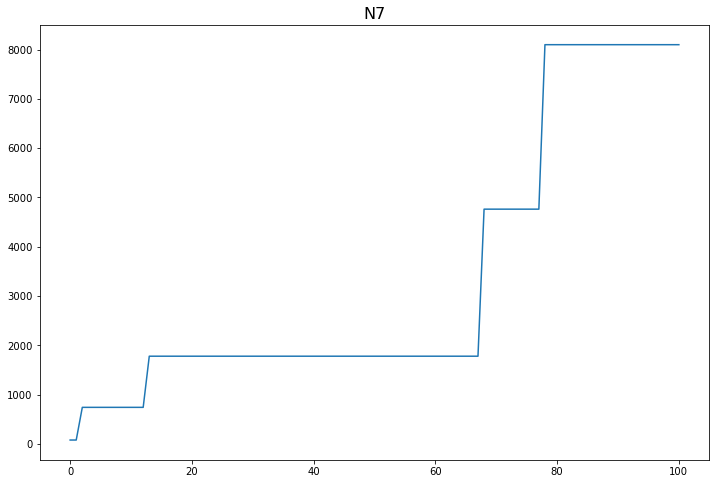

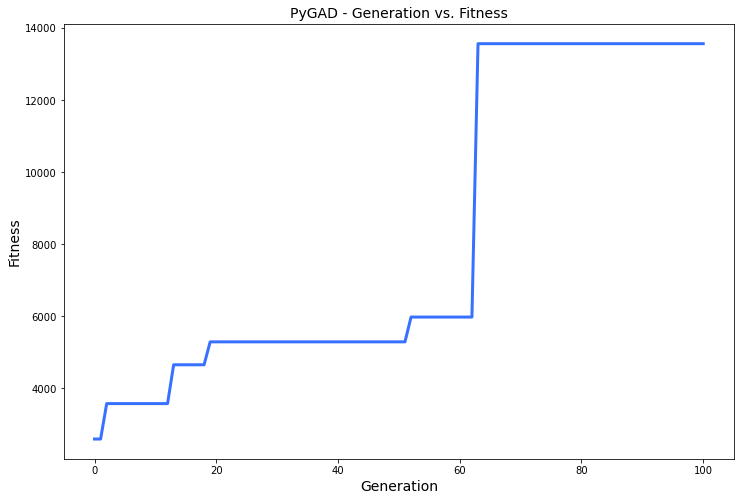

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 24.819 |==================| 226.389 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.885 |===========| 24.764 |==================| 19.849 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.031 |===========| 24.813 |==================| 572.076 |==========| N2 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.216 |===========| 24.802 |==================| 82.014 |==========| N2 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 26.571 |==================| 21.079 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 26.614 |==================| 269.516 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 26.552 |==================| 15.133 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 26.564 |==================| 18.639 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 26.548 |==================| 14.307 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 26.581 |==================| 27.015 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 26.606 |==================| 80.856 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 26.592 |==================| 38.014 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 26.61 |==================| 120.347 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 26.563 |==================| 18.131 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 26.588 |==================| 33.811 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 26.591 |==================| 37.736 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 26.603 |==================| 66.87 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 26.578 |==================| 25.063 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 26.603 |==================| 65.019 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 26.617 |==================| 1170.94 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 26.585 |==================| 30.139 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 26.553 |==================| 15.464 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 26.568 |==================| 19.866 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 26.582 |==================| 27.989 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 26.615 |==================| 386.677 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 26.548 |==================| 14.242 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 26.541 |==================| 12.957 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 26.583 |==================| 28.566 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 26.595 |==================| 43.928 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 26.605 |==================| 77.249 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 26.579 |==================| 25.908 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 26.545 |==================| 13.796 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 26.589 |==================| 34.765 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.005 |===========| 26.54 |==================| 12.821 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 26.575 |==================| 23.428 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 26.595 |==================| 43.928 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 26.587 |==================| 32.799 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 26.578 |==================| 24.93 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 26.592 |==================| 37.897 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 26.614 |==================| 254.102 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 26.572 |==================| 21.704 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 26.612 |==================| 165.233 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 26.607 |==================| 94.72 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 26.588 |==================| 33.343 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 26.604 |==================| 72.025 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 26.582 |==================| 27.615 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 26.587 |==================| 31.807 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 26.572 |==================| 21.704 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.003 |===========| 26.54 |==================| 12.844 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 26.6 |==================| 55.712 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 26.557 |==================| 16.42 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 26.607 |==================| 88.982 |==========| N6 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 26.617 |==================| 2192.494 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 26.613 |==================| 203.969 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 26.604 |==================| 72.167 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 26.566 |==================| 19.227 |==========| N6 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 26.558 |==================| 16.573 |==========| N6 |==========
**********************************************************************
Change = 1021.5540734916008
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 26.561 |==================| 17.533 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 26.551 |==================| 14.837 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 26.617 |==================| 2192.494 |==========| N6 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 26.573 |==================| 22.042 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 26.585 |==================| 30.198 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 26.546 |==================| 13.938 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 26.593 |==================| 40.628 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 26.597 |==================| 47.684 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 26.575 |==================| 23.366 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 26.568 |==================| 20.164 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 26.596 |==================| 46.393 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 26.554 |==================| 15.596 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 26.611 |==================| 149.856 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 26.555 |==================| 15.941 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 26.603 |==================| 67.277 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 26.6 |==================| 54.33 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 26.559 |==================| 16.952 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 26.588 |==================| 32.95 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 26.582 |==================| 28.111 |==========| N6 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 26.546 |==================| 13.833 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 26.608 |==================| 99.125 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 26.579 |==================| 26.011 |==========| N6 |==========
**********************************************************************
Fitness = 2192.493672629412
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 26.544 |==================| 13.55 |==========| N6 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 26.568 |==================| 19.974 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 26.58 |==================| 26.293 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 26.573 |==================| 22.011 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 26.546 |==================| 13.833 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 26.598 |==================| 50.006 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 26.586 |==================| 31.076 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 26.547 |==================| 14.096 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 26.56 |==================| 17.25 |==========| N6 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 26.579 |==================| 25.871 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 26.577 |==================| 24.393 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 26.578 |==================| 24.744 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 26.593 |==================| 39.801 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 26.582 |==================| 27.92 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 26.552 |==================| 15.242 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 26.577 |==================| 24.302 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 26.579 |==================| 25.871 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 26.589 |==================| 34.538 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 26.59 |==================| 35.21 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 26.59 |==================| 36.09 |==========| N6 |==========
**********************************************************************
Generation = 9
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 26.586 |==================| 31.145 |==========| N6 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 26.541 |==================| 13.052 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 26.6 |==================| 54.941 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 26.596 |==================| 46.582 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 26.589 |==================| 34.538 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 26.549 |==================| 14.526 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 26.606 |==================| 83.318 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 26.555 |==================| 15.943 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 26.585 |==================| 30.462 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 26.574 |==================| 22.578 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 26.564 |==================| 18.385 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 26.614 |==================| 266.845 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 26.586 |==================| 31.116 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 26.542 |==================| 13.109 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 26.581 |==================| 27.008 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 26.61 |==================| 127.195 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 26.57 |==================| 20.852 |==========| N6 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 26.609 |==================| 113.632 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 26.559 |==================| 16.899 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 26.545 |==================| 13.725 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 26.598 |==================| 49.643 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 26.609 |==================| 113.752 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 26.559 |==================| 17.049 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 26.548 |==================| 14.205 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 26.592 |==================| 38.839 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 26.607 |==================| 92.179 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 26.571 |==================| 21.143 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 26.608 |==================| 103.98 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 26.611 |==================| 149.167 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 26.545 |==================| 13.621 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 26.58 |==================| 26.083 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 26.613 |==================| 216.91 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 26.614 |==================| 268.858 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 26.605 |==================| 74.648 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 26.559 |==================| 16.865 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 26.574 |==================| 22.511 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 26.598 |==================| 50.637 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 26.589 |==================| 34.551 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 26.545 |==================| 13.691 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 26.596 |==================| 45.028 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 26.605 |==================| 74.648 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 26.566 |==================| 19.371 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 26.558 |==================| 16.77 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 26.564 |==================| 18.588 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 26.579 |==================| 25.838 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 26.607 |==================| 88.258 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 26.61 |==================| 121.907 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 26.574 |==================| 22.699 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 26.57 |==================| 21.059 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 26.563 |==================| 18.313 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 26.566 |==================| 19.183 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 26.542 |==================| 13.093 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 26.564 |==================| 18.624 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 26.584 |==================| 29.55 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 26.59 |==================| 35.174 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 26.57 |==================| 20.803 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 26.58 |==================| 26.154 |==========| N6 |==========
**********************************************************************
Gener

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 26.563 |==================| 18.161 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 26.563 |==================| 18.25 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 26.577 |==================| 24.367 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 26.584 |==================| 29.55 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 26.615 |==================| 373.187 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 26.581 |==================| 27.204 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 26.583 |==================| 28.832 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 26.612 |==================| 173.754 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 26.612 |==================| 159.879 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 26.602 |==================| 62.761 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 26.583 |==================| 28.34 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 26.566 |==================| 19.423 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 26.593 |==================| 39.468 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 26.587 |==================| 32.45 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 26.6 |==================| 55.686 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 26.605 |==================| 77.087 |==========| N6 |==========
****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 26.615 |==================| 307.28 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 26.554 |==================| 15.616 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 26.583 |==================| 28.246 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 26.582 |==================| 27.555 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 26.601 |==================| 58.239 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 26.599 |==================| 52.313 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 26.604 |==================| 73.05 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 26.614 |==================| 235.086 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 26.572 |==================| 21.723 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 26.576 |==================| 23.679 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 26.605 |==================| 74.898 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 26.555 |==================| 15.942 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 26.612 |==================| 160.414 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 26.563 |==================| 18.203 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 26.591 |==================| 36.788 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 26.575 |==================| 23.518 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 26.577 |==================| 24.204 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 26.594 |==================| 41.316 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 26.571 |==================| 21.094 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 26.599 |==================| 52.045 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 26.577 |==================| 24.135 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 26.576 |==================| 23.741 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 26.555 |==================| 15.883 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 26.577 |==================| 24.167 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 26.598 |==================| 49.645 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 26.56 |==================| 17.23 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 26.554 |==================| 15.555 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 26.6 |==================| 55.928 |==========| N6 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 26.598 |==================| 51.427 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 26.602 |==================| 63.484 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 26.588 |==================| 33.057 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 26.593 |==================| 39.611 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 26.591 |==================| 37.077 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 26.596 |==================| 46.143 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 26.556 |==================| 16.045 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 26.598 |==================| 51.427 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 26.566 |==================| 19.262 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 26.547 |==================| 14.163 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 26.612 |==================| 179.3 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 26.544 |==================| 13.579 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 26.563 |==================| 18.108 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 26.571 |==================| 21.384 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 26.606 |==================| 81.333 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 26.599 |==================| 52.814 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 26.568 |==================| 19.995 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 26.543 |==================| 13.266 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 26.584 |==================| 29.528 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 26.614 |==================| 272.247 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 26.55 |==================| 14.641 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 26.596 |==================| 45.28 |==========| N6 |==========
**********************************************************************
Generation = 20
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 26.578 |==================| 24.751 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 26.567 |==================| 19.618 |==========| N6 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 26.603 |==================| 65.763 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 26.551 |==================| 14.856 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 26.553 |==================| 15.338 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 26.569 |==================| 20.625 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 26.573 |==================| 22.382 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 26.602 |==================| 62.812 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 26.548 |==================| 14.255 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 26.609 |==================| 107.354 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 26.589 |==================| 35.028 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 26.551 |==================| 15.042 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 26.604 |==================| 71.839 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 26.547 |==================| 14.064 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 26.553 |==================| 15.384 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 26.605 |==================| 74.562 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 26.617 |==================| 725.826 |==========| N6 |==========
**********************************************************************
Change = 18024.9789031422
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 26.603 |==================| 67.13 |==========| N6 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 26.599 |==================| 53.703 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 26.604 |==================| 73.073 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 26.612 |==================| 166.521 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 26.572 |==================| 21.924 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 26.598 |==================| 49.589 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 26.59 |==================| 36.342 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 26.6 |==================| 56.494 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 26.549 |==================| 14.601 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 26.597 |==================| 47.834 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 26.608 |==================| 101.392 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 26.584 |==================| 29.056 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 26.598 |==================| 49.589 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 26.58 |==================| 26.514 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 26.552 |==================| 15.12 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 26.557 |==================| 16.52 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 26.61 |==================| 125.639 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 26.616 |==================| 442.991 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 26.564 |==================| 18.476 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 26.569 |==================| 20.559 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 26.564 |==================| 18.492 |==========| N6 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 26.588 |==================| 33.937 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 26.618 |==================| 3362.819 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 26.578 |==================| 25.319 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 26.563 |==================| 18.252 |==========| N6 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 26.582 |==================| 27.882 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 26.581 |==================| 27.192 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 26.589 |==================| 35.129 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 26.615 |==================| 378.477 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 26.588 |==================| 33.545 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 26.58 |==================| 26.405 |==========| N6 |==========
**********************************************************************
Fitness = 20217.47257577161
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 26.608 |==================| 98.985 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 26.603 |==================| 68.708 |==========| N6 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 26.614 |==================| 262.944 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 26.603 |==================| 65.736 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 26.587 |==================| 32.267 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 26.571 |==================| 21.166 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 26.565 |==================| 18.83 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 26.587 |==================| 32.575 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 26.573 |==================| 22.41 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 26.576 |==================| 23.569 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 26.598 |==================| 49.797 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 26.58 |==================| 26.186 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 26.595 |==================| 42.798 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 26.565 |==================| 18.83 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 26.596 |==================| 45.386 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 26.573 |==================| 22.344 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 26.599 |==================| 54.149 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 26.543 |==================| 13.32 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 26.547 |==================| 14.01 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 26.599 |==================| 53.303 |==========| N6 |==========
**********************************************************************
Generation = 26
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 26.579 |==================| 25.625 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 26.542 |==================| 13.11 |==========| N6 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 26.607 |==================| 92.638 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 26.614 |==================| 229.301 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 26.615 |==================| 291.233 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 26.574 |==================| 22.548 |==========| N6 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 26.549 |==================| 14.558 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 26.581 |==================| 26.828 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 26.578 |==================| 25.296 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 26.603 |==================| 69.11 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 26.547 |==================| 14.181 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 26.605 |==================| 75.38 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 26.593 |==================| 40.575 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 26.569 |==================| 20.599 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 26.584 |==================| 29.449 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 26.618 |==================| 3892.587 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 26.546 |==================| 13.96 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 26.595 |==================| 42.766 |==========| N6 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 26.614 |==================| 226.088 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 26.591 |==================| 37.463 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 26.573 |==================| 22.297 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 26.54 |==================| 12.913 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 26.591 |==================| 37.377 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 26.612 |==================| 175.364 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 26.608 |==================| 98.113 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 26.605 |==================| 76.12 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 26.592 |==================| 38.275 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 26.605 |==================| 78.228 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 26.607 |==================| 92.511 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 26.617 |==================| 1227.613 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 26.546 |==================| 13.985 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 26.598 |==================| 51.296 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 26.56 |==================| 17.205 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 26.603 |==================| 66.367 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 26.544 |==================| 13.468 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 26.611 |==================| 141.96 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 26.581 |==================| 26.815 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 26.578 |==================| 25.198 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 26.597 |==================| 47.285 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 26.561 |==================| 17.694 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 26.582 |==================| 27.653 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 26.562 |==================| 17.765 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 26.604 |==================| 69.354 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 26.578 |==================| 24.863 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 26.603 |==================| 65.776 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 26.568 |==================| 20.101 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 26.582 |==================| 27.442 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 26.543 |==================| 13.311 |==========| N6 |==========
**********************************************************************
Fitness = 20217.47257577161
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 26.605 |==================| 76.006 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 26.579 |==================| 25.906 |==========| N6 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 26.569 |==================| 20.313 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 26.562 |==================| 17.925 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 26.542 |==================| 13.135 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 26.596 |==================| 45.224 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 26.551 |==================| 14.942 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 26.585 |==================| 30.81 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 26.55 |==================| 14.669 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 26.603 |==================| 67.875 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 26.566 |==================| 19.069 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 26.58 |==================| 26.384 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 26.559 |==================| 17.099 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 26.582 |==================| 28.151 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 26.59 |==================| 35.277 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 26.614 |==================| 274.623 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 26.601 |==================| 59.139 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 26.545 |==================| 13.75 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 26.571 |==================| 21.428 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 26.564 |==================| 18.486 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 26.612 |==================| 159.383 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 26.555 |==================| 16.012 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 26.59 |==================| 35.824 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 26.576 |==================| 23.867 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 26.57 |==================| 20.707 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 26.556 |==================| 16.207 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 26.597 |==================| 47.311 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 26.606 |==================| 81.936 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 26.552 |==================| 15.185 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 26.566 |==================| 19.131 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 26.585 |==================| 30.722 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 26.601 |==================| 57.372 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 26.58 |==================| 26.048 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 26.607 |==================| 91.182 |==========| N6 |==========
**********************************************************************
G

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 26.586 |==================| 31.779 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 26.549 |==================| 14.553 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 26.581 |==================| 26.891 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 26.579 |==================| 26.002 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 26.57 |==================| 20.934 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 26.571 |==================| 21.242 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 26.606 |==================| 80.802 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 26.605 |==================| 74.757 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 26.564 |==================| 18.414 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 26.575 |==================| 23.25 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 26.583 |==================| 28.519 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 26.547 |==================| 14.161 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 26.579 |==================| 25.918 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 26.6 |==================| 55.182 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 26.547 |==================| 14.148 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 26.57 |==================| 20.953 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 26.57 |==================| 21.063 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 26.595 |==================| 43.987 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 26.544 |==================| 13.437 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 26.579 |==================| 25.709 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 26.608 |==================| 105.842 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 26.584 |==================| 29.372 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 26.561 |==================| 17.692 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 26.567 |==================| 19.743 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 26.545 |==================| 13.658 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 26.546 |==================| 13.927 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 26.602 |==================| 64.649 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 26.545 |==================| 13.675 |==========| N6 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 26.598 |==================| 50.314 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 26.589 |==================| 34.645 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 26.551 |==================| 14.883 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 26.565 |==================| 19.009 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 26.57 |==================| 20.976 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 26.562 |==================| 17.976 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 26.603 |==================| 66.587 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 26.566 |==================| 19.438 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 26.597 |==================| 48.65 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 26.596 |==================| 44.917 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 26.592 |==================| 38.798 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 26.613 |==================| 202.05 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 26.616 |==================| 485.671 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 26.592 |==================| 37.995 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 26.594 |==================| 42.656 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 26.565 |==================| 19.012 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 26.579 |==================| 25.7 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 26.568 |==================| 20.162 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 26.604 |==================| 69.729 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 26.597 |==================| 46.652 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 26.568 |==================| 19.916 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 26.568 |==================| 20.068 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 26.56 |==================| 17.244 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 26.547 |==================| 14.168 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 26.586 |==================| 31.193 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 26.548 |==================| 14.292 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 26.583 |==================| 28.541 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 26.591 |==================| 37.016 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 26.582 |==================| 28.191 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 26.564 |==================| 18.569 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 26.562 |==================| 17.964 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 26.608 |==================| 102.934 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 26.601 |==================| 60.639 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 26.595 |==================| 43.659 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 26.601 |==================| 58.844 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 26.565 |==================| 19.065 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 26.604 |==================| 71.934 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 26.595 |==================| 44.47 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 26.606 |==================| 87.378 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 26.605 |==================| 74.44 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 26.558 |==================| 16.658 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 26.588 |==================| 33.561 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 26.578 |==================| 25.283 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 26.615 |==================| 291.237 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 26.555 |==================| 15.788 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 26.603 |==================| 68.518 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 26.597 |==================| 46.826 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 26.613 |==================| 203.398 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 26.545 |==================| 13.681 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 26.57 |==================| 20.933 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 26.595 |==================| 43.438 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 26.602 |==================| 60.968 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 26.581 |==================| 27.387 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 26.613 |==================| 201.981 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 26.56 |==================| 17.403 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 26.565 |==================| 18.839 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 26.597 |==================| 48.499 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 26.569 |==================| 20.387 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 26.562 |==================| 17.942 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 26.577 |==================| 24.374 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 26.607 |==================| 94.524 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 26.57 |==================| 20.961 |==========| N6 |==========
**********************************************************************
Generation = 41
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 26.597 |==================| 47.174 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 26.552 |==================| 15.156 |==========| N6 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 26.567 |==================| 19.487 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 26.606 |==================| 86.675 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 26.609 |==================| 114.843 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 26.549 |==================| 14.553 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 26.602 |==================| 63.63 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 26.557 |==================| 16.293 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 26.587 |==================| 32.251 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 26.581 |==================| 27.042 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 26.549 |==================| 14.502 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 26.572 |==================| 21.616 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 26.605 |==================| 78.356 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 26.6 |==================| 55.658 |==========| N6 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 26.603 |==================| 65.532 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 26.589 |==================| 35.019 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 26.599 |==================| 52.94 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 26.597 |==================| 47.653 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 26.617 |==================| 696.53 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 26.561 |==================| 17.533 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 26.553 |==================| 15.458 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 26.581 |==================| 27.318 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 26.597 |==================| 48.411 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 26.562 |==================| 17.941 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 26.587 |==================| 32.091 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 26.615 |==================| 407.461 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 26.545 |==================| 13.745 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 26.613 |==================| 219.729 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 26.584 |==================| 29.275 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 26.597 |==================| 48.411 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 26.556 |==================| 16.016 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 26.593 |==================| 40.288 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 26.574 |==================| 22.865 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 26.543 |==================| 13.297 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 26.582 |==================| 27.511 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 26.61 |==================| 127.835 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 26.573 |==================| 22.181 |==========| N6 |==========
**********************************************************************
Fitness = 20217.47257577161
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 26.571 |==================| 21.091 |==========| N6 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 26.613 |==================| 195.213 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 26.556 |==================| 16.127 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 26.612 |==================| 169.611 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 26.608 |==================| 100.895 |==========| N6 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 26.606 |==================| 86.646 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 26.57 |==================| 20.822 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 26.597 |==================| 48.491 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 26.614 |==================| 228.453 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 26.594 |==================| 42.046 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 26.545 |==================| 13.784 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 26.571 |==================| 21.521 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 26.546 |==================| 13.829 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 26.545 |==================| 13.659 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 26.61 |==================| 134.181 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 26.554 |==================| 15.713 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 26.594 |==================| 42.046 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 26.599 |==================| 52.252 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 26.601 |==================| 60.171 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 26.566 |==================| 19.23 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 26.553 |==================| 15.337 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 26.603 |==================| 66.971 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 26.616 |==================| 654.404 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 26.609 |==================| 106.84 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 26.563 |==================| 18.049 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 26.585 |==================| 30.779 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 26.6 |==================| 57.244 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 26.568 |==================| 19.976 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 26.603 |==================| 66.971 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 26.549 |==================| 14.437 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 26.587 |==================| 32.309 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 26.613 |==================| 221.418 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 26.605 |==================| 80.266 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 26.597 |==================| 48.795 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 26.546 |==================| 13.866 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 26.61 |==================| 129.673 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 26.547 |==================| 14.1 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 26.57 |==================| 20.907 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 26.543 |==================| 13.369 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 26.562 |==================| 17.814 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 26.551 |==================| 15.032 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 26.605 |==================| 78.065 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 26.606 |==================| 82.036 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 26.562 |==================| 17.72 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 26.608 |==================| 100.636 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 26.604 |==================| 74.229 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 26.574 |==================| 22.62 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 26.56 |==================| 17.37 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 26.601 |==================| 59.577 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 26.586 |==================| 31.314 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 26.602 |==================| 62.38 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 26.564 |==================| 18.648 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 26.602 |==================| 62.749 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 26.577 |==================| 24.278 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 26.604 |==================| 71.307 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 26.557 |==================| 16.387 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 26.549 |==================| 14.435 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 26.58 |==================| 26.258 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 26.576 |==================| 23.965 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 26.611 |==================| 144.299 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 26.617 |==================| 897.37 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 26.57 |==================| 20.897 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 26.604 |==================| 70.785 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 26.605 |==================| 75.752 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 26.543 |==================| 13.377 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 26.554 |==================| 15.585 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 26.582 |==================| 27.914 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 26.602 |==================| 64.174 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 26.578 |==================| 25.001 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 26.585 |==================| 30.733 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 26.606 |==================| 80.915 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 26.555 |==================| 15.983 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 26.573 |==================| 22.179 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 26.586 |==================| 31.4 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 26.542 |==================| 13.111 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 26.561 |==================| 17.502 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 26.586 |==================| 31.726 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 26.552 |==================| 15.267 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 26.557 |==================| 16.299 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 26.617 |==================| 999.058 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 26.574 |==================| 22.604 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 26.601 |==================| 58.111 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 26.572 |==================| 21.928 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 26.546 |==================| 13.837 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 26.565 |==================| 18.9 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 26.583 |==================| 28.38 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 26.549 |==================| 14.564 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 26.568 |==================| 20.119 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 26.546 |==================| 13.969 |==========| N6 |==========
**********************************************************************
G

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 26.565 |==================| 18.917 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 26.595 |==================| 43.47 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 26.581 |==================| 27.266 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 26.576 |==================| 23.703 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 26.552 |==================| 15.063 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 26.562 |==================| 17.723 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 26.603 |==================| 68.933 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 26.573 |==================| 22.45 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 26.549 |==================| 14.493 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 26.617 |==================| 1294.921 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 26.555 |==================| 15.849 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 26.6 |==================| 54.553 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 26.583 |==================| 29.003 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 26.546 |==================| 13.838 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 26.581 |==================| 27.362 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 26.613 |==================| 192.677 |==========| N6 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 26.609 |==================| 115.717 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 26.577 |==================| 24.661 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 26.576 |==================| 23.851 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 26.583 |==================| 29.003 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 26.556 |==================| 16.036 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 26.616 |==================| 460.954 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 26.572 |==================| 21.835 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 26.552 |==================| 15.267 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 26.544 |==================| 13.594 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 26.552 |==================| 15.232 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 26.564 |==================| 18.488 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 26.557 |==================| 16.435 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 26.569 |==================| 20.415 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 26.579 |==================| 25.771 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 26.593 |==================| 39.676 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 26.617 |==================| 1415.143 |==========| N6 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 26.573 |==================| 22.075 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 26.549 |==================| 14.424 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 26.592 |==================| 37.868 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 26.56 |==================| 17.345 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 26.554 |==================| 15.742 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 26.55 |==================| 14.785 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 26.568 |==================| 20.081 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 26.574 |==================| 22.783 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 26.591 |==================| 37.412 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 26.593 |==================| 40.683 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 26.617 |==================| 1023.645 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 26.591 |==================| 37.482 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 26.594 |==================| 42.115 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 26.599 |==================| 53.45 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 26.581 |==================| 26.867 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 26.61 |==================| 118.485 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 26.562 |==================| 17.901 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 26.585 |==================| 30.455 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 26.542 |==================| 13.126 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 26.594 |==================| 42.115 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 26.61 |==================| 120.283 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 26.567 |==================| 19.563 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 26.604 |==================| 73.131 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 26.579 |==================| 25.943 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 26.582 |==================| 27.538 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 26.614 |==================| 228.601 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 26.553 |==================| 15.412 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 26.61 |==================| 120.283 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 26.548 |==================| 14.336 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 26.545 |==================| 13.759 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 26.603 |==================| 65.235 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 26.573 |==================| 22.501 |==========| N6 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 26.605 |==================| 77.353 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 26.567 |==================| 19.712 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 26.567 |==================| 19.531 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 26.605 |==================| 79.503 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 26.615 |==================| 383.329 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 26.561 |==================| 17.642 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 26.574 |==================| 22.955 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 26.612 |==================| 169.092 |==========| N6 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 26.573 |==================| 22.081 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 26.575 |==================| 23.11 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 26.576 |==================| 23.686 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 26.552 |==================| 15.162 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 26.594 |==================| 42.623 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 26.565 |==================| 18.856 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 26.614 |==================| 232.753 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 26.617 |==================| 2175.115 |==========| N6 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 26.57 |==================| 21.055 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 26.577 |==================| 24.662 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 26.6 |==================| 54.937 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 26.594 |==================| 42.623 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 26.548 |==================| 14.35 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 26.613 |==================| 193.022 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 26.553 |==================| 15.513 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 26.575 |==================| 23.39 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 26.581 |==================| 27.048 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 26.552 |==================| 15.083 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 26.559 |==================| 16.947 |==========| N6 |==========
**********************************************************************
Fitness = 20217.47257577161
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 26.548 |==================| 14.35 |==========| N6 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 26.616 |==================| 509.171 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 26.563 |==================| 18.263 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 26.58 |==================| 26.216 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 26.581 |==================| 27.048 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 26.581 |==================| 26.813 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 26.588 |==================| 33.892 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 26.582 |==================| 27.767 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 26.591 |==================| 37.604 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 26.559 |==================| 16.863 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 26.616 |==================| 431.963 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 26.605 |==================| 80.034 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 26.562 |==================| 17.922 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 26.617 |==================| 967.581 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 26.546 |==================| 13.992 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 26.547 |==================| 14.181 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 26.598 |==================| 50.697 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 26.567 |==================| 19.493 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 26.6 |==================| 56.287 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 26.617 |==================| 907.171 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 26.582 |==================| 27.698 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 26.594 |==================| 41.863 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 26.596 |==================| 45.263 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 26.589 |==================| 34.733 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 26.55 |==================| 14.727 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 26.577 |==================| 24.478 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 26.599 |==================| 52.709 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 26.564 |==================| 18.706 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 26.616 |==================| 416.916 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 26.606 |==================| 83.564 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 26.581 |==================| 27.377 |==========| N6 |==========
**********************************************************************
Generation = 63
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 26.587 |==================| 32.116 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 26.607 |==================| 89.792 |==========| N6 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 26.573 |==================| 22.376 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 26.578 |==================| 25.328 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 26.566 |==================| 19.379 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 26.613 |==================| 213.084 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 26.599 |==================| 53.266 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 26.598 |==================| 49.367 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 26.588 |==================| 33.804 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 26.573 |==================| 22.376 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 26.553 |==================| 15.48 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 26.602 |==================| 63.609 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 26.583 |==================| 28.844 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 26.578 |==================| 25.095 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 26.601 |==================| 58.746 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 26.572 |==================| 21.852 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 26.554 |==================| 15.542 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 26.578 |==================| 24.972 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 26.601 |==================| 58.285 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 26.566 |==================| 19.209 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 26.599 |==================| 53.59 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 26.592 |==================| 38.463 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 26.565 |==================| 18.784 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 26.543 |==================| 13.306 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 26.618 |==================| 3024.733 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 26.578 |==================| 24.768 |==========| N6 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 26.551 |==================| 14.962 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 26.604 |==================| 70.432 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 26.606 |==================| 85.036 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 26.565 |==================| 18.784 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 26.572 |==================| 21.773 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 26.607 |==================| 90.501 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 26.579 |==================| 25.589 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 26.557 |==================| 16.334 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 26.592 |==================| 37.966 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 26.587 |==================| 32.06 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 26.555 |==================| 15.927 |==========| N6 |==========
**********************************************************************
Fitness = 20217.47257577161
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 26.585 |==================| 30.235 |==========| N6 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 26.593 |==================| 39.926 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 26.542 |==================| 13.166 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 26.572 |==================| 21.804 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 26.617 |==================| 862.032 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 26.59 |==================| 35.335 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 26.577 |==================| 24.21 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 26.591 |==================| 36.754 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 26.574 |==================| 22.508 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 26.552 |==================| 15.238 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 26.613 |==================| 189.03 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 26.599 |==================| 53.029 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 26.609 |==================| 109.29 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 26.587 |==================| 32.798 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 26.567 |==================| 19.636 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 26.574 |==================| 22.773 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 26.58 |==================| 26.148 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 26.556 |==================| 16.137 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 26.6 |==================| 55.16 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 26.617 |==================| 1652.287 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 26.596 |==================| 46.467 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 26.548 |==================| 14.34 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 26.587 |==================| 31.86 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 26.545 |==================| 13.666 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 26.587 |==================| 32.142 |==========| N6 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 26.581 |==================| 27.385 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 26.57 |==================| 20.788 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 26.564 |==================| 18.525 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 26.567 |==================| 19.806 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 26.615 |==================| 334.02 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 26.567 |==================| 19.598 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 26.603 |==================| 68.115 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 26.591 |==================| 37.241 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 26.591 |==================| 37.066 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 26.571 |==================| 21.167 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 26.57 |==================| 20.929 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 26.603 |==================| 66.441 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 26.604 |==================| 73.76 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 26.611 |==================| 144.909 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 26.555 |==================| 15.903 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 26.54 |==================| 12.896 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 26.589 |==================| 34.556 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 26.561 |==================| 17.593 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 26.596 |==================| 46.229 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 26.551 |==================| 15.026 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 26.574 |==================| 22.81 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 26.577 |==================| 24.394 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 26.615 |==================| 304.541 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 26.551 |==================| 14.895 |==========| N6 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 26.568 |==================| 20.051 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 26.615 |==================| 294.557 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 26.56 |==================| 17.223 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 26.598 |==================| 50.295 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 26.549 |==================| 14.607 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 26.598 |==================| 51.242 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 26.618 |==================| 22294.133 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 26.541 |==================| 12.982 |==========| N6 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 26.568 |==================| 19.954 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 26.594 |==================| 41.398 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 26.613 |==================| 200.023 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 26.564 |==================| 18.574 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 26.578 |==================| 24.983 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 26.549 |==================| 14.456 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 26.554 |==================| 15.667 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 26.579 |==================| 25.813 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 26.605 |==================| 78.994 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 26.543 |==================| 13.27 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 26.568 |==================| 19.974 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 26.552 |==================| 15.069 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 26.61 |==================| 132.795 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 26.569 |==================| 20.324 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 26.611 |==================| 152.233 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 26.579 |==================| 25.954 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 26.577 |==================| 24.32 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 26.581 |==================| 26.923 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 26.616 |==================| 414.864 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 26.615 |==================| 408.677 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 26.614 |==================| 282.619 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 26.547 |==================| 14.112 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 26.563 |==================| 18.15 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 26.544 |==================| 13.562 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 26.586 |==================| 31.721 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 26.6 |==================| 55.478 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 26.543 |==================| 13.39 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 26.602 |==================| 62.169 |==========| N6 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 26.569 |==================| 20.353 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 26.554 |==================| 15.53 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 26.594 |==================| 42.599 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 26.55 |==================| 14.815 |==========| N6 |==========
**********************************************************************
==

======| 0.298 |===========| 26.595 |==================| 43.598 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 26.609 |==================| 106.224 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 26.595 |==================| 43.808 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 26.58 |==================| 26.639 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 26.594 |==================| 42.075 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 26.563 |==================| 18.349 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 26.617 |==================| 964.996 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 26.595 |==================| 43.598 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 26.55 |==================| 14.828 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 26.603 |==================| 66.738 |==========| N6 |==========
**********************************************************************
Generation = 75
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 26.593 |==================| 39.951 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 26.617 |==================| 1041.0 |==========| N6 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 26.541 |==================| 12.995 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 26.601 |==================| 59.745 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 26.594 |==================| 41.175 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 26.55 |==================| 14.828 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 26.557 |==================| 16.45 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 26.588 |==================| 33.935 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 26.552 |==================| 15.1 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 26.541 |==================| 12.995 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 26.548 |==================| 14.31 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 26.578 |==================| 25.264 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 26.592 |==================| 38.436 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 26.575 |==================| 23.376 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 26.581 |==================| 27.237 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 26.617 |==================| 1281.616 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 26.561 |==================| 17.556 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 26.613 |==================| 195.676 |==========| N6 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 26.597 |==================| 48.543 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 26.546 |==================| 13.984 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 26.614 |==================| 236.001 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 26.578 |==================| 25.018 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 26.543 |==================| 13.38 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 26.575 |==================| 23.385 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 26.61 |==================| 123.037 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 26.549 |==================| 14.473 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 26.615 |==================| 373.812 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 26.613 |==================| 187.555 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 26.552 |==================| 15.218 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 26.558 |==================| 16.811 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 26.576 |==================| 23.651 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 26.552 |==================| 15.27 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 26.562 |==================| 17.738 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 26.572 |==================| 21.633 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 26.59 |==================| 36.254 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 26.576 |==================| 24.123 |==========| N6 |==========
**********************************************************************
Fitness = 22294.133445892912
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 26.588 |==================| 33.039 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 26.596 |==================| 45.208 |==========| N6 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 26.571 |==================| 21.199 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 26.572 |==================| 21.748 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 26.581 |==================| 26.79 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 26.545 |==================| 13.723 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 26.604 |==================| 74.397 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 26.563 |==================| 18.206 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 26.609 |==================| 118.244 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 26.61 |==================| 124.91 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 26.583 |==================| 29.028 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 26.548 |==================| 14.275 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 26.578 |==================| 25.168 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 26.585 |==================| 30.437 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 26.579 |==================| 25.854 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 26.607 |==================| 92.258 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 26.55 |==================| 14.742 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 26.583 |==================| 29.028 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 26.561 |==================| 17.431 |==========| N6 |==========
**********************************************************************
Generation = 80
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 26.57 |==================| 20.653 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 26.57 |==================| 20.834 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 26.544 |==================| 13.612 |==========| N6 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 26.615 |==================| 298.433 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 26.589 |==================| 34.21 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 26.587 |==================| 32.443 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 26.561 |==================| 17.431 |==========| N6 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 26.612 |==================| 173.379 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 26.578 |==================| 25.101 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 26.595 |==================| 43.29 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 26.591 |==================| 36.442 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 26.611 |==================| 138.757 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 26.597 |==================| 47.608 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 26.613 |==================| 186.987 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 26.541 |==================| 13.039 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 26.585 |==================| 30.123 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 26.578 |==================| 24.92 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 26.579 |==================| 25.563 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 26.611 |==================| 138.757 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 26.574 |==================| 22.589 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 26.56 |==================| 17.34 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 26.595 |==================| 43.231 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 26.544 |==================| 13.439 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 26.557 |==================| 16.442 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 26.562 |==================| 17.85 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 26.559 |==================| 16.868 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 26.548 |==================| 14.235 |==========| N6 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 26.588 |==================| 33.16 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 26.592 |==================| 39.038 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 26.565 |==================| 18.812 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 26.593 |==================| 40.845 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 26.544 |==================| 13.604 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 26.549 |==================| 14.436 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 26.565 |==================| 18.779 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 26.555 |==================| 15.787 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 26.542 |==================| 13.194 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 26.564 |==================| 18.646 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 26.566 |==================| 19.14 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 26.616 |==================| 451.653 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 26.585 |==================| 30.721 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 26.567 |==================| 19.663 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 26.545 |==================| 13.686 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 26.574 |==================| 22.527 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 26.565 |==================| 18.783 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 26.563 |==================| 18.22 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 26.599 |==================| 53.317 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 26.591 |==================| 37.765 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 26.582 |==================| 28.035 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 26.571 |==================| 21.203 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 26.588 |==================| 33.042 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 26.55 |==================| 14.712 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 26.589 |==================| 34.598 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 26.591 |==================| 37.368 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 26.614 |==================| 235.25 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 26.605 |==================| 76.394 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 26.57 |==================| 21.006 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 26.6 |==================| 55.938 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 26.566 |==================| 19.437 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 26.565 |==================| 18.774 |==========| N6 |==========
**********************************************************************
Gen

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 26.573 |==================| 22.107 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 26.544 |==================| 13.454 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 26.573 |==================| 22.482 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 26.57 |==================| 21.006 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 26.579 |==================| 25.973 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 26.581 |==================| 26.918 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 26.568 |==================| 20.182 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 26.583 |==================| 29.005 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 26.615 |==================| 372.187 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 26.617 |==================| 1967.141 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 26.602 |==================| 64.533 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 26.581 |==================| 26.887 |==========| N6 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 26.609 |==================| 112.883 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 26.604 |==================| 70.069 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 26.543 |==================| 13.264 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 26.597 |==================| 47.701 |==========| N6 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 26.583 |==================| 29.017 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 26.608 |==================| 103.941 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 26.566 |==================| 19.218 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 26.553 |==================| 15.288 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 26.573 |==================| 22.485 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 26.582 |==================| 27.885 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 26.573 |==================| 22.107 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 26.548 |==================| 14.334 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 26.614 |==================| 271.636 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 26.61 |==================| 129.124 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 26.61 |==================| 132.657 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 26.547 |==================| 14.07 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 26.573 |==================| 22.435 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 26.573 |==================| 22.437 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 26.615 |==================| 331.538 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 26.573 |==================| 22.163 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 26.562 |==================| 17.842 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 26.55 |==================| 14.763 |==========| N6 |==========
**********************************************************************
Fitness = 22294.133445892912
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 26.542 |==================| 13.226 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 26.573 |==================| 22.435 |==========| N6 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 26.564 |==================| 18.675 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 26.551 |==================| 15.019 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 26.573 |==================| 22.109 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 26.603 |==================| 66.494 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 26.572 |==================| 21.947 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 26.613 |==================| 184.138 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 26.61 |==================| 123.294 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 26.607 |==================| 90.945 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 26.605 |==================| 76.829 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 26.564 |==================| 18.644 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 26.561 |==================| 17.702 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 26.569 |==================| 20.56 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 26.566 |==================| 19.244 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 26.557 |==================| 16.383 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 26.586 |==================| 30.891 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 26.605 |==================| 76.829 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 26.555 |==================| 15.821 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 26.581 |==================| 26.807 |==========| N6 |==========
**********************************************************************
Generation = 90
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 26.541 |==================| 13.038 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 26.549 |==================| 14.549 |==========| N6 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 26.563 |==================| 18.237 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 26.607 |==================| 88.729 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 26.545 |==================| 13.678 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 26.605 |==================| 75.368 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 26.555 |==================| 15.806 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 26.563 |==================| 18.175 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 26.615 |==================| 367.843 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 26.563 |==================| 18.237 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 26.597 |==================| 48.677 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 26.56 |==================| 17.318 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 26.561 |==================| 17.493 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 26.556 |==================| 16.13 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 26.585 |==================| 30.347 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 26.616 |==================| 693.07 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 26.615 |==================| 308.654 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 26.545 |==================| 13.735 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 26.613 |==================| 207.876 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 26.543 |==================| 13.358 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 26.601 |==================| 57.411 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 26.59 |==================| 35.955 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 26.571 |==================| 21.247 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 26.607 |==================| 88.674 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 26.541 |==================| 12.97 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 26.565 |==================| 18.839 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 26.598 |==================| 49.042 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 26.597 |==================| 48.729 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 26.548 |==================| 14.264 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 26.571 |==================| 21.247 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 26.604 |==================| 74.212 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 26.611 |==================| 145.427 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 26.61 |==================| 132.953 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 26.574 |==================| 22.899 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 26.603 |==================| 66.183 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 26.544 |==================| 13.591 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 26.588 |==================| 33.468 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 26.604 |==================| 74.212 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 26.608 |==================| 97.332 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 26.559 |==================| 16.873 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 26.602 |==================| 64.46 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 26.558 |==================| 16.735 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 26.592 |==================| 38.994 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 26.58 |==================| 26.548 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 26.551 |==================| 15.018 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 26.579 |==================| 25.562 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 26.541 |==================| 12.919 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 26.605 |==================| 76.693 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 26.584 |==================| 29.57 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 26.592 |==================| 38.994 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 26.552 |==================| 15.225 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 26.572 |==================| 21.83 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 26.606 |==================| 83.648 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 26.575 |==================| 23.55 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 26.571 |==================| 21.143 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 26.597 |==================| 48.919 |==========| N6 |==========
**********************************************************************
Generation = 95
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 26.608 |==================| 99.087 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 26.618 |==================| 2666.328 |==========| N6 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 26.55 |==================| 14.66 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 26.557 |==================| 16.535 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 26.616 |==================| 537.516 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 26.541 |==================| 13.005 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 26.565 |==================| 18.784 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 26.58 |==================| 26.019 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 26.553 |==================| 15.331 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 26.544 |==================| 13.606 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 26.585 |==================| 30.461 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 26.595 |==================| 43.361 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 26.547 |==================| 14.073 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 26.596 |==================| 45.63 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 26.607 |==================| 94.894 |==========| N6 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 26.613 |==================| 195.752 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 26.583 |==================| 28.719 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 26.573 |==================| 22.131 |==========| N6 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 26.59 |==================| 36.229 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 26.599 |==================| 52.212 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 26.576 |==================| 23.962 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 26.608 |==================| 99.26 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 26.605 |==================| 75.481 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 26.562 |==================| 17.732 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 26.567 |==================| 19.575 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 26.555 |==================| 15.773 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 26.606 |==================| 82.155 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 26.565 |==================| 18.781 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 26.563 |==================| 18.068 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 26.614 |==================| 250.58 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 26.618 |==================| 4931.743 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 26.556 |==================| 16.064 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 26.558 |==================| 16.746 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 26.552 |==================| 15.101 |==========| N6 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 26.548 |==================| 14.242 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 26.598 |==================| 48.942 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 26.57 |==================| 20.723 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 26.59 |==================| 35.713 |==========| N6 |==========
**********************************************************************
Fi

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 26.583 |==================| 28.361 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 26.573 |==================| 22.43 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 26.592 |==================| 38.7 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 26.586 |==================| 31.413 |==========| N6 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 26.563 |==================| 18.161 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 26.572 |==================| 21.578 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 26.553 |==================| 15.485 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 26.609 |==================| 112.873 |==========| N6 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 26.555 |==================| 15.924 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 26.582 |==================| 27.838 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 26.615 |==================| 320.904 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 26.616 |==================| 448.964 |==========| N6 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 26.568 |==================| 19.913 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 26.614 |==================| 260.515 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 26.58 |==================| 26.457 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 26.596 |==================| 45.228 |==========| N6 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 26.548 |==================| 14.319 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 26.56 |==================| 17.282 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 26.555 |==================| 15.871 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 26.616 |==================| 553.69 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 26.555 |==================| 15.83 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 26.572 |==================| 21.695 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 26.576 |==================| 23.687 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 26.577 |==================| 24.526 |==========| N6 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 26.594 |==================| 42.153 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 26.593 |==================| 39.66 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 26.573 |==================| 22.344 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 26.57 |==================| 21.068 |==========| N6 |==========
**********************************************************************
===

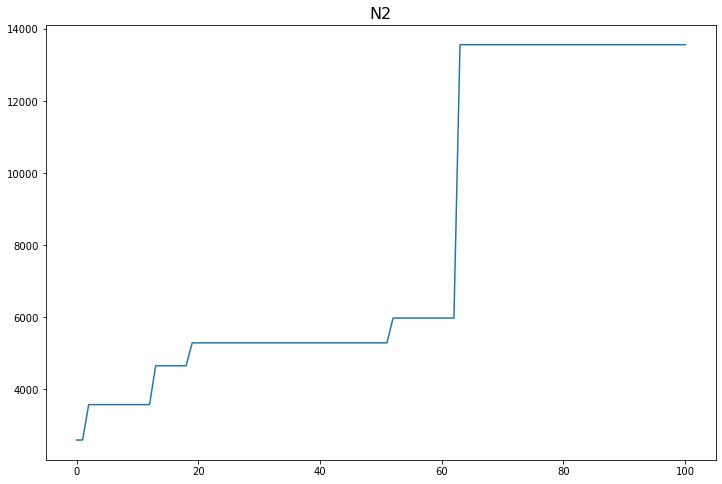

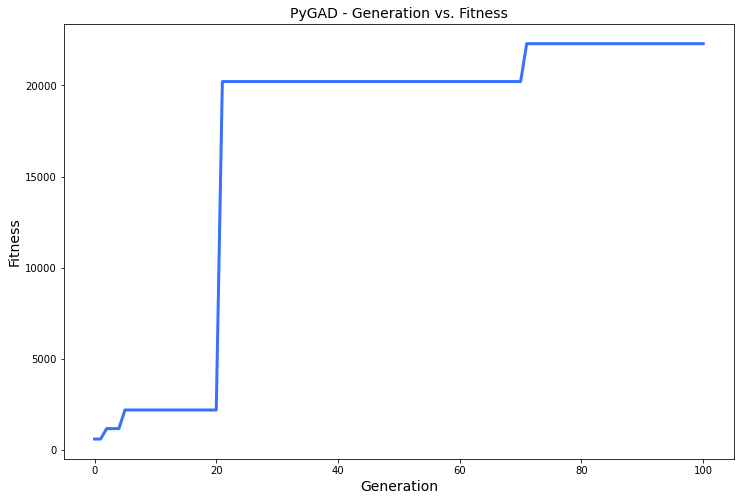

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 26.591 |==================| 37.532 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 26.604 |==================| 70.884 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 26.603 |==================| 69.234 |==========| N6 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 26.543 |==================| 13.337 |==========| N6 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 26.941 |==================| 6.928 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 27.027 |==================| 17.25 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.02 |==================| 15.444 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 26.947 |==================| 7.233 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 26.89 |==================| 5.124 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 26.988 |==================| 10.347 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 26.967 |==================| 8.453 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 26.9 |==================| 5.417 |==========| N3 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 26.892 |==================| 5.173 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 27.078 |==================| 152.578 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 27.055 |==================| 33.558 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 26.89 |==================| 5.124 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 26.907 |==================| 5.621 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 27.016 |==================| 14.428 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 26.991 |==================| 10.621 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 27.076 |==================| 114.467 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 26.992 |==================| 10.804 |==========| N3 |==========
**********************************************************************
Fitness = 2139.346336854473
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 27.047 |==================| 26.614 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 27.043 |==================| 23.545 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 26.995 |==================| 11.121 |==========| N3 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 27.059 |==================| 38.911 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 26.991 |==================| 10.678 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 26.889 |==================| 5.104 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 26.976 |==================| 9.169 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 26.969 |==================| 8.595 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 26.913 |==================| 5.826 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 27.063 |==================| 45.585 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 26.924 |==================| 6.222 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 27.084 |==================| 1045.022 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 27.064 |==================| 47.004 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 27.046 |==================| 25.562 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 27.044 |==================| 24.501 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 26.914 |==================| 5.85 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 27.006 |==================| 12.625 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 27.029 |==================| 17.975 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 26.998 |==================| 11.444 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 27.076 |==================| 110.165 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 27.036 |==================| 20.453 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 26.996 |==================| 11.213 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 27.058 |==================| 36.498 |==========| N3 |==========
**********************************************************************
G

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 26.972 |==================| 8.858 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 27.025 |==================| 16.589 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 27.0 |==================| 11.705 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 26.947 |==================| 7.262 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 26.899 |==================| 5.375 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 26.898 |==================| 5.341 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 27.053 |==================| 31.329 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 27.053 |==================| 30.761 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 27.003 |==================| 12.149 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 27.032 |==================| 19.023 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.031 |==================| 18.56 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.082 |==================| 304.523 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 26.925 |==================| 6.23 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 27.007 |==================| 12.742 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 26.956 |==================| 7.721 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 26.947 |==================| 7.241 |==========| N3 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 26.972 |==================| 8.814 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 27.033 |==================| 19.224 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 27.028 |==================| 17.62 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 27.05 |==================| 28.821 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 26.912 |==================| 5.778 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 27.005 |==================| 12.524 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 27.054 |==================| 32.039 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 27.003 |==================| 12.189 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 26.919 |==================| 6.01 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 27.063 |==================| 45.555 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 26.968 |==================| 8.566 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 26.912 |==================| 5.778 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 26.916 |==================| 5.9 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 27.027 |==================| 17.159 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 26.911 |==================| 5.76 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 26.913 |==================| 5.816 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 27.072 |==================| 77.872 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 26.894 |==================| 5.23 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 26.936 |==================| 6.7 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.052 |==================| 30.621 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 27.005 |==================| 12.544 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 26.889 |==================| 5.11 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 27.063 |==================| 45.04 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 27.017 |==================| 14.654 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 27.067 |==================| 55.331 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 26.955 |==================| 7.703 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 27.064 |==================| 47.84 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 26.972 |==================| 8.84 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 26.966 |==================| 8.421 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 26.893 |==================| 5.211 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 26.962 |==================| 8.147 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 27.0 |==================| 11.784 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 27.062 |==================| 43.438 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 26.948 |==================| 7.307 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 26.977 |==================| 9.266 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 26.952 |==================| 7.533 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 27.062 |==================| 43.457 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 27.026 |==================| 16.89 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 26.939 |==================| 6.828 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 26.917 |==================| 5.965 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 27.083 |==================| 555.793 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 27.005 |==================| 12.453 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 27.05 |==================| 28.246 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 26.936 |==================| 6.688 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 26.949 |==================| 7.367 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 26.896 |==================| 5.29 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 27.027 |==================| 17.225 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 27.083 |==================| 555.793 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 26.965 |==================| 8.299 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 27.001 |==================| 11.84 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 26.972 |==================| 8.861 |==========| N3 |==========
**********************************************************************
Generation = 10
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 27.029 |==================| 17.91 |==========| N3 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 26.977 |==================| 9.286 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 27.064 |==================| 48.607 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 26.997 |==================| 11.332 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 27.008 |==================| 12.963 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.024 |==================| 16.346 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 26.9 |==================| 5.403 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 26.896 |==================| 5.28 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 26.977 |==================| 9.286 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 26.951 |==================| 7.457 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 26.901 |==================| 5.438 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 26.937 |==================| 6.754 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 27.075 |==================| 99.217 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 27.037 |==================| 20.678 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 27.019 |==================| 15.194 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 26.998 |==================| 11.5 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 27.005 |==================| 12.495 |==========| N3 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 27.046 |==================| 25.749 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 27.076 |==================| 113.98 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 26.892 |==================| 5.172 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 26.924 |==================| 6.227 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 27.047 |==================| 26.383 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 26.952 |==================| 7.517 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 27.057 |==================| 35.764 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 27.065 |==================| 50.974 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 27.018 |==================| 15.016 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 26.998 |==================| 11.472 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 26.971 |==================| 8.747 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 27.046 |==================| 25.563 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 26.92 |==================| 6.053 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 27.076 |==================| 109.25 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 26.998 |==================| 11.513 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 26.947 |==================| 7.258 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 26.987 |==================| 10.197 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 27.021 |==================| 15.705 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 26.982 |==================| 9.739 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 27.035 |==================| 20.039 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 26.886 |==================| 5.031 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 27.064 |==================| 48.657 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 26.994 |==================| 10.938 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 26.987 |==================| 10.197 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 26.937 |==================| 6.766 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 27.008 |==================| 12.908 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 26.938 |==================| 6.801 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 27.012 |==================| 13.768 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 26.975 |==================| 9.099 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 26.982 |==================| 9.684 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 26.932 |==================| 6.537 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 27.01 |==================| 13.294 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 26.895 |==================| 5.267 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 26.969 |==================| 8.608 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 27.033 |==================| 19.281 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 27.04 |==================| 22.443 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 26.937 |==================| 6.753 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 27.035 |==================| 20.167 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 27.022 |==================| 15.819 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 27.07 |==================| 66.818 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 26.895 |==================| 5.264 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 27.073 |==================| 86.01 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 27.041 |==================| 22.775 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 26.988 |==================| 10.285 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 26.978 |==================| 9.346 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 26.929 |==================| 6.414 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 27.032 |==================| 18.823 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 26.951 |==================| 7.462 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 26.931 |==================| 6.497 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 27.07 |==================| 67.715 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 26.957 |==================| 7.82 |==========| N3 |==========
**********************************************************************
Generation = 16
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 27.082 |==================| 316.268 |==========| N3 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 27.08 |==================| 195.984 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 27.039 |==================| 21.738 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 27.036 |==================| 20.356 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 26.951 |==================| 7.466 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 26.996 |==================| 11.274 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 27.009 |==================| 13.154 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 27.026 |==================| 16.804 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 27.05 |==================| 28.659 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 27.012 |==================| 13.713 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 26.954 |==================| 7.615 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 27.046 |==================| 25.447 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 26.933 |==================| 6.569 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 27.069 |==================| 62.579 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 27.058 |==================| 36.887 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 26.896 |==================| 5.29 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 26.912 |==================| 5.785 |==========| N3 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 27.072 |==================| 74.781 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 26.924 |==================| 6.216 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 26.935 |==================| 6.666 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 26.999 |==================| 11.606 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 26.914 |==================| 5.857 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 26.987 |==================| 10.235 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 26.9 |==================| 5.407 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 27.066 |==================| 52.34 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 26.918 |==================| 5.975 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 26.894 |==================| 5.236 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 26.97 |==================| 8.71 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 26.975 |==================| 9.074 |==========| N3 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 27.025 |==================| 16.559 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 26.898 |==================| 5.345 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 26.897 |==================| 5.306 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 27.08 |==================| 218.566 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 27.006 |==================| 12.621 |==========| N3 |==========
**********************************************************************
Fitness = 9378.919285598218
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 27.009 |==================| 13.131 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 26.894 |==================| 5.24 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 27.085 |==================| 9378.919 |==========| N3 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 27.034 |==================| 19.45 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 27.063 |==================| 46.443 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 26.904 |==================| 5.519 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 27.003 |==================| 12.191 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 26.95 |==================| 7.395 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 26.934 |==================| 6.606 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 26.971 |==================| 8.771 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 27.001 |==================| 11.861 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 26.989 |==================| 10.365 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 27.029 |==================| 17.741 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 27.057 |==================| 35.209 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 27.063 |==================| 44.677 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 27.031 |==================| 18.367 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 26.995 |==================| 11.047 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 27.054 |==================| 31.886 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 26.987 |==================| 10.242 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 26.978 |==================| 9.357 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 26.932 |==================| 6.549 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 26.992 |==================| 10.698 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 26.986 |==================| 10.073 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 27.084 |==================| 1637.336 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 26.969 |==================| 8.587 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 27.06 |==================| 39.668 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 26.997 |==================| 11.307 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 26.975 |==================| 9.121 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 27.07 |==================| 64.425 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 27.054 |==================| 32.311 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 27.02 |==================| 15.424 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 27.064 |==================| 47.059 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 26.973 |==================| 8.961 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 27.071 |==================| 69.651 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 27.01 |==================| 13.28 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 27.051 |==================| 29.448 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 27.018 |==================| 14.945 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 26.918 |==================| 5.982 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 27.06 |==================| 39.579 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 26.889 |==================| 5.109 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 26.974 |==================| 8.975 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 27.08 |==================| 189.225 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 27.076 |==================| 115.603 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 27.072 |==================| 77.775 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 26.982 |==================| 9.664 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 27.019 |==================| 15.06 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 26.896 |==================| 5.279 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 27.009 |==================| 13.084 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 27.008 |==================| 12.97 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 27.057 |==================| 36.242 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 27.04 |==================| 22.259 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.052 |==================| 30.664 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 27.059 |==================| 37.7 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 27.067 |==================| 56.16 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 27.027 |==================| 17.291 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 27.03 |==================| 18.288 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 26.999 |==================| 11.588 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 27.072 |==================| 75.311 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 27.016 |==================| 14.523 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 26.953 |==================| 7.55 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 26.977 |==================| 9.261 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 26.976 |==================| 9.152 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 26.982 |==================| 9.714 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 26.926 |==================| 6.297 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 27.023 |==================| 16.241 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 26.921 |==================| 6.093 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 27.076 |==================| 113.162 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 26.941 |==================| 6.929 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 26.928 |==================| 6.389 |==========| N3 |==========
**********************************************************************
Fitness = 9378.919285598218
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 26.886 |==================| 5.029 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 26.9 |==================| 5.417 |==========| N3 |==========
**************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 26.894 |==================| 5.225 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 26.97 |==================| 8.687 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 26.898 |==================| 5.353 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 27.017 |==================| 14.64 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 26.995 |==================| 11.076 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 27.07 |==================| 66.184 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 27.06 |==================| 40.267 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 26.978 |==================| 9.324 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 27.076 |==================| 111.03 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 27.059 |==================| 37.83 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 26.903 |==================| 5.485 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 26.964 |==================| 8.282 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 26.933 |==================| 6.589 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 27.042 |==================| 23.353 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 27.014 |==================| 14.153 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 27.001 |==================| 11.925 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 26.934 |==================| 6.639 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 26.909 |==================| 5.69 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 27.008 |==================| 12.957 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 27.033 |==================| 19.21 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 26.964 |==================| 8.253 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 26.985 |==================| 9.982 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 26.991 |==================| 10.675 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 27.046 |==================| 25.384 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 26.946 |==================| 7.179 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 26.925 |==================| 6.253 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 26.926 |==================| 6.289 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 27.074 |==================| 87.943 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 27.066 |==================| 52.933 |==========| N3 |==========
**********************************************************************
Generation = 28
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 26.966 |==================| 8.424 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 26.898 |==================| 5.341 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 27.074 |==================| 87.66 |==========| N3 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 26.964 |==================| 8.269 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 27.054 |==================| 32.073 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 26.963 |==================| 8.204 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 27.044 |==================| 24.456 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 26.977 |==================| 9.249 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 26.985 |==================| 9.984 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 26.919 |==================| 6.039 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 26.964 |==================| 8.269 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 27.029 |==================| 17.727 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 26.95 |==================| 7.429 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 26.918 |==================| 5.988 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 27.007 |==================| 12.897 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 26.979 |==================| 9.475 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 26.889 |==================| 5.098 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 27.082 |==================| 330.23 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 26.987 |==================| 10.207 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 27.032 |==================| 18.914 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 26.969 |==================| 8.654 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 27.0 |==================| 11.706 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 27.063 |==================| 46.081 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 27.041 |==================| 22.49 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 26.934 |==================| 6.62 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 27.067 |==================| 54.301 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 26.964 |==================| 8.289 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 26.939 |==================| 6.857 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 26.973 |==================| 8.889 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.04 |==================| 22.298 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 27.048 |==================| 27.097 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 27.058 |==================| 37.496 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 26.971 |==================| 8.758 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 26.949 |==================| 7.361 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 26.947 |==================| 7.235 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 27.076 |==================| 110.861 |==========| N3 |==========
**********************************************************************
Fitness = 9378.919285598218
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 26.97 |==================| 8.685 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 26.909 |==================| 5.686 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 26.961 |==================| 8.047 |==========| N3 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 27.082 |==================| 392.788 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 26.992 |==================| 10.7 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 27.054 |==================| 32.471 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 26.938 |==================| 6.812 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 26.984 |==================| 9.853 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 26.991 |==================| 10.601 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 26.993 |==================| 10.885 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 27.042 |==================| 23.17 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 27.064 |==================| 48.623 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 26.967 |==================| 8.46 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 26.904 |==================| 5.521 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 27.005 |==================| 12.425 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 26.906 |==================| 5.571 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 26.994 |==================| 10.984 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 27.013 |==================| 13.946 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 26.953 |==================| 7.574 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 26.959 |==================| 7.937 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 27.034 |==================| 19.701 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 26.905 |==================| 5.552 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 27.043 |==================| 24.049 |==========| N3 |==========
**********************************************************************
Ge

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 27.015 |==================| 14.357 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 27.076 |==================| 112.782 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 26.994 |==================| 11.009 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 27.055 |==================| 33.845 |==========| N3 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 27.054 |==================| 32.215 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 26.927 |==================| 6.331 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 26.968 |==================| 8.552 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 27.05 |==================| 28.655 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 27.027 |==================| 17.217 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 26.915 |==================| 5.896 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 26.994 |==================| 11.032 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 26.92 |==================| 6.043 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 27.067 |==================| 54.534 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 27.01 |==================| 13.402 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 26.947 |==================| 7.26 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 27.077 |==================| 118.726 |==========| N3 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 26.898 |==================| 5.343 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 26.957 |==================| 7.818 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 26.929 |==================| 6.398 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 26.939 |==================| 6.855 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 26.889 |==================| 5.109 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 27.077 |==================| 119.041 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 27.012 |==================| 13.69 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 27.009 |==================| 13.116 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 27.059 |==================| 37.761 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 26.996 |==================| 11.253 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 26.91 |==================| 5.712 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 26.891 |==================| 5.164 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 27.044 |==================| 24.098 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 26.968 |==================| 8.572 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 27.036 |==================| 20.389 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 26.89 |==================| 5.119 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 27.006 |==================| 12.668 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 27.042 |==================| 23.297 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 27.047 |==================| 26.527 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 26.957 |==================| 7.812 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 27.049 |==================| 27.587 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 26.917 |==================| 5.94 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 27.058 |==================| 36.351 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 26.975 |==================| 9.079 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 27.063 |==================| 45.525 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 27.0 |==================| 11.814 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 26.989 |==================| 10.406 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 26.895 |==================| 5.265 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 27.085 |==================| 2153.719 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 26.956 |==================| 7.722 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 27.008 |==================| 12.989 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 26.894 |==================| 5.227 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 26.925 |==================| 6.233 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 27.057 |==================| 36.005 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 26.916 |==================| 5.904 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 26.989 |==================| 10.405 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 26.919 |==================| 6.033 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 26.898 |==================| 5.335 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 26.92 |==================| 6.067 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 26.954 |==================| 7.645 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 27.008 |==================| 13.008 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 26.931 |==================| 6.494 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 26.94 |==================| 6.888 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 26.911 |==================| 5.757 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 27.074 |==================| 91.99 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 27.084 |==================| 1412.65 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 26.913 |==================| 5.797 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 27.038 |==================| 21.246 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 26.967 |==================| 8.445 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 27.063 |==================| 46.141 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 26.982 |==================| 9.683 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 26.976 |==================| 9.152 |==========| N3 |==========
**********************************************************************
Gener

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 26.937 |==================| 6.759 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 27.019 |==================| 15.061 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 27.066 |==================| 53.616 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 26.967 |==================| 8.445 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 26.922 |==================| 6.145 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 27.037 |==================| 20.742 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 26.964 |==================| 8.24 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 26.937 |==================| 6.759 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 27.067 |==================| 55.08 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 27.069 |==================| 63.77 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 27.016 |==================| 14.59 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 27.01 |==================| 13.395 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 26.999 |==================| 11.67 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 27.016 |==================| 14.545 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 27.025 |==================| 16.661 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 27.041 |==================| 22.585 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 26.958 |==================| 7.897 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 27.001 |==================| 11.941 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 26.928 |==================| 6.352 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 26.891 |==================| 5.165 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 26.899 |==================| 5.365 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 27.0 |==================| 11.767 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 27.021 |==================| 15.549 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 26.902 |==================| 5.45 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 26.977 |==================| 9.296 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 26.962 |==================| 8.098 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 27.055 |==================| 33.479 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 26.94 |==================| 6.889 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 26.966 |==================| 8.417 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.08 |==================| 202.996 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 27.059 |==================| 38.588 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 26.977 |==================| 9.224 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 27.004 |==================| 12.406 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 27.024 |==================| 16.258 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 27.044 |==================| 24.406 |==========| N3 |==========
**********************************************************************
Fitness = 9378.919285598218
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 26.994 |==================| 11.021 |==========| N3 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 27.011 |==================| 13.494 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 27.015 |==================| 14.252 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 27.079 |==================| 158.415 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 26.907 |==================| 5.624 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 27.078 |==================| 139.285 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 26.973 |==================| 8.924 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 27.039 |==================| 21.579 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.053 |==================| 31.094 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 26.939 |==================| 6.863 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 26.978 |==================| 9.323 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 26.907 |==================| 5.614 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 26.982 |==================| 9.676 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 27.071 |==================| 69.408 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 26.953 |==================| 7.59 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 26.98 |==================| 9.479 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 26.918 |==================| 5.97 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 26.968 |==================| 8.52 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 26.898 |==================| 5.358 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 27.004 |==================| 12.323 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.053 |==================| 30.957 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 27.016 |==================| 14.588 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 26.934 |==================| 6.637 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 27.085 |==================| 12575.184 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 26.919 |==================| 6.012 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 26.99 |==================| 10.575 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 26.943 |==================| 7.027 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 26.902 |==================| 5.469 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 27.084 |==================| 897.006 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 27.014 |==================| 14.125 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 26.985 |==================| 9.957 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 26.938 |==================| 6.82 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 26.905 |==================| 5.545 |==========| N3 |==========
**********************************************************************
Gener

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 27.06 |==================| 39.454 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 27.044 |==================| 24.331 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 27.045 |==================| 25.096 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 26.983 |==================| 9.799 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 26.966 |==================| 8.392 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 27.072 |==================| 79.689 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 27.017 |==================| 14.675 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 27.029 |==================| 17.893 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 27.025 |==================| 16.698 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 26.989 |==================| 10.36 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 26.967 |==================| 8.491 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 26.946 |==================| 7.176 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 27.079 |==================| 154.758 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.031 |==================| 18.552 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 26.973 |==================| 8.892 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 27.032 |==================| 18.819 |==========| N3 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 26.927 |==================| 6.328 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 26.916 |==================| 5.93 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 26.95 |==================| 7.383 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 27.015 |==================| 14.184 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 27.057 |==================| 35.965 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 27.066 |==================| 51.286 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 26.914 |==================| 5.859 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 26.936 |==================| 6.731 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 27.02 |==================| 15.417 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 27.021 |==================| 15.507 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 26.933 |==================| 6.594 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.02 |==================| 15.468 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 27.044 |==================| 24.365 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 27.008 |==================| 12.919 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 27.062 |==================| 43.743 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 26.919 |==================| 6.04 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 27.037 |==================| 21.016 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 26.886 |==================| 5.034 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 26.947 |==================| 7.234 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 26.999 |==================| 11.649 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 27.054 |==================| 32.707 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 26.99 |==================| 10.473 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 26.893 |==================| 5.198 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 27.037 |==================| 21.016 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 27.037 |==================| 20.935 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 26.902 |==================| 5.462 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 27.045 |==================| 24.928 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 26.985 |==================| 9.96 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 27.025 |==================| 16.798 |==========| N3 |==========
**********************************************************************
Fitness = 12575.183682184657
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 26.922 |==================| 6.129 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 26.964 |==================| 8.257 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 26.914 |==================| 5.831 |==========| N3 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 27.039 |==================| 21.627 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 26.983 |==================| 9.828 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 26.94 |==================| 6.899 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 26.903 |==================| 5.493 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 26.999 |==================| 11.574 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 27.002 |==================| 12.048 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 26.942 |==================| 6.978 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 26.893 |==================| 5.211 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 27.021 |==================| 15.576 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 27.064 |==================| 46.584 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 27.054 |==================| 31.838 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 26.999 |==================| 11.574 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 26.965 |==================| 8.309 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 27.041 |==================| 22.753 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 26.894 |==================| 5.232 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 26.932 |==================| 6.53 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 26.926 |==================| 6.288 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 26.904 |==================| 5.518 |==========| N3 |==========
**********************************************************************
Generation = 51
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 26.903 |==================| 5.488 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 26.937 |==================| 6.757 |==========| N3 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 26.935 |==================| 6.685 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 26.901 |==================| 5.425 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 27.033 |==================| 19.262 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 26.926 |==================| 6.288 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 26.943 |==================| 7.052 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 26.892 |==================| 5.172 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 27.024 |==================| 16.288 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 26.97 |==================| 8.701 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 26.985 |==================| 9.968 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 26.907 |==================| 5.627 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 26.935 |==================| 6.674 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 27.008 |==================| 13.028 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 27.082 |==================| 362.046 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 26.909 |==================| 5.673 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 26.97 |==================| 8.705 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 26.895 |==================| 5.257 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 26.914 |==================| 5.84 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 27.031 |==================| 18.513 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 26.942 |==================| 6.977 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 27.053 |==================| 30.828 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 26.935 |==================| 6.666 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 26.977 |==================| 9.227 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 26.993 |==================| 10.852 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.082 |==================| 295.684 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 26.979 |==================| 9.415 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 26.967 |==================| 8.473 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 26.995 |==================| 11.138 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 27.065 |==================| 50.061 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 26.97 |==================| 8.711 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 26.927 |==================| 6.309 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 26.951 |==================| 7.473 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 27.036 |==================| 20.584 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 26.934 |==================| 6.611 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 26.987 |==================| 10.232 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 26.911 |==================| 5.747 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 26.932 |==================| 6.519 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 27.035 |==================| 19.866 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 27.044 |==================| 24.599 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 27.068 |==================| 59.029 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 27.034 |==================| 19.551 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 26.895 |==================| 5.275 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 27.021 |==================| 15.686 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 26.941 |==================| 6.945 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 26.966 |==================| 8.393 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 26.931 |==================| 6.503 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.011 |==================| 13.477 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 26.91 |==================| 5.723 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 26.895 |==================| 5.275 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 26.947 |==================| 7.252 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 26.949 |==================| 7.369 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 26.937 |==================| 6.751 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 27.074 |==================| 90.031 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 26.958 |==================| 7.883 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 26.924 |==================| 6.203 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 26.953 |==================| 7.565 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 26.993 |==================| 10.875 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 26.917 |==================| 5.958 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 26.934 |==================| 6.605 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 27.017 |==================| 14.611 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 27.032 |==================| 18.79 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 26.959 |==================| 7.96 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.053 |==================| 31.091 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 26.917 |==================| 5.958 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 26.934 |==================| 6.605 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 26.984 |==================| 9.947 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 26.991 |==================| 10.629 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 26.924 |==================| 6.229 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 27.078 |==================| 147.871 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 26.891 |==================| 5.16 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 27.018 |==================| 15.007 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 27.003 |==================| 12.214 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 26.984 |==================| 9.947 |==========| N3 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 26.913 |==================| 5.808 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 26.973 |==================| 8.964 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 27.007 |==================| 12.881 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 26.93 |==================| 6.448 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 27.075 |==================| 101.581 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 26.99 |==================| 10.572 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 26.981 |==================| 9.638 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.04 |==================| 22.307 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 27.035 |==================| 20.143 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 26.927 |==================| 6.338 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 27.036 |==================| 20.404 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 26.933 |==================| 6.598 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 26.95 |==================| 7.381 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 27.011 |==================| 13.553 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 27.005 |==================| 12.571 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 27.052 |==================| 30.086 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 27.052 |==================| 30.383 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 27.081 |==================| 270.444 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 26.936 |==================| 6.714 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 27.07 |==================| 67.281 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 27.041 |==================| 22.782 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 27.008 |==================| 12.932 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 26.997 |==================| 11.358 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 26.978 |==================| 9.37 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 26.963 |==================| 8.208 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 27.005 |==================| 12.453 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 27.065 |==================| 49.51 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 27.044 |==================| 24.662 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 27.071 |==================| 72.963 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 27.065 |==================| 49.245 |==========| N3 |==========
**********************************************************************
Fitness = 12575.183682184657
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 27.057 |==================| 36.211 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 27.032 |==================| 18.72 |==========| N3 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 26.932 |==================| 6.515 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 27.0 |==================| 11.735 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 27.046 |==================| 25.75 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 27.071 |==================| 72.963 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 26.913 |==================| 5.799 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 27.017 |==================| 14.697 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 26.901 |==================| 5.44 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 26.991 |==================| 10.58 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 27.031 |==================| 18.63 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 26.929 |==================| 6.422 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 26.957 |==================| 7.816 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 26.913 |==================| 5.799 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 27.022 |==================| 15.877 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 26.946 |==================| 7.214 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 26.921 |==================| 6.094 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 26.93 |==================| 6.436 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 26.897 |==================| 5.305 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 27.07 |==================| 68.35 |==========| N3 |==========
**********************************************************************
Generation = 62
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 27.028 |==================| 17.479 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 26.99 |==================| 10.513 |==========| N3 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 26.899 |==================| 5.373 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 27.047 |==================| 26.593 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 26.924 |==================| 6.224 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 26.93 |==================| 6.438 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 26.902 |==================| 5.467 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.027 |==================| 17.137 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 26.949 |==================| 7.367 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 26.925 |==================| 6.249 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 26.96 |==================| 8.011 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 26.98 |==================| 9.565 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 26.948 |==================| 7.32 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 26.91 |==================| 5.727 |==========| N3 |==========
**********************************************************************
=====|SOL

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 26.94 |==================| 6.918 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 26.986 |==================| 10.077 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 27.044 |==================| 24.488 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 26.938 |==================| 6.786 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 27.081 |==================| 223.485 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 26.947 |==================| 7.245 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 27.075 |==================| 99.46 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 26.938 |==================| 6.815 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 26.913 |==================| 5.804 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 26.993 |==================| 10.815 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 26.968 |==================| 8.568 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 26.992 |==================| 10.728 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 26.934 |==================| 6.623 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 26.905 |==================| 5.565 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 27.049 |==================| 28.143 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.024 |==================| 16.331 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 26.908 |==================| 5.634 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 26.908 |==================| 5.65 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 27.012 |==================| 13.604 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 26.909 |==================| 5.668 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 26.943 |==================| 7.037 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 27.013 |==================| 13.801 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 26.961 |==================| 8.089 |==========| N3 |==========
**********************************************************************
Fitness = 12575.183682184657
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 26.942 |==================| 7.004 |==========| N3 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 27.041 |==================| 22.834 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 27.03 |==================| 18.219 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 26.895 |==================| 5.262 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 27.023 |==================| 16.063 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 27.066 |==================| 52.737 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 26.891 |==================| 5.164 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 26.925 |==================| 6.242 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 26.911 |==================| 5.757 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 26.977 |==================| 9.264 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 26.94 |==================| 6.885 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 26.97 |==================| 8.723 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.02 |==================| 15.46 |==========| N3 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 26.993 |==================| 10.833 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 27.015 |==================| 14.192 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 27.08 |==================| 209.722 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 26.893 |==================| 5.201 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 26.989 |==================| 10.468 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 26.889 |==================| 5.092 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 27.036 |==================| 20.391 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.024 |==================| 16.352 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 27.051 |==================| 29.733 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 27.0 |==================| 11.772 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 27.06 |==================| 40.696 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 26.992 |==================| 10.773 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 27.03 |==================| 18.024 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 27.011 |==================| 13.557 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 26.915 |==================| 5.888 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 26.94 |==================| 6.905 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 26.934 |==================| 6.618 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 26.894 |==================| 5.242 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 27.008 |==================| 13.051 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 26.899 |==================| 5.385 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 26.98 |==================| 9.515 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 26.895 |==================| 5.276 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 27.007 |==================| 12.834 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 27.052 |==================| 30.058 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 27.053 |==================| 31.706 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 27.019 |==================| 15.182 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 27.003 |==================| 12.16 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 26.902 |==================| 5.467 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 26.916 |==================| 5.914 |==========| N3 |==========
**********************************************************************
Generation = 69
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 26.927 |==================| 6.33 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 27.039 |==================| 21.757 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 27.056 |==================| 34.348 |==========| N3 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 27.071 |==================| 72.403 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 27.06 |==================| 39.419 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 27.036 |==================| 20.463 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 26.979 |==================| 9.435 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 27.003 |==================| 12.127 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 27.01 |==================| 13.323 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 27.052 |==================| 30.153 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 27.045 |==================| 25.218 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 27.036 |==================| 20.555 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 27.032 |==================| 18.711 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 26.943 |==================| 7.043 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 26.94 |==================| 6.892 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 27.02 |==================| 15.3 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 26.953 |==================| 7.561 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 26.983 |==================| 9.817 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 27.053 |==================| 30.901 |==========| N3 |==========
***************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 26.995 |==================| 11.069 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 27.031 |==================| 18.613 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 26.94 |==================| 6.917 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 27.02 |==================| 15.3 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 26.948 |==================| 7.32 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 26.981 |==================| 9.616 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 26.941 |==================| 6.962 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 27.063 |==================| 46.201 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 26.971 |==================| 8.771 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 26.939 |==================| 6.827 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 26.968 |==================| 8.565 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 26.976 |==================| 9.193 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 26.948 |==================| 7.284 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 26.925 |==================| 6.244 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 26.935 |==================| 6.686 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 27.068 |==================| 60.238 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 26.92 |==================| 6.066 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.03 |==================| 18.078 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 27.061 |==================| 42.492 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 27.043 |==================| 23.658 |==========| N3 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 27.045 |==================| 25.209 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 26.973 |==================| 8.925 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 27.015 |==================| 14.209 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 26.894 |==================| 5.247 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 26.91 |==================| 5.708 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 27.031 |==================| 18.433 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 27.003 |==================| 12.182 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 27.006 |==================| 12.714 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 27.002 |==================| 12.01 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 27.049 |==================| 27.552 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 26.917 |==================| 5.943 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 26.889 |==================| 5.112 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 27.036 |==================| 20.524 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 26.997 |==================| 11.422 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 26.92 |==================| 6.042 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 27.042 |==================| 23.477 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 27.029 |==================| 17.876 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 26.979 |==================| 9.403 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 26.998 |==================| 11.504 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 27.01 |==================| 13.395 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 27.051 |==================| 29.203 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 26.918 |==================| 5.985 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 26.999 |==================| 11.663 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 27.029 |==================| 17.876 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 27.067 |==================| 56.885 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 27.051 |==================| 29.254 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 27.036 |==================| 20.387 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 26.976 |==================| 9.203 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 26.978 |==================| 9.348 |==========| N3 |==========
**********************************************************************
Generation = 75
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 27.037 |==================| 20.984 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 26.898 |==================| 5.339 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 26.994 |==================| 10.965 |==========| N3 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 26.985 |==================| 10.035 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 27.036 |==================| 20.377 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 26.89 |==================| 5.13 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 27.065 |==================| 49.517 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 26.988 |==================| 10.354 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 27.071 |==================| 70.84 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 27.072 |==================| 75.573 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 27.06 |==================| 40.453 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 26.894 |==================| 5.24 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 26.968 |==================| 8.568 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 27.065 |==================| 49.376 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 26.98 |==================| 9.542 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 26.922 |==================| 6.127 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 26.937 |==================| 6.756 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 26.939 |==================| 6.856 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 27.022 |==================| 15.902 |==========| N3 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 26.955 |==================| 7.677 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 26.945 |==================| 7.121 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 27.029 |==================| 17.891 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 26.981 |==================| 9.601 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 27.049 |==================| 27.44 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 26.981 |==================| 9.573 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 27.019 |==================| 15.113 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 27.043 |==================| 23.805 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 26.918 |==================| 5.972 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 27.056 |==================| 34.044 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 26.938 |==================| 6.807 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 27.049 |==================| 27.44 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 27.022 |==================| 15.754 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 27.015 |==================| 14.19 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 26.904 |==================| 5.538 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 27.0 |==================| 11.771 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 27.032 |==================| 18.979 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 26.988 |==================| 10.313 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 27.068 |==================| 60.049 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 26.966 |==================| 8.406 |==========| N3 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 26.947 |==================| 7.261 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 27.017 |==================| 14.716 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 27.019 |==================| 15.214 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 27.032 |==================| 18.979 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 26.986 |==================| 10.106 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 26.99 |==================| 10.543 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 26.959 |==================| 7.962 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 26.91 |==================| 5.722 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 26.897 |==================| 5.305 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 26.956 |==================| 7.759 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 26.964 |==================| 8.26 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 26.958 |==================| 7.852 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 26.955 |==================| 7.712 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 27.085 |==================| 2695.082 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 27.003 |==================| 12.183 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 27.023 |==================| 16.096 |==========| N3 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 27.003 |==================| 12.213 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 26.996 |==================| 11.193 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 27.005 |==================| 12.497 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 26.973 |==================| 8.89 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 27.043 |==================| 23.956 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 27.052 |==================| 30.425 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 26.921 |==================| 6.11 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 27.084 |==================| 1083.39 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 27.023 |==================| 16.021 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 26.95 |==================| 7.423 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 26.908 |==================| 5.657 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 27.012 |==================| 13.602 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 26.968 |==================| 8.549 |==========| N3 |==========
**********************************************************************
Generation = 81
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 27.056 |==================| 33.912 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 26.968 |==================| 8.559 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 26.911 |==================| 5.731 |==========| N3 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 26.994 |==================| 11.007 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 26.959 |==================| 7.91 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 26.923 |==================| 6.157 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 26.89 |==================| 5.117 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 26.948 |==================| 7.314 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 26.918 |==================| 5.978 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 26.896 |==================| 5.284 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 27.057 |==================| 35.458 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 27.064 |==================| 46.557 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 26.954 |==================| 7.66 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 26.994 |==================| 11.044 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 26.903 |==================| 5.494 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 26.933 |==================| 6.591 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 27.016 |==================| 14.574 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 26.998 |==================| 11.465 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 27.029 |==================| 17.734 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 26.943 |==================| 7.035 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 26.939 |==================| 6.863 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 27.047 |==================| 26.412 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 26.891 |==================| 5.144 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 26.943 |==================| 7.046 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 27.014 |==================| 14.112 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 26.916 |==================| 5.916 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 26.954 |==================| 7.608 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 26.989 |==================| 10.403 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 27.05 |==================| 28.722 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 26.96 |==================| 8.022 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 26.958 |==================| 7.877 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 27.066 |==================| 52.45 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 26.913 |==================| 5.808 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 27.045 |==================| 24.759 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.082 |==================| 302.759 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 27.069 |==================| 60.679 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 26.911 |==================| 5.736 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 26.937 |==================| 6.775 |==========| N3 |==========
**********************************************************************
Fitness = 12575.183682184657
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 26.902 |==================| 5.47 |==========| N3 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 26.981 |==================| 9.574 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 27.022 |==================| 15.801 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 27.047 |==================| 26.482 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 27.069 |==================| 60.679 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 27.003 |==================| 12.246 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 26.915 |==================| 5.885 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 26.95 |==================| 7.39 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 27.039 |==================| 21.846 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 26.952 |==================| 7.531 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 27.038 |==================| 21.222 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 27.03 |==================| 18.058 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 26.914 |==================| 5.856 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 27.04 |==================| 22.209 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 26.989 |==================| 10.429 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 27.076 |==================| 110.765 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 27.016 |==================| 14.401 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 26.917 |==================| 5.947 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 27.078 |==================| 149.569 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 26.998 |==================| 11.522 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 27.023 |==================| 16.005 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 27.067 |==================| 55.208 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 26.978 |==================| 9.356 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 27.028 |==================| 17.41 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 26.972 |==================| 8.883 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 26.999 |==================| 11.622 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 27.085 |==================| 151971.709 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 26.952 |==================| 7.505 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 27.062 |==================| 42.671 |==========| N3 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 27.043 |==================| 23.66 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 26.994 |==================| 10.945 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 26.925 |==================| 6.261 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 26.931 |==================| 6.506 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 26.942 |==================| 6.976 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 26.902 |==================| 5.468 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 26.951 |==================| 7.476 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 26.896 |==================| 5.293 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 26.989 |==================| 10.37 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 26.916 |==================| 5.912 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 26.934 |==================| 6.603 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 26.942 |==================| 6.976 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 26.907 |==================| 5.618 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 27.016 |==================| 14.589 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 27.077 |==================| 124.032 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 27.083 |==================| 484.187 |==========| N3 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 26.99 |==================| 10.57 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 27.039 |==================| 21.81 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 26.942 |==================| 6.996 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 27.048 |==================| 26.653 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 27.01 |==================| 13.396 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 26.967 |==================| 8.44 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 27.005 |==================| 12.556 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 27.07 |==================| 68.742 |==========| N3 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 26.993 |==================| 10.858 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 27.057 |==================| 36.298 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 26.969 |==================| 8.651 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 27.002 |==================| 12.002 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 26.914 |==================| 5.86 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 26.9 |==================| 5.396 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 26.953 |==================| 7.566 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 26.907 |==================| 5.621 |==========| N3 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 26.934 |==================| 6.63 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 26.92 |==================| 6.059 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 27.024 |==================| 16.495 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 27.049 |==================| 27.909 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 27.068 |==================| 57.731 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 26.98 |==================| 9.49 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 27.016 |==================| 14.432 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 27.033 |==================| 19.282 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 27.041 |==================| 22.551 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 26.961 |==================| 8.044 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 27.059 |==================| 38.335 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 26.92 |==================| 6.044 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 26.939 |==================| 6.867 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 27.062 |==================| 42.541 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 27.039 |==================| 21.535 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 27.023 |==================| 16.195 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 26.995 |==================| 11.13 |==========| N3 |==========
**********************************************************************
Fitness = 151971.70873090025
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 27.028 |==================| 17.555 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 27.083 |==================| 527.048 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 26.972 |==================| 8.885 |==========| N3 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 26.974 |==================| 9.013 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 26.996 |==================| 11.234 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 26.964 |==================| 8.259 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 27.018 |==================| 14.958 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 27.051 |==================| 29.323 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.027 |==================| 17.143 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 27.022 |==================| 15.765 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 26.929 |==================| 6.391 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 27.034 |==================| 19.774 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 26.937 |==================| 6.734 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 26.924 |==================| 6.208 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 27.038 |==================| 21.128 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 26.918 |==================| 5.976 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 26.886 |==================| 5.029 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 26.903 |==================| 5.501 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 26.952 |==================| 7.501 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 27.01 |==================| 13.368 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 26.968 |==================| 8.577 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 27.049 |==================| 27.531 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.082 |==================| 304.727 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 26.899 |==================| 5.373 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 27.036 |==================| 20.478 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 27.067 |==================| 56.67 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 26.964 |==================| 8.278 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 26.934 |==================| 6.617 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 26.986 |==================| 10.121 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 27.041 |==================| 22.652 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 27.058 |==================| 37.197 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 27.052 |==================| 30.08 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 26.947 |==================| 7.239 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 27.004 |==================| 12.304 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 27.032 |==================| 18.839 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 26.988 |==================| 10.283 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 26.961 |==================| 8.07 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 27.05 |==================| 28.918 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 26.961 |==================| 8.063 |==========| N3 |==========
**********************************************************************
Chan

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 27.065 |==================| 51.118 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 27.057 |==================| 35.542 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.027 |==================| 17.139 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 26.988 |==================| 10.283 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 27.0 |==================| 11.793 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 26.886 |==================| 5.037 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 27.036 |==================| 20.557 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 26.989 |==================| 10.458 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 26.886 |==================| 5.032 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 26.903 |==================| 5.495 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 27.073 |==================| 84.063 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 27.0 |==================| 11.793 |==========| N3 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 26.96 |==================| 7.975 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 26.92 |==================| 6.062 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 26.944 |==================| 7.083 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 26.897 |==================| 5.325 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 26.933 |==================| 6.595 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 27.075 |==================| 96.904 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 27.008 |==================| 12.994 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 27.038 |==================| 21.357 |==========| N3 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 26.974 |==================| 8.985 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 26.989 |==================| 10.464 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 27.08 |==================| 211.95 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 27.001 |==================| 11.946 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 27.083 |==================| 613.904 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 26.901 |==================| 5.431 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 27.001 |==================| 11.886 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 26.932 |==================| 6.543 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 26.992 |==================| 10.696 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 26.943 |==================| 7.052 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 26.948 |==================| 7.304 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 27.083 |==================| 613.904 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 26.964 |==================| 8.238 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.007 |==================| 12.771 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 27.077 |==================| 127.906 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 26.955 |==================| 7.716 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 27.013 |==================| 13.837 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 27.021 |==================| 15.63 |==========| N3 |==========
**********************************************************************
Generation = 98
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 27.026 |==================| 16.99 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 26.922 |==================| 6.123 |==========| N3 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 26.987 |==================| 10.191 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 26.901 |==================| 5.435 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 27.072 |==================| 77.333 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 27.046 |==================| 25.504 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 26.892 |==================| 5.171 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 27.008 |==================| 12.913 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 27.072 |==================| 74.422 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 27.003 |==================| 12.167 |==========| N3 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 27.024 |==================| 16.518 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 26.932 |==================| 6.517 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 26.968 |==================| 8.56 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 26.986 |==================| 10.105 |==========| N3 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 27.058 |==================| 36.376 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 27.07 |==================| 67.562 |==========| N3 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 26.929 |==================| 6.425 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 27.085 |==================| 21308.856 |==========| N3 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 27.058 |==================| 36.605 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 26.969 |==================| 8.597 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 26.918 |==================| 6.003 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 26.892 |==================| 5.178 |==========| N3 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 26.988 |==================| 10.279 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 27.003 |==================| 12.233 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 27.005 |==================| 12.467 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 26.953 |==================| 7.556 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 27.022 |==================| 15.831 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 26.894 |==================| 5.24 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 26.919 |==================| 6.03 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 27.016 |==================| 14.588 |==========| N3 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 26.928 |==================| 6.373 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 26.92 |==================| 6.074 |==========| N3 |==========
**********************************************************************


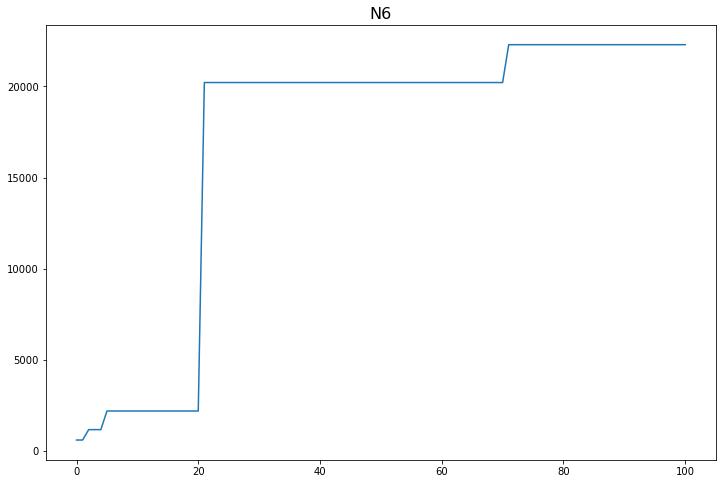

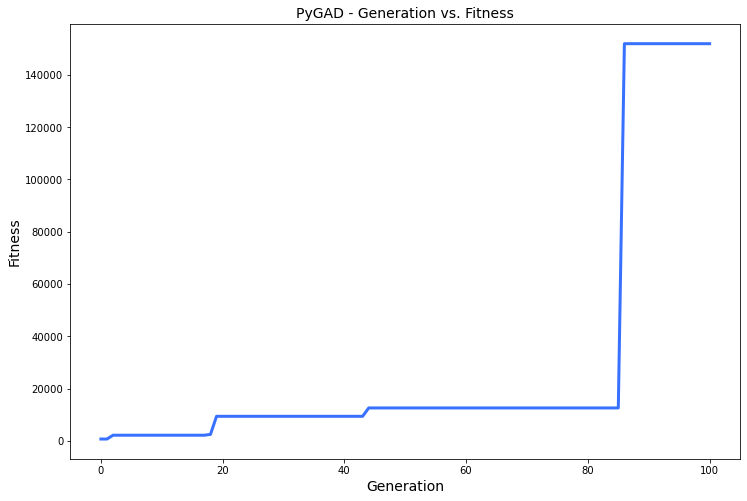

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 27.014 |==================| 14.013 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 26.943 |==================| 7.041 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 26.923 |==================| 6.187 |==========| N3 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 27.022 |==================| 15.831 |==========| N3 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 25.126 |==================| 30.429 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 25.031 |==================| 7.78 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 24.945 |==================| 4.667 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 24.967 |==================| 5.21 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 24.978 |==================| 5.527 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 25.082 |==================| 12.952 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 25.034 |==================| 7.996 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 25.045 |==================| 8.783 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 25.018 |==================| 7.092 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 24.941 |==================| 4.586 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 25.149 |==================| 97.86 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 24.951 |==================| 4.813 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 24.915 |==================| 4.092 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 24.895 |==================| 3.791 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 25.121 |==================| 26.362 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 24.98 |==================| 5.59 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 25.07 |==================| 11.181 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 24.893 |==================| 3.759 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 24.864 |==================| 3.389 |==========| N8 |==========
**********************************************************************
Fitness = 882.487420894377
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 25.12 |==================| 25.759 |==========| N8 |==========
************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 24.998 |==================| 6.21 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 25.109 |==================| 19.834 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 25.089 |==================| 14.33 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 25.07 |==================| 11.181 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 25.008 |==================| 6.611 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 24.947 |==================| 4.722 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 24.909 |==================| 4.0 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 25.099 |==================| 16.539 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 24.95 |==================| 4.787 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 25.058 |==================| 9.845 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 24.873 |==================| 3.49 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 25.031 |==================| 7.812 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 24.982 |==================| 5.656 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 25.034 |==================| 7.967 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 24.867 |==================| 3.427 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 24.941 |==================| 4.587 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 25.013 |==================| 6.817 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 25.092 |==================| 14.877 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 24.893 |==================| 3.754 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 24.907 |==================| 3.969 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 25.101 |==================| 17.148 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 25.075 |==================| 11.863 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 24.863 |==================| 3.371 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 25.032 |==================| 7.856 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 24.872 |==================| 3.487 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 25.045 |==================| 8.759 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 25.133 |==================| 37.906 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 25.038 |==================| 8.218 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 24.862 |==================| 3.364 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 25.013 |==================| 6.832 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 24.926 |==================| 4.284 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 25.077 |==================| 12.175 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 25.152 |==================| 143.62 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 25.062 |==================| 10.303 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 24.949 |==================| 4.748 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 25.114 |==================| 21.905 |==========| N8 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 24.969 |==================| 5.269 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 24.9 |==================| 3.864 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 24.922 |==================| 4.216 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 25.152 |==================| 143.62 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 25.159 |==================| 3234.211 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 24.934 |==================| 4.43 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 25.125 |==================| 29.249 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 24.927 |==================| 4.299 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 24.946 |==================| 4.695 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 24.859 |==================| 3.327 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 24.882 |==================| 3.602 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 24.9 |==================| 3.858 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 24.957 |==================| 4.951 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 25.077 |==================| 12.125 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 25.039 |==================| 8.335 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 25.134 |==================| 40.038 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 25.006 |==================| 6.522 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 25.155 |==================| 249.234 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 24.876 |==================| 3.536 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 25.077 |==================| 12.174 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 25.098 |==================| 16.198 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 24.968 |==================| 5.229 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 24.873 |==================| 3.49 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 24.874 |==================| 3.501 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 25.07 |==================| 11.19 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 24.887 |==================| 3.677 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 25.106 |==================| 18.787 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 24.915 |==================| 4.1 |==========| N8 |==========
**********************************************************************
=====|SOL

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 24.999 |==================| 6.255 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 25.032 |==================| 7.857 |==========| N8 |==========
**********************************************************************
Fitness = 3234.2106142864245
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 24.925 |==================| 4.27 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 24.947 |==================| 4.709 |==========| N8 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 25.095 |==================| 15.468 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 24.99 |==================| 5.906 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 24.93 |==================| 4.371 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 24.999 |==================| 6.255 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 25.123 |==================| 27.864 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 24.91 |==================| 4.018 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 24.892 |==================| 3.742 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 25.002 |==================| 6.358 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 24.943 |==================| 4.615 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 25.13 |==================| 34.642 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 24.918 |==================| 4.139 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 25.123 |==================| 27.864 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 25.024 |==================| 7.411 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 25.105 |==================| 18.413 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 25.053 |==================| 9.453 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 24.932 |==================| 4.407 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 25.044 |==================| 8.645 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 24.903 |==================| 3.903 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 24.954 |==================| 4.872 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 24.874 |==================| 3.501 |==========| N8 |==========
**********************************************************************
Gene

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 25.024 |==================| 7.368 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 25.061 |==================| 10.141 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 24.934 |==================| 4.441 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 25.044 |==================| 8.645 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 24.95 |==================| 4.775 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 25.1 |==================| 16.834 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 25.085 |==================| 13.452 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 25.024 |==================| 7.368 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 24.93 |==================| 4.366 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 24.984 |==================| 5.69 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 24.965 |==================| 5.149 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 25.103 |==================| 17.69 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 24.863 |==================| 3.371 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 24.96 |==================| 5.012 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 25.136 |==================| 42.162 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 24.946 |==================| 4.689 |==========| N8 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 25.122 |==================| 26.841 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 25.059 |==================| 9.989 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 24.86 |==================| 3.344 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 24.951 |==================| 4.792 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 24.879 |==================| 3.569 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.887 |==================| 3.669 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 24.868 |==================| 3.432 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 25.009 |==================| 6.647 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 25.158 |==================| 1049.028 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 25.026 |==================| 7.525 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 25.099 |==================| 16.531 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 24.861 |==================| 3.348 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 24.944 |==================| 4.648 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 25.046 |==================| 8.825 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 25.022 |==================| 7.269 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 24.937 |==================| 4.497 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 24.967 |==================| 5.2 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 25.076 |==================| 12.035 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 24.893 |==================| 3.756 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 25.032 |==================| 7.871 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 25.024 |==================| 7.369 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 25.143 |==================| 61.837 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 24.975 |==================| 5.437 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 24.91 |==================| 4.009 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 25.056 |==================| 9.73 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 25.055 |==================| 9.601 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 25.115 |==================| 22.574 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 24.986 |==================| 5.785 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 25.098 |==================| 16.249 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 25.083 |==================| 13.133 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 25.089 |==================| 14.333 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 25.056 |==================| 9.73 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 24.973 |==================| 5.373 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 24.977 |==================| 5.482 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 25.066 |==================| 10.738 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 24.855 |==================| 3.286 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 24.914 |==================| 4.076 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 25.137 |==================| 44.466 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 24.956 |==================| 4.925 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 25.019 |==================| 7.135 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 24.983 |==================| 5.685 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 25.137 |==================| 45.763 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 25.133 |==================| 37.905 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 24.889 |==================| 3.7 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 25.036 |==================| 8.132 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 25.103 |==================| 17.722 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 24.906 |==================| 3.943 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 25.149 |==================| 93.108 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 24.905 |==================| 3.929 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 25.09 |==================| 14.361 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 24.96 |==================| 5.013 |==========| N8 |==========
**********************************************************************
Generation = 16
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 25.05 |==================| 9.185 |==========| N8 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 25.055 |==================| 9.609 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 25.093 |==================| 15.166 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 25.012 |==================| 6.81 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 25.113 |==================| 21.451 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 25.146 |==================| 77.641 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 24.966 |==================| 5.185 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 24.878 |==================| 3.556 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 25.055 |==================| 9.609 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 24.88 |==================| 3.58 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.995 |==================| 6.071 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 24.885 |==================| 3.645 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 24.863 |==================| 3.376 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 25.146 |==================| 73.686 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 24.923 |==================| 4.236 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 25.05 |==================| 9.18 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 24.912 |==================| 4.045 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 24.921 |==================| 4.189 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 24.965 |==================| 5.142 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 24.975 |==================| 5.432 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 24.919 |==================| 4.169 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 25.057 |==================| 9.827 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 25.123 |==================| 27.862 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 24.895 |==================| 3.79 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 24.95 |==================| 4.775 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 25.157 |==================| 488.966 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 25.123 |==================| 27.441 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 25.083 |==================| 13.131 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 25.149 |==================| 101.873 |==========| N8 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 25.136 |==================| 43.792 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 24.897 |==================| 3.807 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 24.937 |==================| 4.508 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 24.859 |==================| 3.326 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.898 |==================| 3.828 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 24.906 |==================| 3.956 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 25.133 |==================| 37.422 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 24.952 |==================| 4.827 |==========| N8 |==========
**********************************************************************
Fitn

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 24.868 |==================| 3.431 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 24.985 |==================| 5.749 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 24.962 |==================| 5.076 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 24.904 |==================| 3.92 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 25.008 |==================| 6.622 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 25.153 |==================| 170.376 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 25.049 |==================| 9.105 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 25.038 |==================| 8.217 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 24.861 |==================| 3.352 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 25.122 |==================| 26.963 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 24.994 |==================| 6.053 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 24.932 |==================| 4.397 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 24.991 |==================| 5.96 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 25.018 |==================| 7.084 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 24.919 |==================| 4.154 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 24.933 |==================| 4.428 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 24.98 |==================| 5.586 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 25.101 |==================| 17.138 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 25.055 |==================| 9.612 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 24.859 |==================| 3.336 |==========| N8 |==========
**********************************************************************
Gener

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 24.911 |==================| 4.027 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 24.994 |==================| 6.063 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 25.057 |==================| 9.8 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 25.132 |==================| 36.161 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 24.999 |==================| 6.238 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 24.874 |==================| 3.504 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 24.959 |==================| 4.988 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 25.09 |==================| 14.509 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 25.103 |==================| 17.724 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 25.091 |==================| 14.669 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 24.979 |==================| 5.547 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 25.045 |==================| 8.717 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 25.002 |==================| 6.355 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 24.965 |==================| 5.152 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 25.089 |==================| 14.226 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 25.039 |==================| 8.315 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 25.106 |==================| 18.68 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 25.079 |==================| 12.465 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 24.964 |==================| 5.124 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 24.866 |==================| 3.412 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 24.916 |==================| 4.118 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 24.874 |==================| 3.509 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 25.098 |==================| 16.294 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 24.957 |==================| 4.943 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 24.906 |==================| 3.95 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 25.052 |==================| 9.31 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 25.134 |==================| 40.252 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 25.018 |==================| 7.062 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 25.071 |==================| 11.363 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 25.101 |==================| 17.076 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 24.931 |==================| 4.38 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 25.066 |==================| 10.729 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 25.006 |==================| 6.525 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 24.89 |==================| 3.718 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 25.106 |==================| 18.717 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 25.017 |==================| 7.021 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 24.912 |==================| 4.04 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 25.067 |==================| 10.815 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 24.976 |==================| 5.45 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 25.006 |==================| 6.525 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 25.095 |==================| 15.481 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 25.079 |==================| 12.426 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 25.125 |==================| 28.852 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 25.082 |==================| 12.989 |==========| N8 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 25.058 |==================| 9.878 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 25.009 |==================| 6.667 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 24.948 |==================| 4.727 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 25.086 |==================| 13.564 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 25.043 |==================| 8.635 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 24.878 |==================| 3.552 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 25.107 |==================| 19.133 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 25.058 |==================| 9.878 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 24.864 |==================| 3.385 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 24.885 |==================| 3.645 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 24.934 |==================| 4.433 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 24.887 |==================| 3.666 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 25.036 |==================| 8.126 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 24.983 |==================| 5.675 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 25.099 |==================| 16.595 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 25.083 |==================| 13.091 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 24.921 |==================| 4.205 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 25.089 |==================| 14.146 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 25.043 |==================| 8.603 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 24.947 |==================| 4.712 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 25.098 |==================| 16.342 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.902 |==================| 3.889 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 25.145 |==================| 68.302 |==========| N8 |==========
**********************************************************************
Generation = 27
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 25.056 |==================| 9.691 |==========| N8 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 25.122 |==================| 27.078 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 24.924 |==================| 4.245 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 25.069 |==================| 11.085 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 25.098 |==================| 16.342 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 24.908 |==================| 3.974 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 25.024 |==================| 7.384 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 25.111 |==================| 20.86 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 25.109 |==================| 19.872 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 24.991 |==================| 5.958 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 24.868 |==================| 3.431 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 24.998 |==================| 6.199 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 25.153 |==================| 163.382 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 24.921 |==================| 4.205 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 25.07 |==================| 11.248 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 25.003 |==================| 6.406 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 25.104 |==================| 18.117 |==========| N8 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 25.074 |==================| 11.722 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 24.862 |==================| 3.367 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 25.111 |==================| 20.854 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 24.921 |==================| 4.205 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 25.007 |==================| 6.551 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 24.883 |==================| 3.615 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 25.11 |==================| 20.491 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 24.871 |==================| 3.471 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 25.103 |==================| 17.791 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 25.121 |==================| 25.825 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 24.865 |==================| 3.404 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 25.007 |==================| 6.551 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 24.866 |==================| 3.41 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 24.87 |==================| 3.454 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 25.046 |==================| 8.844 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 24.976 |==================| 5.465 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 25.043 |==================| 8.604 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 25.113 |==================| 21.851 |==========| N8 |==========
**********************************************************************
Fitness = 3234.2106142864245
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 24.986 |==================| 5.757 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 25.055 |==================| 9.56 |==========| N8 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 25.002 |==================| 6.349 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 24.999 |==================| 6.237 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 25.155 |==================| 226.966 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 24.917 |==================| 4.13 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 25.152 |==================| 141.095 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 24.944 |==================| 4.648 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 24.993 |==================| 6.016 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 25.012 |==================| 6.784 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 24.864 |==================| 3.384 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 25.128 |==================| 32.426 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.902 |==================| 3.887 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 25.041 |==================| 8.472 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 25.112 |==================| 21.033 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 24.996 |==================| 6.133 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 25.004 |==================| 6.435 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 25.115 |==================| 22.755 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 24.898 |==================| 3.821 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 24.948 |==================| 4.744 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 25.137 |==================| 44.628 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 24.88 |==================| 3.585 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 25.117 |==================| 23.536 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 25.11 |==================| 20.179 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 25.146 |==================| 75.701 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 24.898 |==================| 3.821 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 24.901 |==================| 3.868 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 24.87 |==================| 3.458 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 25.095 |==================| 15.517 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 24.904 |==================| 3.918 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 25.093 |==================| 15.118 |==========| N8 |==========
**********************************************************************
Generation = 33
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 24.873 |==================| 3.489 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 25.067 |==================| 10.793 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 24.978 |==================| 5.515 |==========| N8 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 24.909 |==================| 3.997 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 24.961 |==================| 5.047 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 24.971 |==================| 5.304 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 24.874 |==================| 3.509 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 25.056 |==================| 9.701 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.967 |==================| 5.213 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 25.052 |==================| 9.357 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 25.013 |==================| 6.837 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 25.086 |==================| 13.603 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 25.14 |==================| 53.207 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 24.904 |==================| 3.922 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 24.968 |==================| 5.239 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 24.921 |==================| 4.195 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 24.863 |==================| 3.374 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 25.091 |==================| 14.687 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 25.098 |==================| 16.318 |==========| N8 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 24.865 |==================| 3.395 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 24.974 |==================| 5.388 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 25.134 |==================| 39.621 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 25.006 |==================| 6.539 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 24.986 |==================| 5.77 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 25.008 |==================| 6.627 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 24.88 |==================| 3.584 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 24.885 |==================| 3.641 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 24.987 |==================| 5.822 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 25.093 |==================| 15.171 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 25.009 |==================| 6.665 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 24.857 |==================| 3.312 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 24.917 |==================| 4.128 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 25.015 |==================| 6.91 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 25.07 |==================| 11.268 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 25.13 |==================| 34.026 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 25.005 |==================| 6.481 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 25.082 |==================| 12.997 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 25.061 |==================| 10.149 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 24.943 |==================| 4.622 |==========| N8 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 25.065 |==================| 10.619 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 25.028 |==================| 7.628 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 24.947 |==================| 4.719 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 24.902 |==================| 3.893 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 25.08 |==================| 12.541 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 25.019 |==================| 7.144 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 25.02 |==================| 7.202 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 25.048 |==================| 9.023 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 25.006 |==================| 6.514 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 24.977 |==================| 5.474 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 25.043 |==================| 8.624 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 24.896 |==================| 3.794 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.986 |==================| 5.782 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 24.955 |==================| 4.905 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 24.978 |==================| 5.531 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 24.931 |==================| 4.387 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 24.912 |==================| 4.04 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 25.118 |==================| 24.131 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 25.076 |==================| 12.085 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 24.982 |==================| 5.653 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 24.964 |==================| 5.117 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 25.154 |==================| 209.016 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 25.072 |==================| 11.504 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 24.941 |==================| 4.578 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 25.046 |==================| 8.805 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 25.082 |==================| 12.91 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 24.909 |==================| 4.003 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 25.111 |==================| 20.854 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 24.996 |==================| 6.133 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 24.897 |==================| 3.809 |==========| N8 |==========
**********************************************************************
Generation = 39
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 25.001 |==================| 6.313 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 25.071 |==================| 11.328 |==========| N8 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 24.971 |==================| 5.324 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 24.949 |==================| 4.759 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 25.049 |==================| 9.052 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 24.865 |==================| 3.401 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 24.944 |==================| 4.64 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 24.949 |==================| 4.752 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 25.158 |==================| 990.659 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 25.135 |==================| 41.252 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 24.943 |==================| 4.617 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 25.096 |==================| 15.936 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 24.933 |==================| 4.417 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 24.925 |==================| 4.278 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 24.975 |==================| 5.441 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 25.086 |==================| 13.592 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 25.037 |==================| 8.18 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 25.001 |==================| 6.303 |==========| N8 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 24.951 |==================| 4.795 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 25.071 |==================| 11.378 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 25.009 |==================| 6.65 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 24.926 |==================| 4.289 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 25.03 |==================| 7.76 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 25.088 |==================| 14.067 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 24.971 |==================| 5.308 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 24.986 |==================| 5.763 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 24.964 |==================| 5.111 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 25.127 |==================| 30.596 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 25.135 |==================| 41.647 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 25.094 |==================| 15.372 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 24.863 |==================| 3.371 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 25.047 |==================| 8.892 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 24.909 |==================| 4.002 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 25.031 |==================| 7.799 |==========| N8 |==========
**********************************************************************
=====

======| 0.744 |===========| 24.933 |==================| 4.412 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 24.925 |==================| 4.264 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 25.157 |==================| 556.953 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 25.158 |==================| 930.226 |==========| N8 |==========
**********************************************************************
Fitness = 3234.2106142864245
=====|SOLUTION|===========|OUTPUT|==================|FITNES

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 25.104 |==================| 17.971 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 24.951 |==================| 4.8 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 25.101 |==================| 17.302 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 24.933 |==================| 4.412 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 24.934 |==================| 4.448 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 24.956 |==================| 4.916 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 24.869 |==================| 3.448 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 24.873 |==================| 3.493 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 24.871 |==================| 3.467 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 25.086 |==================| 13.597 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 24.955 |==================| 4.907 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 25.065 |==================| 10.638 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 24.958 |==================| 4.964 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 24.972 |==================| 5.33 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 24.871 |==================| 3.475 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 25.05 |==================| 9.117 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 24.968 |==================| 5.221 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 24.987 |==================| 5.82 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 24.908 |==================| 3.973 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 25.031 |==================| 7.807 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 24.921 |==================| 4.195 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 24.985 |==================| 5.748 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 24.953 |==================| 4.856 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 24.942 |==================| 4.596 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 25.032 |==================| 7.853 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 24.867 |==================| 3.423 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 24.901 |==================| 3.873 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 25.155 |==================| 255.78 |==========| N8 |==========
**********************************************************************
====

======| 0.844 |===========| 24.902 |==================| 3.882 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 24.906 |==================| 3.953 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 25.143 |==================| 61.136 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 25.139 |==================| 48.401 |==========| N8 |==========
**********************************************************************
Generation = 45
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 25.14 |==================| 51.495 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 25.05 |==================| 9.168 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 25.124 |==================| 28.749 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 24.902 |==================| 3.882 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 24.943 |==================| 4.634 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.898 |==================| 3.829 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 24.891 |==================| 3.726 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 24.955 |==================| 4.89 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 25.053 |==================| 9.436 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 25.131 |==================| 35.121 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 24.886 |==================| 3.656 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 24.93 |==================| 4.364 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 24.947 |==================| 4.719 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 24.888 |==================| 3.688 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 25.122 |==================| 26.691 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 25.156 |==================| 324.727 |==========| N8 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 24.879 |==================| 3.565 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 24.893 |==================| 3.762 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 24.951 |==================| 4.804 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 24.922 |==================| 4.215 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 25.063 |==================| 10.392 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 25.099 |==================| 16.551 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 24.99 |==================| 5.901 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 25.143 |==================| 61.309 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 24.968 |==================| 5.222 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.993 |==================| 5.998 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 25.043 |==================| 8.618 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 25.102 |==================| 17.407 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 25.143 |==================| 60.983 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 25.097 |==================| 16.058 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 25.149 |==================| 101.56 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 25.084 |==================| 13.3 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 25.064 |==================| 10.451 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.993 |==================| 6.001 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 24.854 |==================| 3.276 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 25.016 |==================| 6.979 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 25.068 |==================| 10.986 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 24.933 |==================| 4.413 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 24.899 |==================| 3.842 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 25.01 |==================| 6.711 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 24.975 |==================| 5.42 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 25.082 |==================| 12.901 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 25.081 |==================| 12.801 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 24.87 |==================| 3.461 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 24.978 |==================| 5.503 |==========| N8 |==========
**********************************************************************
Fitness = 3234.2106142864245
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 25.122 |==================| 26.513 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 24.911 |==================| 4.027 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 25.087 |==================| 13.837 |==========| N8 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 25.045 |==================| 8.773 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 24.944 |==================| 4.655 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 25.109 |==================| 20.045 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 25.026 |==================| 7.496 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 25.069 |==================| 11.093 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 24.872 |==================| 3.484 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 24.885 |==================| 3.647 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 25.088 |==================| 14.042 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 25.147 |==================| 84.302 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 25.071 |==================| 11.373 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 25.136 |==================| 43.511 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 24.911 |==================| 4.035 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 25.103 |==================| 17.688 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 24.983 |==================| 5.677 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 25.092 |==================| 14.834 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 24.996 |==================| 6.121 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 25.088 |==================| 14.03 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 25.097 |==================| 16.1 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 25.13 |==================| 34.226 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 24.908 |==================| 3.979 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 24.958 |==================| 4.964 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 25.134 |==================| 40.195 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 24.926 |==================| 4.291 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 25.14 |==================| 52.339 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 24.934 |==================| 4.446 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 24.907 |==================| 3.963 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 24.893 |==================| 3.758 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 24.86 |==================| 3.336 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 24.943 |==================| 4.635 |==========| N8 |==========
**********************************************************************
Generation = 52
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 25.149 |==================| 95.509 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 24.934 |==================| 4.442 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 24.903 |==================| 3.9 |==========| N8 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 25.018 |==================| 7.095 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 25.148 |==================| 88.245 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 25.087 |==================| 13.883 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 25.047 |==================| 8.918 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 24.889 |==================| 3.7 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 25.049 |==================| 9.066 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 24.884 |==================| 3.632 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 24.952 |==================| 4.819 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 24.873 |==================| 3.49 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 24.861 |==================| 3.357 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 25.145 |==================| 70.262 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 25.027 |==================| 7.579 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 24.961 |==================| 5.038 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 25.108 |==================| 19.7 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 25.015 |==================| 6.911 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 25.15 |==================| 109.145 |==========| N8 |==========
***************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 24.962 |==================| 5.057 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 25.059 |==================| 9.94 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 25.121 |==================| 26.146 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 24.892 |==================| 3.744 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 24.97 |==================| 5.293 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 24.977 |==================| 5.478 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 25.007 |==================| 6.563 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 24.935 |==================| 4.466 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 24.952 |==================| 4.835 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 24.953 |==================| 4.858 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 24.858 |==================| 3.319 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 25.108 |==================| 19.547 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 24.996 |==================| 6.135 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 24.889 |==================| 3.697 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 24.894 |==================| 3.765 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 24.956 |==================| 4.926 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 25.032 |==================| 7.828 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 24.939 |==================| 4.54 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 24.916 |==================| 4.111 |==========| N8 |==========
**********************************************************************
Fitness = 3234.2106142864245
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 25.012 |==================| 6.814 |==========| N8 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 25.087 |==================| 13.766 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 24.908 |==================| 3.977 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 25.008 |==================| 6.594 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 24.937 |==================| 4.496 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 24.976 |==================| 5.445 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 24.87 |==================| 3.461 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 25.132 |==================| 36.126 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 24.988 |==================| 5.823 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 25.066 |==================| 10.69 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 24.912 |==================| 4.047 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 24.879 |==================| 3.568 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 24.922 |==================| 4.216 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 25.031 |==================| 7.772 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 25.046 |==================| 8.818 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 24.906 |==================| 3.942 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 25.075 |==================| 11.894 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 24.903 |==================| 3.902 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 25.052 |==================| 9.363 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 25.012 |==================| 6.805 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 24.872 |==================| 3.476 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 25.015 |==================| 6.935 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 25.08 |==================| 12.55 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 24.92 |==================| 4.179 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 25.0 |==================| 6.274 |==========| N8 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 25.116 |==================| 23.233 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 24.91 |==================| 4.013 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 24.914 |==================| 4.079 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 24.899 |==================| 3.844 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 25.06 |==================| 10.042 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 25.148 |==================| 91.31 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 24.934 |==================| 4.447 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 24.96 |==================| 5.023 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 24.993 |==================| 6.014 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 24.967 |==================| 5.193 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 25.115 |==================| 22.555 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 24.981 |==================| 5.603 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 25.156 |==================| 348.151 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 25.009 |==================| 6.674 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 25.137 |==================| 45.666 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 24.858 |==================| 3.324 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 25.05 |==================| 9.115 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 24.872 |==================| 3.478 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 25.011 |==================| 6.725 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 25.016 |==================| 6.96 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 24.927 |==================| 4.308 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 25.03 |==================| 7.721 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 25.111 |==================| 20.715 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 25.059 |==================| 9.971 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 25.063 |==================| 10.376 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 24.92 |==================| 4.179 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 24.865 |==================| 3.395 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 24.974 |==================| 5.408 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 24.854 |==================| 3.277 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 24.906 |==================| 3.947 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 25.067 |==================| 10.826 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 24.98 |==================| 5.589 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 24.897 |==================| 3.812 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 25.02 |==================| 7.195 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 25.044 |==================| 8.675 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 25.084 |==================| 13.204 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 25.145 |==================| 68.387 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 25.03 |==================| 7.745 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 25.045 |==================| 8.77 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 25.077 |==================| 12.233 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 25.027 |==================| 7.582 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 24.87 |==================| 3.46 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 25.083 |==================| 13.063 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 25.019 |==================| 7.108 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 24.918 |==================| 4.141 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 25.156 |==================| 278.593 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 24.9 |==================| 3.86 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 24.967 |==================| 5.198 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 25.013 |==================| 6.846 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 24.936 |==================| 4.475 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 24.962 |==================| 5.061 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 25.093 |==================| 15.069 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 25.116 |==================| 22.874 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 25.083 |==================| 13.096 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 24.944 |==================| 4.652 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 24.94 |==================| 4.561 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 25.051 |==================| 9.278 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 25.021 |==================| 7.215 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 25.057 |==================| 9.8 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 25.084 |==================| 13.289 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 24.93 |==================| 4.355 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 24.874 |==================| 3.508 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 24.893 |==================| 3.75 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 25.037 |==================| 8.208 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 25.131 |==================| 35.775 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 25.001 |==================| 6.314 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 24.935 |==================| 4.451 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 24.957 |==================| 4.934 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 25.046 |==================| 8.798 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 25.136 |==================| 42.165 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 24.947 |==================| 4.705 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 25.055 |==================| 9.59 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 24.961 |==================| 5.047 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 25.131 |==================| 35.412 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 25.131 |==================| 34.99 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 25.077 |==================| 12.126 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 24.958 |==================| 4.958 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 25.025 |==================| 7.454 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 24.988 |==================| 5.835 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 24.883 |==================| 3.623 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 25.07 |==================| 11.162 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 24.963 |==================| 5.099 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 25.054 |==================| 9.487 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 25.024 |==================| 7.407 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 25.142 |==================| 57.23 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 25.061 |==================| 10.215 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 25.018 |==================| 7.071 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 25.076 |==================| 11.956 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 25.14 |==================| 51.129 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 25.135 |==================| 41.479 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 24.915 |==================| 4.087 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 25.059 |==================| 10.009 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 24.914 |==================| 4.082 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 24.914 |==================| 4.072 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 25.108 |==================| 19.486 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 24.939 |==================| 4.533 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 24.951 |==================| 4.8 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 24.924 |==================| 4.254 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 25.002 |==================| 6.363 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 25.126 |==================| 30.124 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 24.924 |==================| 4.254 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 24.916 |==================| 4.118 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 24.977 |==================| 5.489 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 24.973 |==================| 5.38 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 24.922 |==================| 4.21 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.908 |==================| 3.987 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 24.975 |==================| 5.431 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 24.977 |==================| 5.479 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 24.961 |==================| 5.043 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 24.899 |==================| 3.844 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 25.022 |==================| 7.279 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 24.959 |==================| 4.995 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 24.857 |==================| 3.307 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 25.071 |==================| 11.349 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 24.935 |==================| 4.45 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 24.98 |==================| 5.584 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 25.094 |==================| 15.317 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 24.933 |==================| 4.425 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 24.875 |==================| 3.515 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 25.101 |==================| 17.258 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 25.032 |==================| 7.844 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 24.998 |==================| 6.203 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 25.069 |==================| 11.047 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 25.094 |==================| 15.317 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 25.023 |==================| 7.342 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 24.875 |==================| 3.523 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 25.042 |==================| 8.52 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 24.95 |==================| 4.785 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 24.873 |==================| 3.489 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 24.931 |==================| 4.387 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 25.117 |==================| 23.918 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 24.861 |==================| 3.351 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 25.083 |==================| 13.067 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 25.096 |==================| 15.782 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 25.122 |==================| 26.556 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 24.969 |==================| 5.26 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 24.96 |==================| 5.026 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 24.991 |==================| 5.938 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 24.898 |==================| 3.834 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 25.103 |==================| 17.861 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 25.084 |==================| 13.278 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 24.948 |==================| 4.726 |==========| N8 |==========
**********************************************************************
Generation = 70
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 25.065 |==================| 10.584 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 24.93 |==================| 4.365 |==========| N8 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 24.969 |==================| 5.251 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 24.949 |==================| 4.759 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 24.925 |==================| 4.262 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 25.084 |==================| 13.278 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 25.132 |==================| 36.674 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 24.979 |==================| 5.546 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 24.864 |==================| 3.381 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 24.869 |==================| 3.449 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 25.015 |==================| 6.933 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 24.928 |==================| 4.323 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 25.054 |==================| 9.531 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 25.125 |==================| 29.62 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 24.968 |==================| 5.227 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 24.994 |==================| 6.064 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 24.92 |==================| 4.182 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 24.908 |==================| 3.975 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 24.988 |==================| 5.85 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 24.972 |==================| 5.354 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 25.07 |==================| 11.26 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 25.156 |==================| 270.161 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 24.952 |==================| 4.822 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 25.102 |==================| 17.353 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 25.006 |==================| 6.506 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 24.907 |==================| 3.959 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 25.095 |==================| 15.495 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 25.141 |==================| 55.948 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 25.047 |==================| 8.949 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 24.945 |==================| 4.657 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 25.062 |==================| 10.247 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 25.101 |==================| 17.139 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 24.929 |==================| 4.351 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 25.088 |==================| 14.134 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 24.969 |==================| 5.261 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 24.91 |==================| 4.012 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 25.091 |==================| 14.605 |==========| N8 |==========
**********************************************************************
Fitness = 3234.2106142864245
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 25.035 |==================| 8.055 |==========| N8 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 25.151 |==================| 125.664 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 24.879 |==================| 3.567 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 24.901 |==================| 3.87 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 24.978 |==================| 5.508 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 25.152 |==================| 129.506 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 24.957 |==================| 4.936 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 25.105 |==================| 18.603 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 24.929 |==================| 4.348 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 25.15 |==================| 111.792 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 25.017 |==================| 7.035 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 24.958 |==================| 4.97 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 25.028 |==================| 7.625 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 24.972 |==================| 5.333 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 25.087 |==================| 13.748 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 25.048 |==================| 9.023 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 25.054 |==================| 9.52 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 25.15 |==================| 103.962 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 24.946 |==================| 4.7 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 25.059 |==================| 10.008 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 25.058 |==================| 9.874 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 24.877 |==================| 3.543 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 25.099 |==================| 16.666 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 24.934 |==================| 4.433 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 24.951 |==================| 4.8 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 25.038 |==================| 8.247 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 25.104 |==================| 18.083 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 24.912 |==================| 4.048 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 24.863 |==================| 3.378 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 24.938 |==================| 4.516 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 25.02 |==================| 7.179 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 25.071 |==================| 11.355 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 24.86 |==================| 3.341 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.967 |==================| 5.212 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 24.904 |==================| 3.917 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 24.989 |==================| 5.865 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 25.017 |==================| 7.011 |==========| N8 |==========
****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 25.112 |==================| 21.356 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 25.129 |==================| 33.257 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 25.158 |==================| 680.196 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 24.995 |==================| 6.081 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 25.065 |==================| 10.646 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 25.106 |==================| 18.761 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 24.956 |==================| 4.925 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 24.902 |==================| 3.894 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 25.063 |==================| 10.337 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 25.029 |==================| 7.689 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 24.984 |==================| 5.701 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 24.905 |==================| 3.939 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 25.148 |==================| 92.607 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 24.903 |==================| 3.905 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 24.864 |==================| 3.391 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 24.879 |==================| 3.568 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 24.904 |==================| 3.915 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 24.858 |==================| 3.318 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 25.078 |==================| 12.298 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.902 |==================| 3.888 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 25.09 |==================| 14.428 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 25.061 |==================| 10.17 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 24.883 |==================| 3.621 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 25.017 |==================| 7.041 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 25.025 |==================| 7.449 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 25.087 |==================| 13.877 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 25.126 |==================| 30.006 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 24.864 |==================| 3.386 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 24.882 |==================| 3.603 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 25.033 |==================| 7.936 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.994 |==================| 6.067 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 25.084 |==================| 13.363 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 24.869 |==================| 3.443 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 25.101 |==================| 17.223 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 24.876 |==================| 3.536 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 25.127 |==================| 30.734 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 25.075 |==================| 11.899 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 25.018 |==================| 7.085 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 24.997 |==================| 6.166 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 25.032 |==================| 7.873 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 25.095 |==================| 15.495 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 25.085 |==================| 13.461 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 24.952 |==================| 4.816 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 25.063 |==================| 10.421 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 25.045 |==================| 8.777 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 25.075 |==================| 11.823 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 24.879 |==================| 3.566 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 24.991 |==================| 5.935 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 24.855 |==================| 3.292 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 25.078 |==================| 12.245 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 25.062 |==================| 10.3 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 25.072 |==================| 11.437 |==========| N8 |==========
**********************************************************************
Gener

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 24.933 |==================| 4.429 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 24.926 |==================| 4.294 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 25.004 |==================| 6.45 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 25.097 |==================| 16.149 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 24.936 |==================| 4.486 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.902 |==================| 3.885 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 24.954 |==================| 4.882 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 24.992 |==================| 5.964 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 24.907 |==================| 3.96 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 24.935 |==================| 4.458 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 25.114 |==================| 22.257 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 25.033 |==================| 7.943 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 24.983 |==================| 5.688 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 24.895 |==================| 3.779 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 24.983 |==================| 5.669 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 25.106 |==================| 18.867 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 25.122 |==================| 26.871 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 24.901 |==================| 3.876 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 25.059 |==================| 9.943 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 25.021 |==================| 7.249 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 24.886 |==================| 3.665 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 24.878 |==================| 3.553 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 25.157 |==================| 484.649 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 25.153 |==================| 149.965 |==========| N8 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 25.112 |==================| 21.296 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 24.892 |==================| 3.744 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 24.865 |==================| 3.399 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 25.021 |==================| 7.252 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 25.005 |==================| 6.495 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 24.996 |==================| 6.132 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 24.876 |==================| 3.535 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 24.998 |==================| 6.212 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 25.017 |==================| 7.032 |==========| N8 |==========
**********************************************************************
Fitness = 3234.2106142864245
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 24.913 |==================| 4.069 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 25.009 |==================| 6.644 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 24.957 |==================| 4.955 |==========| N8 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 24.87 |==================| 3.452 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 24.961 |==================| 5.042 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 25.082 |==================| 12.91 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 24.949 |==================| 4.765 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 24.943 |==================| 4.617 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 24.994 |==================| 6.034 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 25.115 |==================| 22.72 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 24.889 |==================| 3.697 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 24.895 |==================| 3.78 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 24.949 |==================| 4.756 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.984 |==================| 5.72 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 25.001 |==================| 6.307 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 24.879 |==================| 3.563 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 25.108 |==================| 19.561 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 24.955 |==================| 4.901 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 25.159 |==================| 2015.147 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 25.057 |==================| 9.742 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 24.996 |==================| 6.119 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 24.922 |==================| 4.216 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 25.106 |==================| 18.766 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 25.056 |==================| 9.694 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 24.864 |==================| 3.39 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 24.932 |==================| 4.402 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 24.904 |==================| 3.922 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 25.143 |==================| 61.532 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 25.1 |==================| 16.927 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 25.082 |==================| 12.934 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 25.127 |==================| 31.107 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 25.048 |==================| 8.988 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 25.127 |==================| 30.913 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 25.069 |==================| 11.13 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 24.871 |==================| 3.465 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 24.896 |==================| 3.799 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 25.045 |==================| 8.754 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 24.973 |==================| 5.367 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 25.009 |==================| 6.668 |==========| N8 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 25.078 |==================| 12.382 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 25.129 |==================| 33.366 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 24.992 |==================| 5.986 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 25.149 |==================| 94.892 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 25.104 |==================| 17.949 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 25.018 |==================| 7.057 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 25.139 |==================| 48.827 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 25.122 |==================| 26.635 |==========| N8 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 25.05 |==================| 9.162 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 24.912 |==================| 4.039 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 25.001 |==================| 6.326 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 24.919 |==================| 4.167 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 24.95 |==================| 4.778 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 25.148 |==================| 87.87 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 24.998 |==================| 6.211 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 25.006 |==================| 6.509 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 25.05 |==================| 9.131 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 24.972 |==================| 5.348 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 25.027 |==================| 7.538 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 24.998 |==================| 6.207 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 24.912 |==================| 4.049 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 25.045 |==================| 8.777 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 24.868 |==================| 3.437 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 24.927 |==================| 4.311 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 24.954 |==================| 4.878 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 25.023 |==================| 7.333 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 24.92 |==================| 4.185 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 24.866 |==================| 3.409 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 24.903 |==================| 3.899 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 25.107 |==================| 19.053 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.908 |==================| 3.988 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 24.954 |==================| 4.878 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 25.113 |==================| 21.566 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 25.048 |==================| 8.984 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 25.0 |==================| 6.269 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 24.94 |==================| 4.561 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 25.066 |==================| 10.68 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 25.144 |==================| 64.736 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 24.905 |==================| 3.931 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 25.086 |==================| 13.687 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 25.132 |==================| 36.513 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 25.04 |==================| 8.4 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 25.08 |==================| 12.652 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 25.098 |==================| 16.407 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 25.084 |==================| 13.33 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 24.952 |==================| 4.827 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 24.89 |==================| 3.707 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 25.108 |==================| 19.545 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 24.856 |==================| 3.293 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 25.159 |==================| 6666.635 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 24.93 |==================| 4.355 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 25.052 |==================| 9.32 |==========| N8 |==========
**********************************************************************
Gener

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 24.982 |==================| 5.641 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 24.91 |==================| 4.01 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 25.088 |==================| 14.085 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 24.954 |==================| 4.864 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 25.119 |==================| 24.653 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 24.999 |==================| 6.249 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 24.906 |==================| 3.946 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 24.892 |==================| 3.74 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 25.004 |==================| 6.444 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 24.892 |==================| 3.742 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 24.945 |==================| 4.663 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 24.958 |==================| 4.976 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 25.03 |==================| 7.71 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 25.117 |==================| 23.572 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 25.035 |==================| 8.024 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 24.953 |==================| 4.839 |==========| N8 |==========
****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 25.12 |==================| 25.593 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 25.005 |==================| 6.501 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 24.962 |==================| 5.076 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 25.008 |==================| 6.625 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 24.914 |==================| 4.072 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 25.126 |==================| 29.675 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 25.063 |==================| 10.431 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 24.906 |==================| 3.947 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 25.016 |==================| 6.994 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 24.956 |==================| 4.913 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 25.102 |==================| 17.42 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 24.917 |==================| 4.13 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 25.089 |==================| 14.298 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 25.125 |==================| 29.528 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 24.866 |==================| 3.411 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 25.159 |==================| 2124.192 |==========| N8 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 24.882 |==================| 3.61 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 25.027 |==================| 7.546 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 25.129 |==================| 33.019 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 25.049 |==================| 9.096 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 25.049 |==================| 9.061 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 24.98 |==================| 5.589 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 24.895 |==================| 3.78 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 25.04 |==================| 8.385 |==========| N8 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.902 |==================| 3.884 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 25.154 |==================| 198.223 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 24.98 |==================| 5.573 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 25.088 |==================| 14.008 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 25.108 |==================| 19.566 |==========| N8 |==========
**********************************************************************
Fitness = 6666.634562903755
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 24.974 |==================| 5.397 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.887 |==================| 3.67 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 24.924 |==================| 4.255 |==========| N8 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 24.962 |==================| 5.08 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 25.136 |==================| 42.43 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 24.952 |==================| 4.83 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 25.152 |==================| 130.755 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 24.987 |==================| 5.805 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 25.019 |==================| 7.152 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 25.062 |==================| 10.242 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 25.042 |==================| 8.552 |==========| N8 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 24.963 |==================| 5.1 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 24.926 |==================| 4.283 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 24.967 |==================| 5.192 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 24.895 |==================| 3.788 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 25.096 |==================| 15.836 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 25.084 |==================| 13.233 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 25.045 |==================| 8.726 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 24.929 |==================| 4.348 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 25.135 |==================| 41.001 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 24.913 |==================| 4.058 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 25.117 |==================| 23.544 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 25.066 |==================| 10.682 |==========| N8 |==========
**********************************************************************
G

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 25.04 |==================| 8.375 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 24.905 |==================| 3.929 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 24.987 |==================| 5.817 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 25.017 |==================| 7.049 |==========| N8 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 25.032 |==================| 7.831 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 24.982 |==================| 5.647 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 24.979 |==================| 5.533 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 25.065 |==================| 10.586 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 25.088 |==================| 14.03 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 25.118 |==================| 24.0 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 24.999 |==================| 6.24 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 24.999 |==================| 6.259 |==========| N8 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 25.091 |==================| 14.719 |==========| N8 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 24.941 |==================| 4.58 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 24.975 |==================| 5.436 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 25.001 |==================| 6.325 |==========| N8 |==========
***************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 24.927 |==================| 4.304 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 25.124 |==================| 28.465 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 24.987 |==================| 5.801 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 25.033 |==================| 7.908 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 25.006 |==================| 6.528 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 25.083 |==================| 13.118 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 25.126 |==================| 29.674 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 25.014 |==================| 6.885 |==========| N8 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 25.011 |==================| 6.743 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 24.905 |==================| 3.927 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 24.971 |==================| 5.312 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 24.975 |==================| 5.43 |==========| N8 |==========
**********************************************************************
=====

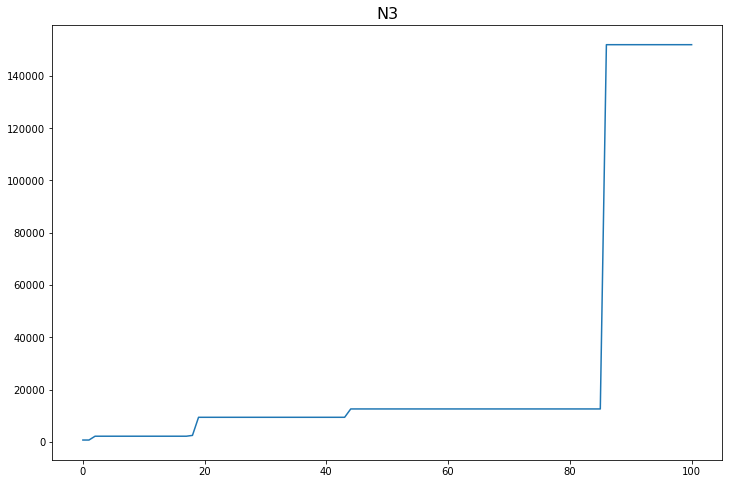

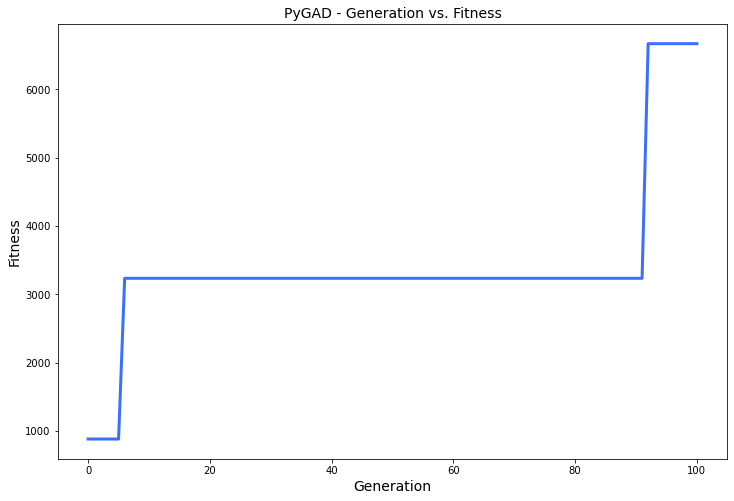

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 25.125 |==================| 29.027 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 24.941 |==================| 4.572 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 25.075 |==================| 11.802 |==========| N8 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 24.926 |==================| 4.287 |==========| N8 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 30.24 |==================| 2.815 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 30.565 |==================| 33.332 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 29.875 |==================| 1.388 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 30.22 |==================| 2.666 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 30.581 |==================| 68.651 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 30.502 |==================| 10.715 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 29.574 |==================| 0.979 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 30.054 |==================| 1.848 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 30.017 |==================| 1.73 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 30.28 |==================| 3.175 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 30.364 |==================| 4.322 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 30.575 |==================| 49.832 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 30.099 |==================| 2.013 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 30.507 |==================| 11.341 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 29.802 |==================| 1.26 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 30.187 |==================| 2.447 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 29.462 |==================| 0.882 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 30.474 |==================| 8.265 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 29.734 |==================| 1.16 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 29.741 |==================| 1.17 |==========| N13 |==========
**********************************************************************
Fi

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 30.024 |==================| 1.751 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 29.519 |==================| 0.929 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 30.354 |==================| 4.148 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 29.638 |==================| 1.045 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 30.527 |==================| 14.579 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 30.118 |==================| 2.097 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 29.56 |==================| 0.966 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 30.426 |==================| 5.903 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 29.475 |==================| 0.892 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 30.537 |==================| 17.114 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 29.585 |==================| 0.99 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 29.739 |==================| 1.168 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 30.513 |==================| 12.125 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 30.533 |==================| 16.082 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 29.922 |==================| 1.484 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 29.672 |==================| 1.083 |==========| N13 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 30.184 |==================| 2.434 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 29.615 |==================| 1.02 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 30.014 |==================| 1.721 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 29.824 |==================| 1.296 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 29.512 |==================| 0.923 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 30.326 |==================| 3.718 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 29.55 |==================| 0.956 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 30.138 |==================| 2.188 |==========| N13 |==========
**********************************************************************
=

======| 0.932 |===========| 29.533 |==================| 0.941 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 30.397 |==================| 5.048 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 30.187 |==================| 2.451 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 30.177 |==================| 2.391 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 30.038 |==================| 1.795 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 30.27 |==================| 3.076 |==========| N13 |==========
**********************************************************************
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 30.367 |==================| 4.381 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 30.54 |==================| 17.947 |==========| N13 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 30.416 |==================| 5.579 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 29.635 |==================| 1.041 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 30.045 |==================| 1.816 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 30.018 |==================| 1.734 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 30.461 |==================| 7.422 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 30.063 |==================| 1.878 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 30.411 |==================| 5.414 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 29.935 |==================| 1.515 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 30.519 |==================| 13.151 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 29.805 |==================| 1.266 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 29.974 |==================| 1.609 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 30.265 |==================| 3.031 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 29.607 |==================| 1.012 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 30.543 |==================| 19.209 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 30.396 |==================| 5.019 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 30.02 |==================| 1.738 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 30.195 |==================| 2.5 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 30.257 |==================| 2.956 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 29.756 |==================| 1.192 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 30.072 |==================| 1.911 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 29.948 |==================| 1.546 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 30.401 |==================| 5.152 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 29.537 |==================| 0.945 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 30.407 |==================| 5.315 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 30.544 |==================| 19.619 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 30.442 |==================| 6.515 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 30.17 |==================| 2.353 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 30.253 |==================| 2.918 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 30.553 |==================| 23.474 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 29.898 |==================| 1.433 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 29.683 |==================| 1.096 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 29.615 |==================| 1.02 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 30.373 |==================| 4.494 |==========| N13 |==========
**********************************************************************
Fitness = 256.8552738096659
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 29.985 |==================| 1.638 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 30.445 |==================| 6.675 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 30.24 |==================| 2.813 |==========| N13 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 30.42 |==================| 5.702 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 29.946 |==================| 1.54 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 30.282 |==================| 3.193 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 29.549 |==================| 0.956 |==========| N13 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 30.325 |==================| 3.702 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 30.105 |==================| 2.04 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 30.383 |==================| 4.718 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 30.243 |==================| 2.842 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 29.625 |==================| 1.03 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 29.95 |==================| 1.549 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 30.183 |==================| 2.425 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 30.06 |==================| 1.867 |==========| N13 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 29.954 |==================| 1.559 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 30.141 |==================| 2.2 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 29.598 |==================| 1.002 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 30.34 |==================| 3.919 |==========| N13 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 30.313 |==================| 3.539 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 29.5 |==================| 0.913 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 29.836 |==================| 1.317 |==========| N13 |==========
**********************************************************************
Generation = 10
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 29.819 |==================| 1.288 |==========| N13 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 29.996 |==================| 1.669 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 29.932 |==================| 1.509 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 30.402 |==================| 5.164 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 30.542 |==================| 18.702 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 30.259 |==================| 2.971 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 30.58 |==================| 64.334 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 29.663 |==================| 1.073 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 29.892 |==================| 1.423 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 30.35 |==================| 4.075 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 30.39 |==================| 4.875 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 29.641 |==================| 1.047 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 29.754 |==================| 1.188 |==========| N13 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 29.77 |==================| 1.212 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 29.656 |==================| 1.065 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 30.334 |==================| 3.831 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 30.379 |==================| 4.621 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 30.397 |==================| 5.03 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 29.456 |==================| 0.878 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 30.286 |==================| 3.237 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 29.907 |==================| 1.453 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 29.861 |==================| 1.362 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 29.492 |==================| 0.907 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 30.344 |==================| 3.987 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 29.481 |==================| 0.897 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 29.839 |==================| 1.321 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 29.899 |==================| 1.436 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 29.559 |==================| 0.965 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 29.579 |==================| 0.984 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 30.407 |==================| 5.319 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 30.163 |==================| 2.315 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 30.11 |==================| 2.059 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 29.899 |==================| 1.437 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 29.968 |==================| 1.594 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 30.003 |==================| 1.687 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 30.39 |==================| 4.88 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 29.807 |==================| 1.268 |==========| N13 |==========
**********************************************************************
Fi

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 30.304 |==================| 3.434 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 29.592 |==================| 0.996 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 30.359 |==================| 4.238 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 29.72 |==================| 1.143 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 29.978 |==================| 1.621 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 29.765 |==================| 1.205 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 30.353 |==================| 4.124 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 29.881 |==================| 1.4 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 29.7 |==================| 1.117 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 30.195 |==================| 2.495 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 30.372 |==================| 4.471 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 29.577 |==================| 0.982 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 30.003 |==================| 1.688 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 29.624 |==================| 1.03 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 30.263 |==================| 3.006 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 30.033 |==================| 1.778 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 30.358 |==================| 4.221 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 30.466 |==================| 7.746 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 29.542 |==================| 0.95 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 29.564 |==================| 0.969 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 30.415 |==================| 5.545 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 30.308 |==================| 3.476 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 29.488 |==================| 0.903 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 29.665 |==================| 1.075 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 30.153 |==================| 2.262 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 30.525 |==================| 14.233 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 30.498 |==================| 10.23 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 30.201 |==================| 2.537 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 30.441 |==================| 6.496 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 29.89 |==================| 1.418 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 29.567 |==================| 0.972 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 30.419 |==================| 5.68 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 29.464 |==================| 0.884 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 29.951 |==================| 1.552 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 30.115 |==================| 2.084 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 29.529 |==================| 0.938 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 30.419 |==================| 5.659 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 29.969 |==================| 1.597 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 29.944 |==================| 1.535 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 29.464 |==================| 0.884 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 30.178 |==================| 2.394 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 29.856 |==================| 1.353 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 30.366 |==================| 4.363 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 30.53 |==================| 15.429 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 30.462 |==================| 7.526 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 30.247 |==================| 2.872 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 30.422 |==================| 5.776 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 30.19 |==================| 2.467 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 29.825 |==================| 1.298 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 29.586 |==================| 0.991 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 30.047 |==================| 1.825 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 30.073 |==================| 1.916 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 29.824 |==================| 1.296 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 29.834 |==================| 1.313 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 29.934 |==================| 1.512 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 30.592 |==================| 268.936 |==========| N13 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 29.878 |==================| 1.394 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 30.284 |==================| 3.211 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 30.253 |==================| 2.917 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 30.589 |==================| 164.105 |==========| N13 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 30.302 |==================| 3.409 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 29.956 |==================| 1.565 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 30.17 |==================| 2.352 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 30.529 |==================| 15.074 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 29.598 |==================| 1.002 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 30.478 |==================| 8.509 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 30.34 |==================| 3.92 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 30.122 |==================| 2.112 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 30.551 |==================| 22.761 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 30.494 |==================| 9.865 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 29.674 |==================| 1.085 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 29.539 |==================| 0.947 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 29.848 |==================| 1.337 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 30.237 |==================| 2.788 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 30.199 |==================| 2.522 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 30.036 |==================| 1.789 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 29.875 |==================| 1.389 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 29.965 |==================| 1.587 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 29.83 |==================| 1.307 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 29.78 |==================| 1.227 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 30.106 |==================| 2.042 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 30.283 |==================| 3.201 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 30.345 |==================| 3.992 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 29.625 |==================| 1.031 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 29.809 |==================| 1.271 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 30.491 |==================| 9.617 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 29.891 |==================| 1.421 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 29.827 |==================| 1.301 |==========| N13 |==========
**********************************************************************
G

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 30.249 |==================| 2.886 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 29.741 |==================| 1.171 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 30.043 |==================| 1.811 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 30.334 |==================| 3.827 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 30.147 |==================| 2.23 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 30.159 |==================| 2.292 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 30.294 |==================| 3.321 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 29.455 |==================| 0.877 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 29.822 |==================| 1.294 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 30.148 |==================| 2.233 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 29.516 |==================| 0.926 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 30.017 |==================| 1.73 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 30.074 |==================| 1.92 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 29.64 |==================| 1.047 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 30.239 |==================| 2.806 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 29.633 |==================| 1.039 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 29.873 |==================| 1.385 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 30.4 |==================| 5.108 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 30.32 |==================| 3.626 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 29.86 |==================| 1.36 |==========| N13 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 30.431 |==================| 6.09 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 30.591 |==================| 241.542 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 29.567 |==================| 0.972 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 30.236 |==================| 2.786 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 30.021 |==================| 1.74 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 29.741 |==================| 1.17 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 29.579 |==================| 0.984 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 29.553 |==================| 0.959 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 29.515 |==================| 0.925 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 30.439 |==================| 6.388 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 30.575 |==================| 49.387 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 29.808 |==================| 1.27 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 29.915 |==================| 1.469 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 29.566 |==================| 0.972 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 29.568 |==================| 0.973 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 29.67 |==================| 1.081 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 29.82 |==================| 1.291 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 29.485 |==================| 0.9 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 30.043 |==================| 1.811 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 29.903 |==================| 1.444 |==========| N13 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 29.996 |==================| 1.669 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 30.578 |==================| 59.214 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 30.557 |==================| 25.951 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 30.557 |==================| 25.933 |==========| N13 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 30.199 |==================| 2.523 |==========| N13 |==========
**********************************************************************
Fitness = 268.93575121476084
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 30.524 |==================| 13.953 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 29.571 |==================| 0.976 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 29.716 |==================| 1.137 |==========| N13 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 29.652 |==================| 1.061 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 29.795 |==================| 1.249 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 30.178 |==================| 2.397 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 30.487 |==================| 9.235 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 29.929 |==================| 1.5 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 30.383 |==================| 4.718 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 30.243 |==================| 2.841 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 29.604 |==================| 1.009 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 29.785 |==================| 1.235 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 29.589 |==================| 0.993 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 29.984 |==================| 1.636 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 30.565 |==================| 33.353 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 30.576 |==================| 51.696 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 30.392 |==================| 4.924 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 30.348 |==================| 4.036 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 29.624 |==================| 1.03 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 30.581 |==================| 71.55 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 29.791 |==================| 1.243 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 29.738 |==================| 1.166 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 30.392 |==================| 4.921 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 30.493 |==================| 9.822 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 29.657 |==================| 1.066 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 30.143 |==================| 2.213 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 30.329 |==================| 3.753 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 30.273 |==================| 3.099 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 30.001 |==================| 1.681 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 30.434 |==================| 6.204 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 29.559 |==================| 0.965 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 30.065 |==================| 1.884 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 30.354 |==================| 4.137 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 30.039 |==================| 1.797 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 29.678 |==================| 1.091 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 30.42 |==================| 5.717 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 30.112 |==================| 2.069 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 30.108 |==================| 2.054 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 29.876 |==================| 1.389 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 29.717 |==================| 1.138 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 30.014 |==================| 1.72 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 30.248 |==================| 2.882 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 30.323 |==================| 3.667 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 30.508 |==================| 11.395 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 30.372 |==================| 4.478 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 30.156 |==================| 2.274 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 30.22 |==================| 2.664 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 30.203 |==================| 2.551 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 29.648 |==================| 1.056 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 29.478 |==================| 0.895 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 30.144 |==================| 2.216 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 29.529 |==================| 0.938 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 29.787 |==================| 1.237 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 29.931 |==================| 1.506 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 30.336 |==================| 3.85 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 29.714 |==================| 1.135 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 30.579 |==================| 59.654 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 29.596 |==================| 1.0 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 30.329 |==================| 3.759 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 30.175 |==================| 2.377 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 30.484 |==================| 8.949 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 29.566 |==================| 0.971 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 29.946 |==================| 1.54 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 29.584 |==================| 0.989 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 29.852 |==================| 1.345 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 30.366 |==================| 4.362 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 29.952 |==================| 1.554 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 30.236 |==================| 2.783 |==========| N13 |==========
**********************************************************************
Fitness = 268.93575121476084
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 29.496 |==================| 0.91 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 30.466 |==================| 7.733 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 30.035 |==================| 1.785 |==========| N13 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 29.693 |==================| 1.108 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 30.039 |==================| 1.797 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 29.713 |==================| 1.133 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 30.072 |==================| 1.91 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 29.546 |==================| 0.953 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 30.404 |==================| 5.232 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 30.257 |==================| 2.954 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 29.874 |==================| 1.387 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 29.448 |==================| 0.872 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 30.128 |==================| 2.139 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 29.663 |==================| 1.072 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 29.496 |==================| 0.91 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 30.452 |==================| 6.989 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 30.212 |==================| 2.61 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 30.362 |==================| 4.293 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 29.838 |==================| 1.32 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 30.185 |==================| 2.437 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 30.282 |==================| 3.191 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 30.226 |==================| 2.705 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 30.03 |==================| 1.77 |==========| N13 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 30.1 |==================| 2.018 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 30.202 |==================| 2.544 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 29.639 |==================| 1.046 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 29.639 |==================| 1.046 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 30.474 |==================| 8.221 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 30.172 |==================| 2.364 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 29.487 |==================| 0.902 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 29.897 |==================| 1.433 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 30.095 |==================| 1.999 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 30.285 |==================| 3.224 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 30.084 |==================| 1.957 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 29.966 |==================| 1.589 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 30.582 |==================| 72.92 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 30.365 |==================| 4.349 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 30.085 |==================| 1.959 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 30.533 |==================| 16.069 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 30.464 |==================| 7.605 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 29.573 |==================| 0.978 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 29.822 |==================| 1.294 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 29.77 |==================| 1.212 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 30.353 |==================| 4.125 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 30.2 |==================| 2.527 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 30.474 |==================| 8.25 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 30.27 |==================| 3.072 |==========| N13 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 30.443 |==================| 6.545 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 29.811 |==================| 1.274 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 29.932 |==================| 1.507 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.002 |===========| 29.443 |==================| 0.868 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 30.32 |==================| 3.63 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 29.501 |==================| 0.914 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 29.912 |==================| 1.463 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 29.673 |==================| 1.084 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 30.336 |==================| 3.859 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 29.74 |==================| 1.169 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 30.063 |==================| 1.879 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 29.52 |==================| 0.93 |==========| N13 |==========
**********************************************************************
====

======| 0.004 |===========| 30.591 |==================| 224.493 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 30.201 |==================| 2.534 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 30.237 |==================| 2.793 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 29.627 |==================| 1.033 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 29.987 |==================| 1.643 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 30.062 |==================| 1.873 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 29.92 |==================| 1.481 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 29.598 |==================| 1.003 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 30.465 |==================| 7.698 |==========| N13 |==========
**********************************************************************
Fitness = 268.93575121476084
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 29.644 |==================| 1.051 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 29.817 |==================| 1.285 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 29.584 |==================| 0.989 |==========| N13 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 29.803 |==================| 1.262 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 29.545 |==================| 0.952 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 30.117 |==================| 2.09 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 29.573 |==================| 0.978 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 30.029 |==================| 1.765 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 30.441 |==================| 6.485 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 29.496 |==================| 0.91 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 30.377 |==================| 4.579 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 30.189 |==================| 2.461 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 30.007 |==================| 1.701 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 30.525 |==================| 14.264 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 29.538 |==================| 0.946 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 30.589 |==================| 148.668 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 30.222 |==================| 2.681 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 30.265 |==================| 3.026 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 30.164 |==================| 2.32 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 30.523 |==================| 13.756 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 29.866 |==================| 1.372 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 29.459 |==================| 0.88 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 29.606 |==================| 1.011 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 29.747 |==================| 1.179 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 29.837 |==================| 1.318 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 29.539 |==================| 0.947 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 29.516 |==================| 0.926 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 30.518 |==================| 12.998 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 29.501 |==================| 0.913 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 29.876 |==================| 1.391 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 30.285 |==================| 3.221 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 30.393 |==================| 4.947 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 29.813 |==================| 1.278 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 30.041 |==================| 1.803 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 29.505 |==================| 0.917 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 30.435 |==================| 6.23 |==========| N13 |==========
**********************************************************************
Change = 279.68443572878726
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 30.593 |==================| 548.62 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 30.425 |==================| 5.887 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 30.393 |==================| 4.947 |==========| N13 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 29.653 |==================| 1.062 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 30.55 |==================| 22.097 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 29.631 |==================| 1.037 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 30.365 |==================| 4.335 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 30.067 |==================| 1.892 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 29.995 |==================| 1.665 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 30.417 |==================| 5.606 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 30.429 |==================| 6.015 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 30.256 |==================| 2.948 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 30.101 |==================| 2.025 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 30.04 |==================| 1.801 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 29.525 |==================| 0.934 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 30.408 |==================| 5.333 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 29.445 |==================| 0.869 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 30.377 |==================| 4.584 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 29.795 |==================| 1.25 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 29.77 |==================| 1.212 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 30.463 |==================| 7.577 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 29.794 |==================| 1.248 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 29.573 |==================| 0.978 |==========| N13 |==========
**********************************************************************
Fitn

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 30.158 |==================| 2.287 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 30.118 |==================| 2.096 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 29.916 |==================| 1.472 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 29.544 |==================| 0.951 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 29.787 |==================| 1.237 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 29.791 |==================| 1.243 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 30.116 |==================| 2.085 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 30.412 |==================| 5.449 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 30.387 |==================| 4.809 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 30.385 |==================| 4.761 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 30.105 |==================| 2.04 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 30.224 |==================| 2.694 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 29.743 |==================| 1.173 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 30.374 |==================| 4.51 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 30.509 |==================| 11.54 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 30.155 |==================| 2.27 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 30.048 |==================| 1.827 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 30.269 |==================| 3.063 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 30.039 |==================| 1.796 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 29.835 |==================| 1.316 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 29.937 |==================| 1.518 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 30.073 |==================| 1.916 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 29.721 |==================| 1.144 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 29.553 |==================| 0.959 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 30.308 |==================| 3.477 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 29.693 |==================| 1.109 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 30.508 |==================| 11.45 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 30.536 |==================| 16.807 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 30.317 |==================| 3.592 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 30.189 |==================| 2.463 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 30.013 |==================| 1.718 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 30.267 |==================| 3.046 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 29.925 |==================| 1.491 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 30.119 |==================| 2.1 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 30.232 |==================| 2.754 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 29.483 |==================| 0.899 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 30.406 |==================| 5.279 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 30.303 |==================| 3.425 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 29.941 |==================| 1.528 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 29.709 |==================| 1.129 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 29.879 |==================| 1.396 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 30.038 |==================| 1.796 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 30.127 |==================| 2.135 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 29.69 |==================| 1.105 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 30.135 |==================| 2.171 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 30.164 |==================| 2.321 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 29.458 |==================| 0.879 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 29.448 |==================| 0.872 |==========| N13 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 29.623 |==================| 1.028 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 30.046 |==================| 1.822 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 30.563 |==================| 30.488 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 29.87 |==================| 1.38 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 30.527 |==================| 14.701 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 29.631 |==================| 1.037 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 30.459 |==================| 7.317 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 30.54 |==================| 18.0 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 29.876 |==================| 1.39 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 30.422 |==================| 5.779 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 29.928 |==================| 1.499 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 30.367 |==================| 4.379 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 30.435 |==================| 6.219 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 29.903 |==================| 1.445 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 29.947 |==================| 1.542 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 30.305 |==================| 3.446 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 29.669 |==================| 1.08 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 30.505 |==================| 11.063 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 29.651 |==================| 1.059 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 29.692 |==================| 1.107 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 29.625 |==================| 1.031 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 30.437 |==================| 6.315 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 29.601 |==================| 1.006 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 29.89 |==================| 1.418 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 29.78 |==================| 1.227 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 29.508 |==================| 0.92 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 30.146 |==================| 2.225 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 29.681 |==================| 1.094 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 30.381 |==================| 4.668 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 30.557 |==================| 25.792 |==========| N13 |==========
**********************************************************************
Fitness = 548.6201869435481
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 30.209 |==================| 2.585 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 29.513 |==================| 0.924 |==========| N13 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 30.572 |==================| 43.398 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 29.827 |==================| 1.302 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 30.06 |==================| 1.867 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 30.093 |==================| 1.991 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 29.706 |==================| 1.124 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 30.395 |==================| 4.992 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 30.309 |==================| 3.494 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 30.361 |==================| 4.273 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 30.303 |==================| 3.421 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 30.081 |==================| 1.943 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 30.22 |==================| 2.667 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 30.203 |==================| 2.55 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 30.319 |==================| 3.625 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 29.799 |==================| 1.256 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 30.456 |==================| 7.166 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 29.941 |==================| 1.529 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 30.306 |==================| 3.456 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 30.21 |==================| 2.594 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 29.856 |==================| 1.353 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 29.618 |==================| 1.023 |==========| N13 |==========
**********************************************************************
G

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 29.999 |==================| 1.676 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 30.163 |==================| 2.311 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 29.61 |==================| 1.015 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 30.138 |==================| 2.187 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 30.4 |==================| 5.123 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 29.601 |==================| 1.006 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 29.502 |==================| 0.914 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 29.999 |==================| 1.676 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 30.573 |==================| 43.912 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 30.03 |==================| 1.77 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 30.386 |==================| 4.774 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 29.599 |==================| 1.004 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 30.189 |==================| 2.462 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 30.013 |==================| 1.718 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 30.424 |==================| 5.853 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 30.082 |==================| 1.947 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 29.722 |==================| 1.146 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 29.789 |==================| 1.241 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 30.286 |==================| 3.236 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 30.002 |==================| 1.684 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 30.411 |==================| 5.426 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 29.995 |==================| 1.666 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 29.746 |==================| 1.177 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 30.136 |==================| 2.179 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 29.817 |==================| 1.285 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 29.515 |==================| 0.925 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 30.204 |==================| 2.559 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 29.63 |==================| 1.036 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 30.244 |==================| 2.843 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 30.236 |==================| 2.782 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 30.191 |==================| 2.471 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 30.371 |==================| 4.467 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 30.51 |==================| 11.772 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 30.124 |==================| 2.123 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 29.597 |==================| 1.002 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 30.049 |==================| 1.83 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 29.86 |==================| 1.361 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 29.992 |==================| 1.656 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 29.623 |==================| 1.029 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 29.764 |==================| 1.203 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 30.167 |==================| 2.337 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 30.201 |==================| 2.538 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 29.586 |==================| 0.991 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 30.319 |==================| 3.624 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 30.164 |==================| 2.317 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 30.455 |==================| 7.124 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 30.234 |==================| 2.766 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 29.457 |==================| 0.878 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 30.44 |==================| 6.448 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 29.562 |==================| 0.968 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 29.965 |==================| 1.586 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 29.946 |==================| 1.54 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 29.55 |==================| 0.957 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 29.949 |==================| 1.547 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 29.88 |==================| 1.399 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 30.564 |==================| 31.502 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 30.222 |==================| 2.677 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 29.867 |==================| 1.373 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 29.939 |==================| 1.524 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 29.905 |==================| 1.45 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 30.422 |==================| 5.775 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 30.576 |==================| 51.564 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 30.024 |==================| 1.751 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 30.563 |==================| 31.222 |==========| N13 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 29.847 |==================| 1.337 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 30.264 |==================| 3.022 |==========| N13 |==========
**********************************************************************
Generation = 57
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 29.621 |==================| 1.026 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 30.462 |==================| 7.494 |==========| N13 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 30.154 |==================| 2.265 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 29.52 |==================| 0.93 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 29.724 |==================| 1.148 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 29.703 |==================| 1.121 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 29.899 |==================| 1.437 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 29.98 |==================| 1.625 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 29.791 |==================| 1.244 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 30.344 |==================| 3.979 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 30.497 |==================| 10.152 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 30.221 |==================| 2.67 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 29.948 |==================| 1.544 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 29.52 |==================| 0.93 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 30.304 |==================| 3.438 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 30.5 |==================| 10.547 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 30.442 |==================| 6.503 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 30.497 |==================| 10.152 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 29.922 |==================| 1.484 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 29.466 |==================| 0.886 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 30.325 |==================| 3.693 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 29.821 |==================| 1.292 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 30.267 |==================| 3.044 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 30.27 |==================| 3.071 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 29.802 |==================| 1.26 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 30.494 |==================| 9.839 |==========| N13 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 30.221 |==================| 2.668 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 30.403 |==================| 5.187 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 29.686 |==================| 1.099 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 30.25 |==================| 2.893 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 29.948 |==================| 1.545 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 30.59 |==================| 182.919 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 29.514 |==================| 0.924 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 29.993 |==================| 1.659 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 29.972 |==================| 1.603 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 29.608 |==================| 1.013 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 29.9 |==================| 1.439 |==========| N13 |==========
**********************************************************************
Fitness = 548.6201869435481
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 30.209 |==================| 2.585 |==========| N13 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 30.264 |==================| 3.02 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 30.189 |==================| 2.463 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 30.346 |==================| 4.014 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 29.673 |==================| 1.084 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 29.507 |==================| 0.919 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 29.984 |==================| 1.635 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 30.244 |==================| 2.851 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 29.698 |==================| 1.115 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 29.561 |==================| 0.967 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 29.774 |==================| 1.217 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 29.964 |==================| 1.584 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 29.962 |==================| 1.58 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 29.708 |==================| 1.126 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 29.995 |==================| 1.665 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 30.251 |==================| 2.907 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 30.213 |==================| 2.616 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 30.138 |==================| 2.185 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 30.152 |==================| 2.255 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 30.419 |==================| 5.674 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 29.888 |==================| 1.415 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 30.148 |==================| 2.237 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 29.552 |==================| 0.958 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 30.542 |==================| 18.734 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 29.91 |==================| 1.459 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 29.85 |==================| 1.342 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 29.822 |==================| 1.293 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 29.668 |==================| 1.079 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 30.261 |==================| 2.989 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 29.595 |==================| 0.999 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 29.614 |==================| 1.019 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 29.751 |==================| 1.184 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 30.0 |==================| 1.68 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 30.439 |==================| 6.407 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 30.022 |==================| 1.745 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 29.993 |==================| 1.661 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 29.948 |==================| 1.544 |==========| N13 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 29.451 |==================| 0.874 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 29.572 |==================| 0.977 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 29.922 |==================| 1.485 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 30.554 |==================| 24.379 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 30.324 |==================| 3.685 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 30.277 |==================| 3.141 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 30.306 |==================| 3.451 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 30.464 |==================| 7.633 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 30.534 |==================| 16.383 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 30.007 |==================| 1.699 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 29.45 |==================| 0.873 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 29.64 |==================| 1.047 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 30.368 |==================| 4.392 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 30.399 |==================| 5.1 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 30.017 |==================| 1.728 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 30.153 |==================| 2.262 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 29.853 |==================| 1.346 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 29.474 |==================| 0.891 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 30.376 |==================| 4.566 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 30.35 |==================| 4.075 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 29.949 |==================| 1.546 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 29.894 |==================| 1.426 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 29.615 |==================| 1.021 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 30.066 |==================| 1.888 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 29.715 |==================| 1.136 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 29.558 |==================| 0.964 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 29.47 |==================| 0.889 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 30.327 |==================| 3.724 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 30.378 |==================| 4.599 |==========| N13 |==========
**********************************************************************
Fitness = 548.6201869435481
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 30.224 |==================| 2.696 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 29.449 |==================| 0.873 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 30.413 |==================| 5.494 |==========| N13 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 29.867 |==================| 1.374 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 29.869 |==================| 1.377 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 29.563 |==================| 0.968 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 30.518 |==================| 12.964 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 29.474 |==================| 0.892 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 30.353 |==================| 4.132 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 30.512 |==================| 11.972 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 30.212 |==================| 2.607 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 29.687 |==================| 1.101 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 30.319 |==================| 3.619 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 30.576 |==================| 51.926 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 30.195 |==================| 2.5 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 29.977 |==================| 1.617 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 29.818 |==================| 1.287 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 29.807 |==================| 1.268 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 30.341 |==================| 3.929 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 29.555 |==================| 0.961 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 29.834 |==================| 1.314 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 29.954 |==================| 1.558 |==========| N13 |==========
**********************************************************************
Generation = 68
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 30.164 |==================| 2.32 |==========| N13 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 30.307 |==================| 3.466 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 30.173 |==================| 2.365 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 29.811 |==================| 1.275 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 30.505 |==================| 11.092 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 30.477 |==================| 8.436 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 30.15 |==================| 2.244 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 29.918 |==================| 1.477 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 29.684 |==================| 1.097 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 29.979 |==================| 1.622 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 30.073 |==================| 1.914 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 30.363 |==================| 4.303 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 29.839 |==================| 1.322 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 30.563 |==================| 30.495 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 29.77 |==================| 1.211 |==========| N13 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 29.869 |==================| 1.376 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 30.048 |==================| 1.828 |==========| N13 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 30.554 |==================| 24.321 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 29.775 |==================| 1.22 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 30.513 |==================| 12.095 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 29.599 |==================| 1.004 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 30.475 |==================| 8.296 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 29.582 |==================| 0.986 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 29.913 |==================| 1.465 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 30.047 |==================| 1.824 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 30.424 |==================| 5.844 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 29.941 |==================| 1.529 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 29.719 |==================| 1.141 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 30.149 |==================| 2.242 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 30.188 |==================| 2.452 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 29.511 |==================| 0.922 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 30.134 |==================| 2.17 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 29.881 |==================| 1.399 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 30.099 |==================| 2.014 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 29.48 |==================| 0.897 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 30.483 |==================| 8.927 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 29.864 |==================| 1.367 |==========| N13 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 29.71 |==================| 1.13 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 29.846 |==================| 1.334 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 30.283 |==================| 3.205 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 29.586 |==================| 0.991 |==========| N13 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 29.977 |==================| 1.618 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 30.346 |==================| 4.012 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 29.813 |==================| 1.279 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 29.842 |==================| 1.328 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 29.766 |==================| 1.206 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 29.576 |==================| 0.981 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 29.782 |==================| 1.23 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 30.375 |==================| 4.537 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 29.491 |==================| 0.906 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 30.191 |==================| 2.476 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 30.147 |==================| 2.232 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 30.283 |==================| 3.199 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 30.111 |==================| 2.066 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 30.303 |==================| 3.417 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 30.466 |==================| 7.707 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 30.49 |==================| 9.505 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 29.897 |==================| 1.433 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 29.764 |==================| 1.203 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 29.703 |==================| 1.121 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 29.712 |==================| 1.132 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 30.494 |==================| 9.864 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 30.052 |==================| 1.841 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 29.799 |==================| 1.256 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 29.631 |==================| 1.037 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 29.632 |==================| 1.038 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 29.672 |==================| 1.083 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 30.149 |==================| 2.239 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 30.132 |==================| 2.158 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 30.344 |==================| 3.974 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 29.769 |==================| 1.21 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 29.798 |==================| 1.255 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 30.45 |==================| 6.884 |==========| N13 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 30.071 |==================| 1.909 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 30.223 |==================| 2.682 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 30.459 |==================| 7.337 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 30.265 |==================| 3.029 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 29.986 |==================| 1.642 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 29.917 |==================| 1.473 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 29.71 |==================| 1.13 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 29.99 |==================| 1.652 |==========| N13 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 29.796 |==================| 1.251 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 29.468 |==================| 0.887 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 29.584 |==================| 0.988 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 29.768 |==================| 1.208 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 30.271 |==================| 3.08 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 30.477 |==================| 8.483 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 29.457 |==================| 0.878 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 29.85 |==================| 1.341 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 29.582 |==================| 0.987 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 30.252 |==================| 2.917 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 29.554 |==================| 0.961 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 30.145 |==================| 2.221 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 30.003 |==================| 1.689 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 29.741 |==================| 1.17 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 30.064 |==================| 1.882 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 29.582 |==================| 0.987 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 30.115 |==================| 2.083 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 30.323 |==================| 3.674 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 29.708 |==================| 1.127 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 29.806 |==================| 1.266 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 30.287 |==================| 3.244 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 30.259 |==================| 2.973 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 29.537 |==================| 0.945 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 29.451 |==================| 0.874 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 30.282 |==================| 3.193 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 30.434 |==================| 6.195 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 30.477 |==================| 8.454 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 30.417 |==================| 5.599 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 30.007 |==================| 1.7 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 30.544 |==================| 19.522 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 30.552 |==================| 22.901 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 29.481 |==================| 0.897 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 30.5 |==================| 10.509 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 30.442 |==================| 6.527 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 30.242 |==================| 2.828 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 29.559 |==================| 0.965 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 30.003 |==================| 1.69 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 30.174 |==================| 2.375 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 29.608 |==================| 1.013 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 30.528 |==================| 14.826 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 29.67 |==================| 1.081 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 30.558 |==================| 26.549 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 30.575 |==================| 48.946 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 29.74 |==================| 1.169 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 30.082 |==================| 1.946 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 30.102 |==================| 2.026 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 30.479 |==================| 8.567 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 30.45 |==================| 6.876 |==========| N13 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 29.829 |==================| 1.305 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 30.019 |==================| 1.734 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 30.286 |==================| 3.238 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 29.62 |==================| 1.025 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 30.432 |==================| 6.127 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 30.49 |==================| 9.538 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 30.417 |==================| 5.596 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 30.497 |==================| 10.196 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 30.245 |==================| 2.852 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 30.587 |==================| 120.633 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 30.332 |==================| 3.801 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 30.028 |==================| 1.761 |==========| N13 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 29.875 |==================| 1.387 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 29.949 |==================| 1.546 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 30.437 |==================| 6.312 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 30.201 |==================| 2.534 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 30.109 |==================| 2.057 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 30.357 |==================| 4.199 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 29.79 |==================| 1.242 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 29.714 |==================| 1.134 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 30.055 |==================| 1.85 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 29.476 |==================| 0.893 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 30.578 |==================| 57.263 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 29.566 |==================| 0.972 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 29.9 |==================| 1.438 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 29.773 |==================| 1.216 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 30.168 |==================| 2.338 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 29.485 |==================| 0.9 |==========| N13 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 30.265 |==================| 3.026 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 29.776 |==================| 1.22 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 30.218 |==================| 2.648 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 30.188 |==================| 2.453 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 29.944 |==================| 1.536 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 30.323 |==================| 3.67 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 29.591 |==================| 0.996 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 30.265 |==================| 3.026 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 29.503 |==================| 0.915 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 29.551 |==================| 0.958 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 29.474 |==================| 0.892 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 29.909 |==================| 1.457 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 30.5 |==================| 10.532 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 29.649 |==================| 1.056 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 30.433 |==================| 6.146 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 29.727 |==================| 1.152 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 30.461 |==================| 7.431 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 29.718 |==================| 1.14 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 30.184 |==================| 2.434 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 30.266 |==================| 3.04 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 29.908 |==================| 1.454 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 30.05 |==================| 1.835 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 29.803 |==================| 1.262 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 30.075 |==================| 1.92 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 30.322 |==================| 3.656 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 29.512 |==================| 0.923 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 30.365 |==================| 4.348 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 29.655 |==================| 1.063 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 30.462 |==================| 7.492 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 30.229 |==================| 2.731 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 30.513 |==================| 12.114 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 30.322 |==================| 3.656 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 29.6 |==================| 1.005 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 30.432 |==================| 6.123 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 30.014 |==================| 1.72 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 30.563 |==================| 30.735 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 30.011 |==================| 1.712 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 30.565 |==================| 33.437 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 30.171 |==================| 2.358 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 29.469 |==================| 0.888 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 29.709 |==================| 1.129 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 29.713 |==================| 1.133 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 30.555 |==================| 24.979 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 30.174 |==================| 2.372 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 30.446 |==================| 6.695 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 30.408 |==================| 5.334 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 30.265 |==================| 3.03 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 30.281 |==================| 3.178 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 30.555 |==================| 24.658 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 30.362 |==================| 4.294 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 29.926 |==================| 1.494 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 30.446 |==================| 6.695 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 30.02 |==================| 1.738 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 29.555 |==================| 0.961 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 30.459 |==================| 7.314 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 29.795 |==================| 1.249 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 30.314 |==================| 3.557 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 30.052 |==================| 1.84 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 29.663 |==================| 1.072 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 30.431 |==================| 6.104 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 30.081 |==================| 1.945 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 30.419 |==================| 5.68 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 29.696 |==================| 1.112 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 29.822 |==================| 1.294 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 30.244 |==================| 2.846 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 29.676 |==================| 1.088 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 29.918 |==================| 1.476 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 29.885 |==================| 1.408 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 29.715 |==================| 1.136 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 30.104 |==================| 2.036 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 29.559 |==================| 0.965 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 30.0 |==================| 1.679 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 30.225 |==================| 2.697 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 29.634 |==================| 1.04 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 30.459 |==================| 7.347 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 30.381 |==================| 4.674 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 29.831 |==================| 1.308 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 30.448 |==================| 6.81 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 29.742 |==================| 1.171 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 30.455 |==================| 7.13 |==========| N13 |==========
**********************************************************************
Ge

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 29.769 |==================| 1.211 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 30.159 |==================| 2.293 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 29.738 |==================| 1.167 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 30.534 |==================| 16.231 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 29.973 |==================| 1.607 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 30.344 |==================| 3.981 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 29.938 |==================| 1.521 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 30.262 |==================| 3.004 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 29.794 |==================| 1.247 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 30.075 |==================| 1.923 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 29.677 |==================| 1.089 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 30.164 |==================| 2.32 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 29.937 |==================| 1.518 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 29.868 |==================| 1.375 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 30.543 |==================| 19.203 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 30.529 |==================| 15.023 |==========| N13 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 30.486 |==================| 9.168 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 29.641 |==================| 1.048 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 29.609 |==================| 1.014 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 29.937 |==================| 1.518 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 29.834 |==================| 1.313 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 30.19 |==================| 2.467 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 30.381 |==================| 4.67 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 30.376 |==================| 4.568 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 29.517 |==================| 0.928 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 29.786 |==================| 1.236 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 29.453 |==================| 0.875 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 29.549 |==================| 0.955 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 29.59 |==================| 0.994 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 30.115 |==================| 2.082 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 30.48 |==================| 8.659 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 29.885 |==================| 1.409 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 30.017 |==================| 1.729 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 30.472 |==================| 8.128 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 30.323 |==================| 3.678 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 30.359 |==================| 4.233 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 30.156 |==================| 2.275 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 29.99 |==================| 1.651 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 29.969 |==================| 1.597 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 30.017 |==================| 1.729 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 29.773 |==================| 1.216 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 30.28 |==================| 3.171 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 30.527 |==================| 14.622 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 30.458 |==================| 7.307 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 29.831 |==================| 1.308 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 30.514 |==================| 12.284 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 30.307 |==================| 3.475 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 30.337 |==================| 3.865 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 29.767 |==================| 1.207 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 29.859 |==================| 1.358 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 30.272 |==================| 3.092 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 30.202 |==================| 2.541 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 29.534 |==================| 0.942 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 30.226 |==================| 2.705 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 29.767 |==================| 1.208 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 30.49 |==================| 9.491 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 30.337 |==================| 3.865 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 29.682 |==================| 1.095 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 29.548 |==================| 0.955 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 30.445 |==================| 6.639 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 29.467 |==================| 0.887 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 30.332 |==================| 3.804 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 29.727 |==================| 1.151 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 30.07 |==================| 1.904 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 29.597 |==================| 1.002 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 30.136 |==================| 2.175 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 30.156 |==================| 2.274 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 30.172 |==================| 2.36 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 29.673 |==================| 1.084 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 30.064 |==================| 1.883 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 29.775 |==================| 1.219 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 30.165 |==================| 2.323 |==========| N13 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 29.506 |==================| 0.918 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 29.767 |==================| 1.207 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 30.572 |==================| 43.002 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 29.977 |==================| 1.619 |==========| N13 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 29.66 |==================| 1.069 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 30.065 |==================| 1.885 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 29.83 |==================| 1.306 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 30.437 |==================| 6.324 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 29.929 |==================| 1.501 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 30.057 |==================| 1.858 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 29.622 |==================| 1.027 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 30.435 |==================| 6.249 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 29.544 |==================| 0.951 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 29.595 |==================| 0.999 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 29.547 |==================| 0.954 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 29.997 |==================| 1.672 |==========| N13 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 29.88 |==================| 1.397 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 29.739 |==================| 1.167 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 30.088 |==================| 1.971 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 29.535 |==================| 0.943 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 29.988 |==================| 1.648 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 29.667 |==================| 1.077 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 29.607 |==================| 1.011 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 29.88 |==================| 1.397 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 30.472 |==================| 8.081 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 29.51 |==================| 0.921 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 30.056 |==================| 1.855 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 30.441 |==================| 6.47 |==========| N13 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 29.942 |==================| 1.53 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 29.57 |==================| 0.976 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 30.259 |==================| 2.976 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 29.492 |==================| 0.907 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 29.754 |==================| 1.189 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 30.265 |==================| 3.025 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 29.878 |==================| 1.395 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 29.942 |==================| 1.53 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 30.114 |==================| 2.079 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 30.38 |==================| 4.64 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 30.347 |==================| 4.026 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 30.284 |==================| 3.213 |==========| N13 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 29.822 |==================| 1.294 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 29.635 |==================| 1.042 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 30.247 |==================| 2.875 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 29.84 |==================| 1.323 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 30.045 |==================| 1.818 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 30.153 |==================| 2.261 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 30.167 |==================| 2.334 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 30.062 |==================| 1.874 |==========| N13 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 29.849 |==================| 1.34 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 30.545 |==================| 19.947 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 29.497 |==================| 0.911 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 29.568 |==================| 0.974 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 29.989 |==================| 1.648 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 29.455 |==================| 0.877 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 30.469 |==================| 7.899 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 29.82 |==================| 1.29 |==========| N13 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 30.514 |==================| 12.31 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 30.364 |==================| 4.317 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 30.563 |==================| 30.794 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 29.938 |==================| 1.52 |==========| N13 |==========
**********************************************************************


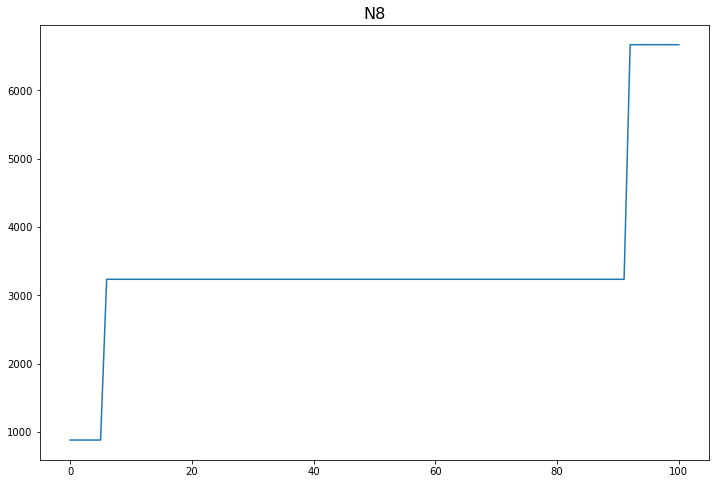

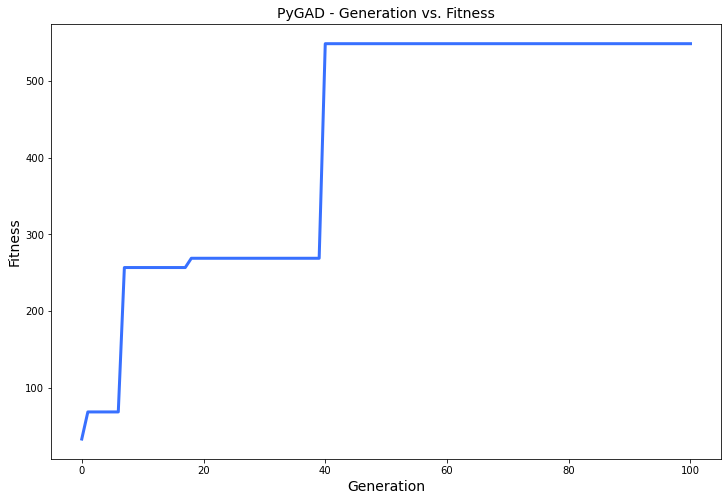

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 29.849 |==================| 1.34 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 30.545 |==================| 19.947 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 29.497 |==================| 0.911 |==========| N13 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 29.568 |==================| 0.974 |==========| N13 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 24.339 |==================| 29.948 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 24.096 |==================| 3.623 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 24.103 |==================| 3.717 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 24.15 |==================| 4.492 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 24.162 |==================| 4.749 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 24.222 |==================| 6.656 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 24.327 |==================| 22.035 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 24.234 |==================| 7.246 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 24.243 |==================| 7.726 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 24.123 |==================| 4.004 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 24.134 |==================| 4.203 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 24.166 |==================| 4.853 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 24.081 |==================| 3.438 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 24.185 |==================| 5.346 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.272 |==================| 10.011 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 24.275 |==================| 10.285 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 24.124 |==================| 4.029 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 24.246 |==================| 7.905 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 24.246 |==================| 7.9 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 24.065 |==================| 3.256 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 24.127 |==================| 4.07 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 24.357 |==================| 66.202 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 24.116 |==================| 3.902 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 24.172 |==================| 4.982 |==========| N9 |==========
**********************************************************************
====

======| 0.07 |===========| 24.351 |==================| 45.991 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 24.362 |==================| 98.596 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 24.086 |==================| 3.492 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 24.097 |==================| 3.638 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 24.158 |==================| 4.663 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 24.102 |==================| 3.705 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.351 |==================| 45.991 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 24.362 |==================| 98.596 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 24.12 |==================| 3.957 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 24.183 |==================| 5.285 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 24.217 |==================| 6.46 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 24.185 |==================| 5.34 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.234 |==================| 7.236 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 24.264 |==================| 9.224 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 24.333 |==================| 25.158 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 24.296 |==================| 13.168 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 24.351 |==================| 48.081 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.336 |==================| 27.635 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 24.287 |==================| 11.723 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 24.191 |==================| 5.529 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 24.275 |==================| 10.333 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 24.247 |==================| 7.986 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 24.204 |==================| 5.932 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.352 |==================| 48.925 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 24.2 |==================| 5.821 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 24.097 |==================| 3.638 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 24.238 |==================| 7.422 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 24.124 |==================| 4.022 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 24.297 |==================| 13.35 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 24.145 |==================| 4.402 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 24.099 |==================| 3.657 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 24.283 |==================| 11.25 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 24.372 |==================| 3038.447 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 24.072 |==================| 3.328 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 24.11 |==================| 3.818 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 24.19 |==================| 5.485 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 24.266 |==================| 9.425 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 24.295 |==================| 12.951 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 24.241 |==================| 7.64 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.345 |==================| 37.229 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 24.192 |==================| 5.541 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 24.341 |==================| 31.507 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 24.364 |==================| 128.573 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 24.266 |==================| 9.425 |==========| N9 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 24.205 |==================| 5.984 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 24.084 |==================| 3.47 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 24.165 |==================| 4.827 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 24.098 |==================| 3.644 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 24.163 |==================| 4.782 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 24.118 |==================| 3.928 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 24.327 |==================| 22.192 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 24.221 |==================| 6.6 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.33 |==================| 23.879 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 24.083 |==================| 3.462 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 24.07 |==================| 3.307 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 24.16 |==================| 4.717 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 24.119 |==================| 3.951 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 24.209 |==================| 6.118 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 24.221 |==================| 6.609 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 24.139 |==================| 4.281 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 24.296 |==================| 13.027 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 24.291 |==================| 12.369 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 24.165 |==================| 4.817 |==========| N9 |==========
**********************************************************************
Fitness = 3038.446611813686
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 24.277 |==================| 10.504 |==========| N9 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 24.237 |==================| 7.367 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.227 |==================| 6.898 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 24.351 |==================| 47.019 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 24.296 |==================| 13.027 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 24.248 |==================| 8.061 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 24.125 |==================| 4.047 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 24.112 |==================| 3.845 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 24.356 |==================| 61.479 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 24.313 |==================| 16.929 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 24.114 |==================| 3.878 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 24.168 |==================| 4.9 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 24.101 |==================| 3.692 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 24.093 |==================| 3.579 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 24.168 |==================| 4.884 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 24.104 |==================| 3.728 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 24.142 |==================| 4.336 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 24.168 |==================| 4.893 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 24.107 |==================| 3.77 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 24.172 |==================| 5.005 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 24.257 |==================| 8.642 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 24.309 |==================| 15.755 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 24.135 |==================| 4.21 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 24.131 |==================| 4.142 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 24.1 |==================| 3.679 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 24.368 |==================| 261.976 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 24.363 |==================| 102.384 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 24.14 |==================| 4.307 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.345 |==================| 36.984 |==========| N9 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 24.229 |==================| 7.003 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 24.152 |==================| 4.547 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 24.103 |==================| 3.712 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 24.352 |==================| 48.274 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 24.217 |==================| 6.441 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 24.257 |==================| 8.69 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 24.244 |==================| 7.785 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 24.173 |==================| 5.021 |==========| N9 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.246 |==================| 7.927 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 24.254 |==================| 8.469 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 24.353 |==================| 51.171 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 24.106 |==================| 3.76 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 24.366 |==================| 171.17 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 24.172 |==================| 4.993 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 24.232 |==================| 7.106 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 24.115 |==================| 3.894 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 24.362 |==================| 98.714 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 24.265 |==================| 9.363 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 24.196 |==================| 5.676 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 24.221 |==================| 6.599 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 24.33 |==================| 23.474 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 24.355 |==================| 57.95 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 24.256 |==================| 8.613 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 24.086 |==================| 3.492 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 24.172 |==================| 5.004 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 24.098 |==================| 3.653 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 24.18 |==================| 5.208 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 24.23 |==================| 7.023 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 24.101 |==================| 3.688 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 24.154 |==================| 4.572 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 24.333 |==================| 25.206 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 24.361 |==================| 87.658 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.252 |==================| 8.284 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 24.346 |==================| 38.389 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 24.146 |==================| 4.425 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 24.212 |==================| 6.236 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 24.108 |==================| 3.789 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 24.137 |==================| 4.25 |==========| N9 |==========
**********************************************************************
Fitness = 3038.446611813686
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 24.077 |==================| 3.386 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 24.133 |==================| 4.18 |==========| N9 |==========
*************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 24.157 |==================| 4.636 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 24.313 |==================| 16.815 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 24.264 |==================| 9.203 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 24.335 |==================| 26.596 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 24.163 |==================| 4.786 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.318 |==================| 18.588 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 24.114 |==================| 3.878 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 24.262 |==================| 9.063 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 24.317 |==================| 18.002 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 24.098 |==================| 3.642 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.303 |==================| 14.409 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 24.24 |==================| 7.556 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 24.107 |==================| 3.767 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 24.105 |==================| 3.738 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.311 |==================| 16.404 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 24.191 |==================| 5.522 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 24.203 |==================| 5.918 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.352 |==================| 49.459 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 24.21 |==================| 6.155 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 24.086 |==================| 3.489 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 24.333 |==================| 25.187 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 24.211 |==================| 6.19 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 24.316 |==================| 17.861 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 24.203 |==================| 5.918 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 24.093 |==================| 3.58 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 24.225 |==================| 6.798 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 24.186 |==================| 5.374 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 24.126 |==================| 4.055 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 24.147 |==================| 4.43 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 24.233 |==================| 7.182 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.233 |==================| 7.206 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 24.159 |==================| 4.682 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 24.163 |==================| 4.775 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 24.169 |==================| 4.908 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 24.149 |==================| 4.479 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 24.151 |==================| 4.511 |==========| N9 |==========
**********************************************************************
Chan

======| 0.894 |===========| 24.094 |==================| 3.593 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 24.077 |==================| 3.389 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 24.205 |==================| 5.966 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 24.077 |==================| 3.383 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 24.121 |==================| 3.973 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 24.096 |==================| 3.625 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.273 |==================| 10.106 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 24.089 |==================| 3.533 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 24.118 |==================| 3.927 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 24.121 |==================| 3.972 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 24.369 |==================| 359.426 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.234 |==================| 7.237 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 24.276 |==================| 10.414 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 24.348 |==================| 41.628 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 24.248 |==================| 8.036 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 24.324 |==================| 20.692 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 24.301 |==================| 13.943 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 24.201 |==================| 5.822 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 24.283 |==================| 11.213 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 24.185 |==================| 5.351 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 24.324 |==================| 20.671 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 24.339 |==================| 29.712 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 24.363 |==================| 107.895 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 24.152 |==================| 4.548 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 24.127 |==================| 4.077 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 24.245 |==================| 7.864 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 24.192 |==================| 5.534 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 24.22 |==================| 6.565 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 24.35 |==================| 44.916 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 24.156 |==================| 4.618 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 24.202 |==================| 5.879 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 24.102 |==================| 3.699 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.311 |==================| 16.195 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 24.288 |==================| 11.886 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 24.092 |==================| 3.573 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 24.203 |==================| 5.925 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 24.19 |==================| 5.496 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 24.184 |==================| 5.301 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 24.312 |==================| 16.646 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 24.073 |==================| 3.346 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 24.145 |==================| 4.403 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 24.369 |==================| 307.192 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 24.369 |==================| 279.561 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 24.111 |==================| 3.828 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 24.346 |==================| 37.494 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.228 |==================| 6.929 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 24.116 |==================| 3.904 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 24.101 |==================| 3.686 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 24.141 |==================| 4.326 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 24.18 |==================| 5.2 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 24.316 |==================| 17.807 |==========| N9 |==========
**********************************************************************
Generation = 22
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 24.294 |==================| 12.721 |==========| N9 |==========
************************************************************

======| 0.648 |===========| 24.171 |==================| 4.96 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.204 |==================| 5.935 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.289 |==================| 12.065 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 24.169 |==================| 4.928 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 24.211 |==================| 6.196 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 24.175 |==================| 5.072 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 24.243 |==================| 7.724 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 24.171 |==================| 4.96 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 24.178 |==================| 5.136 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 24.225 |==================| 6.789 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 24.259 |==================| 8.811 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 24.177 |==================| 5.125 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 24.161 |==================| 4.73 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 24.335 |==================| 26.737 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 24.323 |==================| 20.181 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 24.325 |==================| 21.099 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.31 |==================| 16.156 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 24.099 |==================| 3.664 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 24.236 |==================| 7.321 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 24.253 |==================| 8.354 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 24.223 |==================| 6.679 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 24.086 |==================| 3.49 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 24.118 |==================| 3.94 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 24.168 |==================| 4.895 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 24.366 |==================| 164.584 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 24.122 |==================| 3.999 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.328 |==================| 22.776 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 24.07 |==================| 3.309 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 24.326 |==================| 21.693 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 24.343 |==================| 34.239 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 24.335 |==================| 27.171 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 24.288 |==================| 11.9 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 24.226 |==================| 6.844 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 24.147 |==================| 4.431 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 24.155 |==================| 4.603 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 24.115 |==================| 3.881 |==========| N9 |==========
**********************************************************************
Fitne

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 24.233 |==================| 7.163 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.24 |==================| 7.552 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 24.249 |==================| 8.09 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 24.344 |==================| 35.732 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 24.139 |==================| 4.29 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 24.104 |==================| 3.731 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.36 |==================| 83.149 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 24.305 |==================| 14.818 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 24.195 |==================| 5.629 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 24.084 |==================| 3.465 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 24.096 |==================| 3.623 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 24.294 |==================| 12.856 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 24.083 |==================| 3.461 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 24.293 |==================| 12.578 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 24.369 |==================| 360.301 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 24.223 |==================| 6.698 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 24.088 |==================| 3.522 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 24.163 |==================| 4.785 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 24.218 |==================| 6.471 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 24.337 |==================| 28.39 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 24.197 |==================| 5.7 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 24.147 |==================| 4.448 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 24.286 |==================| 11.617 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 24.243 |==================| 7.745 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 24.216 |==================| 6.382 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 24.297 |==================| 13.32 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 24.306 |==================| 14.991 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 24.292 |==================| 12.413 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 24.255 |==================| 8.55 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.214 |==================| 6.32 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 24.208 |==================| 6.089 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 24.242 |==================| 7.657 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 24.339 |==================| 30.347 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 24.091 |==================| 3.554 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 24.129 |==================| 4.111 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 24.335 |==================| 26.864 |==========| N9 |==========
**********************************************************************
Cha

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 24.351 |==================| 47.978 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.275 |==================| 10.282 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 24.062 |==================| 3.225 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 24.062 |==================| 3.22 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 24.234 |==================| 7.214 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 24.227 |==================| 6.861 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 24.149 |==================| 4.479 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 24.315 |==================| 17.476 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.311 |==================| 16.23 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.298 |==================| 13.467 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 24.143 |==================| 4.352 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 24.335 |==================| 26.996 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 24.166 |==================| 4.841 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 24.105 |==================| 3.735 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 24.353 |==================| 52.608 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 24.192 |==================| 5.552 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 24.292 |==================| 12.46 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 24.234 |==================| 7.215 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.216 |==================| 6.397 |==========| N9 |==========
**********************************************************************
Fitness = 3038.446611813686
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 24.166 |==================| 4.841 |==========| N9 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 24.247 |==================| 7.968 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 24.111 |==================| 3.826 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 24.189 |==================| 5.443 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 24.193 |==================| 5.577 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.352 |==================| 49.418 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 24.348 |==================| 40.62 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 24.116 |==================| 3.9 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 24.327 |==================| 22.019 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 24.344 |==================| 35.672 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 24.134 |==================| 4.189 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 24.196 |==================| 5.684 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 24.152 |==================| 4.538 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 24.319 |==================| 18.849 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 24.318 |==================| 18.393 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 24.308 |==================| 15.546 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 24.149 |==================| 4.487 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 24.072 |==================| 3.333 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 24.253 |==================| 8.376 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 24.308 |==================| 15.637 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 24.148 |==================| 4.453 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 24.364 |==================| 126.444 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 24.249 |==================| 8.114 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 24.23 |==================| 7.007 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 24.344 |==================| 35.579 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 24.235 |==================| 7.264 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 24.07 |==================| 3.309 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 24.335 |==================| 26.483 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 24.163 |==================| 4.778 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 24.15 |==================| 4.505 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 24.26 |==================| 8.889 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 24.191 |==================| 5.516 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 24.07 |==================| 3.313 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 24.335 |==================| 26.555 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 24.259 |==================| 8.85 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 24.084 |==================| 3.471 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 24.186 |==================| 5.364 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 24.328 |==================| 22.415 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 24.068 |==================| 3.288 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 24.145 |==================| 4.407 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 24.358 |==================| 70.597 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 24.11 |==================| 3.813 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 24.292 |==================| 12.437 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 24.163 |==================| 4.785 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 24.188 |==================| 5.428 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 24.358 |==================| 70.401 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 24.201 |==================| 5.834 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 24.133 |==================| 4.176 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 24.11 |==================| 3.813 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 24.092 |==================| 3.569 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 24.225 |==================| 6.792 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 24.077 |==================| 3.389 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 24.077 |==================| 3.383 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 24.296 |==================| 13.167 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 24.247 |==================| 8.005 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 24.145 |==================| 4.399 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 24.288 |==================| 11.861 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 24.301 |==================| 13.969 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 24.089 |==================| 3.525 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 24.088 |==================| 3.514 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 24.279 |==================| 10.67 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 24.329 |==================| 23.377 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 24.318 |==================| 18.373 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 24.267 |==================| 9.535 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 24.157 |==================| 4.644 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 24.081 |==================| 3.437 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 24.113 |==================| 3.861 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 24.062 |==================| 3.226 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 24.088 |==================| 3.514 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 24.109 |==================| 3.792 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 24.164 |==================| 4.801 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 24.082 |==================| 3.449 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 24.078 |==================| 3.401 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 24.068 |==================| 3.29 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 24.21 |==================| 6.157 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 24.244 |==================| 7.78 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.276 |==================| 10.351 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 24.116 |==================| 3.895 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 24.309 |==================| 15.908 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.233 |==================| 7.2 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 24.364 |==================| 116.942 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 24.151 |==================| 4.528 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 24.14 |==================| 4.31 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 24.208 |==================| 6.105 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 24.165 |==================| 4.818 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 24.31 |==================| 15.952 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 24.135 |==================| 4.218 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 24.065 |==================| 3.256 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.285 |==================| 11.514 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 24.34 |==================| 31.13 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 24.112 |==================| 3.845 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 24.167 |==================| 4.881 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 24.246 |==================| 7.891 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.272 |==================| 9.999 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 24.345 |==================| 36.451 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 24.307 |==================| 15.244 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 24.26 |==================| 8.883 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 24.14 |==================| 4.298 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.294 |==================| 12.801 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.336 |==================| 27.505 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 24.32 |==================| 19.16 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 24.326 |==================| 21.498 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 24.109 |==================| 3.803 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 24.089 |==================| 3.527 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 24.274 |==================| 10.131 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 24.258 |==================| 8.754 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 24.148 |==================| 4.469 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 24.253 |==================| 8.377 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 24.181 |==================| 5.226 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.275 |==================| 10.259 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 24.076 |==================| 3.374 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 24.156 |==================| 4.621 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 24.137 |==================| 4.25 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.343 |==================| 33.993 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.337 |==================| 28.01 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 24.189 |==================| 5.458 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 24.243 |==================| 7.746 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 24.218 |==================| 6.475 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.106 |==================| 3.749 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 24.183 |==================| 5.272 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 24.077 |==================| 3.382 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 24.261 |==================| 8.979 |==========| N9 |==========
**********************************************************************
Fitness = 3038.446611813686
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.259 |==================| 8.84 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 24.284 |==================| 11.302 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 24.084 |==================| 3.468 |==========| N9 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 24.272 |==================| 9.969 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 24.223 |==================| 6.679 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 24.347 |==================| 40.09 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 24.149 |==================| 4.471 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 24.108 |==================| 3.784 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 24.368 |==================| 243.979 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 24.069 |==================| 3.294 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 24.155 |==================| 4.605 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 24.123 |==================| 4.014 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 24.305 |==================| 14.907 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 24.293 |==================| 12.643 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 24.086 |==================| 3.491 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.328 |==================| 22.713 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.106 |==================| 3.749 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 24.114 |==================| 3.878 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 24.17 |==================| 4.937 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 24.145 |==================| 4.399 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 24.141 |==================| 4.326 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 24.334 |==================| 26.181 |==========| N9 |==========
**********************************************************************
Generation = 43
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 24.314 |==================| 17.14 |==========| N9 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 24.118 |==================| 3.928 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 24.181 |==================| 5.24 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.194 |==================| 5.616 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 24.145 |==================| 4.399 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 24.081 |==================| 3.434 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 24.1 |==================| 3.67 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 24.071 |==================| 3.323 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.345 |==================| 37.078 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 24.158 |==================| 4.676 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 24.064 |==================| 3.244 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 24.218 |==================| 6.5 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 24.11 |==================| 3.819 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.251 |==================| 8.276 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 24.277 |==================| 10.536 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 24.279 |==================| 10.743 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 24.334 |==================| 25.938 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 24.333 |==================| 25.313 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.227 |==================| 6.891 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 24.337 |==================| 28.523 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 24.159 |==================| 4.688 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 24.182 |==================| 5.251 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 24.267 |==================| 9.462 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.252 |==================| 8.286 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 24.273 |==================| 10.057 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.207 |==================| 6.052 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 24.067 |==================| 3.273 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 24.136 |==================| 4.227 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 24.142 |==================| 4.337 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.351 |==================| 46.095 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.228 |==================| 6.931 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 24.281 |==================| 10.954 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 24.109 |==================| 3.792 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 24.186 |==================| 5.354 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 24.078 |==================| 3.393 |==========| N9 |==========
**********************************************************************
Fitness = 3038.446611813686
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.227 |==================| 6.897 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 24.21 |==================| 6.178 |==========| N9 |==========
************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 24.268 |==================| 9.579 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 24.367 |==================| 173.776 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 24.115 |==================| 3.882 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 24.208 |==================| 6.078 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.214 |==================| 6.329 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 24.35 |==================| 44.505 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 24.162 |==================| 4.749 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 24.122 |==================| 3.998 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 24.176 |==================| 5.089 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 24.346 |==================| 38.006 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 24.175 |==================| 5.073 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 24.173 |==================| 5.007 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 24.301 |==================| 13.963 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 24.178 |==================| 5.146 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 24.221 |==================| 6.619 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 24.099 |==================| 3.662 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 24.108 |==================| 3.79 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 24.081 |==================| 3.429 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 24.302 |==================| 14.175 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 24.341 |==================| 32.033 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 24.305 |==================| 14.853 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 24.226 |==================| 6.837 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 24.293 |==================| 12.64 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 24.25 |==================| 8.163 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 24.174 |==================| 5.05 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 24.124 |==================| 4.028 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 24.358 |==================| 71.869 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 24.144 |==================| 4.389 |==========| N9 |==========
**********************************************************************
====

**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 24.365 |==================| 130.527 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 24.258 |==================| 8.769 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 24.163 |==================| 4.788 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 24.294 |==================| 12.836 |==========| N9 |==========
*

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 24.218 |==================| 6.498 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 24.233 |==================| 7.174 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 24.283 |==================| 11.257 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 24.365 |==================| 130.527 |==========| N9 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 24.218 |==================| 6.477 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.349 |==================| 43.406 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 24.332 |==================| 24.768 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 24.141 |==================| 4.324 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 24.327 |==================| 22.226 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 24.102 |==================| 3.703 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 24.317 |==================| 18.033 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 24.291 |==================| 12.324 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 24.135 |==================| 4.218 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 24.28 |==================| 10.896 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 24.16 |==================| 4.71 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 24.093 |==================| 3.582 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 24.188 |==================| 5.437 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 24.208 |==================| 6.076 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 24.096 |==================| 3.619 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.294 |==================| 12.812 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 24.175 |==================| 5.08 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 24.101 |==================| 3.689 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 24.182 |==================| 5.267 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 24.098 |==================| 3.644 |==========| N9 |==========
**********************************************************************
Fitnes

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 24.19 |==================| 5.493 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 24.326 |==================| 21.718 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.193 |==================| 5.592 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 24.26 |==================| 8.869 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 24.133 |==================| 4.172 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 24.102 |==================| 3.705 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 24.301 |==================| 14.068 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 24.288 |==================| 11.882 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 24.084 |==================| 3.464 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 24.371 |==================| 990.115 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 24.082 |==================| 3.439 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 24.126 |==================| 4.067 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 24.169 |==================| 4.925 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 24.1 |==================| 3.672 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 24.35 |==================| 45.336 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 24.242 |==================| 7.668 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.345 |==================| 36.903 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 24.198 |==================| 5.754 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 24.21 |==================| 6.176 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 24.13 |==================| 4.124 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 24.331 |==================| 24.193 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 24.208 |==================| 6.103 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 24.317 |==================| 18.204 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.345 |==================| 36.903 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 24.262 |==================| 9.052 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 24.306 |==================| 15.001 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 24.094 |==================| 3.593 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 24.281 |==================| 10.949 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 24.215 |==================| 6.34 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.336 |==================| 27.607 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 24.188 |==================| 5.44 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 24.186 |==================| 5.375 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 24.278 |==================| 10.577 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 24.218 |==================| 6.469 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 24.297 |==================| 13.221 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 24.118 |==================| 3.938 |==========| N9 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 24.102 |==================| 3.706 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 24.087 |==================| 3.511 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 24.345 |==================| 36.386 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 24.293 |==================| 12.69 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 24.13 |==================| 4.127 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 24.318 |==================| 18.36 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.298 |==================| 13.507 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.349 |==================| 43.789 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 24.175 |==================| 5.063 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.29 |==================| 12.209 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.214 |==================| 6.324 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 24.076 |==================| 3.377 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 24.301 |==================| 14.087 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 24.127 |==================| 4.083 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 24.125 |==================| 4.041 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 24.062 |==================| 3.222 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 24.233 |==================| 7.188 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 24.268 |==================| 9.555 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 24.331 |==================| 24.389 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 24.283 |==================| 11.195 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 24.145 |==================| 4.401 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 24.285 |==================| 11.463 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 24.278 |==================| 10.556 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 24.242 |==================| 7.658 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.303 |==================| 14.413 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 24.072 |==================| 3.335 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 24.081 |==================| 3.433 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 24.118 |==================| 3.931 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 24.319 |==================| 18.736 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 24.361 |==================| 86.676 |==========| N9 |==========
**********************************************************************
Fitness = 28111.58172753184
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 24.183 |==================| 5.283 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.303 |==================| 14.413 |==========| N9 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.345 |==================| 37.319 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 24.119 |==================| 3.955 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 24.266 |==================| 9.388 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 24.127 |==================| 4.083 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 24.201 |==================| 5.824 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 24.212 |==================| 6.235 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 24.314 |==================| 17.047 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 24.317 |==================| 18.047 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 24.128 |==================| 4.1 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 24.121 |==================| 3.984 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 24.164 |==================| 4.807 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.227 |==================| 6.9 |==========| N9 |==========
**********************************************************************
=====|SO

======| 0.03 |===========| 24.363 |==================| 107.519 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 24.319 |==================| 18.903 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 24.091 |==================| 3.558 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 24.154 |==================| 4.579 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 24.249 |==================| 8.104 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 24.167 |==================| 4.878 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 24.248 |==================| 8.043 |==========| N9 |==========
**********************************************************************
Generation = 59
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 24.087 |==================| 3.5 |==========| N9 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 24.21 |==================| 6.153 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 24.181 |==================| 5.229 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 24.371 |==================| 711.795 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 24.244 |==================| 7.78 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 24.33 |==================| 23.811 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.285 |==================| 11.499 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 24.092 |==================| 3.572 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 24.129 |==================| 4.106 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 24.097 |==================| 3.628 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 24.269 |==================| 9.694 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 24.28 |==================| 10.842 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 24.311 |==================| 16.289 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 24.095 |==================| 3.604 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 24.37 |==================| 369.111 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 24.357 |==================| 67.585 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 24.21 |==================| 6.174 |==========| N9 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 24.083 |==================| 3.455 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 24.293 |==================| 12.605 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 24.335 |==================| 26.477 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 24.344 |==================| 35.295 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 24.236 |==================| 7.33 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 24.154 |==================| 4.577 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.294 |==================| 12.807 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 24.296 |==================| 13.039 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 24.287 |==================| 11.682 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 24.107 |==================| 3.766 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 24.345 |==================| 36.386 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 24.262 |==================| 9.028 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 24.103 |==================| 3.711 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 24.092 |==================| 3.569 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 24.159 |==================| 4.68 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 24.069 |==================| 3.295 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 24.238 |==================| 7.475 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 24.184 |==================| 5.308 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 24.157 |==================| 4.648 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 24.349 |==================| 43.301 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 24.088 |==================| 3.521 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 24.299 |==================| 13.701 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 24.106 |==================| 3.76 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 24.245 |==================| 7.864 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 24.34 |==================| 30.785 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 24.301 |==================| 14.025 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.094 |==================| 3.599 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 24.291 |==================| 12.273 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.233 |==================| 7.198 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 24.25 |==================| 8.191 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 24.207 |==================| 6.063 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 24.334 |==================| 26.059 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 24.371 |==================| 659.546 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 24.354 |==================| 53.548 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 24.18 |==================| 5.203 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.233 |==================| 7.198 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 24.312 |==================| 16.725 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 24.227 |==================| 6.889 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 24.129 |==================| 4.104 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 24.113 |==================| 3.862 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 24.288 |==================| 11.855 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 24.222 |==================| 6.648 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 24.105 |==================| 3.737 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 24.065 |==================| 3.252 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 24.289 |==================| 12.01 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 24.248 |==================| 8.039 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 24.333 |==================| 25.57 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 24.142 |==================| 4.337 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 24.069 |==================| 3.296 |==========| N9 |==========
**********************************************************************
Generation = 65
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 24.277 |==================| 10.478 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 24.137 |==================| 4.242 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 24.161 |==================| 4.725 |==========| N9 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 24.244 |==================| 7.822 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 24.143 |==================| 4.371 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 24.318 |==================| 18.46 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 24.364 |==================| 115.893 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 24.173 |==================| 5.014 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 24.13 |==================| 4.122 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.204 |==================| 5.938 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 24.23 |==================| 7.043 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.223 |==================| 6.708 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 24.166 |==================| 4.842 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 24.092 |==================| 3.572 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 24.3 |==================| 13.79 |==========| N9 |==========
**********************************************************************
=====|S

======| 0.737 |===========| 24.143 |==================| 4.36 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 24.348 |==================| 40.464 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 24.134 |==================| 4.2 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 24.315 |==================| 17.396 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 24.191 |==================| 5.514 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 24.324 |==================| 20.82 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 24.07 |==================| 3.307 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 24.286 |==================| 11.57 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 24.124 |==================| 4.023 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 24.275 |==================| 10.324 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 24.305 |==================| 14.885 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 24.194 |==================| 5.6 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 24.13 |==================| 4.123 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 24.205 |==================| 5.991 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 24.28 |==================| 10.794 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 24.199 |==================| 5.773 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.106 |==================| 3.752 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 24.363 |==================| 112.831 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 24.306 |==================| 15.008 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 24.091 |==================| 3.559 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 24.068 |==================| 3.287 |==========| N9 |==========
**********************************************************************
Fitness = 28111.5817219167
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.343 |==================| 34.016 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 24.201 |==================| 5.845 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 24.316 |==================| 17.647 |==========| N9 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 24.107 |==================| 3.771 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 24.241 |==================| 7.645 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.33 |==================| 23.911 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 24.282 |==================| 11.062 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 24.363 |==================| 102.621 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 24.167 |==================| 4.879 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 24.08 |==================| 3.418 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 24.136 |==================| 4.226 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 24.093 |==================| 3.58 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 24.318 |==================| 18.296 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 24.207 |==================| 6.041 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 24.106 |==================| 3.758 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 24.157 |==================| 4.641 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 24.286 |==================| 11.645 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 24.061 |==================| 3.214 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 24.359 |==================| 78.091 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 24.185 |==================| 5.349 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 24.124 |==================| 4.027 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 24.188 |==================| 5.441 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 24.261 |==================| 8.995 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 24.159 |==================| 4.688 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.294 |==================| 12.817 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 24.218 |==================| 6.476 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 24.166 |==================| 4.848 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 24.286 |==================| 11.629 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 24.19 |==================| 5.479 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 24.311 |==================| 16.425 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 24.159 |==================| 4.688 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 24.096 |==================| 3.623 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 24.299 |==================| 13.697 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 24.139 |==================| 4.291 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 24.366 |==================| 172.202 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 24.239 |==================| 7.492 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 24.275 |==================| 10.295 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 24.152 |==================| 4.533 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 24.252 |==================| 8.312 |==========| N9 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 24.064 |==================| 3.248 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 24.323 |==================| 20.181 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 24.363 |==================| 111.033 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 24.239 |==================| 7.492 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 24.271 |==================| 9.849 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 24.269 |==================| 9.652 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 24.283 |==================| 11.159 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 24.161 |==================| 4.744 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 24.286 |==================| 11.568 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 24.105 |==================| 3.746 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 24.063 |==================| 3.23 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 24.154 |==================| 4.579 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 24.332 |==================| 24.884 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 24.322 |==================| 19.928 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 24.232 |==================| 7.114 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 24.308 |==================| 15.672 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 24.074 |==================| 3.356 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 24.362 |==================| 96.278 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 24.068 |==================| 3.283 |==========| N9 |==========
**********************************************************************
Fitness = 28111.5817219167
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 24.111 |==================| 3.828 |==========| N9 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 24.297 |==================| 13.199 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 24.298 |==================| 13.401 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 24.089 |==================| 3.534 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 24.143 |==================| 4.363 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 24.161 |==================| 4.733 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 24.224 |==================| 6.759 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 24.369 |==================| 309.194 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 24.087 |==================| 3.505 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 24.083 |==================| 3.453 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 24.127 |==================| 4.069 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 24.07 |==================| 3.311 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.347 |==================| 38.971 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 24.242 |==================| 7.67 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 24.157 |==================| 4.656 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 24.358 |==================| 70.046 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 24.172 |==================| 5.004 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.275 |==================| 10.265 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 24.246 |==================| 7.918 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 24.317 |==================| 18.024 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.288 |==================| 11.82 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 24.307 |==================| 15.249 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 24.33 |==================| 23.631 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 24.088 |==================| 3.519 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 24.366 |==================| 162.675 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 24.109 |==================| 3.802 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 24.202 |==================| 5.881 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 24.205 |==================| 5.964 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 24.216 |==================| 6.391 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 24.068 |==================| 3.284 |==========| N9 |==========
**********************************************************************
Generation = 76
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 24.277 |==================| 10.465 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 24.079 |==================| 3.409 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 24.078 |==================| 3.398 |==========| N9 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 24.154 |==================| 4.589 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 24.362 |==================| 98.311 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 24.258 |==================| 8.717 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 24.324 |==================| 20.836 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 24.188 |==================| 5.439 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 24.359 |==================| 76.919 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 24.368 |==================| 213.203 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 24.123 |==================| 4.008 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 24.308 |==================| 15.565 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.106 |==================| 3.751 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 24.174 |==================| 5.038 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 24.209 |==================| 6.123 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 24.219 |==================| 6.536 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.207 |==================| 6.052 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 24.098 |==================| 3.646 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 24.174 |==================| 5.034 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 24.127 |==================| 4.081 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 24.2 |==================| 5.807 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 24.098 |==================| 3.651 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.31 |==================| 16.099 |==========| N9 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 24.065 |==================| 3.253 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 24.209 |==================| 6.106 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 24.076 |==================| 3.378 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 24.339 |==================| 30.436 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 24.137 |==================| 4.251 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 24.339 |==================| 29.912 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 24.356 |==================| 62.882 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 24.212 |==================| 6.241 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 24.362 |==================| 96.143 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 24.185 |==================| 5.33 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 24.253 |==================| 8.409 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 24.144 |==================| 4.387 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 24.221 |==================| 6.604 |==========| N9 |==========
**********************************************************************
Fitness = 28111.5817219167
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 24.099 |==================| 3.656 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 24.355 |==================| 58.713 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 24.199 |==================| 5.777 |==========| N9 |==========
***********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 24.342 |==================| 33.39 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 24.285 |==================| 11.401 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 24.265 |==================| 9.316 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 24.221 |==================| 6.604 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.094 |==================| 3.6 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 24.14 |==================| 4.299 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 24.342 |==================| 33.544 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 24.364 |==================| 126.103 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 24.151 |==================| 4.516 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 24.126 |==================| 4.054 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 24.288 |==================| 11.854 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 24.248 |==================| 8.04 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 24.34 |==================| 30.631 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 24.288 |==================| 11.896 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 24.327 |==================| 22.059 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 24.172 |==================| 4.993 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.094 |==================| 3.598 |==========| N9 |==========
**********************************************************************
Generation = 81
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 24.15 |==================| 4.502 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.298 |==================| 13.512 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 24.091 |==================| 3.558 |==========| N9 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.106 |==================| 3.754 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 24.219 |==================| 6.541 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 24.134 |==================| 4.204 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 24.064 |==================| 3.241 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.288 |==================| 11.806 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 24.062 |==================| 3.221 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 24.294 |==================| 12.711 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 24.108 |==================| 3.788 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 24.192 |==================| 5.544 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 24.11 |==================| 3.817 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 24.277 |==================| 10.526 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 24.302 |==================| 14.175 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 24.141 |==================| 4.321 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 24.363 |==================| 109.775 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 24.196 |==================| 5.673 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.285 |==================| 11.515 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 24.075 |==================| 3.368 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 24.163 |==================| 4.775 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 24.125 |==================| 4.049 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 24.334 |==================| 26.115 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 24.174 |==================| 5.035 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 24.092 |==================| 3.572 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 24.319 |==================| 18.616 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 24.072 |==================| 3.335 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 24.331 |==================| 24.446 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 24.335 |==================| 26.875 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 24.323 |==================| 20.483 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 24.348 |==================| 40.978 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.271 |==================| 9.902 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 24.366 |==================| 172.252 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.199 |==================| 5.783 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 24.256 |==================| 8.624 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 24.37 |==================| 556.982 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 24.192 |==================| 5.557 |==========| N9 |==========
**********************************************************************
Fitness = 28111.5817219167
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 24.304 |==================| 14.578 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 24.069 |==================| 3.293 |==========| N9 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 24.152 |==================| 4.549 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 24.251 |==================| 8.223 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 24.293 |==================| 12.546 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.214 |==================| 6.323 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 24.111 |==================| 3.831 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 24.164 |==================| 4.802 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 24.331 |==================| 24.172 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 24.354 |==================| 55.677 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 24.31 |==================| 16.028 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 24.292 |==================| 12.494 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 24.175 |==================| 5.065 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.318 |==================| 18.546 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 24.075 |==================| 3.367 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 24.091 |==================| 3.555 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 24.118 |==================| 3.928 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 24.2 |==================| 5.81 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 24.191 |==================| 5.527 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 24.176 |==================| 5.092 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 24.197 |==================| 5.702 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.329 |==================| 23.152 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 24.302 |==================| 14.247 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 24.26 |==================| 8.921 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 24.264 |==================| 9.238 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 24.095 |==================| 3.61 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 24.079 |==================| 3.409 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 24.326 |==================| 21.611 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 24.205 |==================| 5.981 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 24.36 |==================| 79.678 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 24.151 |==================| 4.525 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 24.277 |==================| 10.444 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 24.138 |==================| 4.264 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 24.105 |==================| 3.745 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.336 |==================| 27.671 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 24.371 |==================| 669.722 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 24.336 |==================| 27.369 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 24.308 |==================| 15.607 |==========| N9 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 24.308 |==================| 15.475 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 24.069 |==================| 3.293 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 24.187 |==================| 5.397 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.336 |==================| 27.671 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 24.197 |==================| 5.697 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 24.219 |==================| 6.543 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 24.124 |==================| 4.029 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 24.088 |==================| 3.52 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 24.333 |==================| 25.54 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 24.341 |==================| 31.768 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 24.104 |==================| 3.729 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 24.255 |==================| 8.497 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 24.222 |==================| 6.666 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 24.341 |==================| 32.429 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 24.183 |==================| 5.274 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 24.369 |==================| 266.029 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 24.227 |==================| 6.878 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 24.093 |==================| 3.585 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 24.353 |==================| 51.759 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 24.177 |==================| 5.133 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.285 |==================| 11.52 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 24.139 |==================| 4.283 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 24.28 |==================| 10.78 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 24.186 |==================| 5.362 |==========| N9 |==========
**********************************************************************
=====|SOL

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 24.161 |==================| 4.743 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 24.346 |==================| 37.998 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 24.203 |==================| 5.896 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 24.163 |==================| 4.788 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 24.231 |==================| 7.093 |==========| N9 |==========
**********************************************************************
Fitness = 28111.5817219167
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 24.108 |==================| 3.786 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 24.262 |==================| 9.08 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 24.195 |==================| 5.625 |==========| N9 |==========
*************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 24.165 |==================| 4.82 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 24.204 |==================| 5.949 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 24.127 |==================| 4.075 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 24.272 |==================| 9.96 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.352 |==================| 48.893 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 24.287 |==================| 11.68 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 24.063 |==================| 3.235 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 24.245 |==================| 7.826 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 24.181 |==================| 5.226 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 24.363 |==================| 104.315 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 24.208 |==================| 6.093 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 24.162 |==================| 4.759 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 24.167 |==================| 4.877 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 24.188 |==================| 5.432 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 24.153 |==================| 4.551 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 24.157 |==================| 4.646 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 24.077 |==================| 3.385 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.338 |==================| 29.118 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 24.364 |==================| 115.86 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.318 |==================| 18.538 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 24.338 |==================| 29.547 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 24.231 |==================| 7.066 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 24.062 |==================| 3.218 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 24.132 |==================| 4.165 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.195 |==================| 5.653 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 24.261 |==================| 8.973 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 24.176 |==================| 5.106 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 24.338 |==================| 29.547 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 24.238 |==================| 7.422 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 24.076 |==================| 3.377 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 24.086 |==================| 3.494 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.234 |==================| 7.24 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 24.145 |==================| 4.396 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 24.065 |==================| 3.258 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 24.243 |==================| 7.755 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 24.074 |==================| 3.357 |==========| N9 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 24.356 |==================| 60.43 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 24.179 |==================| 5.186 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 24.101 |==================| 3.69 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 24.205 |==================| 5.99 |==========| N9 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 24.132 |==================| 4.163 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 24.222 |==================| 6.654 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 24.127 |==================| 4.069 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 24.069 |==================| 3.301 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 24.248 |==================| 8.028 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 24.173 |==================| 5.009 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 24.07 |==================| 3.305 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 24.368 |==================| 216.619 |==========| N9 |==========
**********************************************************************
===

======| 0.891 |===========| 24.095 |==================| 3.604 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 24.237 |==================| 7.387 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 24.118 |==================| 3.937 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 24.125 |==================| 4.038 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 24.174 |==================| 5.039 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 24.186 |==================| 5.364 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 24.267 |==================| 9.54 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 24.127 |==================| 4.077 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 24.247 |==================| 7.98 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 24.098 |==================| 3.641 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 24.092 |==================| 3.567 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 24.262 |==================| 9.085 |==========| N9 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 24.132 |==================| 4.167 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.194 |==================| 5.616 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 24.26 |==================| 8.911 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 24.313 |==================| 16.96 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 24.132 |==================| 4.169 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 24.22 |==================| 6.581 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 24.155 |==================| 4.608 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 24.091 |==================| 3.55 |==========| N9 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.298 |==================| 13.495 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.298 |==================| 13.498 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 24.079 |==================| 3.405 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 24.367 |==================| 193.65 |==========| N9 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 24.332 |==================| 24.786 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.813 |===========| 24.119 |==================| 3.95 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 24.116 |==================| 3.899 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 24.071 |==================| 3.318 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 24.161 |==================| 4.723 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 24.189 |==================| 5.464 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 24.212 |==================| 6.223 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 24.227 |==================| 6.869 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.273 |==================| 10.113 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 24.144 |==================| 4.379 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 24.365 |==================| 145.44 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 24.258 |==================| 8.772 |==========| N9 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 24.143 |==================| 4.358 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 24.122 |==================| 3.992 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 24.231 |==================| 7.078 |==========| N9 |==========
**********************************************************************
Generation = 98
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 24.064 |==================| 3.239 |==========| N9 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 24.268 |==================| 9.592 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 24.252 |==================| 8.314 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 24.096 |==================| 3.624 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 24.313 |==================| 16.807 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.195 |==================| 5.653 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 24.12 |==================| 3.959 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.207 |==================| 6.048 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 24.367 |==================| 184.671 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 24.064 |==================| 3.239 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.299 |==================| 13.622 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 24.252 |==================| 8.294 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 24.335 |==================| 27.072 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 24.353 |==================| 50.992 |==========| N9 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 24.111 |==================| 3.829 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 24.256 |==================| 8.579 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 24.285 |==================| 11.451 |==========| N9 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 24.339 |==================| 30.189 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 24.257 |==================| 8.705 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 24.157 |==================| 4.642 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 24.277 |==================| 10.464 |==========| N9 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.29 |==================| 12.084 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 24.172 |==================| 4.997 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 24.123 |==================| 4.011 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 24.203 |==================| 5.918 |==========| N9 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 24.068 |==================| 3.289 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 24.359 |==================| 75.61 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 24.277 |==================| 10.48 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 24.281 |==================| 10.927 |==========| N9 |==========
**********************************************************************
===

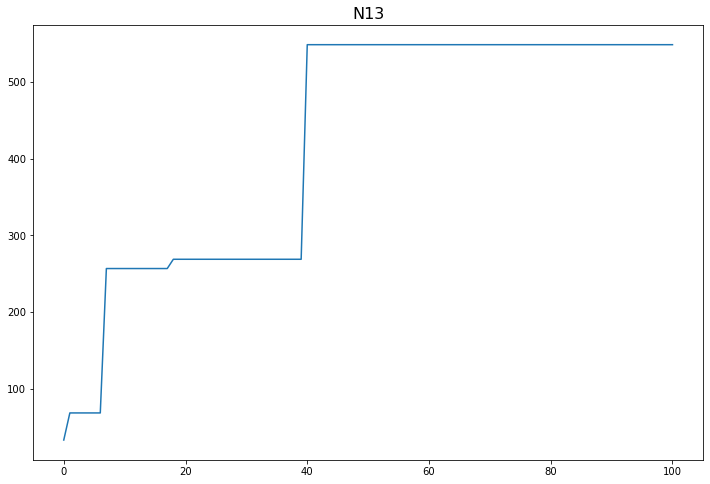

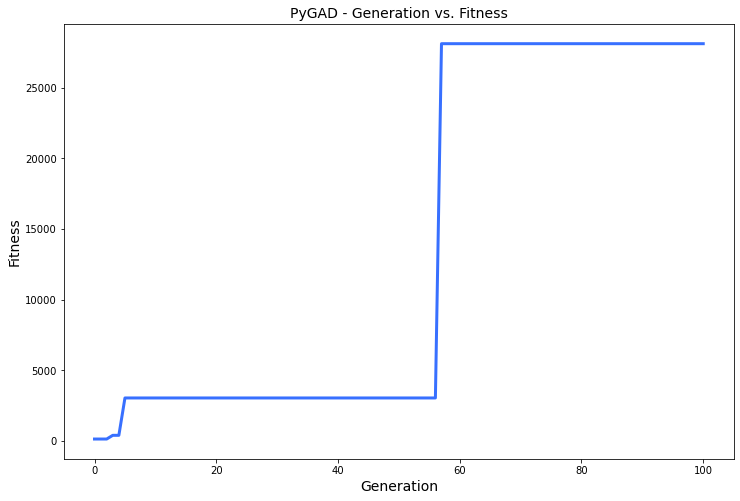

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 24.321 |==================| 19.533 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 24.157 |==================| 4.655 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 24.13 |==================| 4.121 |==========| N9 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.106 |==================| 3.757 |==========| N9 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 24.969 |==================| 10.859 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 24.957 |==================| 9.617 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 24.378 |==================| 1.464 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 25.014 |==================| 21.321 |==========| N14 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 24.257 |==================| 1.244 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 24.188 |==================| 1.146 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 24.413 |==================| 1.544 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 25.002 |==================| 17.039 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 24.992 |==================| 14.448 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.732 |==================| 3.043 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 24.062 |==================| 1.001 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 24.663 |==================| 2.511 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 24.712 |==================| 2.861 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 23.983 |==================| 0.927 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 24.482 |==================| 1.726 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 24.63 |==================| 2.322 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.787 |==================| 3.644 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 24.662 |==================| 2.504 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 24.321 |==================| 1.351 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 24.872 |==================| 5.29 |==========| N14 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 24.832 |==================| 4.375 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 25.003 |==================| 17.26 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 24.175 |==================| 1.129 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 24.444 |==================| 1.622 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 24.307 |==================| 1.326 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 24.189 |==================| 1.147 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 24.092 |==================| 1.032 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.946 |==================| 8.689 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 24.886 |==================| 5.73 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.465 |==================| 1.677 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 24.563 |==================| 2.007 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 24.049 |==================| 0.988 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 24.911 |==================| 6.671 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 23.919 |==================| 0.875 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.993 |==================| 14.674 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 24.62 |==================| 2.27 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 24.083 |==================| 1.023 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 24.01 |==================| 0.951 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 25.022 |==================| 25.502 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 24.809 |==================| 3.966 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 24.147 |==================| 1.094 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.448 |==================| 1.632 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 24.5 |==================| 1.783 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 24.093 |==================| 1.033 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 24.137 |==================| 1.082 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 23.95 |==================| 0.9 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 24.436 |==================| 1.599 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 24.752 |==================| 3.234 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 23.927 |==================| 0.882 |==========| N14 |==========
**********************************************************************
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 24.489 |==================| 1.747 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.002 |===========| 23.848 |==================| 0.825 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 24.682 |==================| 2.639 |==========| N14 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 24.057 |==================| 0.996 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 25.056 |==================| 183.224 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 24.38 |==================| 1.469 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 24.44 |==================| 1.611 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 24.041 |==================| 0.98 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 24.498 |==================| 1.776 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.86 |==================| 4.976 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 24.014 |==================| 0.955 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 24.347 |==================| 1.4 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.818 |==================| 4.108 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 24.323 |==================| 1.355 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.431 |==================| 1.588 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.649 |==================| 2.426 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 24.702 |==================| 2.786 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 24.881 |==================| 5.545 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 24.01 |==================| 0.951 |==========| N14 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 24.565 |==================| 2.015 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.952 |==================| 9.157 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 25.012 |==================| 20.256 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 24.455 |==================| 1.651 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 24.331 |==================| 1.37 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 24.898 |==================| 6.122 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 24.219 |==================| 1.187 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 23.866 |==================| 0.836 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 24.095 |==================| 1.035 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 24.954 |==================| 9.347 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 24.322 |==================| 1.353 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 23.944 |==================| 0.896 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 24.398 |==================| 1.508 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 24.54 |==================| 1.92 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 24.206 |==================| 1.169 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 24.432 |==================| 1.59 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 24.698 |==================| 2.756 |==========| N14 |==========
**********************************************************************
Fitness = 183.22382300961783
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 23.934 |==================| 0.887 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 24.882 |==================| 5.601 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 24.01 |==================| 0.951 |==========| N14 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 23.862 |==================| 0.834 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.465 |==================| 1.677 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 24.916 |==================| 6.912 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 24.846 |==================| 4.643 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 23.993 |==================| 0.936 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.82 |==================| 4.144 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 24.071 |==================| 1.01 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 23.996 |==================| 0.939 |==========| N14 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 24.272 |==================| 1.268 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.732 |==================| 3.039 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 24.875 |==================| 5.378 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 24.219 |==================| 1.188 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 24.498 |==================| 1.775 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 24.851 |==================| 4.77 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 24.149 |==================| 1.097 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 24.822 |==================| 4.176 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 23.927 |==================| 0.882 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 24.39 |==================| 1.49 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 24.328 |==================| 1.364 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 24.961 |==================| 9.984 |==========| N14 |==========
**********************************************************************
Ge

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 24.488 |==================| 1.745 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 24.457 |==================| 1.655 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 23.979 |==================| 0.924 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 24.918 |==================| 7.005 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 24.791 |==================| 3.709 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 25.003 |==================| 17.228 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 25.05 |==================| 94.474 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 24.459 |==================| 1.662 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 24.334 |==================| 1.375 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 24.549 |==================| 1.953 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 24.015 |==================| 0.956 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 24.364 |==================| 1.436 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 23.9 |==================| 0.862 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 24.523 |==================| 1.859 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 24.027 |==================| 0.967 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 24.573 |==================| 2.047 |==========| N14 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.976 |==================| 11.754 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 24.381 |==================| 1.472 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 24.398 |==================| 1.507 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 24.626 |==================| 2.296 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 23.969 |==================| 0.916 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.513 |==================| 1.826 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 23.934 |==================| 0.887 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 24.431 |==================| 1.586 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 24.9 |==================| 6.198 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 25.06 |==================| 754.188 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 24.539 |==================| 1.914 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 24.751 |==================| 3.23 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 23.864 |==================| 0.836 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 24.251 |==================| 1.235 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 24.853 |==================| 4.805 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 24.364 |==================| 1.435 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 24.653 |==================| 2.451 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 23.989 |==================| 0.933 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 24.001 |==================| 0.944 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.055 |==================| 0.994 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 24.822 |==================| 4.186 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 24.128 |==================| 1.071 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 24.457 |==================| 1.655 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 24.398 |==================| 1.507 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 24.495 |==================| 1.767 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 25.042 |==================| 53.141 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 24.661 |==================| 2.501 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 24.747 |==================| 3.185 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 24.686 |==================| 2.667 |==========| N14 |==========
**********************************************************************
Fitness = 754.1877986030247
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 24.685 |==================| 2.658 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 23.866 |==================| 0.837 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.924 |==================| 7.277 |==========| N14 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 24.314 |==================| 1.338 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 24.891 |==================| 5.886 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 24.767 |==================| 3.403 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 24.671 |==================| 2.566 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 24.941 |==================| 8.332 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 23.974 |==================| 0.92 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 24.351 |==================| 1.408 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 24.546 |==================| 1.943 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.968 |==================| 10.778 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 24.682 |==================| 2.638 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.946 |==================| 8.697 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 24.703 |==================| 2.795 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 24.219 |==================| 1.188 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 23.921 |==================| 0.877 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 24.571 |==================| 2.041 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.738 |==================| 3.099 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 24.871 |==================| 5.258 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 24.97 |==================| 11.028 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 24.108 |==================| 1.049 |==========| N14 |==========
**********************************************************************
Generation = 16
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 24.853 |==================| 4.805 |==========| N14 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.948 |==================| 8.822 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 23.933 |==================| 0.886 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 24.36 |==================| 1.426 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 23.978 |==================| 0.924 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 23.944 |==================| 0.896 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 25.045 |==================| 63.122 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 24.749 |==================| 3.205 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 24.002 |==================| 0.944 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 24.268 |==================| 1.26 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 25.047 |==================| 69.826 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 24.697 |==================| 2.75 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 24.432 |==================| 1.591 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 24.899 |==================| 6.164 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 24.753 |==================| 3.251 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 24.356 |==================| 1.418 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 23.863 |==================| 0.834 |==========| N14 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 24.548 |==================| 1.948 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 23.95 |==================| 0.9 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 24.252 |==================| 1.236 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 24.667 |==================| 2.538 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 24.317 |==================| 1.343 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 24.259 |==================| 1.246 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 24.287 |==================| 1.292 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 24.173 |==================| 1.126 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 25.008 |==================| 18.711 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 25.006 |==================| 18.187 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.677 |==================| 2.601 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 24.511 |==================| 1.817 |==========| N14 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 24.912 |==================| 6.714 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 24.23 |==================| 1.203 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 24.062 |==================| 1.001 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 24.438 |==================| 1.606 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 23.944 |==================| 0.895 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 24.253 |==================| 1.237 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 24.307 |==================| 1.325 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 23.858 |==================| 0.831 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 24.723 |==================| 2.963 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 24.38 |==================| 1.469 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 24.892 |==================| 5.91 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.004 |==================| 0.946 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 24.288 |==================| 1.294 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 24.33 |==================| 1.367 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 24.77 |==================| 3.432 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 24.43 |==================| 1.584 |==========| N14 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 24.938 |==================| 8.149 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 24.655 |==================| 2.46 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 23.921 |==================| 0.877 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 23.97 |==================| 0.917 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 24.486 |==================| 1.739 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 24.562 |==================| 2.003 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 24.854 |==================| 4.828 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 24.474 |==================| 1.704 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 24.914 |==================| 6.789 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 24.57 |==================| 2.038 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 24.329 |==================| 1.365 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 24.547 |==================| 1.945 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 24.848 |==================| 4.683 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 23.873 |==================| 0.842 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 24.665 |==================| 2.523 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 24.466 |==================| 1.679 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 24.057 |==================| 0.996 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 24.232 |==================| 1.207 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 24.962 |==================| 10.125 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 24.848 |==================| 4.683 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 24.744 |==================| 3.155 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 24.612 |==================| 2.226 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 24.932 |==================| 7.728 |==========| N14 |==========
**********************************************************************
Generation = 22
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 24.22 |==================| 1.189 |==========| N14 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 24.487 |==================| 1.741 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.976 |==================| 11.78 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 24.977 |==================| 11.972 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 24.318 |==================| 1.346 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 24.646 |==================| 2.41 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 24.365 |==================| 1.436 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 24.575 |==================| 2.059 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 24.181 |==================| 1.136 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 24.232 |==================| 1.207 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 24.891 |==================| 5.88 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 24.037 |==================| 0.976 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 24.724 |==================| 2.965 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 23.881 |==================| 0.847 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 24.014 |==================| 0.955 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 24.195 |==================| 1.155 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.834 |==================| 4.398 |==========| N14 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 23.912 |==================| 0.87 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 24.871 |==================| 5.255 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 24.979 |==================| 12.238 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 25.022 |==================| 25.479 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.427 |==================| 1.577 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 24.655 |==================| 2.462 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.968 |==================| 10.716 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 24.584 |==================| 2.098 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 23.859 |==================| 0.832 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.608 |==================| 2.207 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 24.469 |==================| 1.689 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 24.04 |==================| 0.979 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 25.034 |==================| 36.97 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 23.997 |==================| 0.94 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 24.171 |==================| 1.123 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 24.832 |==================| 4.374 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 24.644 |==================| 2.399 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 25.048 |==================| 75.461 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 24.764 |==================| 3.372 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.989 |==================| 13.915 |==========| N14 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 24.636 |==================| 2.354 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 23.929 |==================| 0.883 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.92 |==================| 7.111 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 24.509 |==================| 1.812 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 24.901 |==================| 6.26 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 24.986 |==================| 13.295 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 24.793 |==================| 3.725 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 24.138 |==================| 1.084 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 24.055 |==================| 0.994 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 25.056 |==================| 187.386 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 24.39 |==================| 1.491 |==========| N14 |==========
**********************************************************************
Fitness = 754.1877986030247
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 24.518 |==================| 1.842 |==========| N14 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 24.528 |==================| 1.876 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 24.73 |==================| 3.025 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 24.942 |==================| 8.396 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 24.713 |==================| 2.873 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.732 |==================| 3.043 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.732 |==================| 3.039 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 23.901 |==================| 0.862 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 24.943 |==================| 8.46 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 24.418 |==================| 1.556 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 25.051 |==================| 101.956 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.477 |==================| 1.713 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 24.427 |==================| 1.578 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 24.878 |==================| 5.474 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 23.949 |==================| 0.899 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 24.447 |==================| 1.627 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 24.66 |==================| 2.495 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.426 |==================| 1.576 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 24.727 |==================| 2.998 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 24.9 |==================| 6.217 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 23.865 |==================| 0.836 |==========| N14 |==========
**********************************************************************
Gen

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 24.374 |==================| 1.456 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 24.345 |==================| 1.397 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 23.921 |==================| 0.877 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 24.531 |==================| 1.888 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 24.953 |==================| 9.262 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 24.715 |==================| 2.893 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 24.711 |==================| 2.858 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.98 |==================| 12.361 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 24.03 |==================| 0.97 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 24.751 |==================| 3.227 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.677 |==================| 2.602 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.721 |==================| 2.943 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 24.67 |==================| 2.56 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 24.007 |==================| 0.949 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 24.488 |==================| 1.744 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 24.655 |==================| 2.463 |==========| N14 |==========
**********************************************************************
Chan

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 24.977 |==================| 11.864 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 24.884 |==================| 5.641 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 24.105 |==================| 1.046 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 23.858 |==================| 0.831 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 24.047 |==================| 0.986 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 24.698 |==================| 2.755 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 24.693 |==================| 2.719 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 23.915 |==================| 0.873 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 24.727 |==================| 2.991 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.968 |==================| 10.785 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 25.008 |==================| 18.931 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 24.865 |==================| 5.103 |==========| N14 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 24.225 |==================| 1.196 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 24.778 |==================| 3.536 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.598 |==================| 2.158 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 24.57 |==================| 2.035 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 24.774 |==================| 3.481 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 25.013 |==================| 21.004 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 24.481 |==================| 1.724 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 24.726 |==================| 2.988 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 24.607 |==================| 2.203 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 24.039 |==================| 0.979 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 24.924 |==================| 7.315 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 24.193 |==================| 1.153 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 24.723 |==================| 2.959 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.581 |==================| 2.082 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 24.215 |==================| 1.182 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 24.848 |==================| 4.691 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 24.905 |==================| 6.399 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 24.33 |==================| 1.369 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 24.461 |==================| 1.666 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 24.166 |==================| 1.118 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 23.94 |==================| 0.892 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 24.708 |==================| 2.829 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 24.495 |==================| 1.766 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 24.038 |==================| 0.978 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 24.226 |==================| 1.198 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 24.195 |==================| 1.155 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 24.313 |==================| 1.338 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 23.866 |==================| 0.836 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 24.173 |==================| 1.126 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 24.839 |==================| 4.509 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 24.866 |==================| 5.135 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 24.895 |==================| 6.035 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 24.475 |==================| 1.705 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 24.958 |==================| 9.7 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 25.03 |==================| 32.207 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 24.767 |==================| 3.398 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 24.201 |==================| 1.162 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 24.482 |==================| 1.726 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 24.742 |==================| 3.131 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 24.928 |==================| 7.54 |==========| N14 |==========
**********************************************************************
G

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 24.433 |==================| 1.593 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 24.032 |==================| 0.971 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 24.817 |==================| 4.092 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.677 |==================| 2.601 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 23.889 |==================| 0.853 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 24.613 |==================| 2.234 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 24.886 |==================| 5.714 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 24.297 |==================| 1.309 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 25.005 |==================| 17.953 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.447 |==================| 1.63 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 24.492 |==================| 1.756 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 23.889 |==================| 0.853 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 24.842 |==================| 4.559 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 24.147 |==================| 1.094 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 23.855 |==================| 0.829 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 24.899 |==================| 6.156 |==========| N14 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 24.794 |==================| 3.75 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 23.896 |==================| 0.858 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 24.123 |==================| 1.066 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 24.749 |==================| 3.2 |==========| N14 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 24.953 |==================| 9.271 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 24.67 |==================| 2.559 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 25.003 |==================| 17.1 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 24.195 |==================| 1.155 |==========| N14 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 24.752 |==================| 3.241 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 24.127 |==================| 1.07 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 24.638 |==================| 2.363 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 24.662 |==================| 2.503 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 24.902 |==================| 6.273 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 24.742 |==================| 3.134 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 24.543 |==================| 1.93 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 24.473 |==================| 1.699 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 23.891 |==================| 0.855 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 23.996 |==================| 0.939 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 24.743 |==================| 3.141 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 24.842 |==================| 4.575 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 24.778 |==================| 3.529 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 24.592 |==================| 2.131 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 23.918 |==================| 0.875 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 24.56 |==================| 1.995 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 24.282 |==================| 1.284 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 23.995 |==================| 0.938 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 23.991 |==================| 0.935 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 24.069 |==================| 1.008 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 25.034 |==================| 37.091 |==========| N14 |==========
**********************************************************************
Fitness = 754.1877986030247
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 24.891 |==================| 5.893 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 23.888 |==================| 0.853 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 24.428 |==================| 1.579 |==========| N14 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 23.917 |==================| 0.874 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 24.683 |==================| 2.647 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.987 |==================| 13.459 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 23.9 |==================| 0.862 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 24.469 |==================| 1.69 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 24.999 |==================| 16.069 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 24.402 |==================| 1.517 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 25.008 |==================| 18.771 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 24.227 |==================| 1.199 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 24.245 |==================| 1.226 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 24.637 |==================| 2.36 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 24.174 |==================| 1.128 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 24.719 |==================| 2.921 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.86 |==================| 4.965 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 24.535 |==================| 1.901 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 24.293 |==================| 1.302 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 24.538 |==================| 1.912 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 23.973 |==================| 0.919 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 23.964 |==================| 0.911 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 24.665 |==================| 2.526 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 24.177 |==================| 1.131 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 24.96 |==================| 9.936 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 24.352 |==================| 1.41 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 24.538 |==================| 1.912 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 24.049 |==================| 0.988 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 24.07 |==================| 1.009 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 24.714 |==================| 2.88 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 24.042 |==================| 0.981 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 24.195 |==================| 1.154 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 24.123 |==================| 1.066 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 24.077 |==================| 1.016 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 25.047 |==================| 72.579 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 24.868 |==================| 5.169 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 25.022 |==================| 25.435 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.927 |==================| 7.488 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 24.173 |==================| 1.126 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 24.348 |==================| 1.403 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 23.985 |==================| 0.929 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 24.713 |==================| 2.873 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 24.198 |==================| 1.159 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 24.081 |==================| 1.02 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 24.485 |==================| 1.736 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 25.011 |==================| 19.983 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 24.546 |==================| 1.941 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 25.058 |==================| 330.528 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 24.663 |==================| 2.515 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 24.391 |==================| 1.492 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 24.798 |==================| 3.799 |==========| N14 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 24.037 |==================| 0.976 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 24.214 |==================| 1.181 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 24.627 |==================| 2.302 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 24.875 |==================| 5.377 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 23.895 |==================| 0.857 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 24.536 |==================| 1.905 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 24.661 |==================| 2.499 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 23.899 |==================| 0.861 |==========| N14 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 24.31 |==================| 1.331 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.506 |==================| 1.801 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 24.514 |==================| 1.828 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 23.895 |==================| 0.857 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 24.63 |==================| 2.32 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 24.632 |==================| 2.329 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 24.646 |==================| 2.407 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 25.049 |==================| 83.491 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 24.939 |==================| 8.192 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 24.673 |==================| 2.578 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 24.625 |==================| 2.294 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 24.227 |==================| 1.198 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 24.622 |==================| 2.278 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 24.639 |==================| 2.37 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 24.861 |==================| 4.999 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 23.945 |==================| 0.896 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 24.897 |==================| 6.11 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 24.829 |==================| 4.308 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 24.829 |==================| 4.314 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 24.077 |==================| 1.016 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.073 |==================| 1.012 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 24.576 |==================| 2.06 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 24.192 |==================| 1.151 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 24.827 |==================| 4.281 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 24.407 |==================| 1.53 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 25.052 |==================| 106.287 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 24.72 |==================| 2.929 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 24.896 |==================| 6.053 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 24.643 |==================| 2.391 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 24.391 |==================| 1.493 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 24.909 |==================| 6.591 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 24.096 |==================| 1.036 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 24.344 |==================| 1.394 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 23.99 |==================| 0.934 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 24.617 |==================| 2.251 |==========| N14 |==========
**********************************************************************
Change = 88.75688034275811
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 24.553 |==================| 1.967 |==========| N14 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 24.208 |==================| 1.172 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 24.708 |==================| 2.836 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 24.398 |==================| 1.509 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 25.06 |==================| 842.945 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 24.936 |==================| 7.975 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 24.704 |==================| 2.798 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 24.999 |==================| 16.073 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 24.246 |==================| 1.227 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 24.695 |==================| 2.73 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 24.696 |==================| 2.739 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 24.477 |==================| 1.711 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 24.099 |==================| 1.04 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 24.517 |==================| 1.837 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 24.717 |==================| 2.91 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 24.086 |==================| 1.025 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 25.049 |==================| 80.828 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 24.308 |==================| 1.327 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 25.0 |==================| 16.28 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 24.676 |==================| 2.597 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 24.662 |==================| 2.504 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 24.605 |==================| 2.193 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 24.446 |==================| 1.625 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 24.936 |==================| 7.982 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 24.366 |==================| 1.439 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.581 |==================| 2.082 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 24.72 |==================| 2.93 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 24.216 |==================| 1.184 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.865 |==================| 5.099 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 24.425 |==================| 1.572 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 24.463 |==================| 1.672 |==========| N14 |==========
**********************************************************************
Fitness = 842.9446789457828
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 24.477 |==================| 1.711 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 25.052 |==================| 110.177 |==========| N14 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 24.973 |==================| 11.4 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 25.051 |==================| 99.859 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 23.937 |==================| 0.889 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 24.114 |==================| 1.056 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 24.451 |==================| 1.639 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 23.948 |==================| 0.898 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 24.537 |==================| 1.908 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.79 |==================| 3.689 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 23.94 |==================| 0.892 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 24.923 |==================| 7.261 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 24.786 |==================| 3.632 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 24.53 |==================| 1.885 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 24.073 |==================| 1.012 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 23.868 |==================| 0.838 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 24.007 |==================| 0.949 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 24.684 |==================| 2.653 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 23.906 |==================| 0.866 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 25.055 |==================| 172.455 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 24.601 |==================| 2.175 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 24.934 |==================| 7.885 |==========| N14 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 24.402 |==================| 1.517 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.581 |==================| 2.082 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 24.996 |==================| 15.469 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 24.937 |==================| 8.041 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 25.011 |==================| 19.901 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 24.499 |==================| 1.781 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 24.795 |==================| 3.759 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 24.271 |==================| 1.266 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 24.284 |==================| 1.286 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.79 |==================| 3.693 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 24.179 |==================| 1.134 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 23.978 |==================| 0.923 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 24.406 |==================| 1.526 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 24.641 |==================| 2.381 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.946 |==================| 8.671 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 25.058 |==================| 291.034 |==========| N14 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 24.139 |==================| 1.084 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 24.634 |==================| 2.341 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 24.151 |==================| 1.099 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 24.704 |==================| 2.799 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 24.17 |==================| 1.123 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 24.267 |==================| 1.26 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 24.643 |==================| 2.393 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 24.803 |==================| 3.881 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 24.154 |==================| 1.102 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 24.283 |==================| 1.286 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 24.381 |==================| 1.471 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.946 |==================| 8.701 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 24.939 |==================| 8.188 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 24.07 |==================| 1.01 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 23.975 |==================| 0.921 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 24.56 |==================| 1.994 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 24.507 |==================| 1.806 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.862 |==================| 5.031 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 24.385 |==================| 1.48 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 24.49 |==================| 1.752 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 24.929 |==================| 7.584 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 24.51 |==================| 1.816 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 24.717 |==================| 2.91 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.005 |==================| 0.947 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 24.259 |==================| 1.247 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 24.028 |==================| 0.968 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 24.82 |==================| 4.151 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 24.303 |==================| 1.319 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 24.404 |==================| 1.522 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 24.656 |==================| 2.467 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 24.45 |==================| 1.636 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 24.25 |==================| 1.234 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 24.655 |==================| 2.46 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.98 |==================| 12.283 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 25.037 |==================| 42.347 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 23.859 |==================| 0.832 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 24.907 |==================| 6.492 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 24.757 |==================| 3.285 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 23.918 |==================| 0.875 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 24.494 |==================| 1.765 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 24.663 |==================| 2.515 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 24.351 |==================| 1.409 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 24.121 |==================| 1.063 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 24.402 |==================| 1.518 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 24.95 |==================| 9.026 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 24.081 |==================| 1.021 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 24.001 |==================| 0.944 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 24.964 |==================| 10.258 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 24.482 |==================| 1.728 |==========| N14 |==========
**********************************************************************
Generation = 57
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 24.562 |==================| 2.002 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 24.745 |==================| 3.162 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 24.401 |==================| 1.514 |==========| N14 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.58 |==================| 2.08 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 24.497 |==================| 1.773 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 25.041 |==================| 49.11 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 24.628 |==================| 2.308 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 24.229 |==================| 1.202 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 24.901 |==================| 6.249 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 24.87 |==================| 5.229 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 24.542 |==================| 1.927 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 24.791 |==================| 3.698 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 24.278 |==================| 1.277 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 24.267 |==================| 1.259 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 24.093 |==================| 1.033 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 24.129 |==================| 1.072 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 24.116 |==================| 1.058 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 24.143 |==================| 1.089 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 24.231 |==================| 1.205 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 24.945 |==================| 8.609 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 24.388 |==================| 1.485 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 24.523 |==================| 1.859 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 23.889 |==================| 0.854 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.863 |==================| 5.038 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.834 |==================| 4.4 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 24.672 |==================| 2.569 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 24.194 |==================| 1.153 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 24.132 |==================| 1.077 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 25.032 |==================| 34.861 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 23.979 |==================| 0.924 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 24.863 |==================| 5.038 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 24.771 |==================| 3.442 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 24.735 |==================| 3.071 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 25.0 |==================| 16.439 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 24.405 |==================| 1.525 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 24.53 |==================| 1.883 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 24.271 |==================| 1.266 |==========| N14 |==========
**********************************************************************
Fitness = 842.9446789457828
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.78 |==================| 3.562 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 24.692 |==================| 2.707 |==========| N14 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 25.053 |==================| 123.991 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 24.94 |==================| 8.283 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 24.514 |==================| 1.828 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 24.294 |==================| 1.304 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 24.264 |==================| 1.255 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 24.63 |==================| 2.32 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 24.21 |==================| 1.175 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.138 |===========| 24.925 |==================| 7.331 |==========| N14 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 23.911 |==================| 0.87 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 23.882 |==================| 0.848 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 24.633 |==================| 2.334 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 24.115 |==================| 1.057 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 23.972 |==================| 0.919 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 24.538 |==================| 1.914 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 24.96 |==================| 9.853 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 24.714 |==================| 2.883 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 24.488 |==================| 1.746 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 24.155 |==================| 1.103 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 24.851 |==================| 4.751 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 24.831 |==================| 4.356 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 23.896 |==================| 0.859 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 24.343 |==================| 1.393 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 24.552 |==================| 1.964 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 24.692 |==================| 2.707 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 23.981 |==================| 0.926 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 23.975 |==================| 0.921 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 23.871 |==================| 0.84 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 24.909 |==================| 6.597 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 25.061 |==================| 4962.456 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 23.912 |==================| 0.87 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 23.935 |==================| 0.888 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 24.636 |==================| 2.356 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 24.219 |==================| 1.188 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 24.052 |==================| 0.991 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 24.919 |==================| 7.04 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.998 |==================| 15.895 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 23.871 |==================| 0.84 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 24.706 |==================| 2.814 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 24.141 |==================| 1.087 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 24.391 |==================| 1.493 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 24.874 |==================| 5.348 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 24.437 |==================| 1.603 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 24.576 |==================| 2.06 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 24.898 |==================| 6.119 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 24.769 |==================| 3.425 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 24.908 |==================| 6.548 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 24.52 |==================| 1.848 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 24.137 |==================| 1.083 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 24.716 |==================| 2.899 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 24.62 |==================| 2.267 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 24.315 |==================| 1.34 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.648 |==================| 2.423 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 24.208 |==================| 1.172 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 24.286 |==================| 1.291 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 24.595 |==================| 2.144 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 23.994 |==================| 0.937 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 24.825 |==================| 4.234 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.513 |==================| 1.825 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 24.117 |==================| 1.059 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 23.976 |==================| 0.922 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 24.592 |==================| 2.132 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 24.271 |==================| 1.266 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 24.846 |==================| 4.655 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 24.975 |==================| 11.658 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 24.39 |==================| 1.49 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 23.914 |==================| 0.872 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 24.205 |==================| 1.168 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.927 |==================| 7.478 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 25.05 |==================| 90.808 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 24.769 |==================| 3.425 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 23.948 |==================| 0.898 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 24.135 |==================| 1.08 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 24.773 |==================| 3.476 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.458 |==================| 1.657 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 24.237 |==================| 1.213 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 24.662 |==================| 2.508 |==========| N14 |==========
**********************************************************************


======| 0.698 |===========| 24.267 |==================| 1.259 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 24.705 |==================| 2.812 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 24.961 |==================| 9.999 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 24.206 |==================| 1.17 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 24.254 |==================| 1.239 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 25.023 |==================| 26.349 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 24.394 |==================| 1.5 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 24.267 |==================| 1.259 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 24.59 |==================| 2.123 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 24.307 |==================| 1.327 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 24.015 |==================| 0.956 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 23.872 |==================| 0.841 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 24.474 |==================| 1.704 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.604 |==================| 2.188 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 24.913 |==================| 6.745 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 24.926 |==================| 7.426 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.738 |==================| 3.092 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 24.997 |==================| 15.556 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.859 |==================| 4.954 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 24.387 |==================| 1.483 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 24.624 |==================| 2.287 |==========| N14 |==========
**********************************************************************
Generation = 69
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 24.486 |==================| 1.74 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 24.119 |==================| 1.061 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 24.234 |==================| 1.209 |==========| N14 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 24.606 |==================| 2.196 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 24.705 |==================| 2.809 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 23.93 |==================| 0.884 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 24.986 |==================| 13.292 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 24.488 |==================| 1.744 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 24.956 |==================| 9.498 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 24.524 |==================| 1.862 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 24.683 |==================| 2.648 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 24.366 |==================| 1.439 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 25.017 |==================| 22.629 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 24.222 |==================| 1.192 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 24.544 |==================| 1.933 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 23.92 |==================| 0.876 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 24.97 |==================| 10.974 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 24.41 |==================| 1.537 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.621 |===========| 24.366 |==================| 1.439 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.649 |==================| 2.426 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 23.856 |==================| 0.83 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.729 |==================| 3.011 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 24.422 |==================| 1.564 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 24.737 |==================| 3.086 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 24.657 |==================| 2.473 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 24.428 |==================| 1.581 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 24.43 |==================| 1.584 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 24.75 |==================| 3.216 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 24.801 |==================| 3.841 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 23.973 |==================| 0.919 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 24.856 |==================| 4.868 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 24.303 |==================| 1.319 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 24.617 |==================| 2.253 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.946 |==================| 8.7 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 24.914 |==================| 6.812 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 24.3 |==================| 1.315 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 24.714 |==================| 2.879 |==========| N14 |==========
**********************************************************************
Fitness = 4962.456141530292
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 24.271 |==================| 1.265 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 24.869 |==================| 5.208 |==========| N14 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 24.23 |==================| 1.203 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 23.906 |==================| 0.865 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 24.983 |==================| 12.826 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 25.031 |==================| 32.922 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 24.16 |==================| 1.109 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 24.914 |==================| 6.787 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 24.616 |==================| 2.248 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 24.21 |==================| 1.175 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 24.684 |==================| 2.65 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 25.038 |==================| 43.95 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 24.763 |==================| 3.355 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 24.108 |==================| 1.049 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.477 |==================| 1.713 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 24.601 |==================| 2.175 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 24.368 |==================| 1.443 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 24.661 |==================| 2.503 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 24.351 |==================| 1.409 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 23.942 |==================| 0.894 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 25.001 |==================| 16.718 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 24.225 |==================| 1.196 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 23.991 |==================| 0.935 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 24.241 |==================| 1.22 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 24.287 |==================| 1.292 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 24.916 |==================| 6.876 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.605 |==================| 2.191 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 25.052 |==================| 109.717 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 24.073 |==================| 1.012 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 25.0 |==================| 16.384 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 23.927 |==================| 0.882 |==========| N14 |==========
**********************************************************************
Generation = 75
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 24.656 |==================| 2.472 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 25.023 |==================| 26.449 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 24.522 |==================| 1.855 |==========| N14 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 24.856 |==================| 4.885 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.772 |==================| 3.457 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 24.33 |==================| 1.369 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 23.927 |==================| 0.882 |==========| N14 |==========
**********************************************************************
Ch

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 24.017 |==================| 0.958 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 23.982 |==================| 0.927 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 24.858 |==================| 4.925 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 24.919 |==================| 7.02 |==========| N14 |==========
**********************************************************************
=

======| 0.05 |===========| 25.013 |==================| 20.726 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.976 |==================| 11.772 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 24.165 |==================| 1.116 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 24.437 |==================| 1.604 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 23.857 |==================| 0.83 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 23.878 |==================| 0.846 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 24.707 |==================| 2.826 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 24.494 |==================| 1.765 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 24.538 |==================| 1.911 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 24.396 |==================| 1.504 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.833 |==================| 4.392 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 24.857 |==================| 4.906 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.559 |==================| 1.991 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 25.061 |==================| 3241.556 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 24.238 |==================| 1.215 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 24.018 |==================| 0.959 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 24.778 |==================| 3.539 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 24.933 |==================| 7.806 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 24.411 |==================| 1.539 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 24.559 |==================| 1.991 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 24.749 |==================| 3.205 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.055 |==================| 0.995 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 24.047 |==================| 0.987 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 24.751 |==================| 3.223 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 23.854 |==================| 0.829 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 24.04 |==================| 0.98 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 24.254 |==================| 1.239 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 24.801 |==================| 3.853 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.581 |==================| 2.082 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.457 |==================| 1.656 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 24.13 |==================| 1.074 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 24.685 |==================| 2.659 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 23.927 |==================| 0.882 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 24.386 |==================| 1.481 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 24.083 |==================| 1.022 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 24.889 |==================| 5.812 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 24.444 |==================| 1.621 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.738 |==================| 3.097 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 24.851 |==================| 4.755 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 23.927 |==================| 0.882 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 24.26 |==================| 1.248 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 24.759 |==================| 3.312 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 24.307 |==================| 1.327 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 24.823 |==================| 4.201 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 24.539 |==================| 1.914 |==========| N14 |==========
**********************************************************************
Generation = 80
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.865 |==================| 5.089 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 24.43 |==================| 1.584 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 24.681 |==================| 2.635 |==========| N14 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 24.863 |==================| 5.048 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 24.041 |==================| 0.981 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 24.435 |==================| 1.598 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 23.952 |==================| 0.902 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 24.864 |==================| 5.068 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 24.514 |==================| 1.829 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 24.962 |==================| 10.053 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 24.301 |==================| 1.316 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 25.047 |==================| 71.275 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 24.982 |==================| 12.602 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 24.621 |==================| 2.274 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.817 |==================| 4.096 |==========| N14 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.78 |==================| 3.562 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 24.175 |==================| 1.128 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 24.454 |==================| 1.646 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 24.039 |==================| 0.979 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 24.973 |==================| 11.341 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 24.744 |==================| 3.159 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 25.033 |==================| 35.45 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 24.048 |==================| 0.987 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 23.981 |==================| 0.926 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 24.442 |==================| 1.616 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 24.055 |==================| 0.994 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 24.971 |==================| 11.058 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 24.263 |==================| 1.254 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 24.898 |==================| 6.121 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 24.703 |==================| 2.789 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 24.858 |==================| 4.922 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 24.474 |==================| 1.704 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 24.127 |==================| 1.07 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 24.821 |==================| 4.16 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 24.88 |==================| 5.532 |==========| N14 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 24.57 |==================| 2.036 |==========| N14 |==========
**********************************************************************
Fitness = 4962.456141530292
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 24.595 |==================| 2.147 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 24.793 |==================| 3.729 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 24.118 |==================| 1.061 |==========| N14 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 24.936 |==================| 8.028 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 24.585 |==================| 2.099 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 24.778 |==================| 3.529 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 24.227 |==================| 1.199 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 24.444 |==================| 1.62 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 24.278 |==================| 1.276 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 24.379 |==================| 1.466 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 24.826 |==================| 4.259 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.597 |==================| 2.155 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 24.443 |==================| 1.619 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 24.771 |==================| 3.452 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 24.767 |==================| 3.406 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 24.478 |==================| 1.714 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 24.872 |==================| 5.278 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 23.856 |==================| 0.83 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.597 |==================| 2.155 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 24.776 |==================| 3.508 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 24.31 |==================| 1.332 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 24.211 |==================| 1.176 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 24.129 |==================| 1.073 |==========| N14 |==========
**********************************************************************
Ge

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 25.006 |==================| 18.092 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 24.418 |==================| 1.556 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 24.101 |==================| 1.042 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.952 |==================| 9.185 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 24.649 |==================| 2.428 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 24.533 |==================| 1.893 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 24.659 |==================| 2.485 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 24.486 |==================| 1.738 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.989 |==================| 13.792 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 24.314 |==================| 1.339 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 24.904 |==================| 6.363 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.458 |==================| 1.657 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 24.82 |==================| 4.149 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 23.912 |==================| 0.871 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 24.068 |==================| 1.007 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 25.022 |==================| 25.322 |==========| N14 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 24.157 |==================| 1.106 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 24.193 |==================| 1.152 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 24.327 |==================| 1.361 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 24.005 |==================| 0.947 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.604 |==================| 2.19 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 23.949 |==================| 0.9 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 24.22 |==================| 1.189 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 24.514 |==================| 1.827 |==========| N14 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 24.666 |==================| 2.53 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 24.819 |==================| 4.128 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 24.897 |==================| 6.083 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 24.627 |==================| 2.303 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 24.246 |==================| 1.227 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 24.764 |==================| 3.363 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 24.399 |==================| 1.511 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 24.768 |==================| 3.411 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 24.271 |==================| 1.266 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 24.29 |==================| 1.297 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 24.145 |==================| 1.092 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 24.308 |==================| 1.328 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 24.304 |==================| 1.321 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 24.748 |==================| 3.195 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 24.512 |==================| 1.82 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 24.271 |==================| 1.266 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 24.351 |==================| 1.409 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.737 |==================| 3.088 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 24.999 |==================| 16.136 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 24.248 |==================| 1.229 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 24.315 |==================| 1.341 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 24.132 |==================| 1.076 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 24.75 |==================| 3.212 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 24.831 |==================| 4.345 |==========| N14 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 24.606 |==================| 2.198 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 25.043 |==================| 55.566 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 24.082 |==================| 1.021 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 24.661 |==================| 2.499 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 24.095 |==================| 1.036 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 24.026 |==================| 0.966 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 24.797 |==================| 3.791 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 24.602 |==================| 2.178 |==========| N14 |==========
**********************************************************************


======| 0.564 |===========| 24.438 |==================| 1.606 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 24.688 |==================| 2.682 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 24.496 |==================| 1.77 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 24.117 |==================| 1.059 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 24.419 |==================| 1.558 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 24.118 |==================| 1.061 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.864 |==================| 5.082 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 24.438 |==================| 1.606 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 24.993 |==================| 14.797 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 24.22 |==================| 1.189 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 24.434 |==================| 1.595 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 24.672 |==================| 2.573 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 24.323 |==================| 1.355 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 24.381 |==================| 1.47 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 24.787 |==================| 3.645 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 24.9 |==================| 6.208 |==========| N14 |==========
**********************************************************************
Cha

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 24.463 |==================| 1.672 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 24.657 |==================| 2.476 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 24.252 |==================| 1.236 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 24.077 |==================| 1.016 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 24.685 |==================| 2.661 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 24.058 |==================| 0.997 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 24.811 |==================| 4.004 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 23.955 |==================| 0.904 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 23.953 |==================| 0.903 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 24.857 |==================| 4.903 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 24.294 |==================| 1.304 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 24.569 |==================| 2.032 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 24.763 |==================| 3.353 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 24.553 |==================| 1.968 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 24.062 |==================| 1.001 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 24.663 |==================| 2.511 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 24.647 |==================| 2.417 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 24.911 |==================| 6.67 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 25.05 |==================| 94.309 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 24.84 |==================| 4.518 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 24.552 |==================| 1.963 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.772 |==================| 3.464 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 24.916 |==================| 6.91 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 23.992 |==================| 0.936 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 24.212 |==================| 1.177 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 24.257 |==================| 1.243 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 24.532 |==================| 1.889 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 24.475 |==================| 1.707 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 24.365 |==================| 1.436 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 24.119 |==================| 1.061 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 24.668 |==================| 2.546 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 24.486 |==================| 1.739 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 24.823 |==================| 4.197 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 24.576 |==================| 2.061 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 24.755 |==================| 3.268 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 24.41 |==================| 1.537 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.629 |==================| 2.313 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 23.948 |==================| 0.899 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 24.286 |==================| 1.291 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 24.681 |==================| 2.633 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 23.917 |==================| 0.874 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 24.241 |==================| 1.219 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 24.006 |==================| 0.948 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 23.916 |==================| 0.874 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 24.27 |==================| 1.265 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 24.38 |==================| 1.469 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 23.964 |==================| 0.911 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 24.597 |==================| 2.153 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 24.528 |==================| 1.876 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 24.741 |==================| 3.129 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 24.842 |==================| 4.566 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 24.884 |==================| 5.633 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 24.184 |==================| 1.14 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 24.837 |==================| 4.47 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 24.165 |==================| 1.116 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 24.164 |==================| 1.114 |==========| N14 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 24.228 |==================| 1.2 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 24.13 |==================| 1.074 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 24.004 |==================| 0.946 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.989 |==================| 13.88 |==========| N14 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 24.407 |==================| 1.53 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 23.998 |==================| 0.941 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 24.174 |==================| 1.127 |==========| N14 |==========
**********************************************************************
Generation = 97
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 23.967 |==================| 0.914 |==========| N14 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.987 |==================| 13.509 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 24.653 |==================| 2.453 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 24.321 |==================| 1.351 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 24.382 |==================| 1.472 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 24.973 |==================| 11.316 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 24.431 |==================| 1.587 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 24.695 |==================| 2.733 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 24.835 |==================| 4.42 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.834 |==================| 4.395 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 24.363 |==================| 1.433 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.92 |==================| 7.092 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 24.702 |==================| 2.783 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 24.218 |==================| 1.186 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 24.851 |==================| 4.754 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 24.362 |==================| 1.431 |==========| N14 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 24.641 |==================| 2.381 |==========| N14 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 24.685 |==================| 2.661 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 24.564 |==================| 2.011 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 24.863 |==================| 5.053 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 24.425 |==================| 1.572 |==========| N14 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 24.016 |==================| 0.957 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 24.961 |==================| 10.037 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 25.011 |==================| 20.045 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 24.56 |==================| 1.997 |==========| N14 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 24.32 |==================| 1.349 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 24.037 |==================| 0.976 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 23.998 |==================| 0.941 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 23.981 |==================| 0.926 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 23.942 |==================| 0.894 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 24.59 |==================| 2.122 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 24.746 |==================| 3.176 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 24.917 |==================| 6.928 |==========| N14 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 24.381 |==================| 1.47 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 25.057 |==================| 266.818 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 24.618 |==================| 2.257 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 25.055 |==================| 173.293 |==========| N14 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 24.132 |==================| 1.077 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 23.865 |==================| 0.836 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 24.819 |==================| 4.128 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 24.502 |==================| 1.789 |==========| N14 |==========
**********************************************************************


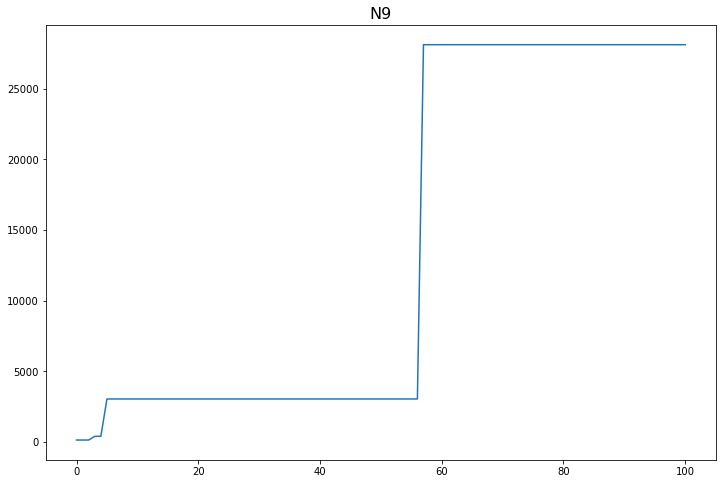

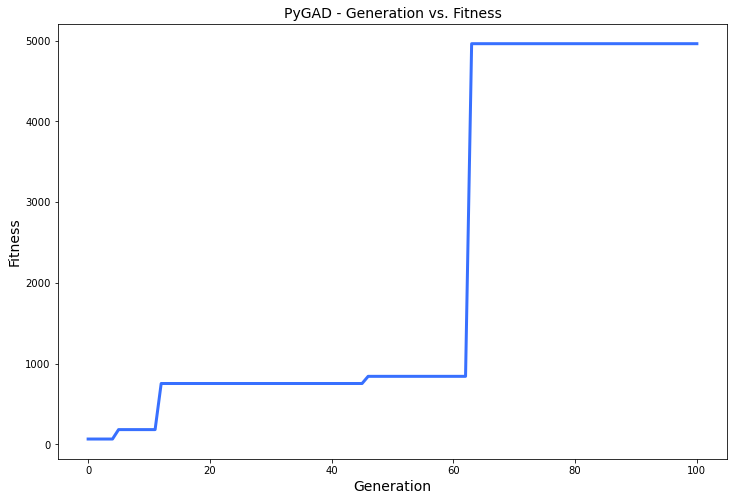

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 24.746 |==================| 3.176 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 24.917 |==================| 6.928 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 24.58 |==================| 2.077 |==========| N14 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 23.871 |==================| 0.84 |==========| N14 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 28.436 |==================| 1.771 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 28.926 |==================| 13.467 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 28.74 |==================| 3.846 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 28.57 |==================| 2.326 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 28.851 |==================| 6.68 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 28.816 |==================| 5.415 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 28.47 |==================| 1.885 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 28.955 |==================| 21.873 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 28.775 |==================| 4.433 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.01 |===========| 28.419 |==================| 1.721 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 28.766 |==================| 4.275 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 28.526 |==================| 2.107 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 28.678 |==================| 3.099 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 28.821 |==================| 5.572 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 28.771 |==================| 4.357 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 28.694 |==================| 3.265 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 28.732 |==================| 3.723 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 28.946 |==================| 18.314 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 28.915 |==================| 11.744 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 28.666 |==================| 2.993 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 28.871 |==================| 7.709 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 28.917 |==================| 11.947 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 28.766 |==================| 4.276 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 28.981 |==================| 51.833 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 28.866 |==================| 7.427 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 28.709 |==================| 3.435 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 28.709 |==================| 3.433 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 28.789 |==================| 4.73 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 28.553 |==================| 2.233 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 28.671 |==================| 3.035 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 28.455 |==================| 1.833 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 28.764 |==================| 4.237 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 28.815 |==================| 5.402 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 28.642 |==================| 2.788 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 28.689 |==================| 3.21 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 28.723 |==================| 3.606 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 28.537 |==================| 2.16 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 28.994 |==================| 160.949 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 28.679 |==================| 3.108 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 28.563 |==================| 2.288 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 28.523 |==================| 2.094 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 28.706 |==================| 3.393 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 28.931 |==================| 14.409 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 28.997 |==================| 348.579 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 28.865 |==================| 7.414 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 28.529 |==================| 2.12 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 28.847 |==================| 6.538 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 28.734 |==================| 3.748 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 28.886 |==================| 8.744 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 28.742 |==================| 3.874 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 28.713 |==================| 3.482 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 28.796 |==================| 4.894 |==========| N4 |==========
**********************************************************************
Gene

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 28.807 |==================| 5.176 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 28.859 |==================| 7.072 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 28.654 |==================| 2.892 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 28.493 |==================| 1.97 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 28.866 |==================| 7.448 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 28.99 |==================| 93.664 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 28.714 |==================| 3.487 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 28.443 |==================| 1.795 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 28.73 |==================| 3.705 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 28.502 |==================| 2.006 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 28.771 |==================| 4.355 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 28.473 |==================| 1.896 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 28.606 |==================| 2.534 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 28.837 |==================| 6.122 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 28.509 |==================| 2.034 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 28.996 |==================| 220.706 |==========| N4 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 28.674 |==================| 3.062 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 28.462 |==================| 1.859 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 28.485 |==================| 1.94 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 28.87 |==================| 7.694 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 28.839 |==================| 6.207 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 28.992 |==================| 113.844 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 28.95 |==================| 19.87 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 28.53 |==================| 2.125 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 28.603 |==================| 2.518 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 28.91 |==================| 11.072 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 28.601 |==================| 2.503 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 28.698 |==================| 3.305 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 28.579 |==================| 2.375 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 28.858 |==================| 7.043 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 28.882 |==================| 8.469 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 28.999 |==================| 725.118 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 28.773 |==================| 4.394 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 28.745 |==================| 3.913 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 28.875 |==================| 7.99 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 28.677 |==================| 3.092 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 28.947 |==================| 18.655 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 28.924 |==================| 13.175 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 28.683 |==================| 3.148 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 28.797 |==================| 4.921 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 28.751 |==================| 4.013 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 28.832 |==================| 5.928 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 28.666 |==================| 2.991 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 28.822 |==================| 5.609 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 28.678 |==================| 3.107 |==========| N4 |==========
**********************************************************************
Fitness = 1183.2538371126896
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 28.753 |==================| 4.049 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 28.706 |==================| 3.398 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 28.628 |==================| 2.689 |==========| N4 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 28.588 |==================| 2.428 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 28.997 |==================| 287.098 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 28.764 |==================| 4.234 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 28.606 |==================| 2.538 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 28.866 |==================| 7.445 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 28.748 |==================| 3.966 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 28.572 |==================| 2.336 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 28.71 |==================| 3.447 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 28.795 |==================| 4.873 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 28.818 |==================| 5.477 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 28.814 |==================| 5.357 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 28.995 |==================| 185.246 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 28.499 |==================| 1.994 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 28.6 |==================| 2.501 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 28.893 |==================| 9.323 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 28.776 |==================| 4.465 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 28.736 |==================| 3.788 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 28.605 |==================| 2.53 |==========| N4 |==========
**********************************************************************
Generation = 11
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 28.712 |==================| 3.465 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 28.914 |==================| 11.538 |==========| N4 |==========
************************************************************

======| 0.542 |===========| 28.722 |==================| 3.592 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 28.731 |==================| 3.707 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 28.778 |==================| 4.502 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 28.648 |==================| 2.835 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 28.824 |==================| 5.673 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 28.847 |==================| 6.533 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 28.439 |==================| 1.781 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 28.739 |==================| 3.824 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 28.949 |==================| 19.617 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 28.915 |==================| 11.756 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 28.669 |==================| 3.015 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 28.858 |==================| 7.015 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 28.445 |==================| 1.8 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 28.894 |==================| 9.435 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 28.854 |==================| 6.815 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 28.479 |==================| 1.918 |==========| N4 |==========
****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 28.426 |==================| 1.742 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 28.911 |==================| 11.222 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 28.677 |==================| 3.092 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 28.904 |==================| 10.335 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 28.549 |==================| 2.215 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 28.668 |==================| 3.01 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 28.599 |==================| 2.49 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 28.836 |==================| 6.099 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 28.738 |==================| 3.811 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 28.822 |==================| 5.619 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 28.75 |==================| 3.992 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 28.582 |==================| 2.393 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 28.93 |==================| 14.122 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 28.994 |==================| 162.492 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 28.72 |==================| 3.566 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 28.912 |==================| 11.264 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 28.729 |==================| 3.69 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 28.774 |==================| 4.414 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 28.719 |==================| 3.557 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 28.98 |==================| 48.967 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 28.702 |==================| 3.354 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 28.842 |==================| 6.301 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 28.529 |==================| 2.122 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 28.433 |==================| 1.764 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 28.932 |==================| 14.622 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 28.746 |==================| 3.93 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 28.447 |==================| 1.807 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 28.883 |==================| 8.52 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 28.628 |==================| 2.685 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 28.533 |==================| 2.142 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 28.622 |==================| 2.644 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 28.86 |==================| 7.124 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 28.507 |==================| 2.025 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 28.881 |==================| 8.35 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 28.849 |==================| 6.606 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 28.594 |==================| 2.46 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 28.616 |==================| 2.601 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 28.895 |==================| 9.469 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 28.438 |==================| 1.778 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 28.521 |==================| 2.084 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 28.735 |==================| 3.774 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 28.471 |==================| 1.889 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 28.869 |==================| 7.635 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 28.817 |==================| 5.461 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 28.652 |==================| 2.873 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 28.523 |==================| 2.096 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 28.566 |==================| 2.302 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 28.883 |==================| 8.532 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 28.82 |==================| 5.557 |==========| N4 |==========
**********************************************************************
Generation = 17
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 28.559 |==================| 2.264 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 28.791 |==================| 4.772 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 28.537 |==================| 2.158 |==========| N4 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 28.955 |==================| 21.941 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 28.644 |==================| 2.805 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 28.62 |==================| 2.631 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 28.555 |==================| 2.245 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 28.768 |==================| 4.31 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 28.549 |==================| 2.215 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 28.671 |==================| 3.035 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 28.587 |==================| 2.417 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 28.617 |==================| 2.606 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 28.734 |==================| 3.751 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 28.9 |==================| 10.002 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 28.656 |==================| 2.902 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 28.731 |==================| 3.714 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 28.588 |==================| 2.423 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 28.639 |==================| 2.769 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 28.76 |==================| 4.162 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 28.469 |==================| 1.881 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 28.835 |==================| 6.065 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 28.918 |==================| 12.089 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 28.524 |==================| 2.1 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 28.595 |==================| 2.466 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 28.791 |==================| 4.786 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 28.593 |==================| 2.456 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 28.792 |==================| 4.793 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.84 |===========| 28.535 |==================| 2.15 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 28.78 |==================| 4.534 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 28.576 |==================| 2.355 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 28.792 |==================| 4.79 |==========| N4 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 28.906 |==================| 10.614 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 28.863 |==================| 7.286 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 28.649 |==================| 2.848 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 28.84 |==================| 6.241 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 28.847 |==================| 6.533 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 28.833 |==================| 5.962 |==========| N4 |==========
**********************************************************************
Fitness = 1183.2538371126896
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 28.954 |==================| 21.804 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 28.618 |==================| 2.618 |==========| N4 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 28.451 |==================| 1.82 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 28.916 |==================| 11.801 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 28.873 |==================| 7.871 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 28.788 |==================| 4.715 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 28.97 |==================| 33.182 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 28.766 |==================| 4.269 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 28.562 |==================| 2.281 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 28.865 |==================| 7.366 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 28.482 |==================| 1.927 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 28.776 |==================| 4.464 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 28.979 |==================| 47.419 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 28.97 |==================| 33.182 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 28.965 |==================| 28.656 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 28.901 |==================| 10.031 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 28.784 |==================| 4.615 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 28.995 |==================| 173.266 |==========| N4 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 28.718 |==================| 3.538 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 28.698 |==================| 3.306 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 28.863 |==================| 7.308 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 28.707 |==================| 3.41 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 28.944 |==================| 17.916 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 28.446 |==================| 1.804 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 28.45 |==================| 1.816 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 28.638 |==================| 2.757 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 28.626 |==================| 2.672 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 28.693 |==================| 3.25 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 28.464 |==================| 1.865 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 28.87 |==================| 7.703 |==========| N4 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 28.748 |==================| 3.968 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 28.727 |==================| 3.652 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 28.859 |==================| 7.091 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 28.977 |==================| 43.567 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 28.821 |==================| 5.57 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 28.551 |==================| 2.227 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 28.44 |==================| 1.784 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 28.661 |==================| 2.944 |==========| N4 |==========
**********************************************************************
Change

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 28.572 |==================| 2.337 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 28.742 |==================| 3.866 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 28.607 |==================| 2.545 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 28.857 |==================| 6.999 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 28.457 |==================| 1.839 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 28.864 |==================| 7.321 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 28.483 |==================| 1.933 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 28.931 |==================| 14.378 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 28.592 |==================| 2.449 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 28.846 |==================| 6.468 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 28.939 |==================| 16.374 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 28.968 |==================| 30.488 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 28.933 |==================| 14.946 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 28.727 |==================| 3.658 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 28.827 |==================| 5.753 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 28.984 |==================| 62.597 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 28.818 |==================| 5.481 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 28.582 |==================| 2.388 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 28.924 |==================| 13.1 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 28.622 |==================| 2.645 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 28.624 |==================| 2.655 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 28.903 |==================| 10.239 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 28.826 |==================| 5.721 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 28.481 |==================| 1.927 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 28.629 |==================| 2.693 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 28.496 |==================| 1.983 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 28.705 |==================| 3.392 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 28.438 |==================| 1.778 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 28.958 |==================| 23.726 |==========| N4 |==========
**********************************************************************
Fitness = 1183.2538371126896
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 28.825 |==================| 5.712 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 28.58 |==================| 2.38 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 28.982 |==================| 53.954 |==========| N4 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 28.935 |==================| 15.274 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 28.588 |==================| 2.424 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 28.647 |==================| 2.83 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 28.965 |==================| 28.039 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 28.963 |==================| 26.561 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 28.742 |==================| 3.865 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 28.841 |==================| 6.259 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 28.471 |==================| 1.889 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 28.86 |==================| 7.102 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 28.922 |==================| 12.8 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 28.804 |==================| 5.088 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 28.556 |==================| 2.249 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 28.784 |==================| 4.612 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 28.781 |==================| 4.558 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 28.562 |==================| 2.283 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 28.78 |==================| 4.533 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 28.775 |==================| 4.439 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 28.685 |==================| 3.171 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 28.923 |==================| 12.956 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 28.956 |==================| 22.632 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 28.473 |==================| 1.896 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 28.803 |==================| 5.074 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 28.861 |==================| 7.159 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 28.481 |==================| 1.926 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 28.925 |==================| 13.207 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 28.745 |==================| 3.917 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 28.693 |==================| 3.252 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 28.611 |==================| 2.569 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 28.694 |==================| 3.262 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 28.822 |==================| 5.619 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 28.628 |==================| 2.685 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 28.651 |==================| 2.863 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 28.489 |==================| 1.956 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 28.795 |==================| 4.87 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 28.614 |==================| 2.589 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 28.512 |==================| 2.049 |==========| N4 |==========
**********************************************************************
Chang

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 28.786 |==================| 4.656 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 28.622 |==================| 2.641 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 28.528 |==================| 2.115 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 28.886 |==================| 8.776 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 28.787 |==================| 4.677 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 28.882 |==================| 8.467 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 28.968 |==================| 30.954 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 28.969 |==================| 32.132 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 28.755 |==================| 4.075 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 28.666 |==================| 2.993 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 28.998 |==================| 498.953 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 28.676 |==================| 3.079 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 28.622 |==================| 2.641 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 28.67 |==================| 3.03 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 28.991 |==================| 104.799 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 28.476 |==================| 1.908 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 28.685 |==================| 3.176 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 28.744 |==================| 3.904 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 28.719 |==================| 3.551 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 28.564 |==================| 2.292 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 28.977 |==================| 43.374 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 28.479 |==================| 1.92 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 28.844 |==================| 6.41 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 28.427 |==================| 1.744 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 28.549 |==================| 2.215 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 28.661 |==================| 2.948 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 28.795 |==================| 4.874 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 28.584 |==================| 2.403 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 28.848 |==================| 6.575 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 28.709 |==================| 3.433 |==========| N4 |==========
**********************************************************************
Fitness = 1183.2538371126896
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 28.627 |==================| 2.677 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 28.868 |==================| 7.573 |==========| N4 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 28.991 |==================| 110.487 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 28.936 |==================| 15.45 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 28.928 |==================| 13.818 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 28.829 |==================| 5.822 |==========| N4 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 28.483 |==================| 1.931 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 28.907 |==================| 10.698 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 28.434 |==================| 1.766 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 28.733 |==================| 3.74 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 28.67 |==================| 3.029 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 28.764 |==================| 4.238 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 28.931 |==================| 14.38 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 28.719 |==================| 3.558 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 28.945 |==================| 18.229 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 28.817 |==================| 5.457 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 28.671 |==================| 3.036 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 28.427 |==================| 1.745 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 28.918 |==================| 12.078 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 28.839 |==================| 6.184 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 28.911 |==================| 11.193 |==========| N4 |==========
**********************************************************************
Generation = 34
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 28.674 |==================| 3.066 |==========| N4 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 28.928 |==================| 13.782 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 28.982 |==================| 54.954 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 28.67 |==================| 3.026 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 28.799 |==================| 4.955 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 28.546 |==================| 2.201 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 28.706 |==================| 3.401 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 28.543 |==================| 2.185 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 29.0 |==================| 22175.516 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 28.479 |==================| 1.92 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 28.68 |==================| 3.12 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 28.579 |==================| 2.376 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 28.633 |==================| 2.719 |==========| N4 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 28.555 |==================| 2.248 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 28.718 |==================| 3.541 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 28.788 |==================| 4.713 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 28.839 |==================| 6.205 |==========| N4 |==========
***************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 28.727 |==================| 3.66 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 28.966 |==================| 29.191 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 28.515 |==================| 2.058 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 28.68 |==================| 3.125 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 28.821 |==================| 5.579 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 28.789 |==================| 4.733 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 28.763 |==================| 4.211 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 28.961 |==================| 25.511 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 28.812 |==================| 5.322 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 28.916 |==================| 11.911 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 28.68 |==================| 3.118 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 28.672 |==================| 3.048 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 28.755 |==================| 4.083 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 28.928 |==================| 13.802 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 28.725 |==================| 3.633 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 28.818 |==================| 5.489 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 28.625 |==================| 2.661 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.837 |===========| 28.538 |==================| 2.162 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 28.844 |==================| 6.395 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 28.862 |==================| 7.232 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 28.939 |==================| 16.348 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 28.875 |==================| 8.004 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 28.856 |==================| 6.945 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 28.984 |==================| 60.227 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 28.752 |==================| 4.027 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 28.822 |==================| 5.606 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 28.512 |==================| 2.049 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 28.973 |==================| 37.223 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 28.491 |==================| 1.962 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 28.629 |==================| 2.695 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 28.722 |==================| 3.593 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 28.681 |==================| 3.13 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 28.751 |==================| 4.016 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 28.505 |==================| 2.019 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 28.509 |==================| 2.036 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 28.916 |==================| 11.87 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 28.937 |==================| 15.676 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 28.66 |==================| 2.939 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 28.478 |==================| 1.915 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 28.906 |==================| 10.581 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 28.728 |==================| 3.674 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 28.688 |==================| 3.205 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 28.8 |==================| 4.999 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 28.934 |==================| 15.101 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 28.775 |==================| 4.446 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 28.629 |==================| 2.695 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 28.836 |==================| 6.1 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.212 |===========| 28.901 |==================| 10.12 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 28.58 |==================| 2.378 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 28.841 |==================| 6.281 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 28.943 |==================| 17.381 |==========| N4 |==========
**********************************************************************
Generation = 40
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 28.563 |==================| 2.289 |==========| N4 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 28.92 |==================| 12.396 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 28.911 |==================| 11.226 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 28.447 |==================| 1.807 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 28.804 |==================| 5.101 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 28.998 |==================| 412.78 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 28.787 |==================| 4.697 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 28.568 |==================| 2.315 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 28.434 |==================| 1.765 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 28.715 |==================| 3.505 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 28.681 |==================| 3.133 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 28.585 |==================| 2.407 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 28.851 |==================| 6.691 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 28.7 |==================| 3.325 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 28.594 |==================| 2.459 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 28.749 |==================| 3.987 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 28.63 |==================| 2.697 |==========| N4 |==========
******************************************************************

======| 0.953 |===========| 28.459 |==================| 1.848 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 28.981 |==================| 52.924 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 28.652 |==================| 2.87 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 28.885 |==================| 8.671 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 28.631 |==================| 2.705 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 28.539 |==================| 2.169 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 28.439 |==================| 1.782 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 28.707 |==================| 3.412 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 28.784 |==================| 4.616 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 28.841 |==================| 6.284 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 28.774 |==================| 4.428 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 28.634 |==================| 2.728 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 28.788 |==================| 4.713 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 28.666 |==================| 2.994 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 28.842 |==================| 6.304 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 28.437 |==================| 1.775 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 28.607 |==================| 2.544 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 28.991 |==================| 103.116 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 28.75 |==================| 3.999 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 28.474 |==================| 1.898 |==========| N4 |==========
**********************************************************************
Fitn

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 28.834 |==================| 5.999 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 28.887 |==================| 8.844 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 28.451 |==================| 1.82 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 28.659 |==================| 2.93 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 28.929 |==================| 14.092 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 28.74 |==================| 3.842 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 28.755 |==================| 4.077 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 28.462 |==================| 1.856 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 28.892 |==================| 9.23 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 28.904 |==================| 10.39 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 28.994 |==================| 156.87 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 28.437 |==================| 1.777 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 28.639 |==================| 2.77 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 28.637 |==================| 2.754 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 28.624 |==================| 2.658 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 28.74 |==================| 3.845 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 28.538 |==================| 2.164 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 28.768 |==================| 4.3 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 28.912 |==================| 11.306 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 28.766 |==================| 4.276 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 28.527 |==================| 2.114 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 28.61 |==================| 2.563 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 28.846 |==================| 6.463 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 28.52 |==================| 2.083 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 28.978 |==================| 44.668 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 28.805 |==================| 5.118 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 28.441 |==================| 1.789 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 28.847 |==================| 6.536 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 28.599 |==================| 2.494 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 28.542 |==================| 2.184 |==========| N4 |==========
**********************************************************************
Generation = 46
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 28.588 |==================| 2.425 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 28.917 |==================| 11.99 |==========| N4 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 28.925 |==================| 13.327 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 28.765 |==================| 4.246 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 28.899 |==================| 9.917 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 28.847 |==================| 6.504 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 28.933 |==================| 14.944 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 28.722 |==================| 3.589 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 28.926 |==================| 13.462 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 28.522 |==================| 2.093 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 28.508 |==================| 2.032 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 28.801 |==================| 5.02 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 28.534 |==================| 2.146 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 28.936 |==================| 15.445 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 28.742 |==================| 3.871 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 28.524 |==================| 2.101 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 28.855 |==================| 6.875 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 28.941 |==================| 16.938 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 28.981 |==================| 50.492 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 28.686 |==================| 3.184 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 28.835 |==================| 6.031 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 28.965 |==================| 28.105 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 28.745 |==================| 3.913 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 28.91 |==================| 11.081 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 28.94 |==================| 16.559 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 28.877 |==================| 8.094 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 28.786 |==================| 4.668 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 28.616 |==================| 2.599 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 28.719 |==================| 3.552 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 28.51 |==================| 2.037 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 28.698 |==================| 3.303 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 28.791 |==================| 4.784 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 28.461 |==================| 1.854 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 28.716 |==================| 3.522 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 28.671 |==================| 3.032 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 28.968 |==================| 30.805 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 28.992 |==================| 120.723 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 28.599 |==================| 2.492 |==========| N4 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 28.836 |==================| 6.074 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 28.452 |==================| 1.825 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 28.656 |==================| 2.908 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 28.78 |==================| 4.545 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 28.649 |==================| 2.847 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 28.868 |==================| 7.569 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 28.934 |==================| 15.046 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 28.588 |==================| 2.427 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 28.683 |==================| 3.153 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 28.606 |==================| 2.536 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 28.827 |==================| 5.755 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 28.938 |==================| 15.983 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 28.514 |==================| 2.056 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 28.819 |==================| 5.529 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 28.439 |==================| 1.781 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 28.437 |==================| 1.776 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 28.969 |==================| 31.52 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 28.429 |==================| 1.751 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 28.779 |==================| 4.526 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 28.467 |==================| 1.873 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 28.647 |==================| 2.826 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 28.476 |==================| 1.908 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 28.898 |==================| 9.797 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 28.843 |==================| 6.34 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 28.812 |==================| 5.319 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 28.842 |==================| 6.319 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 28.903 |==================| 10.285 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 28.666 |==================| 2.99 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 28.829 |==================| 5.823 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 28.859 |==================| 7.064 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 28.996 |==================| 227.154 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 28.964 |==================| 27.883 |==========| N4 |==========
**********************************************************************
Gen

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 28.933 |==================| 14.851 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 28.545 |==================| 2.197 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 28.976 |==================| 40.396 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 28.959 |==================| 24.234 |==========| N4 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 28.707 |==================| 3.405 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 28.7 |==================| 3.335 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 28.746 |==================| 3.925 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 28.56 |==================| 2.271 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 28.849 |==================| 6.604 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 28.931 |==================| 14.453 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 28.758 |==================| 4.128 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 28.636 |==================| 2.742 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 28.854 |==================| 6.85 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 28.537 |==================| 2.158 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 28.968 |==================| 30.771 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 28.455 |==================| 1.833 |==========| N4 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 28.61 |==================| 2.562 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 28.68 |==================| 3.121 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 28.61 |==================| 2.565 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 28.936 |==================| 15.498 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 28.877 |==================| 8.134 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 28.474 |==================| 1.901 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 28.759 |==================| 4.136 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 28.858 |==================| 7.032 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 28.821 |==================| 5.58 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 28.657 |==================| 2.917 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 28.722 |==================| 3.589 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 28.999 |==================| 670.248 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 28.493 |==================| 1.969 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 28.525 |==================| 2.103 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 28.63 |==================| 2.701 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 28.527 |==================| 2.114 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 28.88 |==================| 8.323 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 28.73 |==================| 3.702 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 28.912 |==================| 11.284 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 28.913 |==================| 11.453 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 28.993 |==================| 139.87 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 28.971 |==================| 34.301 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 28.867 |==================| 7.486 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 28.818 |==================| 5.488 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 28.768 |==================| 4.301 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 28.965 |==================| 28.088 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 28.983 |==================| 58.904 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 28.866 |==================| 7.437 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 28.555 |==================| 2.245 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 28.819 |==================| 5.504 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 28.892 |==================| 9.216 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 28.842 |==================| 6.316 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 28.977 |==================| 43.478 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 28.982 |==================| 54.684 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 28.623 |==================| 2.649 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 28.976 |==================| 40.937 |==========| N4 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 28.895 |==================| 9.48 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 28.673 |==================| 3.055 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 28.789 |==================| 4.732 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 28.698 |==================| 3.312 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 28.587 |==================| 2.419 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.451 |==================| 1.821 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 28.782 |==================| 4.579 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 28.839 |==================| 6.191 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 28.991 |==================| 102.445 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 28.979 |==================| 46.758 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 28.448 |==================| 1.81 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 28.807 |==================| 5.178 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 28.637 |==================| 2.755 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 28.739 |==================| 3.82 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 28.516 |==================| 2.064 |==========| N4 |==========
**********************************************************************
Generation = 58
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 28.878 |==================| 8.177 |==========| N4 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 28.905 |==================| 10.461 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.626 |===========| 28.672 |==================| 3.044 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 28.897 |==================| 9.692 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 28.637 |==================| 2.755 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 28.566 |==================| 2.304 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 28.785 |==================| 4.635 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 28.879 |==================| 8.238 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 28.981 |==================| 50.521 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 28.845 |==================| 6.443 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 28.876 |==================| 8.052 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 28.707 |==================| 3.407 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 28.739 |==================| 3.826 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 28.449 |==================| 1.814 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 28.946 |==================| 18.534 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 28.642 |==================| 2.792 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 28.73 |==================| 3.699 |==========| N4 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 28.705 |==================| 3.382 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 28.644 |==================| 2.805 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 28.474 |==================| 1.899 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 28.687 |==================| 3.197 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 28.945 |==================| 18.005 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 28.474 |==================| 1.9 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 28.984 |==================| 61.47 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 28.89 |==================| 9.058 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 28.553 |==================| 2.234 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 28.56 |==================| 2.271 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 28.574 |==================| 2.346 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 28.875 |==================| 7.979 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 28.871 |==================| 7.758 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 28.462 |==================| 1.856 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 28.447 |==================| 1.807 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 28.88 |==================| 8.295 |==========| N4 |==========
**********************************************************************
=====|

======| 0.295 |===========| 28.859 |==================| 7.074 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 28.526 |==================| 2.109 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 28.618 |==================| 2.618 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 28.773 |==================| 4.408 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 28.92 |==================| 12.445 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 28.741 |==================| 3.858 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 28.897 |==================| 9.639 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 28.859 |==================| 7.074 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 28.493 |==================| 1.97 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 28.777 |==================| 4.475 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 28.637 |==================| 2.75 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 28.945 |==================| 18.099 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 28.436 |==================| 1.772 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 28.85 |==================| 6.64 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 28.814 |==================| 5.378 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 28.729 |==================| 3.68 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 28.764 |==================| 4.231 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 28.584 |==================| 2.405 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 28.998 |==================| 460.825 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 28.436 |==================| 1.772 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 28.853 |==================| 6.777 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 28.478 |==================| 1.915 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 28.692 |==================| 3.248 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 28.505 |==================| 2.017 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 28.718 |==================| 3.546 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 28.447 |==================| 1.808 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 28.905 |==================| 10.487 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 28.579 |==================| 2.374 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 28.825 |==================| 5.712 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 28.774 |==================| 4.409 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 28.785 |==================| 4.643 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 28.456 |==================| 1.836 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 28.974 |==================| 38.646 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 28.739 |==================| 3.827 |==========| N4 |==========
**********************************************************************
Generation = 64
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 28.931 |==================| 14.455 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 28.686 |==================| 3.186 |==========| N4 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 28.84 |==================| 6.243 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 28.531 |==================| 2.129 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 28.881 |==================| 8.365 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 28.716 |==================| 3.517 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 28.585 |==================| 2.407 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 28.616 |==================| 2.604 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 28.482 |==================| 1.929 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 28.786 |==================| 4.673 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 28.962 |==================| 26.009 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 28.84 |==================| 6.237 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 28.532 |==================| 2.137 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 28.987 |==================| 76.095 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 28.707 |==================| 3.411 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 28.615 |==================| 2.596 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 28.917 |==================| 11.957 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 28.675 |==================| 3.077 |==========| N4 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 28.509 |==================| 2.037 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 28.803 |==================| 5.056 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 28.827 |==================| 5.776 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 28.97 |==================| 32.709 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 28.431 |==================| 1.756 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 28.529 |==================| 2.123 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 28.722 |==================| 3.598 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 28.527 |==================| 2.114 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 28.963 |==================| 27.001 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 28.846 |==================| 6.46 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 28.934 |==================| 15.138 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 28.947 |==================| 18.626 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 28.764 |==================| 4.233 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 28.861 |==================| 7.176 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 28.816 |==================| 5.428 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 28.525 |==================| 2.104 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 28.687 |==================| 3.192 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 28.946 |==================| 18.44 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 28.639 |==================| 2.768 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 28.924 |==================| 13.182 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 28.571 |==================| 2.328 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 28.883 |==================| 8.517 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 29.0 |==================| 3587.364 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 28.687 |==================| 3.192 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 28.829 |==================| 5.829 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 28.959 |==================| 24.079 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 28.806 |==================| 5.134 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 28.506 |==================| 2.023 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 28.595 |==================| 2.468 |==========| N4 |==========
**********************************************************************
Fitness = 22175.51598952856
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 28.944 |==================| 17.665 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 28.731 |==================| 3.708 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 28.963 |==================| 26.817 |==========| N4 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 28.791 |==================| 4.768 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 28.795 |==================| 4.88 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 28.536 |==================| 2.154 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 28.714 |==================| 3.492 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 28.62 |==================| 2.632 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 28.646 |==================| 2.819 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 28.71 |==================| 3.447 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 28.488 |==================| 1.954 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 28.495 |==================| 1.978 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 28.708 |==================| 3.423 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 28.722 |==================| 3.589 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 28.661 |==================| 2.945 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 28.454 |==================| 1.831 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 28.968 |==================| 31.369 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 28.495 |==================| 1.981 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 28.646 |==================| 2.82 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 28.98 |==================| 48.826 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 28.912 |==================| 11.278 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 28.837 |==================| 6.128 |==========| N4 |==========
**********************************************************************
Generation = 70
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 28.709 |==================| 3.437 |==========| N4 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 28.642 |==================| 2.792 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 28.961 |==================| 25.468 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 28.86 |==================| 7.131 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 28.441 |==================| 1.788 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 28.893 |==================| 9.334 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 28.808 |==================| 5.197 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 28.442 |==================| 1.79 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 28.611 |==================| 2.569 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 28.997 |==================| 299.267 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 28.739 |==================| 3.832 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 28.903 |==================| 10.267 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 28.598 |==================| 2.489 |==========| N4 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 28.836 |==================| 6.078 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 28.776 |==================| 4.45 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 28.481 |==================| 1.925 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 28.913 |==================| 11.516 |==========| N4 |==========
**************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 28.925 |==================| 13.231 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 28.665 |==================| 2.985 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 28.743 |==================| 3.893 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 28.539 |==================| 2.168 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 28.688 |==================| 3.199 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 28.914 |==================| 11.564 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 28.848 |==================| 6.561 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 28.517 |==================| 2.067 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.827 |===========| 28.544 |==================| 2.19 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 28.483 |==================| 1.934 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 28.886 |==================| 8.766 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 28.677 |==================| 3.089 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 28.954 |==================| 21.423 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 28.69 |==================| 3.226 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 28.979 |==================| 47.796 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 28.689 |==================| 3.211 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 28.79 |==================| 4.751 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 28.709 |==================| 3.433 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 28.704 |==================| 3.379 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 28.989 |==================| 89.001 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 28.663 |==================| 2.969 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.371 |===========| 28.819 |==================| 5.509 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 28.776 |==================| 4.452 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 28.52 |==================| 2.08 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 28.859 |==================| 7.075 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 28.575 |==================| 2.353 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 28.78 |==================| 4.547 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 28.892 |==================| 9.27 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 28.431 |==================| 1.755 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 28.602 |==================| 2.514 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 28.929 |==================| 14.013 |==========| N4 |==========
**********************************************************************
Fitness = 22175.51598952856
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 28.838 |==================| 6.143 |==========| N4 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 28.432 |==================| 1.76 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 28.912 |==================| 11.362 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 28.76 |==================| 4.167 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 28.802 |==================| 5.044 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 28.947 |==================| 18.728 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 28.941 |==================| 16.937 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 28.773 |==================| 4.398 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 28.965 |==================| 28.57 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 28.99 |==================| 97.309 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 28.694 |==================| 3.26 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 28.484 |==================| 1.936 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 28.947 |==================| 18.728 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 28.878 |==================| 8.192 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 28.984 |==================| 63.033 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 28.491 |==================| 1.962 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 28.822 |==================| 5.6 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 28.831 |==================| 5.913 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 28.958 |==================| 23.562 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 28.989 |==================| 89.518 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 28.628 |==================| 2.689 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 28.774 |==================| 4.417 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 28.981 |==================| 51.621 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 28.926 |==================| 13.383 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 28.775 |==================| 4.433 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 28.995 |==================| 179.781 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 28.941 |==================| 16.751 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 28.443 |==================| 1.795 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 28.774 |==================| 4.417 |==========| N4 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 28.881 |==================| 8.414 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 28.962 |==================| 26.158 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 28.618 |==================| 2.616 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 28.461 |==================| 1.856 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 28.926 |==================| 13.398 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 28.708 |==================| 3.426 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 28.713 |==================| 3.475 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 28.492 |==================| 1.967 |==========| N4 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 28.644 |==================| 2.805 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 28.971 |==================| 33.633 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 28.502 |==================| 2.008 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 28.737 |==================| 3.796 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 28.633 |==================| 2.724 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 28.834 |==================| 6.023 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 28.975 |==================| 38.819 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 28.606 |==================| 2.539 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 28.71 |==================| 3.444 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 28.48 |==================| 1.92 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 28.624 |==================| 2.659 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 28.772 |==================| 4.384 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 28.844 |==================| 6.385 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 28.991 |==================| 106.03 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 28.687 |==================| 3.192 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 28.559 |==================| 2.267 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 28.602 |==================| 2.51 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 28.584 |==================| 2.402 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 28.968 |==================| 30.901 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 28.798 |==================| 4.954 |==========| N4 |==========
**********************************************************************
Fitn

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 28.947 |==================| 18.722 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 28.802 |==================| 5.036 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 28.835 |==================| 6.056 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 28.568 |==================| 2.311 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 28.696 |==================| 3.288 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 28.994 |==================| 150.053 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 28.863 |==================| 7.29 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 28.842 |==================| 6.324 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 28.655 |==================| 2.895 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 28.827 |==================| 5.758 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 28.8 |==================| 4.994 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 28.5 |==================| 1.999 |==========| N4 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 28.765 |==================| 4.251 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 28.833 |==================| 5.977 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 28.991 |==================| 106.644 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 28.655 |==================| 2.895 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 28.76 |==================| 4.156 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 28.489 |==================| 1.954 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 28.527 |==================| 2.114 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 28.807 |==================| 5.16 |==========| N4 |==========
**********************************************************************
Generat

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 28.837 |==================| 6.108 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 28.971 |==================| 34.152 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 28.918 |==================| 12.165 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 28.76 |==================| 4.156 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 28.875 |==================| 7.95 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 28.635 |==================| 2.738 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 28.846 |==================| 6.495 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 28.867 |==================| 7.529 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 28.914 |==================| 11.636 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 28.669 |==================| 3.023 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 28.826 |==================| 5.722 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 28.984 |==================| 61.265 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 28.985 |==================| 65.916 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 28.98 |==================| 50.062 |==========| N4 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 28.719 |==================| 3.556 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 28.617 |==================| 2.606 |==========| N4 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 28.816 |==================| 5.416 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 28.903 |==================| 10.277 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 28.693 |==================| 3.255 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 28.438 |==================| 1.779 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 28.991 |==================| 106.781 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 28.956 |==================| 22.758 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 28.992 |==================| 120.394 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 28.754 |==================| 4.058 |==========| N4 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 28.566 |==================| 2.301 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 28.701 |==================| 3.342 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 28.757 |==================| 4.118 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 28.517 |==================| 2.067 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 28.457 |==================| 1.841 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 28.592 |==================| 2.447 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 28.857 |==================| 6.991 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 28.569 |==================| 2.319 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 28.487 |==================| 1.947 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 28.862 |==================| 7.237 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 28.808 |==================| 5.189 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 28.666 |==================| 2.992 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 28.633 |==================| 2.721 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 28.929 |==================| 14.063 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 28.608 |==================| 2.551 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 28.843 |==================| 6.35 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 28.83 |==================| 5.863 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 28.558 |==================| 2.263 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 28.575 |==================| 2.351 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 28.777 |==================| 4.478 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 28.772 |==================| 4.376 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.338 |===========| 28.837 |==================| 6.108 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 28.899 |==================| 9.883 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 28.497 |==================| 1.988 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 28.62 |==================| 2.626 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 28.742 |==================| 3.868 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 28.685 |==================| 3.173 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 28.97 |==================| 32.742 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 28.511 |==================| 2.042 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 28.844 |==================| 6.392 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 28.983 |==================| 58.436 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 28.76 |==================| 4.163 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 28.541 |==================| 2.175 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 28.506 |==================| 2.024 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 28.77 |==================| 4.349 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 28.481 |==================| 1.925 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 28.976 |==================| 40.774 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 28.721 |==================| 3.584 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 28.603 |==================| 2.516 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 28.863 |==================| 7.262 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 28.845 |==================| 6.43 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 28.593 |==================| 2.458 |==========| N4 |==========
**********************************************************************
Generation = 87
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 28.519 |==================| 2.079 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 28.781 |==================| 4.564 |==========| N4 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 28.877 |==================| 8.081 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 28.688 |==================| 3.202 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 28.758 |==================| 4.131 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 28.664 |==================| 2.972 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 28.507 |==================| 2.027 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 28.468 |==================| 1.878 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 28.451 |==================| 1.819 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 28.444 |==================| 1.799 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 28.739 |==================| 3.822 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 28.899 |==================| 9.917 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 28.702 |==================| 3.355 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 28.44 |==================| 1.786 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 28.993 |==================| 144.321 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 28.907 |==================| 10.699 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 28.563 |==================| 2.285 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 28.743 |==================| 3.887 |==========| N4 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 28.513 |==================| 2.053 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 28.941 |==================| 16.744 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 28.814 |==================| 5.371 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.701 |===========| 28.626 |==================| 2.669 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 28.939 |==================| 16.441 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 28.907 |==================| 10.754 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 28.833 |==================| 5.974 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 28.679 |==================| 3.111 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 28.798 |==================| 4.952 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 28.591 |==================| 2.44 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 28.986 |==================| 68.472 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 28.839 |==================| 6.186 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 28.541 |==================| 2.177 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 28.977 |==================| 42.393 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 28.741 |==================| 3.86 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 28.606 |==================| 2.536 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 28.838 |==================| 6.149 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 28.993 |==================| 139.892 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 28.595 |==================| 2.469 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 28.89 |==================| 9.093 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.604 |===========| 28.685 |==================| 3.175 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 28.931 |==================| 14.447 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 28.687 |==================| 3.193 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 28.68 |==================| 3.12 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 28.829 |==================| 5.825 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 28.914 |==================| 11.57 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 28.521 |==================| 2.087 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 28.954 |==================| 21.445 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 28.529 |==================| 2.123 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 28.932 |==================| 14.6 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 28.492 |==================| 1.969 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 28.55 |==================| 2.219 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 28.831 |==================| 5.89 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 28.743 |==================| 3.882 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 28.711 |==================| 3.451 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 28.873 |==================| 7.83 |==========| N4 |==========
**********************************************************************
=====|

======| 0.45 |===========| 28.775 |==================| 4.436 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 28.624 |==================| 2.657 |==========| N4 |==========
**********************************************************************
Generation = 92
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 28.563 |==================| 2.287 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 28.613 |==================| 2.584 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 28.742 |==================| 3.868 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 28.878 |==================| 8.181 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 28.714 |==================| 3.498 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 28.781 |==================| 4.568 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 28.531 |==================| 2.132 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 28.528 |==================| 2.118 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 28.998 |==================| 371.922 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 28.88 |==================| 8.339 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 28.436 |==================| 1.771 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 28.597 |==================| 2.48 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 28.856 |==================| 6.95 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 28.709 |==================| 3.438 |==========| N4 |==========
**********************************************************************
=====|SO

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 28.447 |==================| 1.807 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 28.435 |==================| 1.77 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 28.843 |==================| 6.345 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 28.869 |==================| 7.607 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 28.683 |==================| 3.149 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 28.525 |==================| 2.106 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 29.0 |==================| 91493.676 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 28.866 |==================| 7.457 |==========| N4 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 28.629 |==================| 2.69 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 28.777 |==================| 4.469 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 28.948 |==================| 18.983 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 28.993 |==================| 129.186 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 28.832 |==================| 5.935 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 28.992 |==================| 119.386 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 28.989 |==================| 85.308 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 28.888 |==================| 8.867 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 28.943 |==================| 17.597 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 28.489 |==================| 1.955 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 28.48 |==================| 1.923 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 28.6 |==================| 2.498 |==========| N4 |==========
**********************************************************************
=====|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 28.667 |==================| 2.997 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 28.933 |==================| 14.858 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 28.874 |==================| 7.911 |==========| N4 |==========
**********************************************************************
Fitness = 91493.6755384882
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 28.931 |==================| 14.515 |==========| N4 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 28.519 |==================| 2.079 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 28.956 |==================| 22.355 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 28.738 |==================| 3.819 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 28.821 |==================| 5.591 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 28.956 |==================| 22.447 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 28.875 |==================| 7.951 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 28.907 |==================| 10.695 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 28.725 |==================| 3.63 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 28.979 |==================| 47.667 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 28.603 |==================| 2.514 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 28.637 |==================| 2.75 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 28.956 |==================| 22.447 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 28.841 |==================| 6.294 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 28.783 |==================| 4.609 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 28.896 |==================| 9.561 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 28.995 |==================| 178.718 |==========| N4 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 28.862 |==================| 7.255 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 28.484 |==================| 1.938 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 28.989 |==================| 87.238 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 28.533 |==================| 2.142 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 28.678 |==================| 3.107 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 28.472 |==================| 1.893 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 28.905 |==================| 10.459 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 28.736 |==================| 3.784 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 28.833 |==================| 5.994 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 28.852 |==================| 6.756 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 28.893 |==================| 9.314 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 28.695 |==================| 3.27 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 28.802 |==================| 5.032 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 28.877 |==================| 8.128 |==========| N4 |==========
**********************************************************************
Generation = 98
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 28.981 |==================| 52.539 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 28.871 |==================| 7.759 |==========| N4 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 28.439 |==================| 1.782 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 28.728 |==================| 3.672 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 28.707 |==================| 3.406 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 28.802 |==================| 5.032 |==========| N4 |==========
**********************************************************************
====

======| 0.696 |===========| 28.628 |==================| 2.689 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 28.682 |==================| 3.142 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 28.545 |==================| 2.196 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 28.863 |==================| 7.26 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 28.661 |==================| 2.944 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 28.81 |==================| 5.267 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 28.818 |==================| 5.473 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 28.466 |==================| 1.871 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 28.9 |==================| 9.99 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 28.972 |==================| 35.459 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 28.493 |==================| 1.97 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 28.661 |==================| 2.944 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 28.546 |==================| 2.202 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 28.981 |==================| 51.098 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 28.722 |==================| 3.591 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 28.969 |==================| 32.093 |==========| N4 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 28.529 |==================| 2.12 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 28.789 |==================| 4.739 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 28.816 |==================| 5.431 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 28.597 |==================| 2.48 |==========| N4 |==========
**********************************************************************
=====|S

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 28.731 |==================| 3.717 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 28.597 |==================| 2.478 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 28.942 |==================| 17.288 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 28.879 |==================| 8.264 |==========| N4 |==========
**********************************************************************
===

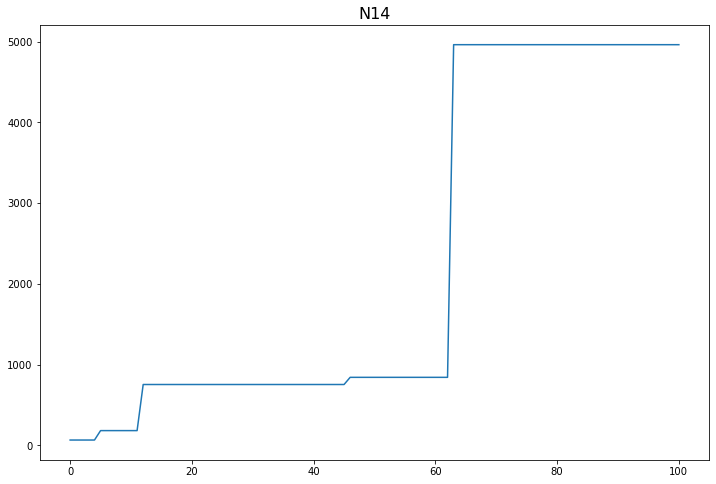

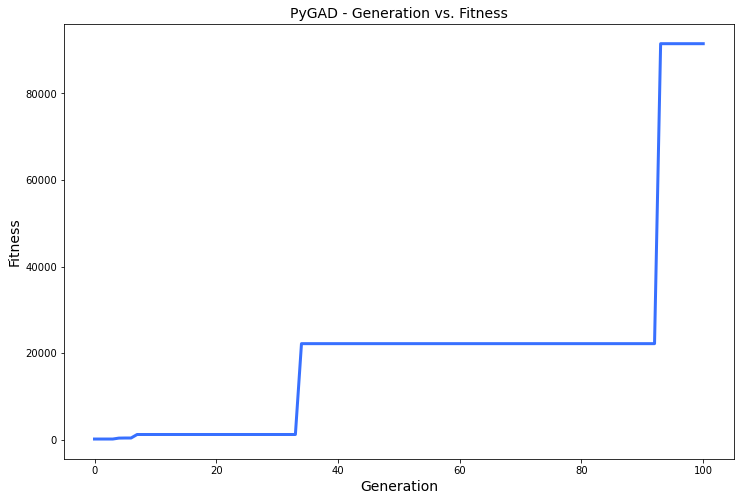

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 28.969 |==================| 32.093 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 28.741 |==================| 3.854 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 28.714 |==================| 3.495 |==========| N4 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 28.946 |==================| 18.464 |==========| N4 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 27.668 |==================| 5.75 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 27.525 |==================| 3.155 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 27.833 |==================| 109.493 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 27.466 |==================| 2.66 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 27.722 |==================| 8.316 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 27.42 |==================| 2.37 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 27.652 |==================| 5.253 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 27.362 |==================| 2.082 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.373 |===========| 27.681 |==================| 6.196 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 27.581 |==================| 3.832 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 27.79 |==================| 19.363 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 27.582 |==================| 3.84 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 27.505 |==================| 2.963 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 27.326 |==================| 1.938 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.737 |==================| 9.546 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 27.736 |==================| 9.417 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 27.799 |==================| 23.484 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 27.42 |==================| 2.367 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 27.722 |==================| 8.312 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 27.678 |==================| 6.111 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 27.572 |==================| 3.698 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 27.685 |==================| 6.382 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 27.366 |==================| 2.099 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 27.661 |==================| 5.522 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 27.765 |==================| 12.948 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 27.798 |==================| 22.583 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 27.84 |==================| 437.178 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 27.39 |==================| 2.212 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 27.644 |==================| 5.056 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 27.496 |==================| 2.89 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 27.661 |==================| 5.516 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 27.366 |==================| 2.101 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 27.502 |==================| 2.945 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 27.466 |==================| 2.658 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.805 |===========| 27.446 |==================| 2.527 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 27.408 |==================| 2.301 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 27.73 |==================| 8.889 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 27.341 |==================| 1.994 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 27.546 |==================| 3.378 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 27.689 |==================| 6.543 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 27.466 |==================| 2.658 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 27.342 |==================| 2.001 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 27.653 |==================| 5.278 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 27.428 |==================| 2.416 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 27.4 |==================| 2.264 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 27.69 |==================| 6.562 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 27.348 |==================| 2.023 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 27.829 |==================| 79.009 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 27.531 |==================| 3.215 |==========| N11 |==========
**********************************************************************
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 27.408 |==================| 2.304 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 27.334 |==================| 1.97 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 27.379 |==================| 2.162 |==========| N11 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 27.431 |==================| 2.435 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 27.348 |==================| 2.026 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 27.772 |==================| 14.289 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.718 |===========| 27.497 |==================| 2.902 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 27.68 |==================| 6.176 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 27.654 |==================| 5.326 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 27.459 |==================| 2.612 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 27.842 |==================| 10039.726 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 27.642 |==================| 5.001 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 27.505 |==================| 2.968 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 27.656 |==================| 5.369 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 27.355 |==================| 2.054 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 27.654 |==================| 5.321 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 27.514 |==================| 3.049 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.871 |===========| 27.407 |==================| 2.297 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 27.529 |==================| 3.191 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 27.367 |==================| 2.103 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 27.831 |==================| 89.309 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 27.728 |==================| 8.804 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 27.489 |==================| 2.834 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 27.609 |==================| 4.298 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 27.64 |==================| 4.95 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 27.417 |==================| 2.352 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 27.393 |==================| 2.227 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 27.418 |==================| 2.357 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 27.753 |==================| 11.235 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 27.508 |==================| 2.993 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 27.609 |==================| 4.298 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 27.662 |==================| 5.569 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 27.774 |==================| 14.75 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 27.654 |==================| 5.33 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 27.331 |==================| 1.958 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 27.583 |==================| 3.854 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 27.625 |==================| 4.602 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 27.53 |==================| 3.201 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 27.403 |==================| 2.28 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 27.618 |==================| 4.458 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 27.488 |==================| 2.827 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 27.506 |==================| 2.977 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 27.807 |==================| 28.521 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.6 |==================| 4.129 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 27.793 |==================| 20.246 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 27.837 |==================| 204.917 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 27.797 |==================| 22.173 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 27.606 |==================| 4.229 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 27.736 |==================| 9.452 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 27.745 |==================| 10.284 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 27.834 |==================| 120.437 |==========| N11 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 27.357 |==================| 2.061 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 27.486 |==================| 2.807 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 27.585 |==================| 3.884 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 27.685 |==================| 6.386 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 27.52 |==================| 3.108 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 27.752 |==================| 11.091 |==========| N11 |==========
**********************************************************************
Generation = 10
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.701 |==================| 7.084 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 27.809 |==================| 30.055 |==========| N11 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 27.371 |==================| 2.125 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 27.4 |==================| 2.263 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 27.837 |==================| 185.223 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 27.525 |==================| 3.158 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 27.82 |==================| 45.807 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 27.53 |==================| 3.21 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 27.433 |==================| 2.443 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 27.765 |==================| 12.935 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 27.536 |==================| 3.268 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 27.842 |==================| 2207.279 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 27.801 |==================| 24.415 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 27.601 |==================| 4.155 |==========| N11 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 27.609 |==================| 4.298 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 27.461 |==================| 2.623 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 27.738 |==================| 9.622 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 27.686 |==================| 6.406 |==========| N11 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 27.461 |==================| 2.621 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 27.414 |==================| 2.336 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 27.667 |==================| 5.717 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 27.824 |==================| 54.903 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 27.741 |==================| 9.849 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 27.627 |==================| 4.655 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 27.61 |==================| 4.319 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 27.417 |==================| 2.352 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 27.441 |==================| 2.494 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 27.773 |==================| 14.468 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 27.841 |==================| 1127.325 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 27.444 |==================| 2.514 |==========| N11 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 27.65 |==================| 5.208 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 27.338 |==================| 1.982 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 27.662 |==================| 5.545 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 27.602 |==================| 4.164 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 27.62 |==================| 4.495 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 27.454 |==================| 2.577 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 27.427 |==================| 2.407 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 27.553 |==================| 3.457 |==========| N11 |==========
**********************************************************************
Fi

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 27.593 |==================| 4.017 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 27.529 |==================| 3.192 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 27.641 |==================| 4.983 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 27.631 |==================| 4.743 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 27.57 |==================| 3.682 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 27.445 |==================| 2.52 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 27.477 |==================| 2.738 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 27.669 |==================| 5.77 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 27.834 |==================| 130.438 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 27.746 |==================| 10.443 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 27.741 |==================| 9.866 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 27.469 |==================| 2.678 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 27.461 |==================| 2.622 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 27.812 |==================| 33.605 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 27.356 |==================| 2.058 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 27.767 |==================| 13.367 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 27.745 |==================| 10.288 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 27.759 |==================| 11.974 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 27.699 |==================| 6.998 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 27.728 |==================| 8.796 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 27.41 |==================| 2.317 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 27.428 |==================| 2.414 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 27.528 |==================| 3.186 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 27.813 |==================| 33.872 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 27.733 |==================| 9.165 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 27.52 |==================| 3.109 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 27.546 |==================| 3.383 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 27.435 |==================| 2.456 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 27.435 |==================| 2.458 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.473 |===========| 27.631 |==================| 4.729 |==========| N11 |==========
**********************************************************************
Generation = 16
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 27.724 |==================| 8.498 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 27.642 |==================| 5.004 |==========| N11 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 27.642 |==================| 4.999 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 27.765 |==================| 12.996 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 27.478 |==================| 2.746 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.678 |==================| 6.087 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 27.774 |==================| 14.59 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 27.35 |==================| 2.034 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 27.339 |==================| 1.989 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 27.538 |==================| 3.291 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 27.815 |==================| 36.761 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 27.671 |==================| 5.833 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 27.659 |==================| 5.46 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 27.783 |==================| 16.811 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 27.79 |==================| 19.114 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 27.479 |==================| 2.751 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.701 |==================| 7.081 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 27.637 |==================| 4.866 |==========| N11 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 27.406 |==================| 2.292 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 27.82 |==================| 46.423 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 27.841 |==================| 827.363 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 27.638 |==================| 4.91 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 27.421 |==================| 2.377 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 27.702 |==================| 7.149 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 27.51 |==================| 3.013 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 27.787 |==================| 18.179 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 27.458 |==================| 2.604 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 27.526 |==================| 3.16 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 27.68 |==================| 6.162 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 27.804 |==================| 25.965 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 27.8 |==================| 23.704 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 27.387 |==================| 2.196 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 27.8 |==================| 24.016 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 27.643 |==================| 5.032 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 27.432 |==================| 2.441 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 27.642 |==================| 5.001 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 27.761 |==================| 12.309 |==========| N11 |==========
**********************************************************************
Fitness = 10039.725726619361
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 27.684 |==================| 6.339 |==========| N11 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.701 |==================| 7.099 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 27.567 |==================| 3.633 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 27.609 |==================| 4.3 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 27.529 |==================| 3.196 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 27.824 |==================| 54.346 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 27.472 |==================| 2.705 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 27.761 |==================| 12.272 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 27.737 |==================| 9.562 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 27.424 |==================| 2.39 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 27.462 |==================| 2.633 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 27.336 |==================| 1.975 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 27.69 |==================| 6.597 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 27.807 |==================| 28.419 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 27.652 |==================| 5.258 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 27.639 |==================| 4.937 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 27.605 |==================| 4.211 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 27.798 |==================| 22.812 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 27.467 |==================| 2.665 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 27.411 |==================| 2.322 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 27.587 |==================| 3.921 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 27.388 |==================| 2.202 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 27.494 |==================| 2.873 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 27.476 |==================| 2.732 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.668 |==================| 5.733 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 27.61 |==================| 4.301 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 27.625 |==================| 4.603 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 27.704 |==================| 7.222 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 27.478 |==================| 2.745 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 27.487 |==================| 2.817 |==========| N11 |==========
**********************************************************************
Generation = 22
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 27.358 |==================| 2.064 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 27.782 |==================| 16.521 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 27.453 |==================| 2.571 |==========| N11 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 27.467 |==================| 2.666 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 27.831 |==================| 86.853 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 27.725 |==================| 8.527 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 27.828 |==================| 70.047 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 27.443 |==================| 2.504 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 27.611 |==================| 4.323 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.668 |==================| 5.73 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 27.467 |==================| 2.666 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 27.679 |==================| 6.143 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.6 |==================| 4.134 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 27.428 |==================| 2.413 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 27.784 |==================| 17.357 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 27.65 |==================| 5.195 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 27.719 |==================| 8.147 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 27.763 |==================| 12.726 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 27.482 |==================| 2.774 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 27.445 |==================| 2.517 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 27.556 |==================| 3.494 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 27.336 |==================| 1.974 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 27.642 |==================| 4.997 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 27.733 |==================| 9.177 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 27.543 |==================| 3.348 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 27.656 |==================| 5.366 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 27.741 |==================| 9.861 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 27.551 |==================| 3.431 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 27.392 |==================| 2.221 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 27.694 |==================| 6.754 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 27.794 |==================| 20.62 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 27.52 |==================| 3.105 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 27.489 |==================| 2.832 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 27.602 |==================| 4.168 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 27.451 |==================| 2.555 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 27.709 |==================| 7.505 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 27.802 |==================| 24.767 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 27.631 |==================| 4.739 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 27.606 |==================| 4.244 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 27.376 |==================| 2.147 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 27.646 |==================| 5.093 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.137 |===========| 27.787 |==================| 18.189 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 27.658 |==================| 5.431 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.668 |==================| 5.743 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 27.525 |==================| 3.15 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 27.669 |==================| 5.779 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 27.669 |==================| 5.772 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 27.673 |==================| 5.923 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 27.657 |==================| 5.416 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 27.783 |==================| 16.897 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 27.77 |==================| 13.867 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 27.617 |==================| 4.438 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 27.69 |==================| 6.591 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 27.499 |==================| 2.912 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 27.609 |==================| 4.286 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 27.741 |==================| 9.865 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 27.486 |==================| 2.812 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 27.351 |==================| 2.036 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 27.623 |==================| 4.57 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 27.826 |==================| 63.957 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 27.662 |==================| 5.545 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 27.81 |==================| 30.873 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 27.527 |==================| 3.17 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 27.436 |==================| 2.462 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 27.826 |==================| 62.775 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 27.771 |==================| 14.149 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 27.789 |==================| 18.986 |==========| N11 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 27.575 |==================| 3.739 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 27.811 |==================| 32.668 |==========| N11 |==========
**********************************************************************
Generation = 28
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 27.355 |==================| 2.051 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 27.337 |==================| 1.98 |==========| N11 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 27.551 |==================| 3.436 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 27.657 |==================| 5.395 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 27.728 |==================| 8.756 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 27.339 |==================| 1.988 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 27.636 |==================| 4.859 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 27.351 |==================| 2.036 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 27.694 |==================| 6.756 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 27.551 |==================| 3.436 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 27.826 |==================| 62.108 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 27.597 |==================| 4.087 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 27.691 |==================| 6.606 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 27.364 |==================| 2.092 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 27.82 |==================| 44.809 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 27.517 |==================| 3.079 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 27.83 |==================| 84.681 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 27.353 |==================| 2.043 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 27.5 |==================| 2.92 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 27.414 |==================| 2.334 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 27.587 |==================| 3.921 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 27.474 |==================| 2.715 |==========| N11 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 27.831 |==================| 88.977 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 27.76 |==================| 12.177 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 27.503 |==================| 2.95 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 27.474 |==================| 2.716 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 27.641 |==================| 4.986 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 27.749 |==================| 10.756 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 27.599 |==================| 4.11 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 27.391 |==================| 2.215 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 27.841 |==================| 746.426 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 27.803 |==================| 25.667 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 27.656 |==================| 5.381 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 27.709 |==================| 7.49 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 27.613 |==================| 4.36 |==========| N11 |==========
**********************************************************************
Fitness = 10039.725726619361
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 27.708 |==================| 7.455 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 27.839 |==================| 379.424 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 27.74 |==================| 9.805 |==========| N11 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 27.838 |==================| 236.055 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 27.817 |==================| 39.393 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 27.713 |==================| 7.757 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 27.484 |==================| 2.796 |==========| N11 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 27.338 |==================| 1.985 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 27.654 |==================| 5.318 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 27.332 |==================| 1.961 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 27.48 |==================| 2.762 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 27.789 |==================| 18.953 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 27.725 |==================| 8.55 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 27.338 |==================| 1.986 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 27.499 |==================| 2.912 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 27.656 |==================| 5.381 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 27.333 |==================| 1.963 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 27.462 |==================| 2.629 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 27.553 |==================| 3.458 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 27.839 |==================| 379.19 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 27.389 |==================| 2.206 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 27.715 |==================| 7.86 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 27.644 |==================| 5.05 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 27.452 |==================| 2.567 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 27.72 |==================| 8.164 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 27.498 |==================| 2.904 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 27.638 |==================| 4.897 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 27.437 |==================| 2.47 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 27.495 |==================| 2.885 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 27.664 |==================| 5.615 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 27.431 |==================| 2.433 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 27.481 |==================| 2.766 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 27.755 |==================| 11.524 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 27.758 |==================| 11.865 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 27.755 |==================| 11.528 |==========| N11 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 27.723 |==================| 8.387 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 27.587 |==================| 3.925 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 27.386 |==================| 2.194 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 27.6 |==================| 4.124 |==========| N11 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 27.378 |==================| 2.154 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 27.758 |==================| 11.927 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 27.818 |==================| 42.421 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 27.715 |==================| 7.858 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 27.348 |==================| 2.024 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 27.418 |==================| 2.359 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 27.76 |==================| 12.177 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 27.768 |==================| 13.491 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 27.426 |==================| 2.403 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 27.813 |==================| 34.345 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 27.608 |==================| 4.264 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 27.76 |==================| 12.18 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 27.765 |==================| 12.995 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 27.615 |==================| 4.402 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 27.705 |==================| 7.322 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 27.471 |==================| 2.693 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 27.781 |==================| 16.433 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 27.705 |==================| 7.302 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 27.368 |==================| 2.111 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 27.603 |==================| 4.176 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 27.576 |==================| 3.758 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 27.553 |==================| 3.464 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 27.478 |==================| 2.748 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 27.464 |==================| 2.644 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 27.38 |==================| 2.162 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 27.523 |==================| 3.139 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 27.601 |==================| 4.144 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 27.676 |==================| 6.035 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 27.469 |==================| 2.677 |==========| N11 |==========
**********************************************************************
Fitness = 10039.725726619361
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 27.677 |==================| 6.044 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 27.509 |==================| 3.004 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 27.729 |==================| 8.858 |==========| N11 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 27.625 |==================| 4.617 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 27.436 |==================| 2.462 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 27.766 |==================| 13.187 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.724 |==================| 8.445 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 27.699 |==================| 7.009 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 27.827 |==================| 65.942 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 27.784 |==================| 17.213 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 27.507 |==================| 2.983 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 27.832 |==================| 96.993 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 27.546 |==================| 3.38 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 27.469 |==================| 2.679 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 27.58 |==================| 3.812 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 27.768 |==================| 13.513 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 27.758 |==================| 11.896 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 27.351 |==================| 2.038 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 27.473 |==================| 2.71 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 27.489 |==================| 2.834 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 27.547 |==================| 3.39 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 27.563 |==================| 3.581 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 27.798 |==================| 22.868 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 27.595 |==================| 4.045 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 27.593 |==================| 4.008 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 27.596 |==================| 4.057 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 27.809 |==================| 30.606 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 27.476 |==================| 2.734 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 27.482 |==================| 2.775 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 27.33 |==================| 1.953 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 27.346 |==================| 2.017 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 27.642 |==================| 4.992 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 27.746 |==================| 10.453 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 27.796 |==================| 21.672 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 27.567 |==================| 3.642 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 27.364 |==================| 2.092 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 27.783 |==================| 16.918 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 27.802 |==================| 24.934 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 27.388 |==================| 2.2 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.72 |===========| 27.496 |==================| 2.894 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 27.457 |==================| 2.599 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 27.655 |==================| 5.334 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 27.535 |==================| 3.253 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 27.7 |==================| 7.061 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 27.423 |==================| 2.386 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 27.739 |==================| 9.75 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 27.436 |==================| 2.465 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 27.794 |==================| 20.926 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 27.38 |==================| 2.164 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 27.697 |==================| 6.883 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 27.621 |==================| 4.518 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 27.834 |==================| 122.988 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 27.813 |==================| 34.357 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 27.743 |==================| 10.128 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 27.545 |==================| 3.362 |==========| N11 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 27.692 |==================| 6.649 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 27.725 |==================| 8.513 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 27.764 |==================| 12.863 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 27.634 |==================| 4.802 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 27.761 |==================| 12.362 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 27.708 |==================| 7.434 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 27.5 |==================| 2.923 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 27.724 |==================| 8.463 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 27.769 |==================| 13.73 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 27.402 |==================| 2.27 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 27.632 |==================| 4.76 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 27.821 |==================| 47.434 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 27.725 |==================| 8.574 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 27.784 |==================| 17.169 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 27.8 |==================| 23.818 |==========| N11 |==========
**********************************************************************
Fitness = 10039.725726619361
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 27.59 |==================| 3.968 |==========| N11 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 27.428 |==================| 2.417 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 27.52 |==================| 3.107 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 27.748 |==================| 10.611 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 27.703 |==================| 7.173 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 27.452 |==================| 2.566 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 27.753 |==================| 11.289 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 27.77 |==================| 13.81 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 27.602 |==================| 4.158 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 27.491 |==================| 2.853 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 27.611 |==================| 4.337 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 27.576 |==================| 3.755 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 27.452 |==================| 2.566 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 27.564 |==================| 3.598 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.678 |==================| 6.094 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 27.759 |==================| 12.0 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 27.67 |==================| 5.823 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 27.609 |==================| 4.285 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 27.807 |==================| 28.414 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 27.803 |==================| 25.526 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 27.661 |==================| 5.537 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 27.531 |==================| 3.216 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.636 |===========| 27.544 |==================| 3.35 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 27.731 |==================| 8.994 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 27.523 |==================| 3.13 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 27.495 |==================| 2.878 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 27.813 |==================| 34.703 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 27.659 |==================| 5.471 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 27.647 |==================| 5.124 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 27.656 |==================| 5.372 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 27.791 |==================| 19.642 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 27.401 |==================| 2.269 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 27.796 |==================| 21.56 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.418 |===========| 27.658 |==================| 5.438 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 27.506 |==================| 2.976 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 27.342 |==================| 1.999 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 27.777 |==================| 15.409 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 27.656 |==================| 5.377 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 27.326 |==================| 1.939 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 27.381 |==================| 2.171 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 27.622 |==================| 4.542 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 27.411 |==================| 2.318 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 27.629 |==================| 4.69 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 27.747 |==================| 10.538 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 27.46 |==================| 2.614 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 27.429 |==================| 2.423 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 27.383 |==================| 2.18 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 27.673 |==================| 5.927 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 27.494 |==================| 2.871 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 27.535 |==================| 3.259 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 27.607 |==================| 4.26 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 27.41 |==================| 2.317 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.356 |===========| 27.689 |==================| 6.524 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 27.618 |==================| 4.472 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 27.497 |==================| 2.899 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 27.66 |==================| 5.498 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 27.578 |==================| 3.79 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 27.652 |==================| 5.26 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 27.596 |==================| 4.066 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 27.326 |==================| 1.938 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 27.414 |==================| 2.338 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 27.798 |==================| 22.704 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 27.725 |==================| 8.562 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 27.824 |==================| 55.495 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 27.452 |==================| 2.563 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 27.632 |==================| 4.768 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 27.512 |==================| 3.026 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 27.45 |==================| 2.55 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 27.332 |==================| 1.962 |==========| N11 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 27.717 |==================| 7.978 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 27.428 |==================| 2.415 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.454 |===========| 27.64 |==================| 4.955 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 27.554 |==================| 3.469 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 27.548 |==================| 3.4 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 27.722 |==================| 8.339 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 27.579 |==================| 3.804 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 27.565 |==================| 3.604 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 27.462 |==================| 2.633 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 27.673 |==================| 5.928 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 27.59 |==================| 3.971 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 27.547 |==================| 3.391 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 27.764 |==================| 12.818 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 27.782 |==================| 16.62 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 27.729 |==================| 8.869 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 27.784 |==================| 17.136 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 27.652 |==================| 5.262 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 27.573 |==================| 3.723 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 27.625 |==================| 4.608 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 27.825 |==================| 58.207 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 27.479 |==================| 2.752 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 27.61 |==================| 4.303 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 27.422 |==================| 2.379 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 27.652 |==================| 5.262 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 27.729 |==================| 8.83 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 27.707 |==================| 7.418 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 27.365 |==================| 2.096 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 27.64 |==================| 4.947 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 27.517 |==================| 3.073 |==========| N11 |==========
**********************************************************************
Generation = 52
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 27.419 |==================| 2.365 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 27.838 |==================| 253.112 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 27.456 |==================| 2.593 |==========| N11 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 27.761 |==================| 12.37 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 27.66 |==================| 5.483 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 27.348 |==================| 2.025 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 27.808 |==================| 29.34 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 27.554 |==================| 3.471 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 27.795 |==================| 21.226 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 27.508 |==================| 2.996 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 27.7 |==================| 7.047 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 27.565 |==================| 3.614 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.737 |==================| 9.522 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 27.37 |==================| 2.117 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 27.489 |==================| 2.834 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 27.373 |==================| 2.134 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 27.816 |==================| 38.362 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 27.449 |==================| 2.545 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 27.819 |==================| 42.829 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 27.796 |==================| 21.52 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 27.657 |==================| 5.4 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 27.601 |==================| 4.151 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.414 |===========| 27.66 |==================| 5.502 |==========| N11 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 27.694 |==================| 6.745 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 27.571 |==================| 3.685 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 27.483 |==================| 2.785 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 27.415 |==================| 2.342 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 27.722 |==================| 8.337 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 27.771 |==================| 14.166 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 27.461 |==================| 2.627 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 27.819 |==================| 42.772 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 27.765 |==================| 12.915 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 27.629 |==================| 4.702 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 27.485 |==================| 2.802 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 27.58 |==================| 3.809 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 27.648 |==================| 5.155 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 27.792 |==================| 19.811 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 27.706 |==================| 7.349 |==========| N11 |==========
**********************************************************************
Fitness = 10039.725726619361
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 27.656 |==================| 5.384 |==========| N11 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 27.742 |==================| 10.0 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 27.752 |==================| 11.128 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 27.438 |==================| 2.473 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 27.61 |==================| 4.318 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 27.816 |==================| 39.112 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 27.656 |==================| 5.366 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 27.764 |==================| 12.812 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 27.634 |==================| 4.817 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 27.413 |==================| 2.329 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 27.736 |==================| 9.453 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 27.578 |==================| 3.785 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 27.555 |==================| 3.484 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 27.671 |==================| 5.834 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 27.795 |==================| 21.279 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 27.641 |==================| 4.974 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 27.413 |==================| 2.329 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 27.498 |==================| 2.908 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 27.752 |==================| 11.133 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 27.811 |==================| 32.125 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 27.374 |==================| 2.135 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 27.675 |==================| 6.0 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 27.529 |==================| 3.197 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.191 |===========| 27.764 |==================| 12.857 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 27.473 |==================| 2.713 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 27.346 |==================| 2.016 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 27.776 |==================| 15.205 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 27.329 |==================| 1.949 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 27.688 |==================| 6.505 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 27.556 |==================| 3.498 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 27.732 |==================| 9.093 |==========| N11 |==========
**********************************************************************
Generation = 58
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 27.403 |==================| 2.28 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 27.409 |==================| 2.311 |==========| N11 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 27.377 |==================| 2.15 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 27.761 |==================| 12.32 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 27.673 |==================| 5.92 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 27.458 |==================| 2.603 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 27.469 |==================| 2.682 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 27.765 |==================| 12.937 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.678 |==================| 6.097 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 27.383 |==================| 2.179 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 27.636 |==================| 4.853 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 27.466 |==================| 2.658 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 27.62 |==================| 4.497 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 27.563 |==================| 3.579 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 27.67 |==================| 5.822 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 27.792 |==================| 19.922 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 27.46 |==================| 2.614 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 27.766 |==================| 13.123 |==========| N11 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 27.659 |==================| 5.476 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 27.812 |==================| 32.833 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 27.41 |==================| 2.313 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 27.721 |==================| 8.285 |==========| N11 |==========
**********************************************************************


======| 0.098 |===========| 27.803 |==================| 25.91 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 27.424 |==================| 2.39 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 27.819 |==================| 43.776 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 27.45 |==================| 2.55 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 27.744 |==================| 10.183 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 27.377 |==================| 2.148 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 27.835 |==================| 137.807 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 27.803 |==================| 25.91 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 27.431 |==================| 2.432 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 27.773 |==================| 14.444 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 27.722 |==================| 8.308 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 27.525 |==================| 3.156 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 27.666 |==================| 5.677 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 27.663 |==================| 5.58 |==========| N11 |==========
**********************************************************************
Fitness = 10039.725726619361
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 27.395 |==================| 2.236 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 27.475 |==================| 2.727 |==========| N11 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 27.668 |==================| 5.747 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 27.477 |==================| 2.738 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 27.718 |==================| 8.084 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 27.666 |==================| 5.677 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 27.371 |==================| 2.124 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 27.824 |==================| 56.563 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.069 |===========| 27.815 |==================| 37.204 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 27.594 |==================| 4.03 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 27.708 |==================| 7.471 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 27.595 |==================| 4.05 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 27.39 |==================| 2.211 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 27.84 |==================| 467.526 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 27.72 |==================| 8.22 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 27.412 |==================| 2.326 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 27.668 |==================| 5.748 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 27.579 |==================| 3.804 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 27.754 |==================| 11.376 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 27.337 |==================| 1.98 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 27.326 |==================| 1.937 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 27.527 |==================| 3.177 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 27.478 |==================| 2.747 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 27.439 |==================| 2.479 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 27.577 |==================| 3.77 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 27.754 |==================| 11.376 |==========| N11 |==========
**********************************************************************


**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 27.749 |==================| 10.775 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 27.393 |==================| 2.225 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 27.637 |==================| 4.881 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 27.478 |==================| 2.747 |==========| N11 |==========


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 27.624 |==================| 4.582 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 27.758 |==================| 11.937 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 27.794 |==================| 20.929 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 27.486 |==================| 2.809 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 27.647 |==================| 5.131 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 27.444 |==================| 2.512 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 27.801 |==================| 24.347 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 27.383 |==================| 2.179 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 27.683 |==================| 6.268 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 27.521 |==================| 3.112 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 27.733 |==================| 9.204 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 27.751 |==================| 11.003 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 27.824 |==================| 54.825 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 27.514 |==================| 3.044 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 27.679 |==================| 6.133 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 27.387 |==================| 2.199 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 27.76 |==================| 12.132 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 27.461 |==================| 2.621 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 27.835 |==================| 146.686 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.709 |==================| 7.543 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 27.84 |==================| 462.509 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 27.334 |==================| 1.968 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 27.341 |==================| 1.995 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 27.478 |==================| 2.747 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 27.837 |==================| 182.083 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 27.513 |==================| 3.043 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 27.673 |==================| 5.911 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 27.84 |==================| 462.509 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 27.39 |==================| 2.211 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 27.553 |==================| 3.465 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 27.355 |==================| 2.055 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 27.649 |==================| 5.182 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 27.551 |==================| 3.437 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 27.498 |==================| 2.906 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 27.468 |==================| 2.673 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 27.698 |==================| 6.958 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.775 |==================| 14.847 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 27.539 |==================| 3.301 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 27.675 |==================| 6.003 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 27.436 |==================| 2.464 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 27.474 |==================| 2.719 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 27.489 |==================| 2.835 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 27.832 |==================| 104.219 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 27.515 |==================| 3.062 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 27.589 |==================| 3.948 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 27.563 |==================| 3.586 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.716 |===========| 27.499 |==================| 2.913 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 27.809 |==================| 30.58 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 27.459 |==================| 2.611 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 27.607 |==================| 4.261 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 27.386 |==================| 2.191 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 27.713 |==================| 7.778 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 27.503 |==================| 2.95 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 27.364 |==================| 2.09 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 27.68 |==================| 6.165 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 27.662 |==================| 5.541 |==========| N11 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 27.749 |==================| 10.778 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 27.76 |==================| 12.142 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 27.805 |==================| 27.126 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 27.443 |==================| 2.504 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 27.546 |==================| 3.374 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 27.826 |==================| 61.475 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 27.493 |==================| 2.868 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 27.741 |==================| 9.854 |==========| N11 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 27.441 |==================| 2.493 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 27.43 |==================| 2.425 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 27.814 |==================| 35.167 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 27.546 |==================| 3.374 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 27.457 |==================| 2.599 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 27.671 |==================| 5.834 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 27.475 |==================| 2.727 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 27.809 |==================| 30.681 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 27.574 |==================| 3.732 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 27.725 |==================| 8.546 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 27.616 |==================| 4.432 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 27.432 |==================| 2.437 |==========| N11 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 27.369 |==================| 2.114 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 27.605 |==================| 4.214 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 27.397 |==================| 2.249 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 27.573 |==================| 3.72 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 27.487 |==================| 2.816 |==========| N11 |==========
**********************************************************************
Fitness = 10039.725726619361
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 27.456 |==================| 2.592 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.668 |==================| 5.731 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 27.659 |==================| 5.461 |==========| N11 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 27.674 |==================| 5.939 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 27.574 |==================| 3.726 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 27.398 |==================| 2.255 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 27.798 |==================| 22.903 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 27.416 |==================| 2.346 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 27.758 |==================| 11.955 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 27.574 |==================| 3.736 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 27.839 |==================| 382.942 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 27.616 |==================| 4.418 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 27.424 |==================| 2.392 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 27.723 |==================| 8.386 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 27.51 |==================| 3.01 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 27.601 |==================| 4.155 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 27.341 |==================| 1.995 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 27.347 |==================| 2.019 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 27.79 |==================| 19.346 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 27.599 |==================| 4.107 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 27.741 |==================| 9.861 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 27.786 |==================| 17.899 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 27.467 |==================| 2.665 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 27.661 |==================| 5.528 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 27.826 |==================| 63.695 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 27.524 |==================| 3.148 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 27.706 |==================| 7.367 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 27.525 |==================| 3.157 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 27.733 |==================| 9.145 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 27.434 |==================| 2.453 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 27.558 |==================| 3.52 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 27.59 |==================| 3.963 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 27.478 |==================| 2.749 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 27.799 |==================| 23.058 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 27.576 |==================| 3.765 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 27.335 |==================| 1.972 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 27.836 |==================| 163.619 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 27.657 |==================| 5.408 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 27.494 |==================| 2.87 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 27.434 |==================| 2.452 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 27.547 |==================| 3.391 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 27.443 |==================| 2.507 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 27.681 |==================| 6.209 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 27.623 |==================| 4.559 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 27.485 |==================| 2.798 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 27.834 |==================| 131.855 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 27.754 |==================| 11.334 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 27.768 |==================| 13.545 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 27.718 |==================| 8.092 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 27.618 |==================| 4.459 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 27.634 |==================| 4.811 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 27.501 |==================| 2.928 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 27.522 |==================| 3.128 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 27.676 |==================| 6.031 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 27.505 |==================| 2.968 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 27.821 |==================| 46.885 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 27.801 |==================| 24.496 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 27.432 |==================| 2.439 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 27.816 |==================| 38.232 |==========| N11 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 27.47 |==================| 2.685 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 27.643 |==================| 5.029 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 27.662 |==================| 5.57 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 27.564 |==================| 3.598 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 27.474 |==================| 2.719 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 27.78 |==================| 16.015 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 27.488 |==================| 2.823 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 27.645 |==================| 5.074 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 27.773 |==================| 14.573 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 27.8 |==================| 24.067 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 27.442 |==================| 2.502 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 27.457 |==================| 2.598 |==========| N11 |==========
**********************************************************************
F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 27.604 |==================| 4.194 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 27.364 |==================| 2.093 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 27.339 |==================| 1.989 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 27.414 |==================| 2.338 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 27.816 |==================| 38.895 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 27.469 |==================| 2.682 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 27.368 |==================| 2.108 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 27.537 |==================| 3.28 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 27.352 |==================| 2.04 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 27.441 |==================| 2.494 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 27.667 |==================| 5.703 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 27.669 |==================| 5.776 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 27.798 |==================| 22.716 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 27.835 |==================| 135.387 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 27.485 |==================| 2.799 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 27.616 |==================| 4.424 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 27.757 |==================| 11.711 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 27.78 |==================| 16.104 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.716 |==================| 7.946 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 27.728 |==================| 8.778 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 27.439 |==================| 2.482 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 27.656 |==================| 5.363 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 27.792 |==================| 20.031 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 27.757 |==================| 11.711 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 27.8 |==================| 23.63 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 27.505 |==================| 2.969 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 27.598 |==================| 4.097 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 27.814 |==================| 35.497 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 27.656 |==================| 5.385 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 27.616 |==================| 4.433 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 27.329 |==================| 1.947 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 27.719 |==================| 8.098 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 27.663 |==================| 5.596 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 27.396 |==================| 2.24 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 27.622 |==================| 4.541 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 27.47 |==================| 2.686 |==========| N11 |==========
*************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 27.362 |==================| 2.082 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 27.78 |==================| 16.217 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 27.774 |==================| 14.669 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 27.776 |==================| 15.177 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 27.751 |==================| 11.029 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 27.332 |==================| 1.96 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 27.349 |==================| 2.029 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 27.675 |==================| 5.99 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 27.578 |==================| 3.787 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 27.806 |==================| 27.465 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.747 |==================| 10.561 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 27.424 |==================| 2.394 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 27.499 |==================| 2.917 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 27.47 |==================| 2.691 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 27.801 |==================| 24.282 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 27.694 |==================| 6.776 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 27.362 |==================| 2.084 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 27.451 |==================| 2.556 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 27.556 |==================| 3.492 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 27.73 |==================| 8.94 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 27.547 |==================| 3.39 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 27.806 |==================| 28.062 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 27.576 |==================| 3.765 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 27.549 |==================| 3.408 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 27.724 |==================| 8.457 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 27.505 |==================| 2.966 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 27.754 |==================| 11.358 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 27.598 |==================| 4.094 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 27.758 |==================| 11.879 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.348 |===========| 27.692 |==================| 6.678 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 27.362 |==================| 2.081 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 27.724 |==================| 8.457 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 27.822 |==================| 49.026 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 27.733 |==================| 9.192 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 27.763 |==================| 12.723 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 27.701 |==================| 7.071 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 27.676 |==================| 6.01 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 27.474 |==================| 2.717 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 27.836 |==================| 161.399 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 27.798 |==================| 22.742 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 27.605 |==================| 4.222 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 27.627 |==================| 4.66 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 27.673 |==================| 5.92 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 27.396 |==================| 2.241 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 27.792 |==================| 20.055 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 27.427 |==================| 2.407 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 27.512 |==================| 3.032 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 27.605 |==================| 4.222 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 27.606 |==================| 4.236 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 27.665 |==================| 5.638 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 27.71 |==================| 7.587 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 27.422 |==================| 2.383 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 27.63 |==================| 4.717 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 27.549 |==================| 3.41 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 27.832 |==================| 96.666 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 27.661 |==================| 5.519 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 27.744 |==================| 10.187 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 27.79 |==================| 19.114 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 27.769 |==================| 13.785 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.896 |===========| 27.391 |==================| 2.216 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 27.687 |==================| 6.432 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 27.329 |==================| 1.95 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 27.8 |==================| 23.518 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 27.614 |==================| 4.387 |==========| N11 |==========
**********************************************************************
===

======| 0.99 |===========| 27.332 |==================| 1.96 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 27.58 |==================| 3.815 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 27.687 |==================| 6.469 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 27.62 |==================| 4.497 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|===

======| 0.846 |===========| 27.422 |==================| 2.38 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 27.632 |==================| 4.765 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 27.339 |==================| 1.989 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 27.332 |==================| 1.96 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 27.75 |==================| 10.823 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 27.682 |==================| 6.255 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 27.62 |==================| 4.495 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 27.422 |==================| 2.381 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 27.416 |==================| 2.346 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 27.462 |==================| 2.629 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 27.835 |==================| 149.881 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 27.426 |==================| 2.405 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 27.466 |==================| 2.657 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 27.617 |==================| 4.453 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 27.549 |==================| 3.411 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 27.5 |==================| 2.926 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 27.393 |==================| 2.225 |==========| N11 |==========
**********************************************************************
Fitness = 10039.725726619361
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 27.777 |==================| 15.437 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 27.493 |==================| 2.867 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 27.761 |==================| 12.28 |==========| N11 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 27.587 |==================| 3.924 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 27.491 |==================| 2.851 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 27.772 |==================| 14.308 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 27.482 |==================| 2.777 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 27.738 |==================| 9.603 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 27.806 |==================| 27.691 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 27.782 |==================| 16.54 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 27.638 |==================| 4.889 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 27.791 |==================| 19.609 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 27.814 |==================| 35.545 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 27.495 |==================| 2.884 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 27.738 |==================| 9.603 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 27.696 |==================| 6.857 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 27.531 |==================| 3.215 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 27.644 |==================| 5.05 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 27.792 |==================| 19.858 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 27.412 |==================| 2.323 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 27.36 |==================| 2.074 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 27.716 |==================| 7.907 |==========| N11 |==========
**********************************************************************
Generation = 90
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 27.428 |==================| 2.415 |==========| N11 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 27.772 |==================| 14.192 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 27.8 |==================| 23.96 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.716 |==================| 7.943 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 27.84 |==================| 448.733 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 27.751 |==================| 10.927 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 27.608 |==================| 4.274 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 27.371 |==================| 2.125 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 27.716 |==================| 7.904 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 27.513 |==================| 3.037 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 27.534 |==================| 3.244 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 27.559 |==================| 3.528 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 27.331 |==================| 1.957 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 27.806 |==================| 27.979 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 27.578 |==================| 3.786 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 27.68 |==================| 6.162 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 27.382 |==================| 2.175 |==========| N11 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 27.829 |==================| 77.365 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 27.478 |==================| 2.747 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 27.34 |==================| 1.99 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 27.642 |==================| 5.004 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 27.63 |==================| 4.712 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 27.763 |==================| 12.644 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 27.495 |==================| 2.878 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 27.824 |==================| 55.699 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 27.657 |==================| 5.393 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 27.518 |==================| 3.082 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 27.607 |==================| 4.257 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 27.631 |==================| 4.747 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 27.483 |==================| 2.784 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 27.54 |==================| 3.315 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 27.828 |==================| 70.062 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 27.647 |==================| 5.136 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 27.77 |==================| 13.799 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 27.651 |==================| 5.227 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 27.326 |==================| 1.938 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 27.773 |==================| 14.451 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 27.603 |==================| 4.187 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 27.447 |==================| 2.531 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 27.437 |==================| 2.47 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 27.768 |==================| 13.498 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 27.791 |==================| 19.553 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.469 |===========| 27.633 |==================| 4.775 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 27.462 |==================| 2.63 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 27.828 |==================| 69.413 |==========| N11 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.78 |===========| 27.461 |==================| 2.625 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 27.833 |==================| 117.075 |==========| N11 |==========
**********************************************************************
Fitness = 10039.725726619361
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 27.739 |==================| 9.669 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 27.328 |==================| 1.945 |==========| N11 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.828 |===========| 27.432 |==================| 2.441 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 27.381 |==================| 2.17 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 27.618 |==================| 4.456 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 27.771 |==================| 14.04 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 27.735 |==================| 9.367 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 27.787 |==================| 18.032 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 27.477 |==================| 2.738 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 27.758 |==================| 11.863 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.296 |===========| 27.717 |==================| 7.99 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 27.429 |==================| 2.418 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 27.82 |==================| 45.851 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 27.345 |==================| 2.013 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 27.771 |==================| 14.082 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 27.698 |==================| 6.949 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 27.797 |==================| 22.209 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 27.547 |==================| 3.394 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 27.732 |==================| 9.084 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 27.677 |==================| 6.055 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 27.612 |==================| 4.346 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 27.521 |==================| 3.112 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 27.47 |==================| 2.685 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 27.495 |==================| 2.882 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 27.419 |==================| 2.362 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 27.732 |==================| 9.084 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 27.382 |==================| 2.174 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 27.331 |==================| 1.955 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 27.373 |==================| 2.134 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 27.47 |==================| 2.685 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 27.621 |==================| 4.519 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 27.627 |==================| 4.649 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 27.79 |==================| 19.342 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 27.548 |==================| 3.4 |==========| N11 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 27.415 |==================| 2.34 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 27.638 |==================| 4.907 |==========| N11 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 27.344 |==================| 2.009 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 27.443 |==================| 2.507 |==========| N11 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 27.332 |==================| 1.962 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 27.815 |==================| 36.808 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 27.773 |==================| 14.475 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 27.4 |==================| 2.261 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 27.377 |==================| 2.151 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 27.445 |==================| 2.521 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 27.837 |==================| 189.295 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 27.784 |==================| 17.378 |==========| N11 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 27.444 |==================| 2.513 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 27.683 |==================| 6.29 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 27.429 |==================| 2.419 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 27.394 |==================| 2.234 |==========| N11 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 27.676 |==================| 6.038 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 27.336 |==================| 1.975 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.6 |==================| 4.126 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 27.661 |==================| 5.522 |==========| N11 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 27.348 |==================| 2.025 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 27.415 |==================| 2.344 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 27.614 |==================| 4.378 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 27.676 |==================| 6.021 |==========| N11 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 27.418 |==================| 2.36 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 27.4 |==================| 2.262 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 27.534 |==================| 3.251 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 27.626 |==================| 4.628 |==========| N11 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 27.76 |==================| 12.185 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 27.821 |==================| 47.751 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 27.424 |==================| 2.391 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 27.781 |==================| 16.334 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 27.591 |==================| 3.977 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 27.542 |==================| 3.329 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.727 |==================| 8.682 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 27.7 |==================| 7.024 |==========| N11 |==========
**********************************************************************
Fitn

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 27.527 |==================| 3.175 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 27.775 |==================| 14.886 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 27.698 |==================| 6.959 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 27.61 |==================| 4.309 |==========| N11 |==========
**********************************************************************


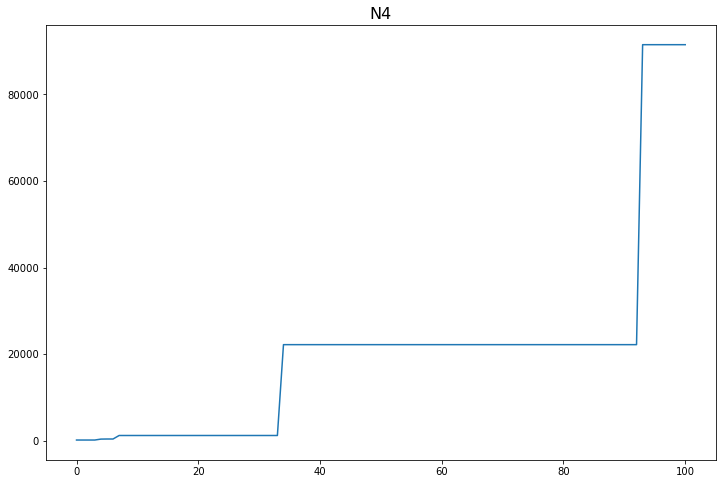

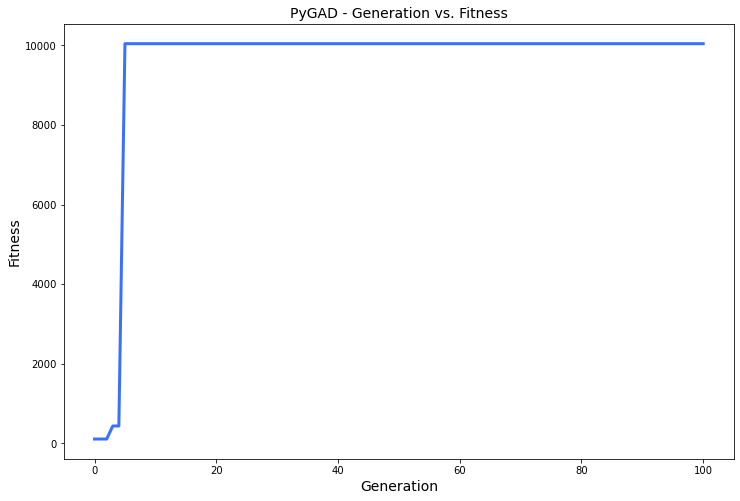

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 27.781 |==================| 16.276 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 27.76 |==================| 12.185 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 27.821 |==================| 47.751 |==========| N11 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 27.424 |==================| 2.391 |==========| N11 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 24.504 |==================| 11.798 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 24.371 |==================| 4.603 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 24.193 |==================| 2.528 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 24.529 |==================| 16.982 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 24.179 |==================| 2.442 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 24.328 |==================| 3.849 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 24.455 |==================| 7.477 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 24.123 |==================| 2.15 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 24.084 |==================| 1.985 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 24.574 |==================| 68.191 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.468 |===========| 24.133 |==================| 2.195 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 24.24 |==================| 2.874 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 23.98 |==================| 1.645 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 24.117 |==================| 2.124 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 23.863 |==================| 1.379 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 23.93 |==================| 1.518 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 24.359 |==================| 4.364 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 24.043 |==================| 1.833 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 24.291 |==================| 3.36 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 23.98 |==================| 1.645 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 24.095 |==================| 2.028 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 23.875 |==================| 1.403 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 23.859 |==================| 1.371 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 24.558 |==================| 32.61 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 24.396 |==================| 5.196 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 23.628 |==================| 1.041 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 23.598 |==================| 1.01 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.463 |==================| 7.993 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 24.038 |==================| 1.819 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 24.58 |==================| 126.74 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.33 |==================| 3.871 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 24.33 |==================| 3.871 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 23.674 |==================| 1.094 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 23.989 |==================| 1.669 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.405 |==================| 5.471 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 23.784 |==================| 1.243 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 23.946 |==================| 1.558 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 23.969 |==================| 1.616 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 24.398 |==================| 5.267 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 24.519 |==================| 14.476 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 24.065 |==================| 1.909 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 24.276 |==================| 3.203 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 24.436 |==================| 6.546 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 24.465 |==================| 8.092 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 24.116 |==================| 2.118 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.401 |==================| 5.354 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.121 |==================| 2.139 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 23.654 |==================| 1.07 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.512 |==================| 13.04 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 23.802 |==================| 1.271 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 24.138 |==================| 2.219 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 23.941 |==================| 1.545 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 23.612 |==================| 1.024 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 24.236 |==================| 2.835 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 24.068 |==================| 1.922 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.512 |==================| 13.04 |==========| N12 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 24.162 |==================| 2.347 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 24.532 |==================| 17.917 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 24.351 |==================| 4.211 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 23.612 |==================| 1.024 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 24.568 |==================| 48.547 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 24.231 |==================| 2.798 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 24.249 |==================| 2.949 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 24.519 |==================| 14.519 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 24.201 |==================| 2.583 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 24.037 |==================| 1.813 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 24.093 |==================| 2.019 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.289 |==================| 3.345 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 23.848 |==================| 1.352 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 23.64 |==================| 1.054 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 24.474 |==================| 8.769 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.023 |==================| 1.769 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 24.254 |==================| 2.992 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 24.538 |==================| 19.809 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 23.972 |==================| 1.623 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.17 |==================| 2.39 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 23.66 |==================| 1.077 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 24.079 |==================| 1.963 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 24.429 |==================| 6.279 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 24.235 |==================| 2.832 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 24.559 |==================| 33.631 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 24.151 |==================| 2.288 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 23.629 |==================| 1.042 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 23.921 |==================| 1.498 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 23.643 |==================| 1.058 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 24.573 |==================| 67.183 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 23.929 |==================| 1.516 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 24.559 |==================| 33.631 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 24.18 |==================| 2.447 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 24.544 |==================| 22.783 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 23.74 |==================| 1.179 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 24.188 |==================| 2.495 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 24.135 |==================| 2.206 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 23.974 |==================| 1.629 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 24.319 |==================| 3.712 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 23.588 |==================| 1.0 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 24.488 |==================| 9.992 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 24.195 |==================| 2.543 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.287 |==================| 3.315 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 23.942 |==================| 1.547 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 24.481 |==================| 9.304 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 24.228 |==================| 2.779 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 23.894 |==================| 1.441 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.41 |===========| 24.192 |==================| 2.526 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 23.855 |==================| 1.364 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 23.995 |==================| 1.685 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 23.867 |==================| 1.387 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 24.204 |==================| 2.601 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.339 |==================| 4.006 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 24.126 |==================| 2.161 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 24.416 |==================| 5.808 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.453 |===========| 24.148 |==================| 2.271 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 24.087 |==================| 1.996 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 23.817 |==================| 1.296 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 23.872 |==================| 1.395 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 24.502 |==================| 11.533 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 23.588 |==================| 0.999 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.45 |===========| 24.152 |==================| 2.29 |==========| N12 |==========
**********************************************************************
Generation = 11
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 23.647 |==================| 1.062 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 24.514 |==================| 13.434 |==========| N12 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.281 |==================| 3.252 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 24.489 |==================| 10.053 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 23.875 |==================| 1.402 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 24.191 |==================| 2.52 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.457 |==================| 7.598 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 23.739 |==================| 1.177 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 23.897 |==================| 1.446 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 23.687 |==================| 1.11 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 23.598 |==================| 1.01 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 24.063 |==================| 1.905 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 24.458 |==================| 7.676 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 23.962 |==================| 1.598 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 24.577 |==================| 89.821 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 23.877 |==================| 1.406 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 23.92 |==================| 1.496 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 23.81 |==================| 1.285 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.039 |===========| 24.552 |==================| 27.738 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 23.738 |==================| 1.177 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.323 |===========| 24.28 |==================| 3.242 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 24.112 |==================| 2.098 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.401 |==================| 5.348 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.903 |===========| 23.66 |==================| 1.077 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 24.436 |==================| 6.58 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 24.062 |==================| 1.9 |==========| N12 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 24.108 |==================| 2.08 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 24.474 |==================| 8.754 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 24.298 |==================| 3.448 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 24.533 |==================| 18.221 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 24.029 |==================| 1.788 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 23.992 |==================| 1.678 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 23.604 |==================| 1.016 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 24.264 |==================| 3.088 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 24.455 |==================| 7.523 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 24.413 |==================| 5.694 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 24.366 |==================| 4.503 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 24.028 |==================| 1.785 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 24.286 |==================| 3.309 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 23.786 |==================| 1.246 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 23.837 |==================| 1.332 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 24.417 |==================| 5.848 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 23.916 |==================| 1.487 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 23.88 |==================| 1.412 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 24.516 |==================| 13.8 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 24.035 |==================| 1.808 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 24.019 |==================| 1.757 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 23.941 |==================| 1.546 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 24.272 |==================| 3.158 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 23.843 |==================| 1.341 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 23.711 |==================| 1.139 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 23.747 |==================| 1.189 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 24.088 |==================| 1.998 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 24.097 |==================| 2.036 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 24.558 |==================| 33.246 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 23.627 |==================| 1.041 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 23.727 |==================| 1.161 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 23.666 |==================| 1.085 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 23.932 |==================| 1.523 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 23.994 |==================| 1.683 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 23.964 |==================| 1.601 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 24.267 |==================| 3.108 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.769 |===========| 23.81 |==================| 1.285 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 24.326 |==================| 3.818 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 24.433 |==================| 6.443 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 23.785 |==================| 1.245 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.263 |===========| 24.339 |==================| 4.018 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 23.835 |==================| 1.327 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 23.597 |==================| 1.009 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 23.718 |==================| 1.149 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 24.507 |==================| 12.32 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 23.633 |==================| 1.047 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 24.146 |==================| 2.263 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 23.721 |==================| 1.153 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.286 |===========| 24.316 |==================| 3.679 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.289 |==================| 3.339 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 24.039 |==================| 1.82 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 23.794 |==================| 1.259 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.58 |===========| 24.015 |==================| 1.744 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 24.099 |==================| 2.042 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 23.79 |==================| 1.253 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 24.233 |==================| 2.816 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 23.651 |==================| 1.067 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 24.104 |==================| 2.063 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 24.097 |==================| 2.035 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 24.196 |==================| 2.55 |==========| N12 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 24.424 |==================| 6.079 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 24.37 |==================| 4.59 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 24.313 |==================| 3.635 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 23.76 |==================| 1.207 |==========| N12 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 23.784 |==================| 1.243 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 24.124 |==================| 2.155 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 24.577 |==================| 88.801 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 24.567 |==================| 47.997 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 24.074 |==================| 1.944 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 24.116 |==================| 2.12 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 24.224 |==================| 2.745 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 24.067 |==================| 1.918 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 24.258 |==================| 3.027 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 24.143 |==================| 2.244 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.505 |===========| 24.094 |==================| 2.024 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 23.911 |==================| 1.476 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 23.551 |==================| 0.964 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 24.269 |==================| 3.136 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.307 |===========| 24.296 |==================| 3.418 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 24.162 |==================| 2.348 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.788 |===========| 23.79 |==================| 1.252 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 24.357 |==================| 4.321 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 24.005 |==================| 1.714 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 23.551 |==================| 0.964 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 24.354 |==================| 4.275 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 24.319 |==================| 3.713 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 23.577 |==================| 0.989 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 23.935 |==================| 1.531 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 23.633 |==================| 1.046 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 24.449 |==================| 7.2 |==========| N12 |==========
**********************************************************************
Fitness = 144.15810965162274
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 24.38 |==================| 4.797 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 23.567 |==================| 0.979 |==========| N12 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 24.274 |==================| 3.179 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 23.573 |==================| 0.985 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 23.906 |==================| 1.465 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 24.571 |==================| 58.473 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 23.883 |==================| 1.418 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 23.839 |==================| 1.334 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 23.863 |==================| 1.378 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 24.504 |==================| 11.919 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 24.146 |==================| 2.26 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.882 |===========| 23.683 |==================| 1.105 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 24.416 |==================| 5.789 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 23.61 |==================| 1.022 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.426 |===========| 24.176 |==================| 2.426 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 23.591 |==================| 1.003 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 24.341 |==================| 4.051 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 24.319 |==================| 3.714 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 24.122 |==================| 2.143 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 23.96 |==================| 1.592 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 24.526 |==================| 16.059 |==========| N12 |==========
**********************************************************************
Generation = 23
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 24.047 |==================| 1.847 |==========| N12 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 23.691 |==================| 1.115 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 23.691 |==================| 1.115 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 24.474 |==================| 8.765 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 24.518 |==================| 14.267 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 24.227 |==================| 2.769 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 24.483 |==================| 9.458 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 23.93 |==================| 1.519 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 23.691 |==================| 1.115 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 23.84 |==================| 1.336 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 24.514 |==================| 13.382 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 23.9 |==================| 1.452 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 24.017 |==================| 1.75 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 24.305 |==================| 3.524 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 23.996 |==================| 1.69 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 24.129 |==================| 2.178 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 23.84 |==================| 1.336 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.377 |==================| 4.741 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 24.124 |==================| 2.155 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 23.97 |==================| 1.617 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 24.263 |==================| 3.078 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 24.223 |==================| 2.74 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 23.687 |==================| 1.11 |==========| N12 |==========
**********************************************************************
Fitness = 144.15810965162274
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 23.859 |==================| 1.372 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.377 |==================| 4.741 |==========| N12 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 23.913 |==================| 1.48 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.17 |==================| 2.39 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 23.704 |==================| 1.131 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.156 |==================| 2.313 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 24.563 |==================| 39.281 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 24.186 |==================| 2.484 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 24.086 |==================| 1.99 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.175 |==================| 2.421 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 24.581 |==================| 141.091 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 23.688 |==================| 1.11 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 24.222 |==================| 2.728 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 24.563 |==================| 39.281 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 23.685 |==================| 1.108 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 23.549 |==================| 0.962 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 23.702 |==================| 1.128 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 24.42 |==================| 5.955 |==========| N12 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 24.585 |==================| 270.761 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 23.652 |==================| 1.069 |==========| N12 |==========
**********************************************************************
Generation = 27
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 23.924 |==================| 1.505 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 23.898 |==================| 1.448 |==========| N12 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 24.025 |==================| 1.776 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 23.969 |==================| 1.616 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 24.585 |==================| 270.761 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 23.652 |==================| 1.069 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 23.784 |==================| 1.243 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 24.477 |==================| 8.959 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 24.511 |==================| 12.919 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 24.025 |==================| 1.776 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 23.734 |==================| 1.17 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 23.656 |==================| 1.072 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 24.584 |==================| 257.467 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 23.854 |==================| 1.363 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 23.672 |==================| 1.091 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 23.699 |==================| 1.124 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 23.734 |==================| 1.17 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 23.656 |==================| 1.072 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 24.262 |==================| 3.063 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 24.411 |==================| 5.647 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 24.338 |==================| 3.989 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 23.908 |==================| 1.469 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 23.816 |==================| 1.296 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 24.374 |==================| 4.667 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 23.907 |==================| 1.468 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 23.608 |==================| 1.02 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 23.877 |==================| 1.406 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.523 |==================| 15.429 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 23.816 |==================| 1.296 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 24.374 |==================| 4.667 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 23.918 |==================| 1.492 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 23.91 |==================| 1.475 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 24.421 |==================| 5.975 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 24.381 |==================| 4.821 |==========| N12 |==========
**********************************************************************
G

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 23.694 |==================| 1.118 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 23.798 |==================| 1.265 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 23.818 |==================| 1.297 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 23.918 |==================| 1.492 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 24.209 |==================| 2.639 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 23.827 |==================| 1.313 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 23.725 |==================| 1.159 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 24.432 |==================| 6.415 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 24.31 |==================| 3.595 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 23.832 |==================| 1.323 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 24.212 |==================| 2.66 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 24.149 |==================| 2.278 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 23.575 |==================| 0.987 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 24.309 |==================| 3.58 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 23.942 |==================| 1.546 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.831 |===========| 23.742 |==================| 1.181 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 23.969 |==================| 1.616 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 24.077 |==================| 1.956 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 24.033 |==================| 1.801 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 24.558 |==================| 32.669 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 24.371 |==================| 4.598 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 23.724 |==================| 1.157 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 23.945 |==================| 1.556 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 24.311 |==================| 3.607 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 23.917 |==================| 1.49 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 24.103 |==================| 2.059 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 23.863 |==================| 1.378 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.919 |===========| 23.642 |==================| 1.057 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.562 |===========| 24.035 |==================| 1.806 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 24.287 |==================| 3.325 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 24.157 |==================| 2.32 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 24.465 |==================| 8.14 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.412 |===========| 24.191 |==================| 2.515 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 24.117 |==================| 2.122 |==========| N12 |==========
**********************************************************************
Fitness = 7308.892967520881
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 23.934 |==================| 1.528 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 24.47 |==================| 8.454 |==========| N12 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 24.588 |==================| 7308.893 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 23.962 |==================| 1.597 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 24.559 |==================| 34.33 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 24.13 |==================| 2.184 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 23.718 |==================| 1.149 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.438 |===========| 24.164 |==================| 2.357 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 23.863 |==================| 1.379 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 23.688 |==================| 1.11 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 24.537 |==================| 19.464 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 24.568 |==================| 49.026 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 24.407 |==================| 5.513 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 24.561 |==================| 36.745 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 23.965 |==================| 1.603 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 24.233 |==================| 2.815 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 24.049 |==================| 1.855 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 23.953 |==================| 1.575 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 24.012 |==================| 1.736 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.323 |==================| 3.765 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 24.272 |==================| 3.163 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 24.119 |==================| 2.13 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 23.954 |==================| 1.577 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.481 |==================| 9.352 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.147 |===========| 24.452 |==================| 7.316 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 24.144 |==================| 2.25 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 23.766 |==================| 1.216 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 24.189 |==================| 2.505 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 24.081 |==================| 1.972 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 23.944 |==================| 1.552 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.485 |==================| 9.722 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 24.157 |==================| 2.321 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 24.448 |==================| 7.115 |==========| N12 |==========
**********************************************************************
Generation = 36
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 24.309 |==================| 3.581 |==========| N12 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 24.385 |==================| 4.91 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 24.04 |==================| 1.824 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.521 |===========| 24.078 |==================| 1.959 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 24.485 |==================| 9.722 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 23.6 |==================| 1.012 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 24.449 |==================| 7.169 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 23.954 |==================| 1.576 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 24.053 |==================| 1.869 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 24.374 |==================| 4.678 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 24.477 |==================| 9.01 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 23.606 |==================| 1.018 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 23.82 |==================| 1.302 |==========| N12 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 24.183 |==================| 2.47 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 24.464 |==================| 8.05 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 23.583 |==================| 0.994 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 24.374 |==================| 4.678 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 24.014 |==================| 1.741 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 23.877 |==================| 1.406 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 24.171 |==================| 2.398 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 23.846 |==================| 1.348 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 23.568 |==================| 0.981 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.566 |===========| 24.03 |==================| 1.79 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 23.986 |==================| 1.661 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.994 |===========| 23.556 |==================| 0.969 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 24.385 |==================| 4.911 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 24.244 |==================| 2.904 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 24.319 |==================| 3.713 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 23.594 |==================| 1.005 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 23.647 |==================| 1.063 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 24.187 |==================| 2.493 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 23.985 |==================| 1.656 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 24.329 |==================| 3.858 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 23.553 |==================| 0.966 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 24.523 |==================| 15.328 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 24.207 |==================| 2.62 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 24.154 |==================| 2.301 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 23.956 |==================| 1.582 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 24.539 |==================| 20.115 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 23.824 |==================| 1.309 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.289 |==================| 3.342 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.5 |==================| 11.363 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 23.661 |==================| 1.079 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 23.933 |==================| 1.526 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 24.328 |==================| 3.846 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 24.033 |==================| 1.803 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 23.797 |==================| 1.264 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 23.967 |==================| 1.61 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 24.558 |==================| 33.1 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 23.662 |==================| 1.08 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 23.597 |==================| 1.009 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 24.356 |==================| 4.307 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 24.352 |==================| 4.236 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 24.245 |==================| 2.91 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 24.074 |==================| 1.944 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 23.879 |==================| 1.41 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 24.088 |==================| 1.998 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 23.846 |==================| 1.346 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 24.063 |==================| 1.905 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.5 |===========| 24.1 |==================| 2.047 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 23.986 |==================| 1.661 |==========| N12 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 24.434 |==================| 6.482 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.706 |===========| 23.879 |==================| 1.411 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 23.606 |==================| 1.018 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 24.331 |==================| 3.879 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 23.805 |==================| 1.276 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 23.62 |==================| 1.032 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 24.419 |==================| 5.895 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 24.585 |==================| 289.001 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 24.517 |==================| 13.938 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 24.292 |==================| 3.373 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.829 |===========| 23.744 |==================| 1.184 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 24.222 |==================| 2.731 |==========| N12 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.323 |==================| 3.766 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 24.157 |==================| 2.319 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 23.611 |==================| 1.023 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 24.11 |==================| 2.089 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 24.297 |==================| 3.438 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 24.246 |==================| 2.924 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 24.217 |==================| 2.695 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 24.456 |==================| 7.578 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 23.759 |==================| 1.206 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.289 |==================| 3.339 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 23.716 |==================| 1.147 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 23.901 |==================| 1.455 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 23.767 |==================| 1.217 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 23.774 |==================| 1.228 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 24.294 |==================| 3.402 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 23.584 |==================| 0.995 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 24.417 |==================| 5.828 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 24.279 |==================| 3.229 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 24.101 |==================| 2.05 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 23.563 |==================| 0.976 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 23.777 |==================| 1.233 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 24.205 |==================| 2.61 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 24.352 |==================| 4.226 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 23.775 |==================| 1.23 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 24.554 |==================| 29.293 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 23.984 |==================| 1.654 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.007 |===========| 24.582 |==================| 155.233 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 23.643 |==================| 1.058 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.208 |===========| 24.393 |==================| 5.123 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 24.561 |==================| 36.781 |==========| N12 |==========
**********************************************************************
Fitness = 7308.892967520881
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 23.8 |==================| 1.268 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 23.86 |==================| 1.373 |==========| N12 |==========
**********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 23.893 |==================| 1.438 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 24.135 |==================| 2.207 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 23.782 |==================| 1.24 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 24.562 |==================| 37.409 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.022 |===========| 24.569 |==================| 50.672 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 24.182 |==================| 2.463 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 24.039 |==================| 1.82 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 24.076 |==================| 1.951 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 24.328 |==================| 3.844 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 23.784 |==================| 1.244 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 24.177 |==================| 2.431 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 23.724 |==================| 1.157 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 24.495 |==================| 10.729 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 24.277 |==================| 3.208 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 24.413 |==================| 5.72 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 24.328 |==================| 3.844 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 23.834 |==================| 1.325 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 24.382 |==================| 4.846 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 23.628 |==================| 1.041 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 23.848 |==================| 1.351 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 24.071 |==================| 1.935 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 24.053 |==================| 1.87 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 24.441 |==================| 6.791 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 23.711 |==================| 1.139 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 23.916 |==================| 1.487 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 24.573 |==================| 65.09 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 23.644 |==================| 1.058 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 24.087 |==================| 1.994 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 24.552 |==================| 27.489 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 24.351 |==================| 4.212 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 24.413 |==================| 5.706 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 24.355 |==================| 4.293 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 24.199 |==================| 2.566 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 23.71 |==================| 1.138 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 23.919 |==================| 1.494 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 24.552 |==================| 27.489 |==========| N12 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 24.509 |==================| 12.585 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 23.801 |==================| 1.27 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 24.183 |==================| 2.465 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 24.472 |==================| 8.633 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 24.166 |==================| 2.368 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 24.417 |==================| 5.855 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.615 |===========| 23.978 |==================| 1.64 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 24.378 |==================| 4.751 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 24.406 |==================| 5.473 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 24.035 |==================| 1.808 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.481 |==================| 9.365 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.556 |==================| 30.851 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 24.281 |==================| 3.259 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 23.613 |==================| 1.026 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 24.089 |==================| 2.002 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 23.892 |==================| 1.437 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 23.681 |==================| 1.102 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 23.951 |==================| 1.568 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 24.29 |==================| 3.352 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 24.237 |==================| 2.849 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 24.402 |==================| 5.377 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 23.929 |==================| 1.516 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 24.444 |==================| 6.922 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.985 |===========| 23.566 |==================| 0.978 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 24.564 |==================| 41.321 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 24.386 |==================| 4.943 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 24.368 |==================| 4.537 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 24.267 |==================| 3.112 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 23.62 |==================| 1.033 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 23.816 |==================| 1.295 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 24.234 |==================| 2.819 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 24.564 |==================| 41.321 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 24.539 |==================| 20.33 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 23.7 |==================| 1.126 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.347 |===========| 24.256 |==================| 3.011 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 24.031 |==================| 1.795 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 24.092 |==================| 2.016 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 24.443 |==================| 6.866 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 23.563 |==================| 0.975 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 24.045 |==================| 1.839 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.987 |===========| 23.564 |==================| 0.977 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 23.952 |==================| 1.572 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 24.503 |==================| 11.683 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 24.267 |==================| 3.112 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 23.887 |==================| 1.426 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 24.382 |==================| 4.838 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 24.007 |==================| 1.72 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.76 |===========| 23.82 |==================| 1.302 |==========| N12 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 24.549 |==================| 25.15 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 23.934 |==================| 1.527 |==========| N12 |==========
**********************************************************************
Generation = 53
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 23.982 |==================| 1.649 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 23.813 |==================| 1.29 |==========| N12 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 24.476 |==================| 8.934 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 24.123 |==================| 2.15 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 23.825 |==================| 1.311 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 24.248 |==================| 2.936 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 24.041 |==================| 1.826 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 23.991 |==================| 1.675 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 24.092 |==================| 2.015 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.339 |==================| 4.01 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 24.15 |==================| 2.282 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 23.708 |==================| 1.136 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 23.677 |==================| 1.097 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 24.09 |==================| 2.005 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 23.597 |==================| 1.009 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 24.473 |==================| 8.646 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 24.584 |==================| 221.375 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 24.15 |==================| 2.282 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.323 |==================| 3.767 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.915 |===========| 23.646 |==================| 1.061 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 24.139 |==================| 2.227 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.678 |===========| 23.91 |==================| 1.474 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 24.155 |==================| 2.31 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.105 |===========| 24.491 |==================| 10.314 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 24.028 |==================| 1.784 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 24.048 |==================| 1.849 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 24.549 |==================| 25.296 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 24.524 |==================| 15.628 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 23.711 |==================| 1.141 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 24.215 |==================| 2.676 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.52 |==================| 14.723 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 23.881 |==================| 1.413 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 23.825 |==================| 1.31 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 24.219 |==================| 2.707 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 23.55 |==================| 0.963 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 24.056 |==================| 1.879 |==========| N12 |==========
**********************************************************************
Fitness = 7308.892967520881
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 23.979 |==================| 1.64 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 23.665 |==================| 1.084 |==========| N12 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.023 |==================| 1.769 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 24.21 |==================| 2.644 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 23.767 |==================| 1.218 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 23.55 |==================| 0.963 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 24.242 |==================| 2.885 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 23.785 |==================| 1.245 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 23.614 |==================| 1.026 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 24.303 |==================| 3.504 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 24.298 |==================| 3.445 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 24.042 |==================| 1.83 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 23.671 |==================| 1.09 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 24.139 |==================| 2.228 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 24.428 |==================| 6.256 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 24.344 |==================| 4.087 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 24.478 |==================| 9.066 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 24.298 |==================| 3.445 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 24.112 |==================| 2.1 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 24.337 |==================| 3.974 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 23.816 |==================| 1.294 |==========| N12 |==========
**********************************************************************
Generation = 58
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 24.514 |==================| 13.511 |==========| N12 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 24.259 |==================| 3.04 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.024 |===========| 24.567 |==================| 46.455 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 24.365 |==================| 4.483 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 23.8 |==================| 1.269 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 23.86 |==================| 1.374 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.529 |==================| 16.831 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 24.243 |==================| 2.893 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 24.179 |==================| 2.441 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 24.468 |==================| 8.313 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 24.039 |==================| 1.82 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 23.68 |==================| 1.101 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 23.717 |==================| 1.148 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.795 |===========| 23.782 |==================| 1.24 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 23.941 |==================| 1.545 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.289 |==================| 3.347 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 24.171 |==================| 2.394 |==========| N12 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 23.901 |==================| 1.455 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 23.934 |==================| 1.528 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 24.237 |==================| 2.847 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 23.65 |==================| 1.066 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 24.506 |==================| 12.17 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 24.489 |==================| 10.09 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 24.284 |==================| 3.282 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 24.479 |==================| 9.182 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 24.153 |==================| 2.295 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 24.446 |==================| 7.05 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 24.576 |==================| 84.786 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 24.543 |==================| 21.87 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 23.813 |==================| 1.289 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 24.367 |==================| 4.52 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 23.71 |==================| 1.139 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 23.998 |==================| 1.694 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 24.137 |==================| 2.214 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 23.673 |==================| 1.093 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 24.117 |==================| 2.122 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 24.498 |==================| 11.124 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 23.747 |==================| 1.189 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 23.57 |==================| 0.982 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 24.0 |==================| 1.701 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 24.137 |==================| 2.214 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 24.225 |==================| 2.751 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 24.407 |==================| 5.526 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.445 |===========| 24.157 |==================| 2.317 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.93 |===========| 23.629 |==================| 1.042 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 24.27 |==================| 3.141 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 23.756 |==================| 1.201 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 24.549 |==================| 25.327 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 24.3 |==================| 3.473 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 24.338 |==================| 3.997 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 24.329 |==================| 3.858 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 23.856 |==================| 1.365 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 24.27 |==================| 3.141 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.501 |==================| 11.412 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 24.533 |==================| 18.1 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 24.572 |==================| 61.053 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 23.888 |==================| 1.428 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 23.718 |==================| 1.15 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 24.312 |==================| 3.615 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 24.412 |==================| 5.682 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 24.501 |==================| 11.412 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 23.784 |==================| 1.244 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 24.438 |==================| 6.659 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 23.951 |==================| 1.57 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 23.718 |==================| 1.15 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 24.401 |==================| 5.342 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 23.846 |==================| 1.347 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 24.448 |==================| 7.106 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 24.427 |==================| 6.196 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 23.595 |==================| 1.007 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.388 |===========| 24.214 |==================| 2.675 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 24.208 |==================| 2.633 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 23.703 |==================| 1.13 |==========| N12 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.885 |===========| 23.68 |==================| 1.102 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 23.939 |==================| 1.541 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 24.321 |==================| 3.736 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 23.557 |==================| 0.97 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 24.119 |==================| 2.129 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 24.131 |==================| 2.185 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 23.762 |==================| 1.21 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 23.826 |==================| 1.313 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 24.584 |==================| 228.993 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.17 |==================| 2.392 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 24.045 |==================| 1.842 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 23.903 |==================| 1.459 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 23.732 |==================| 1.168 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 24.158 |==================| 2.322 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.506 |===========| 24.093 |==================| 2.018 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 23.769 |==================| 1.221 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 23.716 |==================| 1.147 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 24.102 |==================| 2.055 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 23.839 |==================| 1.335 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 23.727 |==================| 1.161 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 23.819 |==================| 1.301 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 24.458 |==================| 7.702 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 24.454 |==================| 7.425 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.853 |===========| 23.716 |==================| 1.147 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 23.964 |==================| 1.602 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 24.373 |==================| 4.647 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 23.578 |==================| 0.989 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 24.529 |==================| 16.844 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 23.612 |==================| 1.024 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 24.194 |==================| 2.534 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 23.993 |==================| 1.68 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 23.86 |==================| 1.373 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 23.728 |==================| 1.163 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 24.458 |==================| 7.703 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 24.483 |==================| 9.467 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.764 |===========| 23.816 |==================| 1.295 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 23.94 |==================| 1.542 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 24.274 |==================| 3.183 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 23.569 |==================| 0.981 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 23.768 |==================| 1.219 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 23.582 |==================| 0.993 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 23.624 |==================| 1.037 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 24.355 |==================| 4.288 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 24.299 |==================| 3.458 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 24.13 |==================| 2.182 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 24.102 |==================| 2.058 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 23.751 |==================| 1.195 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 23.582 |==================| 0.993 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 23.75 |==================| 1.193 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 24.492 |==================| 10.433 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.511 |==================| 13.019 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 24.48 |==================| 9.249 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 24.171 |==================| 2.396 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 24.575 |==================| 75.038 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 23.887 |==================| 1.427 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 24.121 |==================| 2.14 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 24.105 |==================| 2.068 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 23.991 |==================| 1.675 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.013 |===========| 24.576 |==================| 84.584 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 23.788 |==================| 1.25 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 24.114 |==================| 2.109 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 24.171 |==================| 2.394 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 23.884 |==================| 1.419 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 23.862 |==================| 1.377 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.421 |===========| 24.181 |==================| 2.454 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 24.207 |==================| 2.625 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 24.397 |==================| 5.229 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 24.223 |==================| 2.735 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 23.785 |==================| 1.245 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 24.029 |==================| 1.788 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 23.855 |==================| 1.364 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 23.843 |==================| 1.341 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 23.837 |==================| 1.331 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 23.612 |==================| 1.025 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.135 |===========| 24.463 |==================| 7.966 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 24.342 |==================| 4.066 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.294 |===========| 24.309 |==================| 3.584 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 23.874 |==================| 1.4 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 24.236 |==================| 2.842 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.745 |===========| 23.837 |==================| 1.331 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 23.58 |==================| 0.992 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 24.118 |==================| 2.127 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 23.884 |==================| 1.419 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 24.245 |==================| 2.916 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 24.276 |==================| 3.206 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 23.954 |==================| 1.577 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 23.928 |==================| 1.515 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 24.095 |==================| 2.027 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 23.574 |==================| 0.986 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 24.527 |==================| 16.251 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 24.354 |==================| 4.278 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 24.276 |==================| 3.206 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 24.12 |==================| 2.137 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 24.402 |==================| 5.381 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 23.631 |==================| 1.045 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 23.876 |==================| 1.404 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 24.464 |==================| 8.079 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 23.903 |==================| 1.46 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 23.641 |==================| 1.055 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 24.04 |==================| 1.823 |==========| N12 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 24.512 |==================| 13.156 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.106 |===========| 24.491 |==================| 10.234 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 23.861 |==================| 1.376 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 24.464 |==================| 8.079 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 23.959 |==================| 1.589 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 24.332 |==================| 3.903 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.17 |==================| 2.391 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 23.605 |==================| 1.017 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 24.118 |==================| 2.127 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 24.442 |==================| 6.816 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 24.172 |==================| 2.4 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 23.804 |==================| 1.276 |==========| N12 |==========
**********************************************************************
Cha

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 23.887 |==================| 1.427 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 23.676 |==================| 1.096 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 23.612 |==================| 1.024 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 24.419 |==================| 5.907 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 24.011 |==================| 1.733 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 23.694 |==================| 1.118 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 24.334 |==================| 3.933 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 23.996 |==================| 1.69 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 23.757 |==================| 1.202 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 24.197 |==================| 2.557 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 24.198 |==================| 2.561 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 24.344 |==================| 4.092 |==========| N12 |==========
**********************************************************************


======| 0.293 |===========| 24.31 |==================| 3.597 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 24.216 |==================| 2.684 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 24.423 |==================| 6.062 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 23.881 |==================| 1.414 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 24.469 |==================| 8.366 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 24.086 |==================| 1.992 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 24.487 |==================| 9.882 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 23.786 |==================| 1.247 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 24.485 |==================| 9.657 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 24.302 |==================| 3.489 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 24.043 |==================| 1.833 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 24.469 |==================| 8.366 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.449 |===========| 24.153 |==================| 2.295 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.593 |===========| 24.002 |==================| 1.705 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 24.337 |==================| 3.979 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 24.155 |==================| 2.309 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 23.761 |==================| 1.208 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 23.688 |==================| 1.11 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 23.887 |==================| 1.426 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 23.753 |==================| 1.197 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 23.848 |==================| 1.351 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 23.83 |==================| 1.318 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 24.369 |==================| 4.561 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.403 |===========| 24.199 |==================| 2.569 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 23.979 |==================| 1.641 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 23.874 |==================| 1.4 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.15 |===========| 24.449 |==================| 7.171 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 23.69 |==================| 1.113 |==========| N12 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 23.993 |==================| 1.68 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 24.44 |==================| 6.74 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 24.446 |==================| 7.038 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 23.994 |==================| 1.684 |==========| N12 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 24.088 |==================| 2.0 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 24.144 |==================| 2.25 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 23.846 |==================| 1.348 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 23.993 |==================| 1.68 |==========| N12 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 24.363 |==================| 4.446 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.852 |===========| 23.717 |==================| 1.148 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.401 |==================| 5.352 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 24.039 |==================| 1.82 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 23.749 |==================| 1.192 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.926 |===========| 23.634 |==================| 1.048 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 24.022 |==================| 1.766 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 23.699 |==================| 1.124 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 24.521 |==================| 14.786 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 23.937 |==================| 1.536 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 24.063 |==================| 1.903 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 23.986 |==================| 1.66 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 23.692 |==================| 1.115 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 23.601 |==================| 1.013 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 24.344 |==================| 4.1 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 24.285 |==================| 3.301 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 23.931 |==================| 1.522 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 23.811 |==================| 1.286 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 23.804 |==================| 1.275 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 24.444 |==================| 6.907 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 24.043 |==================| 1.835 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 23.589 |==================| 1.0 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 23.599 |==================| 1.011 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 24.368 |==================| 4.541 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 23.607 |==================| 1.019 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 23.653 |==================| 1.069 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 24.228 |==================| 2.772 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 23.678 |==================| 1.099 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 23.877 |==================| 1.406 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 24.519 |==================| 14.525 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 23.554 |==================| 0.967 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 23.571 |==================| 0.983 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 24.585 |==================| 304.628 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 24.438 |==================| 6.649 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 23.691 |==================| 1.115 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 23.613 |==================| 1.025 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.255 |===========| 24.347 |==================| 4.149 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 24.399 |==================| 5.276 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 23.959 |==================| 1.59 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 23.891 |==================| 1.434 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 24.112 |==================| 2.099 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 23.931 |==================| 1.52 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.479 |===========| 24.122 |==================| 2.143 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 24.337 |==================| 3.979 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 23.771 |==================| 1.224 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.382 |===========| 24.221 |==================| 2.722 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.898 |===========| 23.666 |==================| 1.084 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 24.399 |==================| 5.286 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.155 |==================| 2.307 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 24.075 |==================| 1.949 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 24.503 |==================| 11.766 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 23.771 |==================| 1.224 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 23.993 |==================| 1.679 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 23.933 |==================| 1.526 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 24.561 |==================| 36.945 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 24.155 |==================| 2.307 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 24.263 |==================| 3.075 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 24.29 |==================| 3.348 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 24.364 |==================| 4.452 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 23.625 |==================| 1.038 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 24.331 |==================| 3.883 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 24.294 |==================| 3.401 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 24.391 |==================| 5.069 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.594 |===========| 24.0 |==================| 1.7 |==========| N12 |==========
***************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 24.172 |==================| 2.402 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 24.267 |==================| 3.108 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 23.998 |==================| 1.695 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 24.546 |==================| 23.677 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 23.601 |==================| 1.013 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 23.765 |==================| 1.214 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 24.475 |==================| 8.844 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 23.739 |==================| 1.177 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 24.421 |==================| 5.969 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 23.965 |==================| 1.605 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 23.826 |==================| 1.312 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 24.574 |==================| 69.56 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 24.399 |==================| 5.271 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 24.208 |==================| 2.627 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 24.267 |==================| 3.108 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.323 |==================| 3.767 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.742 |===========| 23.84 |==================| 1.337 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 23.688 |==================| 1.111 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 24.22 |==================| 2.716 |==========| N12 |==========
**********************************************************************
Fitness = 7308.892967520881
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 24.399 |==================| 5.271 |==========| N12 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 23.619 |==================| 1.032 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 23.699 |==================| 1.125 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 24.022 |==================| 1.767 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 23.998 |==================| 1.694 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.603 |===========| 23.991 |==================| 1.674 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 23.563 |==================| 0.975 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 23.569 |==================| 0.981 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 23.754 |==================| 1.199 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 23.879 |==================| 1.409 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 23.912 |==================| 1.48 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 24.364 |==================| 4.46 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 23.605 |==================| 1.017 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.457 |===========| 24.144 |==================| 2.253 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 24.096 |==================| 2.03 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 23.896 |==================| 1.445 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 23.942 |==================| 1.546 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 24.566 |==================| 44.288 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 23.632 |==================| 1.045 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 24.545 |==================| 23.308 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 23.98 |==================| 1.643 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 24.127 |==================| 2.166 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 24.199 |==================| 2.567 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 23.854 |==================| 1.361 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 24.36 |==================| 4.379 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 24.477 |==================| 8.953 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 24.388 |==================| 5.005 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 24.18 |==================| 2.452 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 24.127 |==================| 2.166 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 23.832 |==================| 1.322 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 24.42 |==================| 5.953 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 24.161 |==================| 2.341 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 24.065 |==================| 1.91 |==========| N12 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 23.693 |==================| 1.117 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 23.823 |==================| 1.306 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 24.293 |==================| 3.384 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 23.832 |==================| 1.322 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 24.285 |==================| 3.302 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 24.236 |==================| 2.838 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 24.168 |==================| 2.378 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 23.933 |==================| 1.526 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 24.277 |==================| 3.217 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.462 |===========| 24.139 |==================| 2.224 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 23.763 |==================| 1.211 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.354 |===========| 24.249 |==================| 2.944 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 24.364 |==================| 4.462 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.452 |===========| 24.149 |==================| 2.277 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.218 |===========| 24.383 |==================| 4.871 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 24.58 |==================| 127.856 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 23.947 |==================| 1.559 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 24.197 |==================| 2.557 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 23.628 |==================| 1.042 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.822 |===========| 23.751 |==================| 1.194 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 24.375 |==================| 4.688 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 23.558 |==================| 0.97 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 24.45 |==================| 7.242 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 24.47 |==================| 8.464 |==========| N12 |==========
**********************************************************************
Fit

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 23.676 |==================| 1.096 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 23.645 |==================| 1.061 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 23.655 |==================| 1.071 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.227 |===========| 24.375 |==================| 4.688 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 23.942 |==================| 1.548 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 24.517 |==================| 13.97 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 23.748 |==================| 1.19 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 24.289 |==================| 3.338 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 24.012 |==================| 1.735 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 23.63 |==================| 1.044 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 23.753 |==================| 1.197 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 24.442 |==================| 6.854 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 24.049 |==================| 1.853 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 23.996 |==================| 1.689 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 24.328 |==================| 3.846 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 24.236 |==================| 2.836 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 24.006 |==================| 1.717 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 24.332 |==================| 3.904 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 24.402 |==================| 5.356 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 24.556 |==================| 30.916 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 24.333 |==================| 3.918 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 23.712 |==================| 1.141 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 23.782 |==================| 1.241 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 23.749 |==================| 1.192 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 24.445 |==================| 6.97 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 24.175 |==================| 2.421 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 24.517 |==================| 14.049 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 24.333 |==================| 3.918 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 24.103 |==================| 2.06 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 24.471 |==================| 8.533 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 24.557 |==================| 32.135 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 23.858 |==================| 1.37 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 24.182 |==================| 2.459 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.508 |==================| 12.521 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 24.004 |==================| 1.712 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 24.103 |==================| 2.06 |==========| N12 |==========
************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 24.012 |==================| 1.735 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 24.016 |==================| 1.749 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 23.912 |==================| 1.48 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 24.506 |==================| 12.162 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.323 |==================| 3.763 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 23.619 |==================| 1.032 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 23.861 |==================| 1.374 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 24.581 |==================| 140.404 |==========| N12 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 24.499 |==================| 11.214 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 24.024 |==================| 1.771 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 24.114 |==================| 2.107 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 24.323 |==================| 3.763 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 23.975 |==================| 1.63 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 24.055 |==================| 1.875 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 23.954 |==================| 1.578 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 23.627 |==================| 1.04 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 24.326 |==================| 3.813 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.635 |===========| 23.956 |==================| 1.582 |==========| N12 |==========
**********************************************************************
Fitness = 7308.892967520881
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 24.085 |==================| 1.988 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 23.588 |==================| 0.999 |==========| N12 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 23.974 |==================| 1.629 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 23.843 |==================| 1.342 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 24.213 |==================| 2.664 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 23.617 |==================| 1.03 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 23.763 |==================| 1.212 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 23.581 |==================| 0.993 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 23.565 |==================| 0.977 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 23.806 |==================| 1.278 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 24.544 |==================| 22.65 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 24.508 |==================| 12.491 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 23.623 |==================| 1.036 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 24.575 |==================| 74.921 |==========| N12 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 23.662 |==================| 1.079 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.687 |===========| 23.901 |==================| 1.454 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 23.953 |==================| 1.574 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 24.374 |==================| 4.656 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.17 |==================| 2.391 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 24.381 |==================| 4.832 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 23.663 |==================| 1.081 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 24.482 |==================| 9.412 |==========| N12 |==========
**********************************************************************
Gene

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.746 |===========| 23.836 |==================| 1.329 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 23.912 |==================| 1.479 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 24.063 |==================| 1.902 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 24.17 |==================| 2.391 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 23.659 |==================| 1.076 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 23.707 |==================| 1.135 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 23.64 |==================| 1.055 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 24.081 |==================| 1.97 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 23.818 |==================| 1.298 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 24.033 |==================| 1.802 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 24.168 |==================| 2.379 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 23.565 |==================| 0.977 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 24.288 |==================| 3.331 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 23.607 |==================| 1.019 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 23.947 |==================| 1.559 |==========| N12 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.546 |===========| 24.051 |==================| 1.86 |==========| N12 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 24.261 |==================| 3.054 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 23.916 |==================| 1.488 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 23.834 |==================| 1.325 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 23.637 |==================| 1.051 |==========| N12 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 24.577 |==================| 89.713 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 23.776 |==================| 1.231 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 23.846 |==================| 1.347 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 23.902 |==================| 1.456 |==========| N12 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 23.757 |==================| 1.202 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 23.626 |==================| 1.04 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 23.997 |==================| 1.692 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 24.253 |==================| 2.982 |==========| N12 |==========
**********************************************************************
==

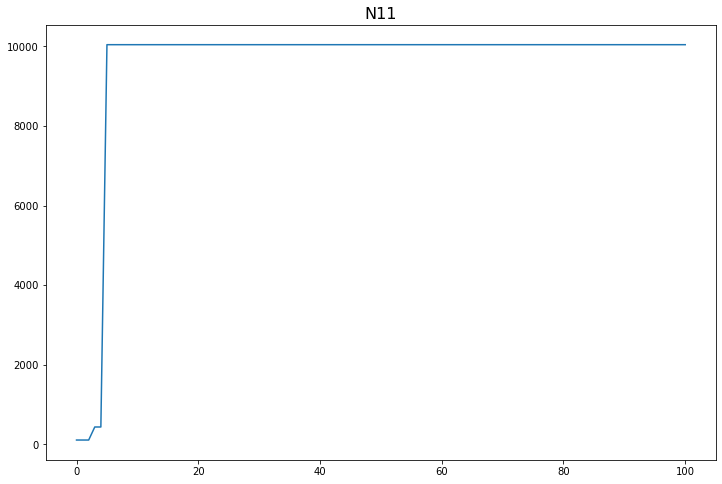

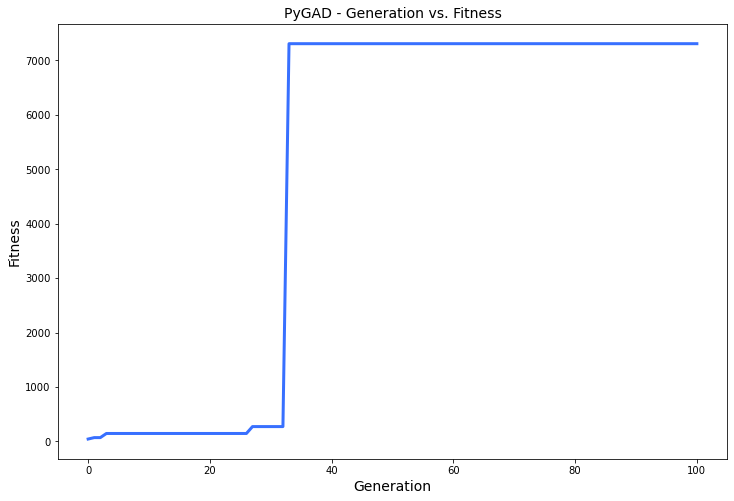

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 24.05 |==================| 1.859 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 24.424 |==================| 6.096 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 24.024 |==================| 1.773 |==========| N12 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 23.853 |==================| 1.361 |==========| N12 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 28.891 |==================| 13.309 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 28.843 |==================| 8.158 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 28.96 |==================| 157.343 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.547 |===========| 28.893 |==================| 13.752 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 28.932 |==================| 29.786 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 28.834 |==================| 7.573 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 28.919 |==================| 21.115 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 28.843 |==================| 8.127 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 28.866 |==================| 10.03 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 28.865 |==================| 9.908 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 28.832 |==================| 7.486 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 28.932 |==================| 29.786 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 28.898 |==================| 14.64 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 28.931 |==================| 28.181 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 28.929 |==================| 27.207 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.025 |===========| 28.963 |==================| 325.592 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 28.957 |==================| 116.591 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 28.95 |==================| 62.455 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.834 |===========| 28.85 |==================| 8.617 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 28.831 |==================| 7.389 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 28.943 |==================| 42.971 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 28.838 |==================| 7.801 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 28.924 |==================| 23.99 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 28.848 |==================| 8.445 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 28.936 |==================| 32.781 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 28.864 |==================| 9.833 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 28.954 |==================| 82.253 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 28.963 |==================| 288.521 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 28.962 |==================| 264.659 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 28.907 |==================| 16.794 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 28.859 |==================| 9.383 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 28.936 |==================| 32.781 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 28.953 |==================| 78.026 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 28.93 |==================| 28.063 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 28.958 |==================| 130.476 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 28.835 |==================| 7.605 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.054 |===========| 28.959 |==================| 151.23 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 28.876 |==================| 11.05 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 28.867 |==================| 10.075 |==========| N15 |==========
**********************************************************************
Generation = 4
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 28.854 |==================| 8.908 |==========| N15 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 28.94 |==================| 38.559 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 28.906 |==================| 16.683 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 28.937 |==================| 34.588 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 28.873 |==================| 10.769 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 28.956 |==================| 97.733 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 28.941 |==================| 39.643 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 28.937 |==================| 33.982 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 28.94 |==================| 38.559 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 28.909 |==================| 17.539 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 28.914 |==================| 19.239 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 28.879 |==================| 11.462 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 28.925 |==================| 24.346 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 28.965 |==================| 810.636 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 28.858 |==================| 9.227 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 28.868 |==================| 10.243 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 28.956 |==================| 100.583 |==========| N15 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 28.961 |==================| 181.16 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 28.856 |==================| 9.072 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 28.96 |==================| 158.56 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 28.953 |==================| 75.718 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 28.922 |==================| 22.927 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 28.838 |==================| 7.782 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.078 |===========| 28.957 |==================| 105.199 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 28.903 |==================| 15.866 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.793 |===========| 28.856 |==================| 9.114 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 28.908 |==================| 17.17 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 28.941 |==================| 39.869 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 28.84 |==================| 7.956 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 28.878 |==================| 11.307 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 28.964 |==================| 475.017 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 28.929 |==================| 26.967 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 28.848 |==================| 8.499 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.081 |===========| 28.956 |==================| 101.168 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 28.861 |==================| 9.485 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 28.875 |==================| 10.936 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 28.846 |==================| 8.32 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 28.949 |==================| 59.459 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 28.876 |==================| 11.16 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 28.89 |==================| 13.214 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 28.928 |==================| 26.362 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 28.877 |==================| 11.288 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 28.855 |==================| 8.998 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 28.876 |==================| 11.144 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 28.855 |==================| 9.026 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 28.864 |==================| 9.832 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 28.881 |==================| 11.714 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 28.93 |==================| 27.991 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 28.877 |==================| 11.288 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 28.856 |==================| 9.047 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 28.832 |==================| 7.461 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 28.916 |==================| 19.789 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.741 |===========| 28.864 |==================| 9.832 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 28.94 |==================| 38.017 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 28.959 |==================| 145.641 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 28.891 |==================| 13.299 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.981 |===========| 28.826 |==================| 7.16 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 28.954 |==================| 82.835 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 28.905 |==================| 16.395 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 28.884 |==================| 12.122 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 28.858 |==================| 9.24 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 28.916 |==================| 19.865 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.183 |===========| 28.943 |==================| 43.921 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.878 |===========| 28.843 |==================| 8.131 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 28.954 |==================| 82.835 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 28.884 |==================| 12.182 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 28.924 |==================| 23.732 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 28.954 |==================| 82.209 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 28.83 |==================| 7.329 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 28.918 |==================| 20.727 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 28.949 |==================| 59.374 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.633 |===========| 28.881 |==================| 11.716 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 28.913 |==================| 19.003 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 28.946 |==================| 50.088 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 28.901 |==================| 15.346 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 28.914 |==================| 19.205 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 28.827 |==================| 7.193 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 28.89 |==================| 13.182 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 28.827 |==================| 7.175 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 28.897 |==================| 14.56 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 28.891 |==================| 13.243 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 28.894 |==================| 13.897 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 28.933 |==================| 30.638 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.864 |===========| 28.845 |==================| 8.279 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.131 |===========| 28.95 |==================| 61.99 |==========| N15 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 28.826 |==================| 7.13 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.118 |===========| 28.952 |==================| 69.13 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 28.956 |==================| 94.808 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 28.882 |==================| 11.836 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 28.89 |==================| 13.204 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 28.893 |==================| 13.693 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 28.926 |==================| 25.075 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 28.836 |==================| 7.664 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 28.838 |==================| 7.839 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 28.892 |==================| 13.515 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.811 |===========| 28.854 |==================| 8.892 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 28.89 |==================| 13.204 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 28.853 |==================| 8.807 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 28.918 |==================| 20.74 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 28.906 |==================| 16.576 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 28.855 |==================| 9.033 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 28.945 |==================| 47.18 |==========| N15 |==========
**********************************************************************
Fitness = 1914.4941792185748
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 28.871 |==================| 10.552 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 28.894 |==================| 13.908 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 28.853 |==================| 8.807 |==========| N15 |==========
****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.249 |===========| 28.935 |==================| 31.849 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 28.946 |==================| 48.878 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 28.956 |==================| 97.99 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 28.836 |==================| 7.66 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 28.933 |==================| 30.346 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 28.827 |==================| 7.21 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 28.94 |==================| 38.551 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 28.917 |==================| 20.213 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 28.956 |==================| 100.239 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 28.825 |==================| 7.077 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 28.921 |==================| 22.294 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 28.933 |==================| 30.346 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 28.852 |==================| 8.781 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 28.961 |==================| 184.743 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 28.885 |==================| 12.394 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 28.956 |==================| 100.239 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 28.841 |==================| 7.99 |==========| N15 |==========
**********************************************************************
Generation = 15
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 28.865 |==================| 9.933 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 28.901 |==================| 15.355 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 28.87 |==================| 10.424 |==========| N15 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.916 |===========| 28.837 |==================| 7.74 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 28.847 |==================| 8.424 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 28.921 |==================| 22.273 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 28.89 |==================| 13.084 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 28.895 |==================| 14.02 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 28.896 |==================| 14.26 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 28.892 |==================| 13.484 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 28.92 |==================| 21.52 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 28.935 |==================| 32.433 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 28.859 |==================| 9.341 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 28.923 |==================| 23.208 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.751 |===========| 28.863 |==================| 9.69 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 28.94 |==================| 38.121 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.333 |===========| 28.923 |==================| 23.438 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 28.894 |==================| 13.914 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.245 |===========| 28.935 |==================| 32.433 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 28.843 |==================| 8.131 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 28.876 |==================| 11.163 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 28.892 |==================| 13.561 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 28.867 |==================| 10.127 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 28.933 |==================| 30.302 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 28.831 |==================| 7.397 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 28.92 |==================| 21.643 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.19 |===========| 28.942 |==================| 42.3 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 28.962 |==================| 251.949 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 28.921 |==================| 22.249 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 28.955 |==================| 91.585 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 28.952 |==================| 72.986 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 28.959 |==================| 139.816 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.63 |===========| 28.881 |==================| 11.778 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 28.828 |==================| 7.238 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.804 |===========| 28.855 |==================| 8.975 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 28.927 |==================| 25.438 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 28.838 |==================| 7.802 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 28.863 |==================| 9.666 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 28.839 |==================| 7.894 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 28.914 |==================| 19.26 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.034 |===========| 28.962 |==================| 246.411 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 28.885 |==================| 12.296 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 28.919 |==================| 21.253 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 28.898 |==================| 14.797 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 28.903 |==================| 15.927 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 28.959 |==================| 132.79 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 28.857 |==================| 9.191 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 28.929 |==================| 27.347 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 28.874 |==================| 10.878 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 28.869 |==================| 10.331 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 28.947 |==================| 51.281 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.639 |===========| 28.88 |==================| 11.6 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 28.917 |==================| 20.375 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 28.913 |==================| 18.755 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 28.852 |==================| 8.739 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 28.95 |==================| 64.23 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.112 |===========| 28.952 |==================| 72.431 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 28.935 |==================| 31.772 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 28.904 |==================| 16.088 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 28.934 |==================| 31.465 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 28.827 |==================| 7.185 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 28.933 |==================| 30.381 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 28.892 |==================| 13.565 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 28.932 |==================| 29.281 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 28.955 |==================| 88.855 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.803 |===========| 28.855 |==================| 8.987 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 28.847 |==================| 8.375 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 28.938 |==================| 35.252 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 28.895 |==================| 14.166 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.723 |===========| 28.867 |==================| 10.119 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.703 |===========| 28.87 |==================| 10.44 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 28.867 |==================| 10.134 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 28.897 |==================| 14.465 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 28.918 |==================| 20.635 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 28.93 |==================| 27.887 |==========| N15 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 28.854 |==================| 8.915 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 28.912 |==================| 18.355 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 28.904 |==================| 16.05 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 28.96 |==================| 163.32 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 28.951 |==================| 67.121 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 28.922 |==================| 22.753 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 28.909 |==================| 17.433 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.204 |===========| 28.941 |==================| 39.211 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 28.832 |==================| 7.484 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 28.91 |==================| 17.912 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 28.934 |==================| 31.295 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 28.896 |==================| 14.241 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 28.953 |==================| 76.238 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 28.9 |==================| 15.193 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 28.896 |==================| 14.351 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 28.903 |==================| 15.794 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 28.858 |==================| 9.267 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.768 |===========| 28.86 |==================| 9.455 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 28.95 |==================| 61.154 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 28.867 |==================| 10.142 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 28.884 |==================| 12.152 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 28.833 |==================| 7.511 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 28.895 |==================| 14.035 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 28.855 |==================| 9.012 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 28.874 |==================| 10.831 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.442 |===========| 28.908 |==================| 17.338 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.206 |===========| 28.94 |==================| 38.768 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 28.905 |==================| 16.34 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 28.854 |==================| 8.944 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 28.92 |==================| 21.631 |==========| N15 |==========
**********************************************************************
Fitness = 1914.4941792185748
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.555 |===========| 28.892 |==================| 13.55 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 28.93 |==================| 27.789 |==========| N15 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 28.932 |==================| 29.71 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 28.935 |==================| 32.53 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 28.848 |==================| 8.466 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 28.932 |==================| 29.167 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 28.878 |==================| 11.415 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 28.889 |==================| 12.961 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 28.839 |==================| 7.847 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 28.931 |==================| 28.715 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 28.924 |==================| 23.98 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.293 |===========| 28.929 |==================| 26.818 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.268 |===========| 28.932 |==================| 29.478 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 28.889 |==================| 12.987 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 28.919 |==================| 21.066 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 28.966 |==================| 2519.092 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 28.92 |==================| 21.733 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 28.879 |==================| 11.491 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 28.904 |==================| 16.02 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 28.83 |==================| 7.339 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 28.848 |==================| 8.482 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 28.962 |==================| 238.373 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.151 |===========| 28.947 |==================| 53.359 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 28.886 |==================| 12.438 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.352 |===========| 28.921 |==================| 22.136 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 28.859 |==================| 9.32 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 28.825 |==================| 7.113 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 28.854 |==================| 8.933 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 28.925 |==================| 24.638 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 28.903 |==================| 15.831 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 28.866 |==================| 10.024 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 28.935 |==================| 32.064 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 28.943 |==================| 43.031 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 28.882 |==================| 11.909 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 28.944 |==================| 45.539 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 28.828 |==================| 7.234 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 28.865 |==================| 9.904 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 28.902 |==================| 15.664 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 28.831 |==================| 7.427 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 28.891 |==================| 13.384 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 28.943 |==================| 44.006 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 28.844 |==================| 8.223 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 28.881 |==================| 11.693 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 28.834 |==================| 7.584 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 28.913 |==================| 18.99 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 28.835 |==================| 7.637 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 28.888 |==================| 12.85 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 28.906 |==================| 16.606 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 28.844 |==================| 8.17 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.738 |===========| 28.865 |==================| 9.885 |==========| N15 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.367 |===========| 28.919 |==================| 21.151 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.062 |===========| 28.959 |==================| 132.595 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 28.938 |==================| 35.184 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 28.888 |==================| 12.85 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 28.94 |==================| 38.288 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.652 |===========| 28.878 |==================| 11.342 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 28.844 |==================| 8.218 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 28.843 |==================| 8.115 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.707 |===========| 28.87 |==================| 10.376 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 28.915 |==================| 19.626 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 28.958 |==================| 128.496 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 28.94 |==================| 38.288 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.872 |===========| 28.844 |==================| 8.185 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 28.897 |==================| 14.491 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 28.936 |==================| 33.213 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.812 |===========| 28.853 |==================| 8.875 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 28.929 |==================| 27.004 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 28.86 |==================| 9.429 |==========| N15 |==========
**********************************************************************
Fitness = 2519.09248267911
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 28.92 |==================| 21.577 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 28.929 |==================| 27.045 |==========| N15 |==========
*********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 28.855 |==================| 8.997 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 28.959 |==================| 142.596 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 28.833 |==================| 7.49 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.291 |===========| 28.929 |==================| 27.004 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 28.941 |==================| 40.601 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 28.93 |==================| 27.744 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 28.828 |==================| 7.247 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 28.947 |==================| 51.591 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 28.91 |==================| 17.718 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 28.913 |==================| 18.873 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.082 |===========| 28.956 |==================| 100.263 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.197 |===========| 28.941 |==================| 40.601 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 28.875 |==================| 10.937 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 28.941 |==================| 39.577 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 28.878 |==================| 11.362 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 28.873 |==================| 10.73 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 28.869 |==================| 10.319 |==========| N15 |==========
**********************************************************************
Generation = 32
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 28.882 |==================| 11.894 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 28.943 |==================| 44.137 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 28.886 |==================| 12.49 |==========| N15 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 28.883 |==================| 11.999 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 28.838 |==================| 7.832 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 28.965 |==================| 684.587 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 28.869 |==================| 10.319 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.397 |===========| 28.915 |==================| 19.442 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 28.925 |==================| 24.505 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.278 |===========| 28.931 |==================| 28.381 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 28.958 |==================| 122.244 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 28.938 |==================| 35.928 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.893 |===========| 28.841 |==================| 7.973 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 28.832 |==================| 7.452 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 28.884 |==================| 12.118 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 28.921 |==================| 22.059 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 28.916 |==================| 19.854 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 28.896 |==================| 14.366 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 28.938 |==================| 35.928 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 28.834 |==================| 7.552 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 28.905 |==================| 16.477 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 28.893 |==================| 13.732 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 28.963 |==================| 366.176 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 28.912 |==================| 18.645 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 28.91 |==================| 17.852 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.287 |===========| 28.93 |==================| 27.497 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 28.955 |==================| 90.804 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 28.922 |==================| 22.952 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.095 |===========| 28.954 |==================| 86.056 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 28.83 |==================| 7.337 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 28.912 |==================| 18.645 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 28.918 |==================| 20.866 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 28.867 |==================| 10.141 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.685 |===========| 28.873 |==================| 10.738 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.489 |===========| 28.902 |==================| 15.55 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 28.943 |==================| 43.084 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 28.827 |==================| 7.169 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.074 |===========| 28.957 |==================| 110.581 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 28.879 |==================| 11.452 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.917 |===========| 28.837 |==================| 7.736 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 28.942 |==================| 41.275 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 28.953 |==================| 79.336 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 28.845 |==================| 8.27 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 28.844 |==================| 8.165 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 28.859 |==================| 9.374 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 28.913 |==================| 18.927 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.693 |===========| 28.872 |==================| 10.607 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 28.951 |==================| 64.481 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 28.85 |==================| 8.629 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 28.952 |==================| 71.74 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 28.844 |==================| 8.165 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 28.827 |==================| 7.215 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 28.902 |==================| 15.649 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 28.871 |==================| 10.533 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 28.825 |==================| 7.079 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 28.882 |==================| 11.903 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 28.943 |==================| 43.631 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 28.875 |==================| 10.942 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 28.934 |==================| 31.434 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.157 |===========| 28.947 |==================| 51.337 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 28.924 |==================| 23.642 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 28.927 |==================| 25.682 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.483 |===========| 28.903 |==================| 15.769 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.139 |===========| 28.949 |==================| 58.187 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 28.907 |==================| 16.986 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 28.925 |==================| 24.169 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.406 |===========| 28.913 |==================| 19.006 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 28.83 |==================| 7.338 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 28.882 |==================| 11.934 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 28.9 |==================| 15.202 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 28.943 |==================| 43.41 |==========| N15 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 28.901 |==================| 15.37 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 28.922 |==================| 22.805 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 28.947 |==================| 51.599 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 28.948 |==================| 56.529 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 28.944 |==================| 45.364 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 28.945 |==================| 47.079 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 28.888 |==================| 12.892 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 28.937 |==================| 34.015 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 28.853 |==================| 8.814 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 28.853 |==================| 8.831 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 28.939 |==================| 37.394 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.577 |===========| 28.889 |==================| 12.97 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.164 |===========| 28.946 |==================| 49.211 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 28.872 |==================| 10.679 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 28.889 |==================| 13.046 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.817 |===========| 28.853 |==================| 8.814 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 28.928 |==================| 26.053 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 28.828 |==================| 7.261 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 28.91 |==================| 17.868 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 28.919 |==================| 21.087 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 28.951 |==================| 66.245 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 28.917 |==================| 20.238 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 28.961 |==================| 215.536 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 28.928 |==================| 26.053 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 28.965 |==================| 1401.38 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 28.955 |==================| 91.211 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 28.96 |==================| 155.726 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 28.951 |==================| 66.245 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 28.945 |==================| 46.818 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 28.884 |==================| 12.144 |==========| N15 |==========
**********************************************************************
Generation = 41
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 28.961 |==================| 194.896 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 28.926 |==================| 24.835 |==========| N15 |==========
**************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 28.854 |==================| 8.932 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 28.932 |==================| 29.632 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.829 |==================| 7.302 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 28.945 |==================| 46.818 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.017 |===========| 28.964 |==================| 473.887 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 28.963 |==================| 321.813 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 28.929 |==================| 27.32 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.533 |===========| 28.895 |==================| 14.152 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 28.879 |==================| 11.481 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.524 |===========| 28.897 |==================| 14.431 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 28.863 |==================| 9.677 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 28.964 |==================| 416.153 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.829 |==================| 7.301 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.314 |===========| 28.926 |==================| 24.939 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 28.963 |==================| 301.789 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 28.964 |==================| 448.228 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 28.905 |==================| 16.413 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 28.933 |==================| 29.885 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 28.947 |==================| 53.147 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.381 |===========| 28.917 |==================| 20.319 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 28.877 |==================| 11.18 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 28.91 |==================| 17.891 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 28.832 |==================| 7.472 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.233 |===========| 28.937 |==================| 34.205 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 28.922 |==================| 22.796 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 28.831 |==================| 7.426 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 28.869 |==================| 10.308 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.405 |===========| 28.914 |==================| 19.061 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 28.932 |==================| 29.425 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 28.832 |==================| 7.486 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 28.851 |==================| 8.725 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 28.952 |==================| 70.929 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 28.859 |==================| 9.307 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 28.927 |==================| 25.341 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 28.902 |==================| 15.582 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 28.932 |==================| 29.425 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 28.942 |==================| 41.405 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 28.849 |==================| 8.527 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 28.893 |==================| 13.661 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 28.859 |==================| 9.307 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 28.941 |==================| 40.362 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 28.937 |==================| 33.941 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 28.859 |==================| 9.383 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 28.868 |==================| 10.205 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 28.96 |==================| 160.882 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 28.872 |==================| 10.68 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 28.884 |==================| 12.21 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 28.9 |==================| 15.15 |==========| N15 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 28.847 |==================| 8.428 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.938 |===========| 28.833 |==================| 7.54 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 28.834 |==================| 7.545 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.051 |===========| 28.96 |==================| 160.882 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 28.852 |==================| 8.772 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.363 |===========| 28.919 |==================| 21.381 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 28.908 |==================| 17.086 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 28.863 |==================| 9.709 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 28.964 |==================| 598.349 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 28.882 |==================| 11.947 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.059 |===========| 28.959 |==================| 139.666 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 28.853 |==================| 8.807 |==========| N15 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 28.846 |==================| 8.361 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 28.934 |==================| 31.183 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 28.941 |==================| 40.373 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.222 |===========| 28.938 |==================| 35.879 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 28.913 |==================| 18.947 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 28.862 |==================| 9.618 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 28.951 |==================| 65.546 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 28.915 |==================| 19.632 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 28.952 |==================| 73.313 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 28.853 |==================| 8.852 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 28.933 |==================| 30.431 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 28.913 |==================| 18.947 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 28.833 |==================| 7.497 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 28.937 |==================| 34.958 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 28.962 |==================| 223.208 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 28.869 |==================| 10.34 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 28.965 |==================| 1510.961 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 28.869 |==================| 10.288 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.863 |===========| 28.845 |==================| 8.281 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 28.843 |==================| 8.106 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 28.932 |==================| 29.295 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.002 |===========| 28.966 |==================| 3820.678 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.77 |===========| 28.86 |==================| 9.418 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 28.83 |==================| 7.348 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 28.896 |==================| 14.231 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 28.931 |==================| 28.212 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 28.933 |==================| 30.526 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 28.867 |==================| 10.131 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 28.957 |==================| 108.449 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 28.829 |==================| 7.313 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 28.948 |==================| 54.603 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 28.89 |==================| 13.081 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 28.879 |==================| 11.438 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 28.958 |==================| 117.711 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 28.827 |==================| 7.192 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 28.875 |==================| 10.984 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 28.829 |==================| 7.299 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 28.906 |==================| 16.663 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 28.887 |==================| 12.7 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 28.931 |==================| 28.599 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 28.936 |==================| 33.283 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.288 |===========| 28.929 |==================| 27.349 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 28.924 |==================| 23.548 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 28.957 |==================| 116.528 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 28.893 |==================| 13.703 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 28.956 |==================| 95.3 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 28.899 |==================| 14.945 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 28.84 |==================| 7.912 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 28.866 |==================| 10.029 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 28.916 |==================| 19.836 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.617 |===========| 28.883 |==================| 12.05 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 28.846 |==================| 8.313 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 28.894 |==================| 13.963 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 28.95 |==================| 60.981 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.392 |===========| 28.915 |==================| 19.7 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 28.899 |==================| 14.852 |==========| N15 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 28.83 |==================| 7.361 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 28.922 |==================| 22.626 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 28.91 |==================| 17.799 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 28.892 |==================| 13.457 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 28.902 |==================| 15.725 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 28.853 |==================| 8.807 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 28.859 |==================| 9.335 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 28.855 |==================| 9.042 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 28.936 |==================| 32.991 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 28.846 |==================| 8.328 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 28.941 |==================| 39.424 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 28.902 |==================| 15.725 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 28.9 |==================| 15.206 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 28.892 |==================| 13.525 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 28.945 |==================| 47.881 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 28.927 |==================| 25.63 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 28.866 |==================| 9.974 |==========| N15 |==========
**********************************************************************
Fitness = 5348.916113527094
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 28.884 |==================| 12.26 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 28.93 |==================| 27.783 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.499 |===========| 28.9 |==================| 15.206 |==========| N15 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.408 |===========| 28.913 |==================| 18.911 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.311 |===========| 28.926 |==================| 25.251 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 28.922 |==================| 22.939 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.727 |===========| 28.867 |==================| 10.052 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 28.94 |==================| 38.02 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 28.84 |==================| 7.957 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 28.928 |==================| 26.086 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 28.862 |==================| 9.653 |==========| N15 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 28.861 |==================| 9.536 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 28.933 |==================| 30.501 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 28.914 |==================| 19.211 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 28.94 |==================| 38.02 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 28.858 |==================| 9.27 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.774 |===========| 28.859 |==================| 9.375 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 28.916 |==================| 20.016 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 28.853 |==================| 8.826 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 28.875 |==================| 11.016 |==========| N15 |==========
**********************************************************************
Generation = 55
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.123 |===========| 28.951 |==================| 66.011 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.573 |===========| 28.89 |==================| 13.076 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 28.855 |==================| 9.038 |==========| N15 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 28.95 |==================| 61.534 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 28.896 |==================| 14.286 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 28.858 |==================| 9.24 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 28.912 |==================| 18.493 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 28.902 |==================| 15.617 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 28.852 |==================| 8.786 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 28.946 |==================| 49.434 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 28.912 |==================| 18.484 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 28.892 |==================| 13.467 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.313 |===========| 28.926 |==================| 25.019 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.933 |===========| 28.834 |==================| 7.581 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 28.943 |==================| 43.474 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 28.954 |==================| 84.743 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 28.922 |==================| 22.749 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.238 |===========| 28.936 |==================| 33.451 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 28.879 |==================| 11.477 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 28.942 |==================| 40.959 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 28.927 |==================| 25.749 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 28.945 |==================| 47.799 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 28.862 |==================| 9.592 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 28.889 |==================| 13.016 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 28.944 |==================| 44.967 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.567 |===========| 28.89 |==================| 13.221 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 28.962 |==================| 235.033 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 28.894 |==================| 13.823 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.8 |===========| 28.855 |==================| 9.032 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 28.933 |==================| 30.233 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 28.861 |==================| 9.483 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 28.83 |==================| 7.35 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 28.951 |==================| 66.893 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 28.842 |==================| 8.04 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 28.827 |==================| 7.198 |==========| N15 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.279 |===========| 28.931 |==================| 28.274 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.437 |===========| 28.909 |==================| 17.545 |==========| N15 |==========
**********************************************************************
Fitness = 5348.916113527094
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.17 |===========| 28.945 |==================| 47.31 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 28.944 |==================| 45.527 |==========| N15 |==========
*****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 28.884 |==================| 12.22 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 28.957 |==================| 106.52 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 28.828 |==================| 7.239 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 28.877 |==================| 11.275 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 28.869 |==================| 10.266 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 28.855 |==================| 9.042 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 28.848 |==================| 8.487 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 28.824 |==================| 7.031 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 28.927 |==================| 25.43 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 28.916 |==================| 20.121 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.46 |===========| 28.906 |==================| 16.594 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 28.838 |==================| 7.798 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.153 |===========| 28.947 |==================| 52.759 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 28.928 |==================| 26.286 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.889 |===========| 28.841 |==================| 8.017 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 28.927 |==================| 25.43 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.859 |===========| 28.846 |==================| 8.326 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 28.938 |==================| 35.812 |==========| N15 |==========
**********************************************************************
Generation = 60
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.854 |===========| 28.847 |==================| 8.387 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.576 |===========| 28.889 |==================| 13.007 |==========| N15 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 28.914 |==================| 19.389 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 28.933 |==================| 29.966 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 28.909 |==================| 17.484 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.344 |===========| 28.922 |==================| 22.68 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 28.872 |==================| 10.619 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.99 |===========| 28.825 |==================| 7.083 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 28.964 |==================| 401.801 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.175 |===========| 28.944 |==================| 45.96 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 28.893 |==================| 13.746 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 28.851 |==================| 8.709 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 28.959 |==================| 148.738 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 28.85 |==================| 8.601 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 28.963 |==================| 292.622 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 28.835 |==================| 7.62 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 28.918 |==================| 20.868 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 28.893 |==================| 13.746 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.691 |===========| 28.872 |==================| 10.63 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 28.836 |==================| 7.678 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 28.841 |==================| 8.022 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.264 |===========| 28.933 |==================| 29.93 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 28.898 |==================| 14.717 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 28.936 |==================| 33.307 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 28.886 |==================| 12.478 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 28.898 |==================| 14.662 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 28.896 |==================| 14.18 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 28.894 |==================| 13.968 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 28.857 |==================| 9.198 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.514 |===========| 28.898 |==================| 14.717 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 28.911 |==================| 18.162 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 28.958 |==================| 128.598 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 28.926 |==================| 24.831 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 28.955 |==================| 88.799 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 28.829 |==================| 7.289 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 28.857 |==================| 9.171 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 28.832 |==================| 7.475 |==========| N15 |==========
**********************************************************************
Fitness = 5348.916113527094
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 28.861 |==================| 9.522 |==========| N15 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 28.9 |==================| 15.082 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 28.88 |==================| 11.634 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 28.898 |==================| 14.625 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.966 |===========| 28.829 |==================| 7.289 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 28.859 |==================| 9.384 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 28.861 |==================| 9.492 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 28.872 |==================| 10.652 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 28.84 |==================| 7.954 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 28.934 |==================| 31.169 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 28.863 |==================| 9.664 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 28.825 |==================| 7.075 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 28.841 |==================| 8.021 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 28.937 |==================| 34.572 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 28.956 |==================| 96.499 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 28.837 |==================| 7.76 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.335 |===========| 28.923 |==================| 23.278 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 28.93 |==================| 28.003 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 28.936 |==================| 33.528 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 28.959 |==================| 140.833 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 28.839 |==================| 7.894 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 28.953 |==================| 75.512 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.474 |===========| 28.904 |==================| 16.063 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 28.916 |==================| 19.897 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 28.904 |==================| 16.051 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 28.931 |==================| 28.862 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 28.877 |==================| 11.174 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 28.867 |==================| 10.074 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 28.943 |==================| 42.741 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 28.934 |==================| 31.296 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 28.927 |==================| 25.643 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.068 |===========| 28.958 |==================| 120.741 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 28.884 |==================| 12.117 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 28.859 |==================| 9.356 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 28.943 |==================| 42.76 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.858 |===========| 28.846 |==================| 8.346 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 28.962 |==================| 262.745 |==========| N15 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.526 |===========| 28.896 |==================| 14.347 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 28.917 |==================| 20.43 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 28.91 |==================| 17.754 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 28.916 |==================| 19.843 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 28.828 |==================| 7.264 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 28.946 |==================| 50.597 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 28.825 |==================| 7.113 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 28.923 |==================| 23.147 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 28.96 |==================| 170.618 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 28.838 |==================| 7.814 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 28.927 |==================| 25.695 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 28.828 |==================| 7.264 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 28.846 |==================| 8.311 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.459 |===========| 28.906 |==================| 16.657 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 28.955 |==================| 90.612 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 28.92 |==================| 21.712 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 28.829 |==================| 7.313 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.747 |===========| 28.863 |==================| 9.75 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 28.95 |==================| 62.913 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 28.846 |==================| 8.311 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.456 |===========| 28.906 |==================| 16.755 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 28.857 |==================| 9.2 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 28.898 |==================| 14.623 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 28.957 |==================| 108.088 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 28.942 |==================| 40.83 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 28.869 |==================| 10.288 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 28.854 |==================| 8.947 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 28.945 |==================| 47.701 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 28.861 |==================| 9.532 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 28.92 |==================| 21.796 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 28.959 |==================| 137.469 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 28.942 |==================| 40.83 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 28.95 |==================| 63.104 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 28.831 |==================| 7.422 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.612 |===========| 28.884 |==================| 12.172 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 28.962 |==================| 237.702 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 28.929 |==================| 26.709 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.715 |===========| 28.868 |==================| 10.24 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 28.84 |==================| 7.956 |==========| N15 |==========
**********************************************************************
Generation = 70
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 28.946 |==================| 50.502 |==========| N15 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 28.882 |==================| 11.933 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 28.953 |==================| 74.354 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.957 |===========| 28.83 |==================| 7.362 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 28.929 |==================| 26.709 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 28.962 |==================| 220.918 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 28.854 |==================| 8.919 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 28.928 |==================| 26.163 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 28.835 |==================| 7.658 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 28.859 |==================| 9.358 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 28.838 |==================| 7.796 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 28.842 |==================| 8.029 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 28.923 |==================| 23.418 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.899 |===========| 28.84 |==================| 7.914 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 28.884 |==================| 12.155 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.775 |===========| 28.859 |==================| 9.358 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 28.838 |==================| 7.796 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 28.91 |==================| 17.982 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 28.936 |==================| 33.163 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 28.922 |==================| 22.728 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 28.898 |==================| 14.683 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 28.881 |==================| 11.747 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 28.831 |==================| 7.417 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 28.895 |==================| 13.984 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 28.917 |==================| 20.196 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.01 |===========| 28.965 |==================| 853.627 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 28.884 |==================| 12.257 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.595 |===========| 28.886 |==================| 12.552 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.884 |===========| 28.842 |==================| 8.067 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.665 |===========| 28.876 |==================| 11.102 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 28.878 |==================| 11.391 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 28.926 |==================| 24.781 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 28.941 |==================| 39.765 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 28.919 |==================| 21.283 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 28.884 |==================| 12.259 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.393 |===========| 28.915 |==================| 19.676 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 28.838 |==================| 7.838 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.292 |===========| 28.929 |==================| 26.907 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 28.869 |==================| 10.333 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.076 |===========| 28.957 |==================| 107.431 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 28.919 |==================| 21.283 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 28.961 |==================| 184.91 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 28.915 |==================| 19.427 |==========| N15 |==========
**********************************************************************
Generation = 74
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 28.883 |==================| 12.031 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 28.855 |==================| 9.018 |==========| N15 |==========
****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 28.932 |==================| 29.187 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 28.935 |==================| 31.982 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 28.961 |==================| 184.91 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 28.915 |==================| 19.427 |==========| N15 |==========
*******************************************************************

======| 0.212 |===========| 28.94 |==================| 37.737 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 28.885 |==================| 12.268 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 28.871 |==================| 10.545 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 28.861 |==================| 9.537 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.971 |===========| 28.828 |==================| 7.243 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 28.958 |==================| 127.001 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 28.855 |==================| 9.004 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 28.93 |==================| 27.731 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.946 |===========| 28.832 |==================| 7.462 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 28.854 |==================| 8.918 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 28.833 |==================| 7.491 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 28.846 |==================| 8.319 |==========| N15 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 28.96 |==================| 170.621 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 28.883 |==================| 12.007 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.012 |===========| 28.965 |==================| 683.666 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 28.851 |==================| 8.703 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 28.928 |==================| 26.344 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 28.917 |==================| 20.465 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.246 |===========| 28.935 |==================| 32.263 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.599 |===========| 28.886 |==================| 12.464 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.829 |==================| 7.304 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 28.96 |==================| 176.31 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 28.823 |==================| 7.0 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 28.928 |==================| 26.344 |==========| N15 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 28.858 |==================| 9.239 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 28.896 |==================| 14.212 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 28.886 |==================| 12.493 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 28.841 |==================| 8.026 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 28.94 |==================| 37.862 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 28.89 |==================| 13.094 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.444 |===========| 28.908 |==================| 17.261 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.031 |===========| 28.962 |==================| 269.142 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.47 |===========| 28.904 |==================| 16.237 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 28.874 |==================| 10.809 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.211 |===========| 28.94 |==================| 37.862 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.572 |===========| 28.89 |==================| 13.094 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 28.834 |==================| 7.599 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.902 |===========| 28.839 |==================| 7.882 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.102 |===========| 28.954 |==================| 79.861 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 28.888 |==================| 12.854 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 28.916 |==================| 19.893 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.176 |===========| 28.944 |==================| 45.728 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.394 |===========| 28.915 |==================| 19.59 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 28.963 |==================| 281.888 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.223 |===========| 28.938 |==================| 35.756 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 28.874 |==================| 10.816 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 28.882 |==================| 11.921 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.423 |===========| 28.911 |==================| 18.18 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 28.885 |==================| 12.381 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.724 |===========| 28.867 |==================| 10.096 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 28.875 |==================| 11.038 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 28.902 |==================| 15.686 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 28.943 |==================| 42.604 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 28.872 |==================| 10.665 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 28.947 |==================| 52.194 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 28.885 |==================| 12.381 |==========| N15 |==========
******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 28.84 |==================| 7.952 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 28.899 |==================| 14.865 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.948 |===========| 28.832 |==================| 7.448 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 28.886 |==================| 12.529 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 28.917 |==================| 20.211 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.201 |===========| 28.941 |==================| 39.747 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.309 |===========| 28.927 |==================| 25.408 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 28.825 |==================| 7.096 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 28.897 |==================| 14.558 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 28.908 |==================| 17.175 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 28.905 |==================| 16.501 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.383 |===========| 28.917 |==================| 20.211 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 28.936 |==================| 33.073 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 28.894 |==================| 13.826 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 28.86 |==================| 9.412 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 28.938 |==================| 35.55 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 28.951 |==================| 65.412 |==========| N15 |==========
**********************************************************************
Fitness = 5348.916113527094
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 28.863 |==================| 9.724 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 28.828 |==================| 7.227 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 28.849 |==================| 8.509 |==========| N15 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 28.867 |==================| 10.13 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 28.92 |==================| 21.603 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 28.877 |==================| 11.222 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 28.951 |==================| 65.412 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 28.931 |==================| 28.456 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 28.926 |==================| 25.103 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 28.921 |==================| 22.238 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 28.853 |==================| 8.834 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 28.934 |==================| 31.22 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 28.906 |==================| 16.565 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 28.839 |==================| 7.9 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.277 |===========| 28.931 |==================| 28.456 |==========| N15 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 28.911 |==================| 18.308 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 28.954 |==================| 84.703 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 28.835 |==================| 7.659 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 28.844 |==================| 8.162 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 28.919 |==================| 21.247 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 28.91 |==================| 17.924 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 28.863 |==================| 9.664 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 28.923 |==================| 23.2 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 28.883 |==================| 11.994 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 28.904 |==================| 16.05 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 28.919 |==================| 21.247 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.429 |===========| 28.91 |==================| 17.924 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 28.888 |==================| 12.734 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 28.84 |==================| 7.952 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.327 |===========| 28.924 |==================| 23.929 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 28.825 |==================| 7.094 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 28.893 |==================| 13.674 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 28.829 |==================| 7.279 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 28.899 |==================| 14.916 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 28.836 |==================| 7.697 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 28.956 |==================| 96.514 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.643 |===========| 28.879 |==================| 11.514 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.829 |==================| 7.301 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 28.893 |==================| 13.674 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 28.952 |==================| 71.578 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.272 |===========| 28.932 |==================| 29.052 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.979 |===========| 28.827 |==================| 7.178 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 28.829 |==================| 7.304 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 28.933 |==================| 29.876 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 28.864 |==================| 9.809 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 28.91 |==================| 17.971 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 28.9 |==================| 15.125 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 28.836 |==================| 7.661 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 28.932 |==================| 29.366 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 28.964 |==================| 553.318 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 28.852 |==================| 8.775 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 28.868 |==================| 10.213 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 28.914 |==================| 19.105 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 28.825 |==================| 7.072 |==========| N15 |==========
**********************************************************************
Generation = 86
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 28.954 |==================| 83.376 |==========| N15 |==========
****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 28.902 |==================| 15.653 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 28.858 |==================| 9.263 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 28.871 |==================| 10.509 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 28.868 |==================| 10.213 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 28.874 |==================| 10.893 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 28.885 |==================| 12.305 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 28.863 |==================| 9.726 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.417 |===========| 28.912 |==================| 18.461 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 28.94 |==================| 38.655 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.065 |===========| 28.958 |==================| 127.024 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 28.852 |==================| 8.77 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.932 |===========| 28.834 |==================| 7.593 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 28.927 |==================| 25.682 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 28.962 |==================| 246.692 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.1 |===========| 28.954 |==================| 81.55 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 28.94 |==================| 38.655 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 28.841 |==================| 7.965 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.04 |===========| 28.961 |==================| 207.85 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.073 |===========| 28.957 |==================| 112.483 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.993 |===========| 28.824 |==================| 7.059 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 28.869 |==================| 10.339 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 28.928 |==================| 26.453 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 28.921 |==================| 22.254 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 28.896 |==================| 14.329 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 28.908 |==================| 17.366 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 28.902 |==================| 15.625 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 28.944 |==================| 44.609 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 28.921 |==================| 22.036 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.25 |===========| 28.934 |==================| 31.668 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 28.843 |==================| 8.158 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 28.933 |==================| 30.227 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 28.902 |==================| 15.608 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 28.842 |==================| 8.041 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 28.872 |==================| 10.624 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 28.937 |==================| 33.841 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 28.93 |==================| 27.687 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.372 |===========| 28.918 |==================| 20.878 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.435 |===========| 28.909 |==================| 17.659 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 28.92 |==================| 21.482 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.199 |===========| 28.941 |==================| 40.193 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 28.92 |==================| 21.915 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 28.863 |==================| 9.672 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 28.952 |==================| 71.086 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 28.925 |==================| 24.63 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 28.928 |==================| 25.942 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 28.893 |==================| 13.678 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 28.91 |==================| 17.783 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.582 |===========| 28.888 |==================| 12.857 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 28.829 |==================| 7.278 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 28.854 |==================| 8.927 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 28.94 |==================| 38.315 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.303 |===========| 28.928 |==================| 25.942 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 28.931 |==================| 28.562 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.374 |===========| 28.918 |==================| 20.742 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 28.964 |==================| 608.605 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.217 |===========| 28.939 |==================| 36.731 |==========| N15 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 28.833 |==================| 7.53 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 28.963 |==================| 390.415 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 28.902 |==================| 15.52 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.125 |===========| 28.951 |==================| 64.848 |==========| N15 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 28.921 |==================| 22.08 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.32 |===========| 28.925 |==================| 24.462 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.402 |===========| 28.914 |==================| 19.203 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.939 |===========| 28.833 |==================| 7.53 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 28.841 |==================| 7.99 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.243 |===========| 28.935 |==================| 32.712 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 28.941 |==================| 39.347 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 28.838 |==================| 7.808 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 28.914 |==================| 19.295 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.485 |===========| 28.902 |==================| 15.678 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 28.955 |==================| 93.473 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.677 |===========| 28.874 |==================| 10.875 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 28.908 |==================| 17.144 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 28.93 |==================| 27.972 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.465 |===========| 28.905 |==================| 16.43 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 28.962 |==================| 250.371 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 28.905 |==================| 16.452 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 28.88 |==================| 11.643 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 28.856 |==================| 9.052 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 28.898 |==================| 14.624 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.015 |===========| 28.964 |==================| 569.673 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 28.915 |==================| 19.514 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 28.905 |==================| 16.452 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 28.88 |==================| 11.643 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 28.916 |==================| 20.169 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 28.926 |==================| 24.854 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 28.952 |==================| 71.377 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 28.944 |==================| 45.08 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 28.959 |==================| 142.564 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.953 |===========| 28.831 |==================| 7.403 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 28.898 |==================| 14.791 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.384 |===========| 28.916 |==================| 20.169 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 28.88 |==================| 11.637 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.28 |===========| 28.931 |==================| 28.158 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 28.827 |==================| 7.18 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 28.959 |==================| 142.564 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 28.897 |==================| 14.554 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 28.851 |==================| 8.713 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 28.881 |==================| 11.798 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 28.923 |==================| 23.032 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.737 |===========| 28.865 |==================| 9.894 |==========| N15 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 28.92 |==================| 21.675 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.159 |===========| 28.946 |==================| 50.883 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.52 |===========| 28.897 |==================| 14.554 |==========| N15 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 28.896 |==================| 14.241 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 28.924 |==================| 23.735 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 28.879 |==================| 11.496 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 28.85 |==================| 8.634 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.487 |===========| 28.902 |==================| 15.61 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 28.942 |==================| 41.083 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.763 |===========| 28.861 |==================| 9.517 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 28.909 |==================| 17.438 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.709 |===========| 28.869 |==================| 10.335 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.857 |===========| 28.846 |==================| 8.351 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 28.878 |==================| 11.335 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 28.952 |==================| 70.728 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 28.831 |==================| 7.41 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.596 |===========| 28.886 |==================| 12.523 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.631 |===========| 28.881 |==================| 11.762 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 28.935 |==================| 31.998 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 28.958 |==================| 130.03 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 28.902 |==================| 15.571 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 28.9 |==================| 15.116 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 28.852 |==================| 8.738 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.914 |===========| 28.837 |==================| 7.761 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.256 |===========| 28.934 |==================| 30.901 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 28.961 |==================| 182.147 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 28.958 |==================| 130.03 |==========| N15 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 28.881 |==================| 11.799 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 28.938 |==================| 35.26 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 28.872 |==================| 10.646 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 28.926 |==================| 24.719 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 28.888 |==================| 12.836 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 28.894 |==================| 13.856 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 28.869 |==================| 10.252 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.488 |===========| 28.902 |==================| 15.59 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.571 |===========| 28.89 |==================| 13.129 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 28.854 |==================| 8.945 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 28.824 |==================| 7.041 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 28.888 |==================| 12.836 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 28.83 |==================| 7.348 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.114 |===========| 28.952 |==================| 71.202 |==========| N15 |==========
**********************************************************************
Generation = 99
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 28.913 |==================| 18.766 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 28.947 |==================| 52.313 |==========| N15 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 28.948 |==================| 56.496 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 28.962 |==================| 255.659 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.698 |===========| 28.871 |==================| 10.515 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.836 |===========| 28.85 |==================| 8.588 |==========| N15 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 28.856 |==================| 9.048 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 28.836 |==================| 7.677 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 28.946 |==================| 49.547 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.254 |===========| 28.934 |==================| 31.186 |==========| N15 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 28.89 |==================| 13.201 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.091 |===========| 28.955 |==================| 90.041 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.205 |===========| 28.94 |==================| 39.022 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.923 |===========| 28.836 |==================| 7.677 |==========| N15 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 28.893 |==================| 13.68 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 28.908 |==================| 17.112 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 28.828 |==================| 7.226 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 28.89 |==================| 13.201 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 28.961 |==================| 180.627 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 28.824 |==================| 7.02 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 28.87 |==================| 10.423 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 28.827 |==================| 7.201 |==========| N15 |==========
**********************************************************************

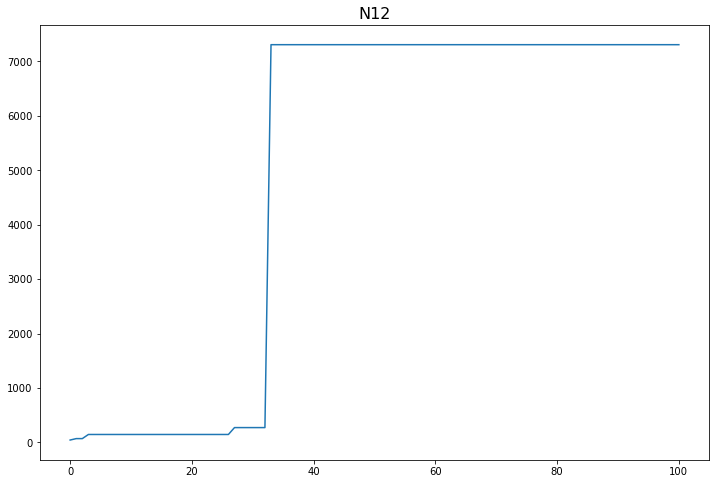

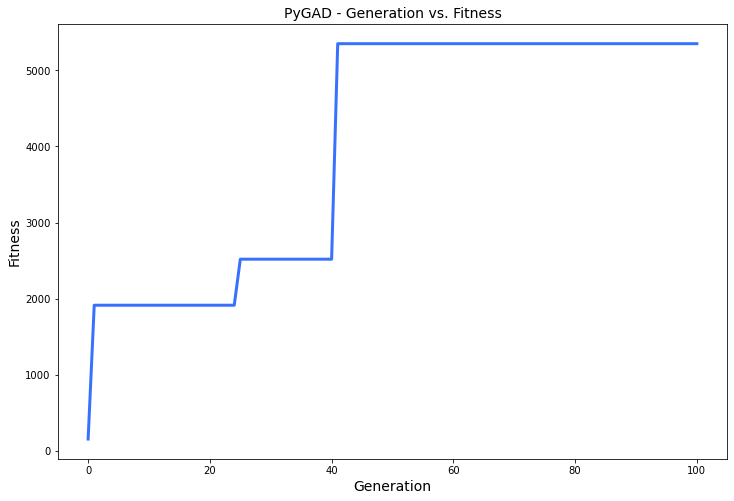

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.998 |===========| 28.824 |==================| 7.018 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 28.893 |==================| 13.68 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 28.908 |==================| 17.112 |==========| N15 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 28.828 |==================| 7.226 |==========| N15 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.011 |===========| 27.25 |==================| 355.8 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.043 |===========| 27.243 |==================| 94.758 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 27.133 |==================| 8.343 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.161 |===========| 27.213 |==================| 25.089 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 27.048 |==================| 4.875 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 27.194 |==================| 16.838 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 27.144 |==================| 9.162 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.266 |===========| 27.187 |==================| 15.098 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 27.108 |==================| 6.865 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.996 |===========| 26.999 |==================| 3.934 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 27.177 |==================| 13.101 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 27.048 |==================| 4.875 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.179 |==================| 13.469 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.711 |===========| 27.073 |==================| 5.565 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 27.153 |==================| 9.973 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.543 |===========| 27.117 |==================| 7.33 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 27.008 |==================| 4.071 |==========| N16 |==========
**********************************************************************
Fitness = 355.79954448954953
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.085 |===========| 27.232 |==================| 47.802 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 27.022 |==================| 4.331 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.298 |===========| 27.179 |==================| 13.469 |==========| N16 |==========
****************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.353 |===========| 27.165 |==================| 11.355 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 27.001 |==================| 3.959 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.44 |===========| 27.143 |==================| 9.083 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 27.008 |==================| 4.071 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 27.235 |==================| 53.669 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 27.15 |==================| 9.727 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.117 |===========| 27.224 |==================| 34.49 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 27.186 |==================| 14.881 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 27.1 |==================| 6.526 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.662 |===========| 27.086 |==================| 5.981 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 27.249 |==================| 218.493 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 27.235 |==================| 53.669 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 27.198 |==================| 18.01 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 27.198 |==================| 18.006 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.883 |===========| 27.029 |==================| 4.455 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.608 |===========| 27.1 |==================| 6.526 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.056 |===========| 27.239 |==================| 72.649 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 27.145 |==================| 9.245 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.944 |===========| 27.013 |==================| 4.156 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.09 |===========| 27.231 |==================| 44.962 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 27.122 |==================| 7.634 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.583 |===========| 27.106 |==================| 6.811 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.212 |==================| 24.152 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.196 |==================| 17.563 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.581 |===========| 27.107 |==================| 6.841 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.907 |===========| 27.022 |==================| 4.331 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.791 |===========| 27.053 |==================| 4.987 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.875 |===========| 27.031 |==================| 4.496 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 27.133 |==================| 8.315 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.295 |===========| 27.18 |==================| 13.623 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.159 |==================| 10.58 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 27.127 |==================| 7.93 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.574 |===========| 27.109 |==================| 6.922 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 27.237 |==================| 61.56 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 27.105 |==================| 6.731 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 27.133 |==================| 8.315 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 27.178 |==================| 13.273 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 27.125 |==================| 7.807 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 27.164 |==================| 11.195 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.192 |===========| 27.206 |==================| 20.991 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 27.118 |==================| 7.403 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.976 |===========| 27.004 |==================| 4.018 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 27.246 |==================| 147.296 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 27.034 |==================| 4.572 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.894 |===========| 27.026 |==================| 4.399 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.892 |===========| 27.026 |==================| 4.406 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.778 |===========| 27.056 |==================| 5.072 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 27.118 |==================| 7.403 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 27.066 |==================| 5.339 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 27.188 |==================| 15.345 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 27.252 |==================| 790.993 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.65 |===========| 27.089 |==================| 6.097 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 27.101 |==================| 6.556 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 27.168 |==================| 11.673 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.129 |===========| 27.221 |==================| 31.221 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 27.066 |==================| 5.339 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.549 |===========| 27.115 |==================| 7.251 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.196 |==================| 17.544 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 27.075 |==================| 5.612 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 27.145 |==================| 9.219 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.198 |===========| 27.204 |==================| 20.305 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 27.166 |==================| 11.439 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 27.146 |==================| 9.326 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 27.001 |==================| 3.961 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 27.178 |==================| 13.333 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.584 |===========| 27.106 |==================| 6.803 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.973 |===========| 27.005 |==================| 4.027 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 27.141 |==================| 8.946 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 27.073 |==================| 5.537 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 27.186 |==================| 14.909 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.103 |===========| 27.228 |==================| 39.415 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 27.178 |==================| 13.333 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 27.218 |==================| 28.414 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 27.021 |==================| 4.305 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 27.045 |==================| 4.813 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.663 |===========| 27.086 |==================| 5.974 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 27.058 |==================| 5.114 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.825 |===========| 27.044 |==================| 4.777 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 27.233 |==================| 48.681 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.142 |===========| 27.218 |==================| 28.414 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 27.159 |==================| 10.662 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.501 |===========| 27.127 |==================| 7.951 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.519 |===========| 27.123 |==================| 7.672 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 27.091 |==================| 6.173 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 27.222 |==================| 31.858 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.986 |===========| 27.002 |==================| 3.974 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 27.195 |==================| 17.172 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 27.194 |==================| 16.753 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.532 |===========| 27.119 |==================| 7.479 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 27.212 |==================| 24.279 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 27.057 |==================| 5.106 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.087 |===========| 27.232 |==================| 46.31 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 27.029 |==================| 4.464 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.592 |===========| 27.104 |==================| 6.708 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.908 |===========| 27.022 |==================| 4.328 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 27.233 |==================| 50.486 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 27.017 |==================| 4.232 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.565 |===========| 27.111 |==================| 7.037 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 27.078 |==================| 5.694 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 27.252 |==================| 973.604 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 27.215 |==================| 26.051 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.7 |===========| 27.076 |==================| 5.656 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 27.112 |==================| 7.058 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 27.017 |==================| 4.232 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 27.189 |==================| 15.462 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 27.243 |==================| 98.116 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.252 |===========| 27.191 |==================| 15.965 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 27.033 |==================| 4.539 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 27.161 |==================| 10.824 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 27.125 |==================| 7.831 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.686 |===========| 27.08 |==================| 5.773 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.26 |===========| 27.189 |==================| 15.462 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 27.074 |==================| 5.573 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 27.164 |==================| 11.182 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 27.136 |==================| 8.536 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.156 |===========| 27.215 |==================| 25.957 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 27.051 |==================| 4.948 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.646 |===========| 27.09 |==================| 6.141 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 27.06 |==================| 5.183 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.801 |===========| 27.05 |==================| 4.92 |==========| N16 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 27.037 |==================| 4.632 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.792 |===========| 27.052 |==================| 4.981 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 27.083 |==================| 5.876 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.797 |===========| 27.051 |==================| 4.948 |==========| N16 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.697 |===========| 27.077 |==================| 5.675 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 27.185 |==================| 14.575 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 27.199 |==================| 18.291 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 27.13 |==================| 8.137 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 27.015 |==================| 4.202 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.794 |===========| 27.052 |==================| 4.967 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.212 |==================| 24.204 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.168 |===========| 27.211 |==================| 23.966 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.181 |===========| 27.208 |==================| 22.249 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.531 |===========| 27.12 |==================| 7.503 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.728 |===========| 27.069 |==================| 5.43 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 27.015 |==================| 4.202 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 27.154 |==================| 10.13 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 27.115 |==================| 7.214 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 27.115 |==================| 7.215 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 27.2 |==================| 18.804 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.556 |===========| 27.113 |==================| 7.156 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.111 |===========| 27.226 |==================| 36.323 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 27.037 |==================| 4.628 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 27.102 |==================| 6.62 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 27.081 |==================| 5.814 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 27.077 |==================| 5.686 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 27.08 |==================| 5.757 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.904 |===========| 27.023 |==================| 4.345 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.82 |===========| 27.045 |==================| 4.803 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.495 |===========| 27.129 |==================| 8.046 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.079 |===========| 27.234 |==================| 51.568 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.289 |===========| 27.181 |==================| 13.875 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 27.251 |==================| 507.275 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.807 |===========| 27.048 |==================| 4.885 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.692 |===========| 27.078 |==================| 5.719 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 27.146 |==================| 9.302 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 27.229 |==================| 41.112 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 27.048 |==================| 4.878 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.88 |===========| 27.03 |==================| 4.471 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.008 |===========| 27.251 |==================| 507.275 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 27.217 |==================| 27.609 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.819 |===========| 27.045 |==================| 4.813 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 27.242 |==================| 88.983 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.127 |===========| 27.222 |==================| 31.762 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.969 |===========| 27.006 |==================| 4.045 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.259 |===========| 27.189 |==================| 15.553 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 27.045 |==================| 4.797 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.832 |===========| 27.042 |==================| 4.734 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 27.168 |==================| 11.693 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.441 |===========| 27.143 |==================| 9.064 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 27.161 |==================| 10.818 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 27.009 |==================| 4.095 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 27.167 |==================| 11.582 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.419 |===========| 27.148 |==================| 9.547 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.743 |===========| 27.065 |==================| 5.315 |==========| N16 |==========
**********************************************************************
Generation = 18
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.234 |===========| 27.195 |==================| 17.214 |==========| N16 |==========
*****************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 27.169 |==================| 11.815 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.262 |===========| 27.188 |==================| 15.357 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 27.216 |==================| 27.198 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 27.167 |==================| 11.582 |==========| N16 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 27.062 |==================| 5.224 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 27.179 |==================| 13.536 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 27.021 |==================| 4.308 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.55 |===========| 27.115 |==================| 7.227 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 27.24 |==================| 76.312 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 27.038 |==================| 4.651 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 27.016 |==================| 4.215 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 27.183 |==================| 14.157 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 27.185 |==================| 14.669 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.369 |===========| 27.161 |==================| 10.857 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.493 |===========| 27.13 |==================| 8.085 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 27.027 |==================| 4.429 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 27.09 |==================| 6.12 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.888 |===========| 27.027 |==================| 4.426 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.451 |===========| 27.14 |==================| 8.851 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.376 |===========| 27.159 |==================| 10.636 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 27.217 |==================| 27.764 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.958 |===========| 27.009 |==================| 4.093 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.629 |===========| 27.095 |==================| 6.302 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 27.025 |==================| 4.383 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.305 |===========| 27.177 |==================| 13.151 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 27.032 |==================| 4.524 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 27.216 |==================| 26.636 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 27.093 |==================| 6.223 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 27.097 |==================| 6.404 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.328 |===========| 27.171 |==================| 12.214 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 1.0 |===========| 26.998 |==================| 3.917 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 27.114 |==================| 7.187 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 27.095 |==================| 6.326 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.789 |===========| 27.053 |==================| 5.001 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.551 |===========| 27.115 |==================| 7.223 |==========| N16 |==========
**********************************************************************
Fitness = 973.6042064929279
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.62 |===========| 27.097 |==================| 6.404 |==========| N16 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.169 |===========| 27.211 |==================| 23.802 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.49 |===========| 27.13 |==================| 8.135 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 27.038 |==================| 4.649 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.682 |===========| 27.081 |==================| 5.806 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 27.057 |==================| 5.086 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 27.079 |==================| 5.751 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 27.007 |==================| 4.063 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 27.193 |==================| 16.616 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 27.077 |==================| 5.682 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 27.176 |==================| 12.945 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.39 |===========| 27.156 |==================| 10.265 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.776 |===========| 27.057 |==================| 5.086 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.601 |===========| 27.102 |==================| 6.608 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 27.153 |==================| 10.006 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.838 |===========| 27.04 |==================| 4.699 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 27.17 |==================| 12.07 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 27.118 |==================| 7.394 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 27.03 |==================| 4.473 |==========| N16 |==========
**********************************************************************
Generation = 23
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 27.045 |==================| 4.798 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.504 |===========| 27.127 |==================| 7.908 |==========| N16 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.431 |===========| 27.145 |==================| 9.263 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 27.164 |==================| 11.274 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 27.19 |==================| 15.908 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 27.029 |==================| 4.464 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.464 |===========| 27.137 |==================| 8.599 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 27.077 |==================| 5.661 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 27.032 |==================| 4.53 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.934 |===========| 27.015 |==================| 4.203 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 27.216 |==================| 26.568 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 27.108 |==================| 6.881 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 27.192 |==================| 16.248 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.538 |===========| 27.118 |==================| 7.393 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 27.01 |==================| 4.112 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 27.11 |==================| 6.977 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.757 |===========| 27.062 |==================| 5.22 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.152 |===========| 27.216 |==================| 26.568 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 27.124 |==================| 7.758 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.337 |===========| 27.169 |==================| 11.897 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 27.135 |==================| 8.47 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.324 |===========| 27.172 |==================| 12.378 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 27.044 |==================| 4.79 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.306 |===========| 27.177 |==================| 13.102 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 27.218 |==================| 28.135 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 27.244 |==================| 105.316 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.777 |===========| 27.056 |==================| 5.082 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.627 |===========| 27.095 |==================| 6.331 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 27.011 |==================| 4.13 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.823 |===========| 27.044 |==================| 4.79 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 27.037 |==================| 4.632 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 27.131 |==================| 8.21 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 27.137 |==================| 8.618 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 27.174 |==================| 12.571 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 27.101 |==================| 6.556 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.89 |===========| 27.027 |==================| 4.419 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 27.24 |==================| 73.572 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.336 |===========| 27.169 |==================| 11.941 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 27.124 |==================| 7.731 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.273 |===========| 27.185 |==================| 14.717 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.029 |===========| 27.246 |==================| 139.323 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 27.121 |==================| 7.543 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 27.181 |==================| 13.831 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 27.251 |==================| 457.892 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.978 |===========| 27.004 |==================| 4.009 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 27.01 |==================| 4.105 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.094 |===========| 27.23 |==================| 42.899 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.484 |===========| 27.132 |==================| 8.242 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 27.124 |==================| 7.735 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.29 |===========| 27.181 |==================| 13.831 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 27.036 |==================| 4.596 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 27.088 |==================| 6.063 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 27.078 |==================| 5.694 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.332 |===========| 27.17 |==================| 12.065 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.182 |===========| 27.208 |==================| 22.189 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 27.063 |==================| 5.246 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.009 |===========| 27.251 |==================| 434.298 |==========| N16 |==========
**********************************************************************
Generation = 28
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 27.189 |==================| 15.591 |==========| N16 |==========
***************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.174 |===========| 27.21 |==================| 23.163 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 27.209 |==================| 22.437 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.261 |===========| 27.188 |==================| 15.392 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 27.167 |==================| 11.607 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 27.128 |==================| 8.017 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 27.178 |==================| 13.22 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 27.125 |==================| 7.778 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 27.026 |==================| 4.393 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.148 |===========| 27.217 |==================| 27.276 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 27.018 |==================| 4.249 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 27.136 |==================| 8.546 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.782 |===========| 27.055 |==================| 5.043 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.656 |===========| 27.088 |==================| 6.042 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 27.231 |==================| 45.55 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 27.13 |==================| 8.102 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.503 |===========| 27.127 |==================| 7.921 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.06 |===========| 27.238 |==================| 67.715 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 27.145 |==================| 9.246 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.34 |===========| 27.168 |==================| 11.805 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.329 |===========| 27.171 |==================| 12.182 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 27.0 |==================| 3.947 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.486 |===========| 27.131 |==================| 8.201 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 27.236 |==================| 57.299 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.476 |===========| 27.134 |==================| 8.377 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.964 |===========| 27.007 |==================| 4.067 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.722 |===========| 27.071 |==================| 5.476 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.03 |===========| 27.246 |==================| 135.052 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.992 |===========| 27.0 |==================| 3.947 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 27.058 |==================| 5.123 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.196 |===========| 27.204 |==================| 20.52 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.02 |===========| 27.248 |==================| 207.937 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 27.112 |==================| 7.092 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 27.176 |==================| 12.943 |==========| N16 |==========
**********************************************************************
Fitness = 6826.435906291577
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.216 |===========| 27.2 |==================| 18.626 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.361 |===========| 27.163 |==================| 11.085 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 27.237 |==================| 63.546 |==========| N16 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.322 |===========| 27.173 |==================| 12.443 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 27.009 |==================| 4.091 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 27.055 |==================| 5.049 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.036 |===========| 27.244 |==================| 112.807 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 27.008 |==================| 4.081 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 27.157 |==================| 10.368 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 27.201 |==================| 19.217 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.525 |===========| 27.121 |==================| 7.578 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 27.054 |==================| 5.024 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.491 |===========| 27.13 |==================| 8.124 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.758 |===========| 27.061 |==================| 5.207 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 27.008 |==================| 4.081 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.824 |===========| 27.044 |==================| 4.783 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.542 |===========| 27.117 |==================| 7.345 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.355 |===========| 27.165 |==================| 11.294 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 27.0 |==================| 3.951 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 27.093 |==================| 6.226 |==========| N16 |==========
**********************************************************************
Generation = 33
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.167 |===========| 27.212 |==================| 24.15 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.611 |===========| 27.099 |==================| 6.494 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 27.017 |==================| 4.237 |==========| N16 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.379 |===========| 27.159 |==================| 10.563 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 27.113 |==================| 7.129 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 27.024 |==================| 4.365 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 27.093 |==================| 6.226 |==========| N16 |==========
**********************************************************************
C

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 27.222 |==================| 31.572 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.334 |===========| 27.17 |==================| 11.997 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.726 |===========| 27.07 |==================| 5.445 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 27.09 |==================| 6.124 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.145 |===========| 27.217 |==================| 27.827 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 27.179 |==================| 13.53 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 27.108 |==================| 6.873 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.343 |===========| 27.168 |==================| 11.681 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.253 |===========| 27.19 |==================| 15.87 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.413 |===========| 27.15 |==================| 9.677 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 27.125 |==================| 7.81 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 27.044 |==================| 4.77 |==========| N16 |==========
**********************************************************************
=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 27.112 |==================| 7.086 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 27.108 |==================| 6.867 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.362 |===========| 27.163 |==================| 11.074 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 27.194 |==================| 16.76 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 27.091 |==================| 6.181 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 27.024 |==================| 4.361 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 27.249 |==================| 252.147 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.95 |===========| 27.011 |==================| 4.128 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 27.184 |==================| 14.552 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 27.22 |==================| 29.763 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.947 |===========| 27.012 |==================| 4.145 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 27.224 |==================| 34.783 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 27.183 |==================| 14.303 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.389 |===========| 27.156 |==================| 10.298 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 27.018 |==================| 4.246 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.671 |===========| 27.084 |==================| 5.901 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 27.003 |==================| 3.989 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 27.211 |==================| 23.427 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 27.066 |==================| 5.341 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 27.208 |==================| 22.345 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.71 |===========| 27.074 |==================| 5.574 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.447 |===========| 27.141 |==================| 8.938 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.236 |===========| 27.195 |==================| 17.061 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 27.054 |==================| 5.018 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.365 |===========| 27.162 |==================| 10.966 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.301 |===========| 27.178 |==================| 13.359 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.924 |===========| 27.018 |==================| 4.248 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.258 |===========| 27.189 |==================| 15.561 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.4 |===========| 27.153 |==================| 9.995 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.109 |===========| 27.226 |==================| 37.213 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 27.199 |==================| 18.346 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.674 |===========| 27.083 |==================| 5.88 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 27.249 |==================| 215.979 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 27.088 |==================| 6.064 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.513 |===========| 27.124 |==================| 7.767 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 27.04 |==================| 4.694 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 27.011 |==================| 4.123 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.638 |===========| 27.092 |==================| 6.212 |==========| N16 |==========
**********************************************************************
Generation = 38
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.35 |===========| 27.166 |==================| 11.455 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.683 |===========| 27.081 |==================| 5.8 |==========| N16 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 27.085 |==================| 5.945 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.949 |===========| 27.011 |==================| 4.133 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 27.111 |==================| 7.05 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 27.198 |==================| 18.006 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.761 |===========| 27.06 |==================| 5.189 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.613 |===========| 27.099 |==================| 6.478 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 27.198 |==================| 18.211 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 27.039 |==================| 4.676 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 27.227 |==================| 37.78 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.658 |===========| 27.087 |==================| 6.025 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 27.249 |==================| 216.191 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 27.229 |==================| 41.047 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.936 |===========| 27.015 |==================| 4.192 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.492 |===========| 27.13 |==================| 8.107 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 27.073 |==================| 5.537 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 27.119 |==================| 7.446 |==========| N16 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.461 |===========| 27.138 |==================| 8.651 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.026 |===========| 27.247 |==================| 155.284 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 27.004 |==================| 4.02 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.387 |===========| 27.157 |==================| 10.344 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 27.113 |==================| 7.125 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.999 |===========| 26.998 |==================| 3.922 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.802 |===========| 27.05 |==================| 4.914 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.032 |===========| 27.245 |==================| 126.187 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.116 |===========| 27.224 |==================| 34.841 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.209 |===========| 27.201 |==================| 19.259 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 27.218 |==================| 28.032 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 27.087 |==================| 6.018 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 27.149 |==================| 9.642 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 27.059 |==================| 5.146 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 27.237 |==================| 60.685 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.028 |===========| 27.246 |==================| 143.8 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.69 |===========| 27.079 |==================| 5.735 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 27.093 |==================| 6.23 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.171 |==================| 12.136 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 27.055 |==================| 5.042 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 27.021 |==================| 4.306 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.194 |===========| 27.205 |==================| 20.824 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.64 |===========| 27.092 |==================| 6.196 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.001 |===========| 27.253 |==================| 6228.688 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 27.046 |==================| 4.816 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 27.104 |==================| 6.722 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.284 |===========| 27.182 |==================| 14.134 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.422 |===========| 27.148 |==================| 9.478 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 27.055 |==================| 5.033 |==========| N16 |==========
**********************************************************************
Fitness = 6826.435906291577
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.391 |===========| 27.155 |==================| 10.232 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 27.161 |==================| 10.816 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.544 |===========| 27.117 |==================| 7.318 |==========| N16 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 27.218 |==================| 28.559 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 27.103 |==================| 6.658 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.733 |===========| 27.068 |==================| 5.396 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 27.055 |==================| 5.033 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 27.091 |==================| 6.161 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 27.118 |==================| 7.378 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.539 |===========| 27.118 |==================| 7.379 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.089 |===========| 27.231 |==================| 45.333 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.731 |===========| 27.068 |==================| 5.404 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 27.016 |==================| 4.215 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.843 |===========| 27.039 |==================| 4.669 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.918 |===========| 27.019 |==================| 4.277 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.308 |===========| 27.176 |==================| 13.025 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.143 |===========| 27.218 |==================| 28.199 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.377 |===========| 27.159 |==================| 10.611 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.668 |===========| 27.084 |==================| 5.928 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.75 |===========| 27.063 |==================| 5.263 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.061 |===========| 27.238 |==================| 65.867 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 27.103 |==================| 6.65 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.175 |==================| 12.862 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.12 |===========| 27.223 |==================| 33.671 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 27.111 |==================| 7.052 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.781 |===========| 27.055 |==================| 5.052 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.215 |===========| 27.2 |==================| 18.763 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 27.235 |==================| 54.015 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.921 |===========| 27.019 |==================| 4.263 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 27.013 |==================| 4.166 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.38 |===========| 27.158 |==================| 10.539 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 27.214 |==================| 25.604 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.734 |===========| 27.067 |==================| 5.383 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.415 |===========| 27.149 |==================| 9.626 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.826 |===========| 27.043 |==================| 4.768 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.81 |===========| 27.048 |==================| 4.868 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 27.244 |==================| 109.822 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.535 |===========| 27.119 |==================| 7.444 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.158 |===========| 27.214 |==================| 25.604 |==========| N16 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.922 |===========| 27.018 |==================| 4.257 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 27.005 |==================| 4.026 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 27.178 |==================| 13.372 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 27.036 |==================| 4.602 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.247 |===========| 27.192 |==================| 16.294 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.644 |===========| 27.091 |==================| 6.157 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.244 |===========| 27.193 |==================| 16.481 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 27.244 |==================| 107.26 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.385 |===========| 27.157 |==================| 10.397 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 27.011 |==================| 4.126 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.756 |===========| 27.062 |==================| 5.222 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.609 |===========| 27.1 |==================| 6.522 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.625 |===========| 27.096 |==================| 6.347 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.645 |===========| 27.091 |==================| 6.148 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 27.186 |==================| 14.873 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 27.242 |==================| 88.894 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 27.07 |==================| 5.454 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 27.009 |==================| 4.088 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 27.042 |==================| 4.744 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.759 |===========| 27.061 |==================| 5.206 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 27.057 |==================| 5.106 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.982 |===========| 27.003 |==================| 3.989 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.752 |===========| 27.063 |==================| 5.252 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 27.049 |==================| 4.893 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.304 |===========| 27.177 |==================| 13.187 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 27.125 |==================| 7.807 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.762 |===========| 27.06 |==================| 5.184 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 27.247 |==================| 150.256 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 27.097 |==================| 6.408 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 27.004 |==================| 4.02 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 27.209 |==================| 22.678 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.319 |===========| 27.174 |==================| 12.595 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 27.206 |==================| 21.347 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.876 |===========| 27.031 |==================| 4.492 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 27.079 |==================| 5.743 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 27.068 |==================| 5.396 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 27.087 |==================| 6.014 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 27.024 |==================| 4.363 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 27.084 |==================| 5.916 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 27.019 |==================| 4.27 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 27.046 |==================| 4.817 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 27.036 |==================| 4.596 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.496 |===========| 27.129 |==================| 8.04 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 27.033 |==================| 4.531 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.591 |===========| 27.104 |==================| 6.719 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.346 |===========| 27.167 |==================| 11.599 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.679 |===========| 27.082 |==================| 5.834 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 27.2 |==================| 18.852 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.624 |===========| 27.096 |==================| 6.356 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 27.085 |==================| 5.947 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 27.018 |==================| 4.246 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 27.196 |==================| 17.399 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 27.097 |==================| 6.415 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.165 |===========| 27.212 |==================| 24.513 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 27.217 |==================| 27.99 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 27.017 |==================| 4.232 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 27.229 |==================| 41.995 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 27.081 |==================| 5.821 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.929 |===========| 27.017 |==================| 4.226 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 27.249 |==================| 260.132 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.023 |===========| 27.248 |==================| 176.342 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.684 |===========| 27.081 |==================| 5.792 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 27.077 |==================| 5.684 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 27.207 |==================| 21.492 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 27.01 |==================| 4.119 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.083 |===========| 27.233 |==================| 48.627 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.482 |===========| 27.132 |==================| 8.265 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 27.003 |==================| 3.998 |==========| N16 |==========
***********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.443 |===========| 27.142 |==================| 9.009 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 27.154 |==================| 10.125 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.042 |===========| 27.243 |==================| 96.091 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.651 |===========| 27.089 |==================| 6.092 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.221 |===========| 27.198 |==================| 18.187 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.24 |===========| 27.193 |==================| 16.731 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 27.205 |==================| 20.879 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.967 |===========| 27.006 |==================| 4.053 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 27.054 |==================| 5.017 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 27.208 |==================| 21.962 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 27.173 |==================| 12.502 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 27.161 |==================| 10.833 |==========| N16 |==========
*********************************************************************

======| 0.945 |===========| 27.012 |==================| 4.152 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.886 |===========| 27.028 |==================| 4.439 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 27.232 |==================| 48.097 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 27.114 |==================| 7.196 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.472 |===========| 27.135 |==================| 8.445 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 27.175 |==================| 12.738 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.622 |===========| 27.097 |==================| 6.383 |==========| N16 |==========
**********************************************************************
Fitness = 6826.435906291577
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.786 |===========| 27.054 |==================| 5.021 |==========| N16 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.6 |===========| 27.102 |==================| 6.62 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.159 |==================| 10.59 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.844 |===========| 27.039 |==================| 4.663 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 27.032 |==================| 4.528 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.213 |===========| 27.2 |==================| 18.952 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 27.067 |==================| 5.367 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 27.244 |==================| 105.65 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 27.151 |==================| 9.777 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 27.11 |==================| 6.972 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.56 |===========| 27.112 |==================| 7.105 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 27.098 |==================| 6.439 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 27.22 |==================| 30.287 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 27.118 |==================| 7.41 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.708 |===========| 27.074 |==================| 5.591 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.606 |===========| 27.101 |==================| 6.554 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 27.164 |==================| 11.161 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.798 |===========| 27.051 |==================| 4.94 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.954 |===========| 27.01 |==================| 4.111 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.991 |===========| 27.0 |==================| 3.951 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.865 |===========| 27.033 |==================| 4.551 |==========| N16 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 27.185 |==================| 14.675 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 27.072 |==================| 5.517 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 27.009 |==================| 4.102 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.133 |===========| 27.22 |==================| 30.451 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.846 |===========| 27.038 |==================| 4.653 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.783 |===========| 27.055 |==================| 5.036 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.642 |===========| 27.091 |==================| 6.181 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.717 |===========| 27.072 |==================| 5.518 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.471 |===========| 27.135 |==================| 8.469 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.265 |===========| 27.187 |==================| 15.194 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.019 |===========| 27.249 |==================| 213.473 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.912 |===========| 27.021 |==================| 4.309 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.241 |===========| 27.193 |==================| 16.672 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.507 |===========| 27.126 |==================| 7.863 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.661 |===========| 27.086 |==================| 5.997 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.23 |===========| 27.196 |==================| 17.504 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.136 |===========| 27.22 |==================| 29.724 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.124 |===========| 27.223 |==================| 32.671 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 27.059 |==================| 5.151 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 27.094 |==================| 6.273 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.049 |===========| 27.241 |==================| 82.351 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.132 |===========| 27.221 |==================| 30.667 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.184 |===========| 27.208 |==================| 21.932 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.699 |===========| 27.077 |==================| 5.665 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.351 |===========| 27.166 |==================| 11.409 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 27.006 |==================| 4.043 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.195 |===========| 27.205 |==================| 20.643 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.905 |===========| 27.023 |==================| 4.342 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.121 |===========| 27.223 |==================| 33.402 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 27.122 |==================| 7.614 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.818 |===========| 27.046 |==================| 4.816 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 27.197 |==================| 17.784 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.115 |===========| 27.225 |==================| 35.303 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 27.006 |==================| 4.049 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 27.002 |==================| 3.987 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.941 |===========| 27.014 |==================| 4.172 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 27.106 |==================| 6.778 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.856 |===========| 27.036 |==================| 4.597 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 27.162 |==================| 10.995 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.43 |===========| 27.146 |==================| 9.293 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.79 |===========| 27.053 |==================| 4.99 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 27.008 |==================| 4.07 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.407 |===========| 27.151 |==================| 9.816 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.257 |===========| 27.189 |==================| 15.675 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.359 |===========| 27.164 |==================| 11.156 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.634 |===========| 27.093 |==================| 6.252 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.647 |===========| 27.09 |==================| 6.124 |==========| N16 |==========
**********************************************************************
Fitness = 6826.435906291577
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.965 |===========| 27.007 |==================| 4.065 |==========| N16 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.714 |===========| 27.073 |==================| 5.537 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.088 |===========| 27.231 |==================| 45.925 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.867 |===========| 27.033 |==================| 4.535 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.719 |===========| 27.071 |==================| 5.501 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 27.1 |==================| 6.538 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 27.045 |==================| 4.801 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.497 |===========| 27.129 |==================| 8.027 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.53 |===========| 27.12 |==================| 7.509 |==========| N16 |==========
**********************************************************************
====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.696 |===========| 27.077 |==================| 5.687 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.101 |===========| 27.228 |==================| 39.902 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 27.033 |==================| 4.533 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 27.042 |==================| 4.729 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.94 |===========| 27.014 |==================| 4.174 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.096 |===========| 27.23 |==================| 42.21 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.416 |===========| 27.149 |==================| 9.619 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.276 |===========| 27.184 |==================| 14.536 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.847 |===========| 27.038 |==================| 4.649 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 27.114 |==================| 7.196 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 27.239 |==================| 70.765 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 27.242 |==================| 91.482 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 27.101 |==================| 6.563 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.632 |===========| 27.094 |==================| 6.278 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.226 |===========| 27.197 |==================| 17.828 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.569 |===========| 27.11 |==================| 6.986 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.077 |===========| 27.234 |==================| 52.338 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.959 |===========| 27.009 |==================| 4.091 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.887 |===========| 27.028 |==================| 4.431 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.955 |===========| 27.01 |==================| 4.107 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.61 |===========| 27.099 |==================| 6.504 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 27.22 |==================| 30.175 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 27.136 |==================| 8.569 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.657 |===========| 27.087 |==================| 6.028 |==========| N16 |==========
**********************************************************************
G

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.766 |===========| 27.059 |==================| 5.157 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.163 |===========| 27.213 |==================| 24.772 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.984 |===========| 27.002 |==================| 3.981 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.035 |===========| 27.244 |==================| 114.735 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.736 |===========| 27.067 |==================| 5.367 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 27.04 |==================| 4.692 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 27.097 |==================| 6.408 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 27.111 |==================| 7.056 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.058 |===========| 27.239 |==================| 70.078 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.579 |===========| 27.107 |==================| 6.863 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.409 |===========| 27.151 |==================| 9.767 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 27.049 |==================| 4.891 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.425 |===========| 27.147 |==================| 9.403 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.735 |===========| 27.067 |==================| 5.377 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 27.037 |==================| 4.623 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.053 |===========| 27.24 |==================| 75.854 |==========| N16 |==========
**********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.553 |===========| 27.114 |==================| 7.19 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 27.232 |==================| 48.118 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 27.065 |==================| 5.309 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 27.213 |==================| 25.148 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 27.018 |==================| 4.246 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.688 |===========| 27.079 |==================| 5.752 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 27.088 |==================| 6.054 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.842 |===========| 27.039 |==================| 4.674 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.224 |===========| 27.198 |==================| 18.011 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 27.195 |==================| 17.106 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 27.2 |==================| 18.792 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 27.223 |==================| 33.011 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.653 |===========| 27.088 |==================| 6.07 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.27 |===========| 27.186 |==================| 14.906 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.943 |===========| 27.013 |==================| 4.159 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.97 |===========| 27.006 |==================| 4.043 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 27.24 |==================| 77.479 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.08 |===========| 27.233 |==================| 50.669 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 27.252 |==================| 961.549 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.434 |===========| 27.145 |==================| 9.209 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 27.004 |==================| 4.021 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.126 |===========| 27.222 |==================| 32.08 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.092 |===========| 27.23 |==================| 43.781 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.052 |===========| 27.24 |==================| 77.479 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.705 |===========| 27.075 |==================| 5.615 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.628 |===========| 27.095 |==================| 6.322 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 27.215 |==================| 26.166 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.92 |===========| 27.019 |==================| 4.267 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 27.102 |==================| 6.599 |==========| N16 |==========
**********************************************************************
Fitness = 6826.435906291577
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.386 |===========| 27.157 |==================| 10.379 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.54 |===========| 27.117 |==================| 7.366 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.494 |===========| 27.129 |==================| 8.07 |==========| N16 |==========
********************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.439 |===========| 27.143 |==================| 9.105 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 27.016 |==================| 4.217 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.248 |===========| 27.192 |==================| 16.221 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.602 |===========| 27.102 |==================| 6.599 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.317 |===========| 27.174 |==================| 12.668 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 27.242 |==================| 86.513 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.071 |===========| 27.236 |==================| 56.842 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.004 |===========| 27.252 |==================| 1032.474 |==========| N16 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 27.112 |==================| 7.089 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.927 |===========| 27.017 |==================| 4.237 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.186 |===========| 27.207 |==================| 21.658 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.239 |===========| 27.194 |==================| 16.823 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 27.014 |==================| 4.189 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.868 |===========| 27.033 |==================| 4.533 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.045 |===========| 27.242 |==================| 89.4 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.676 |===========| 27.082 |==================| 5.857 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.326 |===========| 27.172 |==================| 12.29 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.502 |===========| 27.127 |==================| 7.943 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.2 |===========| 27.203 |==================| 20.102 |==========| N16 |==========
**********************************************************************
Generation = 68
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.541 |===========| 27.117 |==================| 7.357 |==========| N16 |==========
********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.91 |===========| 27.022 |==================| 4.317 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 27.051 |==================| 4.955 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.458 |===========| 27.138 |==================| 8.716 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.21 |===========| 27.201 |==================| 19.15 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.512 |===========| 27.125 |==================| 7.773 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.36 |===========| 27.163 |==================| 11.136 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 27.215 |==================| 26.027 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.702 |===========| 27.076 |==================| 5.638 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.87 |===========| 27.032 |==================| 4.519 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.659 |===========| 27.087 |==================| 6.015 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.433 |===========| 27.145 |==================| 9.222 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 27.116 |==================| 7.306 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.057 |===========| 27.239 |==================| 71.438 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 27.008 |==================| 4.077 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.099 |===========| 27.229 |==================| 40.91 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 27.114 |==================| 7.184 |==========| N16 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.07 |===========| 27.236 |==================| 58.088 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 27.164 |==================| 11.237 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.729 |===========| 27.069 |==================| 5.426 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.498 |===========| 27.128 |==================| 8.011 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.669 |===========| 27.084 |==================| 5.922 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.598 |===========| 27.103 |==================| 6.641 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 27.108 |==================| 6.907 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 27.078 |==================| 5.697 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 27.193 |==================| 16.64 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.67 |===========| 27.084 |==================| 5.915 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.396 |===========| 27.154 |==================| 10.109 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.713 |===========| 27.073 |==================| 5.544 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 27.161 |==================| 10.81 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.557 |===========| 27.113 |==================| 7.136 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.166 |===========| 27.212 |==================| 24.289 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.038 |===========| 27.244 |==================| 107.922 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.018 |===========| 27.249 |==================| 222.561 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.128 |===========| 27.221 |==================| 31.532 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 27.146 |==================| 9.353 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.988 |===========| 27.001 |==================| 3.966 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.585 |===========| 27.106 |==================| 6.789 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.799 |===========| 27.051 |==================| 4.935 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.144 |===========| 27.218 |==================| 28.071 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.773 |===========| 27.057 |==================| 5.109 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.003 |===========| 27.252 |==================| 1314.638 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.302 |===========| 27.178 |==================| 13.298 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.395 |===========| 27.155 |==================| 10.141 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 27.064 |==================| 5.277 |==========| N16 |==========
******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.98 |===========| 27.003 |==================| 3.999 |==========| N16 |==========
**********************************************************************
Fitness = 6826.435906291577
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 27.162 |==================| 10.93 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.225 |===========| 27.197 |==================| 17.91 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.341 |===========| 27.168 |==================| 11.758 |==========| N16 |==========
*******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.641 |===========| 27.092 |==================| 6.186 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 27.07 |==================| 5.45 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.448 |===========| 27.141 |==================| 8.913 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.428 |===========| 27.146 |==================| 9.34 |==========| N16 |==========
**********************************************************************
===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.063 |===========| 27.238 |==================| 63.904 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 27.093 |==================| 6.228 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 27.133 |==================| 8.29 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.189 |===========| 27.206 |==================| 21.31 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.155 |===========| 27.215 |==================| 26.102 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 27.009 |==================| 4.103 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.097 |===========| 27.229 |==================| 41.686 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 27.186 |==================| 14.839 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.744 |===========| 27.065 |==================| 5.31 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 27.146 |==================| 9.35 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 27.015 |==================| 4.198 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.654 |===========| 27.088 |==================| 6.061 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.749 |===========| 27.064 |==================| 5.277 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.833 |===========| 27.042 |==================| 4.728 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.072 |===========| 27.235 |==================| 56.252 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.637 |===========| 27.093 |==================| 6.224 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.285 |===========| 27.182 |==================| 14.105 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 27.203 |==================| 19.912 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 27.083 |==================| 5.886 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 27.193 |==================| 16.641 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.041 |===========| 27.243 |==================| 99.884 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 27.03 |==================| 4.482 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.588 |===========| 27.105 |==================| 6.752 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.16 |===========| 27.214 |==================| 25.244 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.037 |===========| 27.244 |==================| 109.916 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.021 |===========| 27.248 |==================| 193.598 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 27.168 |==================| 11.714 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.274 |===========| 27.185 |==================| 14.676 |==========| N16 |==========
*****************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.193 |===========| 27.205 |==================| 20.864 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 27.036 |==================| 4.604 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.845 |===========| 27.039 |==================| 4.659 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.159 |==================| 10.597 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.508 |===========| 27.126 |==================| 7.839 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 27.227 |==================| 37.515 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.545 |===========| 27.116 |==================| 7.305 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.404 |===========| 27.152 |==================| 9.9 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.093 |===========| 27.23 |==================| 43.62 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.357 |===========| 27.164 |==================| 11.229 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 27.186 |==================| 14.93 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.977 |===========| 27.004 |==================| 4.012 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 27.005 |==================| 4.032 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.375 |===========| 27.16 |==================| 10.673 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.046 |===========| 27.242 |==================| 87.775 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 27.047 |==================| 4.843 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 27.013 |==================| 4.165 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.732 |===========| 27.068 |==================| 5.401 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 27.011 |==================| 4.122 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 27.054 |==================| 5.015 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.561 |===========| 27.112 |==================| 7.088 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 27.038 |==================| 4.64 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.704 |===========| 27.075 |==================| 5.62 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.229 |===========| 27.196 |==================| 17.566 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.228 |===========| 27.197 |==================| 17.684 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.787 |===========| 27.054 |==================| 5.01 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.42 |===========| 27.148 |==================| 9.516 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.047 |===========| 27.242 |==================| 86.207 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.219 |===========| 27.199 |==================| 18.345 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.517 |===========| 27.123 |==================| 7.702 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.879 |===========| 27.03 |==================| 4.473 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.605 |===========| 27.101 |==================| 6.56 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 27.161 |==================| 10.831 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 27.018 |==================| 4.246 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.997 |===========| 26.999 |==================| 3.927 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.251 |===========| 27.191 |==================| 15.992 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.315 |===========| 27.175 |==================| 12.751 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.475 |===========| 27.134 |==================| 8.398 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 27.196 |==================| 17.436 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.37 |===========| 27.161 |==================| 10.831 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.075 |===========| 27.235 |==================| 53.845 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.086 |===========| 27.232 |==================| 46.918 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.477 |===========| 27.134 |==================| 8.364 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.962 |===========| 27.008 |==================| 4.078 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.928 |===========| 27.017 |==================| 4.23 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 27.054 |==================| 5.028 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 27.241 |==================| 83.748 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.874 |===========| 27.031 |==================| 4.5 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 27.186 |==================| 14.935 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.064 |===========| 27.237 |==================| 63.431 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.956 |===========| 27.01 |==================| 4.104 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.821 |===========| 27.045 |==================| 4.8 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.364 |===========| 27.162 |==================| 11.016 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 27.083 |==================| 5.882 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.59 |===========| 27.105 |==================| 6.735 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 27.013 |==================| 4.165 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.607 |===========| 27.1 |==================| 6.541 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 27.125 |==================| 7.826 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.725 |===========| 27.07 |==================| 5.451 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.511 |===========| 27.125 |==================| 7.8 |==========| N16 |==========
***************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.866 |===========| 27.033 |==================| 4.545 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 27.218 |==================| 28.704 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.785 |===========| 27.054 |==================| 5.023 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.401 |===========| 27.153 |==================| 9.966 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.446 |===========| 27.142 |==================| 8.96 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 27.213 |==================| 24.943 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.463 |===========| 27.137 |==================| 8.619 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.835 |===========| 27.041 |==================| 4.716 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.321 |===========| 27.173 |==================| 12.482 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.869 |===========| 27.032 |==================| 4.526 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.945 |===========| 27.012 |==================| 4.153 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.578 |===========| 27.108 |==================| 6.872 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 27.154 |==================| 10.047 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.178 |===========| 27.209 |==================| 22.653 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 27.21 |==================| 23.253 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 27.169 |==================| 11.831 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.586 |===========| 27.106 |==================| 6.781 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.712 |===========| 27.073 |==================| 5.556 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 27.021 |==================| 4.314 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.104 |===========| 27.227 |==================| 38.715 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.187 |===========| 27.207 |==================| 21.526 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.623 |===========| 27.096 |==================| 6.367 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.31 |===========| 27.176 |==================| 12.936 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 27.035 |==================| 4.576 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.275 |===========| 27.185 |==================| 14.61 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.816 |===========| 27.046 |==================| 4.83 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.753 |===========| 27.063 |==================| 5.244 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.055 |===========| 27.24 |==================| 74.021 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.537 |===========| 27.118 |==================| 7.412 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 27.037 |==================| 4.634 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.478 |===========| 27.133 |==================| 8.345 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.563 |===========| 27.112 |==================| 7.066 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.57 |===========| 27.11 |==================| 6.971 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.232 |===========| 27.196 |==================| 17.36 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.066 |===========| 27.237 |==================| 61.746 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.536 |===========| 27.118 |==================| 7.42 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.271 |===========| 27.186 |==================| 14.803 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.771 |===========| 27.058 |==================| 5.117 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.134 |===========| 27.22 |==================| 30.168 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.814 |===========| 27.047 |==================| 4.841 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.014 |===========| 27.25 |==================| 291.479 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 27.005 |==================| 4.031 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.18 |===========| 27.208 |==================| 22.347 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.951 |===========| 27.011 |==================| 4.125 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.523 |===========| 27.122 |==================| 7.613 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.173 |===========| 27.21 |==================| 23.375 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.559 |===========| 27.113 |==================| 7.11 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.267 |===========| 27.187 |==================| 15.037 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.808 |===========| 27.048 |==================| 4.882 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.318 |===========| 27.174 |==================| 12.613 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.891 |===========| 27.026 |==================| 4.411 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.548 |===========| 27.115 |==================| 7.261 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 27.217 |==================| 27.656 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.587 |===========| 27.106 |==================| 6.773 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 27.083 |==================| 5.888 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.107 |===========| 27.227 |==================| 37.676 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.961 |===========| 27.008 |==================| 4.082 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.481 |===========| 27.133 |==================| 8.295 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.006 |===========| 27.252 |==================| 708.321 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.862 |===========| 27.034 |==================| 4.567 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.316 |===========| 27.174 |==================| 12.689 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.345 |===========| 27.167 |==================| 11.619 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.436 |===========| 27.144 |==================| 9.165 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 27.178 |==================| 13.363 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.667 |===========| 27.085 |==================| 5.936 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.767 |===========| 27.059 |==================| 5.145 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.349 |===========| 27.166 |==================| 11.497 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.597 |===========| 27.103 |==================| 6.652 |==========| N16 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.83 |===========| 27.042 |==================| 4.744 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 27.202 |==================| 19.481 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.084 |===========| 27.233 |==================| 48.413 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.515 |===========| 27.124 |==================| 7.74 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.74 |===========| 27.066 |==================| 5.342 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.861 |===========| 27.034 |==================| 4.57 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.974 |===========| 27.005 |==================| 4.024 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 27.218 |==================| 28.558 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.016 |===========| 27.249 |==================| 255.607 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.558 |===========| 27.113 |==================| 7.121 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.664 |===========| 27.086 |==================| 5.968 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.398 |===========| 27.154 |==================| 10.051 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.122 |===========| 27.223 |==================| 33.241 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.694 |===========| 27.078 |==================| 5.701 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.188 |===========| 27.207 |==================| 21.479 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.162 |===========| 27.213 |==================| 24.979 |==========| N16 |==========
********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.281 |===========| 27.183 |==================| 14.291 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.848 |===========| 27.038 |==================| 4.643 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.411 |===========| 27.15 |==================| 9.725 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.207 |===========| 27.202 |==================| 19.427 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.203 |===========| 27.203 |==================| 19.876 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.895 |===========| 27.025 |==================| 4.389 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.983 |===========| 27.002 |==================| 3.985 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.14 |===========| 27.218 |==================| 28.746 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.113 |===========| 27.225 |==================| 35.911 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.552 |===========| 27.114 |==================| 7.208 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.9 |===========| 27.024 |==================| 4.365 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.149 |===========| 27.216 |==================| 27.149 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.067 |===========| 27.237 |==================| 60.682 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.044 |===========| 27.242 |==================| 92.0 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.849 |===========| 27.038 |==================| 4.639 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.755 |===========| 27.062 |==================| 5.231 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.689 |===========| 27.079 |==================| 5.747 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.299 |===========| 27.179 |==================| 13.409 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.518 |===========| 27.123 |==================| 7.694 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.179 |===========| 27.209 |==================| 22.469 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 27.056 |==================| 5.068 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.331 |===========| 27.171 |==================| 12.118 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.648 |===========| 27.09 |==================| 6.119 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.681 |===========| 27.081 |==================| 5.818 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 27.088 |==================| 6.051 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.975 |===========| 27.004 |==================| 4.019 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.177 |===========| 27.209 |==================| 22.829 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.779 |===========| 27.056 |==================| 5.068 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.721 |===========| 27.071 |==================| 5.482 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.877 |===========| 27.03 |==================| 4.482 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.66 |===========| 27.087 |==================| 6.007 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 27.088 |==================| 6.051 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.48 |===========| 27.133 |==================| 8.307 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.913 |===========| 27.021 |==================| 4.304 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.108 |===========| 27.226 |==================| 37.414 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.937 |===========| 27.014 |==================| 4.189 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.467 |===========| 27.136 |==================| 8.539 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.897 |===========| 27.025 |==================| 4.379 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.754 |===========| 27.062 |==================| 5.238 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.154 |===========| 27.215 |==================| 26.274 |==========| N16 |==========
*********************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.378 |===========| 27.159 |==================| 10.585 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.202 |===========| 27.203 |==================| 19.969 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.399 |===========| 27.153 |==================| 10.028 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.185 |===========| 27.207 |==================| 21.845 |==========| N16 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.175 |==================| 12.841 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.13 |===========| 27.221 |==================| 31.032 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.942 |===========| 27.013 |==================| 4.165 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.564 |===========| 27.111 |==================| 7.054 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.86 |===========| 27.035 |==================| 4.573 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.911 |===========| 27.021 |==================| 4.31 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.649 |===========| 27.089 |==================| 6.106 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.972 |===========| 27.005 |==================| 4.032 |==========| N16 |==========
**********************************************************************
==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.339 |===========| 27.169 |==================| 11.842 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.796 |===========| 27.051 |==================| 4.957 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.554 |===========| 27.114 |==================| 7.177 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.432 |===========| 27.145 |==================| 9.257 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.0 |===========| 27.253 |==================| 263038.824 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.906 |===========| 27.022 |==================| 4.335 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.963 |===========| 27.008 |==================| 4.07 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.85 |===========| 27.037 |==================| 4.629 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.368 |===========| 27.161 |==================| 10.868 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.806 |===========| 27.049 |==================| 4.894 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.283 |===========| 27.183 |==================| 14.208 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.995 |===========| 26.999 |==================| 3.936 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.424 |===========| 27.147 |==================| 9.416 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.841 |===========| 27.04 |==================| 4.685 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.851 |===========| 27.037 |==================| 4.624 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.989 |===========| 27.001 |==================| 3.959 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.739 |===========| 27.066 |==================| 5.347 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.172 |===========| 27.21 |==================| 23.404 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.952 |===========| 27.011 |==================| 4.122 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.873 |===========| 27.031 |==================| 4.504 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.672 |===========| 27.084 |==================| 5.894 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.568 |===========| 27.11 |==================| 7.005 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.048 |===========| 27.241 |==================| 85.166 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.618 |===========| 27.097 |==================| 6.419 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.22 |===========| 27.199 |==================| 18.315 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.96 |===========| 27.008 |==================| 4.084 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.614 |===========| 27.098 |==================| 6.462 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.33 |===========| 27.171 |==================| 12.136 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.51 |===========| 27.125 |==================| 7.814 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.528 |===========| 27.121 |==================| 7.536 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.175 |==================| 12.863 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.901 |===========| 27.024 |==================| 4.36 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.809 |===========| 27.048 |==================| 4.875 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.655 |===========| 27.088 |==================| 6.048 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.325 |===========| 27.172 |==================| 12.323 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.455 |===========| 27.139 |==================| 8.766 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.527 |===========| 27.121 |==================| 7.554 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.3 |===========| 27.179 |==================| 13.405 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.231 |===========| 27.196 |==================| 17.449 |==========| N16 |==========
**********************************************************************
Generation = 96
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.815 |===========| 27.047 |==================| 4.838 |==========| N16 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.242 |===========| 27.193 |==================| 16.592 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.509 |===========| 27.126 |==================| 7.831 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.748 |===========| 27.064 |==================| 5.278 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.935 |===========| 27.015 |==================| 4.198 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.673 |===========| 27.083 |==================| 5.889 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.73 |===========| 27.068 |==================| 5.413 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.784 |===========| 27.055 |==================| 5.033 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.855 |===========| 27.036 |==================| 4.604 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 27.194 |==================| 16.971 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.516 |===========| 27.124 |==================| 7.719 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.68 |===========| 27.082 |==================| 5.825 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.214 |===========| 27.2 |==================| 18.812 |==========| N16 |==========
**********************************************************************
=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.765 |===========| 27.059 |==================| 5.158 |==========| N16 |==========
**********************************************************************
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.146 |===========| 27.217 |==================| 27.733 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.098 |===========| 27.229 |==================| 41.358 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.237 |===========| 27.194 |==================| 16.971 |==========| N16 |==========
*******************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.839 |===========| 27.04 |==================| 4.696 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.619 |===========| 27.097 |==================| 6.416 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 27.083 |==================| 5.866 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.171 |===========| 27.211 |==================| 23.643 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.366 |===========| 27.162 |==================| 10.935 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.119 |===========| 27.224 |==================| 33.911 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.589 |===========| 27.105 |==================| 6.741 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.005 |===========| 27.252 |==================| 854.562 |==========| N16 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.269 |===========| 27.186 |==================| 14.964 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.427 |===========| 27.146 |==================| 9.356 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.529 |===========| 27.12 |==================| 7.531 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.968 |===========| 27.006 |==================| 4.049 |==========| N16 |==========
**********************************************************************


=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.141 |===========| 27.218 |==================| 28.65 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.342 |===========| 27.168 |==================| 11.72 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.522 |===========| 27.122 |==================| 7.635 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.282 |===========| 27.183 |==================| 14.266 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.466 |===========| 27.136 |==================| 8.568 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.695 |===========| 27.078 |==================| 5.696 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.235 |===========| 27.195 |==================| 17.103 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.675 |===========| 27.083 |==================| 5.866 |==========| N16 |==========
**********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.881 |===========| 27.029 |==================| 4.466 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.027 |===========| 27.247 |==================| 150.051 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.666 |===========| 27.085 |==================| 5.951 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 27.245 |==================| 121.604 |==========| N16 |==========
*******************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.05 |===========| 27.241 |==================| 81.859 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.772 |===========| 27.058 |==================| 5.116 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.297 |===========| 27.179 |==================| 13.521 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.312 |===========| 27.175 |==================| 12.862 |==========| N16 |==========
*********************************************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.11 |===========| 27.226 |==================| 36.736 |==========| N16 |==========
**********************************************************************
Fitness = 263038.82417645084
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 27.119 |==================| 7.46 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 27.016 |==================| 4.217 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 27.164 |==================| 11.186 |==========| N16 |==========
******************************************

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.033 |===========| 27.245 |==================| 123.86 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.909 |===========| 27.022 |==================| 4.32 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.575 |===========| 27.108 |==================| 6.907 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.616 |===========| 27.098 |==================| 6.44 |==========| N16 |==========
**********************************************************************
=

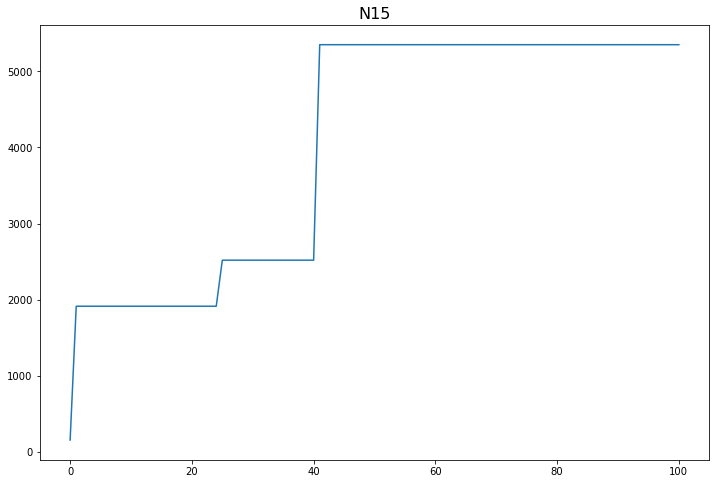

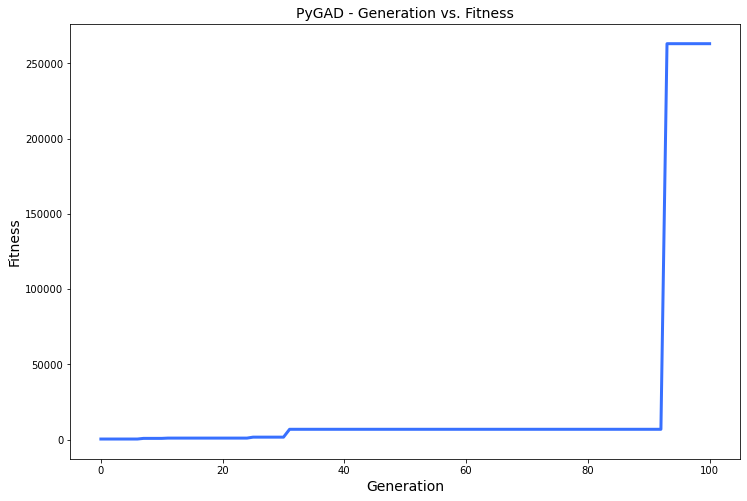

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.534 |===========| 27.119 |==================| 7.46 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.931 |===========| 27.016 |==================| 4.217 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.358 |===========| 27.164 |==================| 11.186 |==========| N16 |==========
**********************************************************************
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========|NODE|==========
======| 0.925 |===========| 27.018 |==================| 4.243 |==========| N16 |==========
**********************************************************************


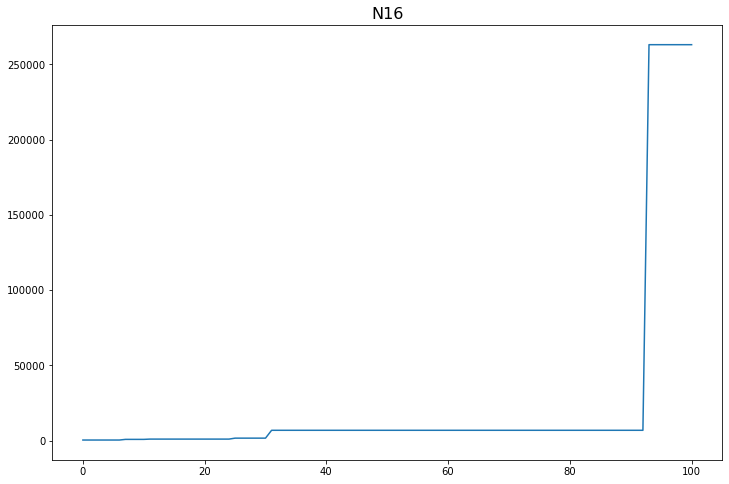

In [14]:
for index, val in enumerate(model_nodes):
    ga_instance = pygad.GA(num_generations=water_model.num_generations,
                       num_parents_mating=water_model.num_parents_mating, 
                       fitness_func=fitness_function, 
                       sol_per_pop=water_model.sol_per_pop,
                       num_genes=water_model.num_genes,
                       init_range_low=water_model.init_range_low,
                       init_range_high=water_model.init_range_high,
                       parent_selection_type=water_model.parent_selection_type,
                       keep_parents=water_model.keep_parents,
                       crossover_type=water_model.crossover_type,
                       mutation_type=water_model.mutation_type,
                       mutation_num_genes=water_model.mutation_num_genes,
                       callback_generation=callback_generation)
    
    water_model = WaterLeakModel(node=wn.junction_name_list[index])
    
    if water_model.node in choosen_nodes_for_leak:
        water_model.run(plot_graph=False) # Check if node is our choosen node and add leak
    else:
        wn = wntr.network.WaterNetworkModel(water_model.inp_file_path)
        result = water_model.simulate(wn,plot_graph=False)
        water_model.function_inputs = 0.5
        water_model.desired_output = result.node['pressure'].loc[:,water_model.node][0]
        
    current_node = model_nodes[index]
    
    # Running the GA to optimize the parameters of the function.
    ga_instance.run()
    
    # After the generations complete, some plots are shown that summarize how the outputs/fitenss values evolve over generations.
    ga_instance.plot_result()
    
    # Returning the details of the best solution.
    solution, solution_fitness, solution_idx = ga_instance.best_solution()
    print("Parameters of the best solution :{solution}".format(solution=solution))
    print("Fitness value of the best solution ={solution_fitness}".format(solution_fitness=solution_fitness))
    print("Index of the best solution :{solution_idx}".format(solution_idx=solution_idx))
    
    prediction = numpy.sum(numpy.array(water_model.function_inputs)*solution)
    print("Predicted output based on the best solution :{prediction}".format(prediction=prediction))
          
    if ga_instance.best_solution_generation != -1:
        print("Best fitness value reached after {best_solution_generation} generations.".format(best_solution_generation=ga_instance.best_solution_generation))
    
    # Saving the GA instance.
    filename = 'genetic' # The filename to which the instance is saved. The  name is without extension.
    ga_instance.save(filename=filename)
    
    # Loading the saved GA instance.
    loaded_ga_instance = pygad.load(filename=filename)
    plt.plot(loaded_ga_instance.best_solutions_fitness)
    plt.title(model_nodes[index],fontsize=16)

    fitness_name = "/Fitness_" + val
    plt.savefig(water_model.plots_dir+fitness_name, dpi=150)

In [15]:
# Check solution for confirmation
wn = wntr.network.WaterNetworkModel(water_model.inp_file_path)
results = water_model.change_discharge_coefficient(wn, emitter_value=abs(solution[0]*0.5))

pressure = results.node['pressure']
presssure = pressure.loc[:,water_model.node]
print(presssure)

0    27.253191
Name: N16, dtype: float64


In [16]:
# Check the model's prediction
prediction = numpy.sum(numpy.array(water_model.function_inputs)*solution)
print("Predicted output based on the best solution :{prediction}".format(prediction=prediction))

if ga_instance.best_solution_generation != -1:
    print("Best fitness value reached after {best_solution_generation} generations.".format(best_solution_generation=ga_instance.best_solution_generation))

Predicted output based on the best solution :5.6885942482653995e-06
Best fitness value reached after 93 generations.


In [43]:
directories = os.listdir('../leak_location_results/add_leak_node2/each-node-optimization-results-csvs-new/')
directories

['solutions_for_N6',
 'solutions_for_N1',
 'solutions_for_N8',
 'solutions_for_N9',
 'solutions_for_N7',
 'solutions_for_N10',
 'solutions_for_N11',
 'solutions_for_N16',
 'solutions_for_N2',
 'solutions_for_N5',
 'solutions_for_N4',
 'solutions_for_N3',
 'solutions_for_N13',
 'solutions_for_N14',
 'solutions_for_N15',
 'solutions_for_N12']

In [44]:
for sol in range(len(directories)):
    fitness_solution_per_population = glob.glob(os.path.join('../leak_location_results/add_leak_node2/each-node-optimization-results-csvs-new',directories[sol],'FITNESS_SOLUTION_N*'))
    water_model.export_results(solutions = fitness_solution_per_population, path=water_model.merged_result, name='merged-optimization-result-per-fitness_'+directories[sol].lower())

File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-fitness_solutions_for_n6.csv
File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-fitness_solutions_for_n1.csv
File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-fitness_solutions_for_n8.csv
File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-fitness_solutions_for_n9.csv
File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-fitness_solutions_for_n7.csv
File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-fitness_solutions_for_n10.csv
File Exported Successfully to path: ../leak_location_results/add_leak

In [42]:
water_model.merged_result

'../leak_location_results/add_leak_node2/merged_results-new'

In [45]:
# Merged all merged solutions into one csv file
merged_solution_results = glob.glob(water_model.merged_result+'/merged-optimization-result-per-*')
water_model.export_results(solutions = merged_solution_results, path=water_model.merged_result, name='super-merged-solution')

File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/super-merged-solution.csv


In [46]:
merged_solution_results_data = pd.read_csv(water_model.merged_result+'/super-merged-solution.csv')

In [47]:
merged_solution_results_data

,EMITTER_COEFFICIENT_SOLUTION,PRESSURE_OUTPUT,OUTPUT_DEMAND,FITNESS,NODE
0,0.188506,25.102224,23.0,17.536733,N8
1,0.577872,24.983503,23.0,5.690101,N8
2,0.961998,24.865173,23.0,3.400507,N8
3,0.310791,25.065073,23.0,10.618705,N8
4,0.830431,24.905835,23.0,3.946141,N8
...,...,...,...,...,...
30715,0.673702,23.989169,13.0,29.004185,N5
30716,0.054151,24.020893,13.0,363.115851,N5
30717,0.495022,23.998361,13.0,39.547764,N5
30718,0.220388,24.012421,13.0,89.085835,N5


In [48]:
merged_solution_results_data = merged_solution_results_data.sort_values(by='FITNESS', ascending=True)
merged_solution_results_data

,EMITTER_COEFFICIENT_SOLUTION,PRESSURE_OUTPUT,OUTPUT_DEMAND,FITNESS,NODE
13900,0.002374,23.848460,1.5,0.824700,N14
14894,0.999639,23.852384,1.5,0.827378,N14
14600,0.998284,23.854327,1.5,0.828709,N14
15178,0.997532,23.855406,1.5,0.829451,N14
13749,0.997208,23.855870,1.5,0.829771,N14
...,...,...,...,...,...
30384,0.000114,24.023640,13.0,147606.953863,N5
22013,0.000029,27.085023,1.1,151971.708731,N3
18240,0.000341,9.370606,1.0,158443.540480,N1
16434,0.000011,27.253191,1.1,263038.824176,N16


In [49]:
# merge fitness across generations for each node
directories = os.listdir('../leak_location_results/add_leak_node2/each-node-optimization-results-csvs-new')
for sol in range(len(directories)):
    fitness_solution_per_generation = glob.glob(os.path.join('../leak_location_results/add_leak_node2/each-node-optimization-results-csvs-new',directories[sol],'GENERATION_*'))
    water_model.export_results(solutions = fitness_solution_per_generation, path=water_model.merged_result, name='merged-optimization-result-per-generation_'+directories[sol].lower())

File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-generation_solutions_for_n6.csv
File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-generation_solutions_for_n1.csv
File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-generation_solutions_for_n8.csv
File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-generation_solutions_for_n9.csv
File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-generation_solutions_for_n7.csv
File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/merged-optimization-result-per-generation_solutions_for_n10.csv
File Exported Successfully to path: ../leak_locatio

In [50]:
# Merged all merged generation into one csv file
merged_generation_results = glob.glob(water_model.merged_result+'/merged-optimization-result-per-generation_*')
water_model.export_results(solutions = merged_generation_results, path=water_model.merged_result, name='super-merged-generation')

File Exported Successfully to path: ../leak_location_results/add_leak_node2/merged_results-new/super-merged-generation.csv


In [51]:
merged_generation_results = pd.read_csv(water_model.merged_result+'/super-merged-generation.csv')
merged_generation_results = merged_generation_results.sort_values(by='NODE', ascending=True)
merged_generation_results

,GENERATION,FITNESS,NODE
200,87,481888.822129,N1
272,17,15382.194394,N1
271,15,10253.427504,N1
270,29,35549.140232,N1
269,28,35549.140232,N1
...,...,...,...
1128,83,28111.581722,N9
1127,95,28111.581722,N9
1126,81,28111.581722,N9
1124,42,3038.446612,N9


In [52]:
# merge the solution per generation and solution
final_data = pd.merge(merged_solution_results_data,merged_generation_results, how='outer',left_on='FITNESS',right_on='FITNESS')
final_data

,EMITTER_COEFFICIENT_SOLUTION,PRESSURE_OUTPUT,OUTPUT_DEMAND,FITNESS,NODE_x,GENERATION,NODE_y
0,0.002374,23.848460,1.5,0.824700,N14,NaN,NaN
1,0.999639,23.852384,1.5,0.827378,N14,NaN,NaN
2,0.998284,23.854327,1.5,0.828709,N14,NaN,NaN
3,0.997532,23.855406,1.5,0.829451,N14,NaN,NaN
4,0.997208,23.855870,1.5,0.829771,N14,NaN,NaN
...,...,...,...,...,...,...,...
32246,NaN,NaN,NaN,28111.581722,NaN,83.0,N9
32247,NaN,NaN,NaN,28111.581722,NaN,95.0,N9
32248,NaN,NaN,NaN,28111.581722,NaN,81.0,N9
32249,NaN,NaN,NaN,28111.581722,NaN,100.0,N9


In [53]:
# sort the node fitness to get the highest fitting node, from highest to lowest
grouped_data=final_data.groupby(['NODE_x'],sort=True)['FITNESS'].max()
grouped_data=grouped_data.to_frame().sort_values('FITNESS',ascending=False)
grouped_data

,FITNESS
NODE_x,
N1,481888.822129
N16,263038.824176
N3,151971.708731
N5,147606.953863
N4,91493.675538
N10,33382.331340
N9,28111.581725
N6,22294.133446
N2,13569.874969


In [54]:
highest_fitted_node=grouped_data.index[grouped_data['FITNESS'] == max(grouped_data['FITNESS'])].to_list()[0]
print(highest_fitted_node, 'has the highest fitness in the network')

N1 has the highest fitness in the network


In [55]:
generation_=merged_generation_results[merged_generation_results['NODE']==highest_fitted_node] 
generation_=generation_.sort_values(by='FITNESS',ascending=True)
generation_

,GENERATION,FITNESS,NODE
237,1,940.603340,N1
226,3,4054.861199,N1
206,4,4054.861199,N1
295,9,4054.861199,N1
296,8,4054.861199,N1
...,...,...,...
286,88,481888.822129,N1
201,93,481888.822129,N1
221,91,481888.822129,N1
285,98,481888.822129,N1


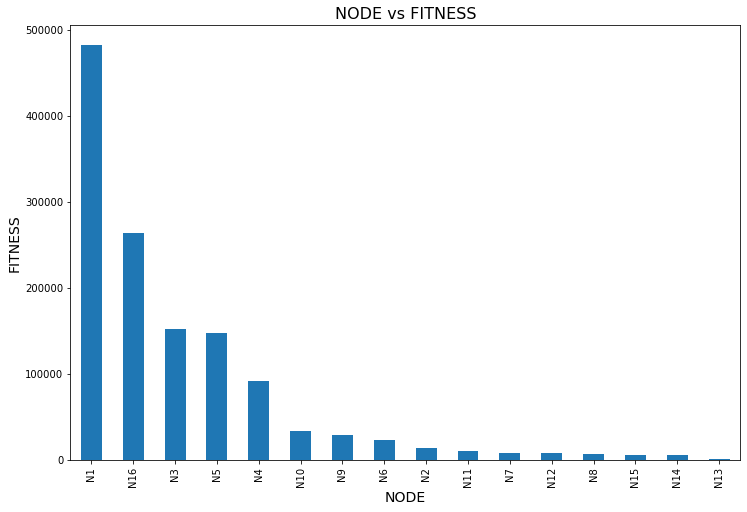

In [56]:
grouped_data['FITNESS'].plot(kind='bar')
plt.xlabel('NODE',fontsize=14) 
plt.ylabel('FITNESS',fontsize=14) 
plt.title('NODE vs FITNESS',fontsize=16) 
plt.show();
plt.savefig(water_model.plots_dir+"/node_with_best_fitness.png") 
plt.close()

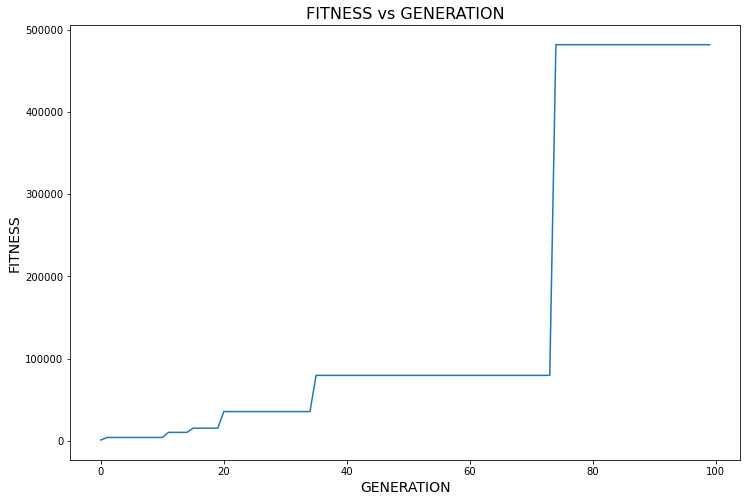

In [57]:
plt.plot(list(range(len(generation_))),generation_['FITNESS']) 
plt.xlabel('GENERATION',fontsize=14)  
plt.ylabel('FITNESS',fontsize=14)
plt.title('FITNESS vs GENERATION',fontsize=16) 
plt.savefig(water_model.plots_dir+"/FITNESS_vs_GENERATION.png") 
plt.show();

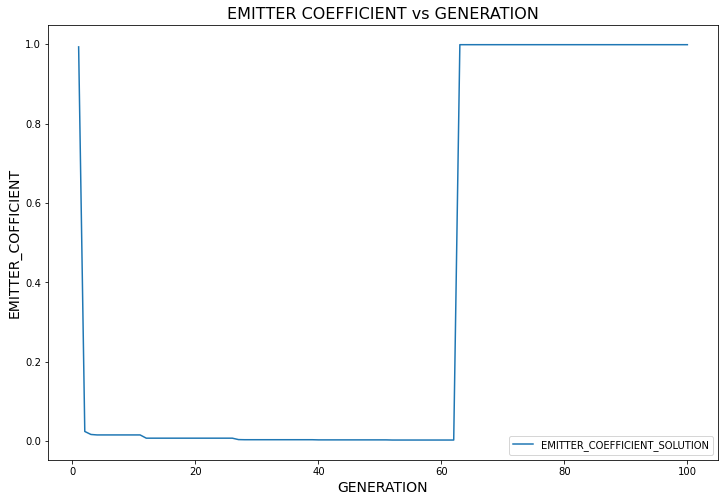

In [58]:
final_data.groupby(['GENERATION'])['EMITTER_COEFFICIENT_SOLUTION'].max().to_frame().plot()
plt.xlabel('GENERATION',fontsize=14)
plt.ylabel('EMITTER_COFFICIENT',fontsize=14)
plt.title('EMITTER COEFFICIENT vs GENERATION',fontsize=16)
plt.show();
plt.savefig(f"{water_model.plots_dir}/EMITTER_COEFFICIENT.png");
plt.close()

In [59]:
# final_data.groupby(['NODE_x'])['EMITTER_COEFFICIENT_SOLUTION'].min().to_frame().plot(kind='bar')
# plt.xlabel('NODE',fontsize=14)
# plt.ylabel('EMITTER_COFFICIENT',fontsize=14)
# plt.title('EMITTER COEFFICIENT vs NODE',fontsize=16)
# plt.show();
# plt.savefig(f"{water_model.plots_dir}/EMITTER_COEFFICIENT_vs_NODE.png");
# plt.close()

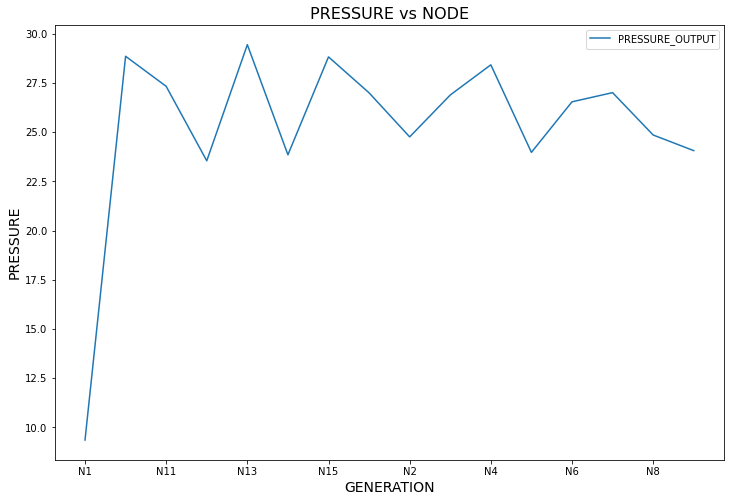

In [60]:
final_data.groupby(['NODE_x'])['PRESSURE_OUTPUT'].min().to_frame().plot()
plt.xlabel('GENERATION',fontsize=14)
plt.ylabel('PRESSURE',fontsize=14)
plt.title('PRESSURE vs NODE',fontsize=16)
plt.show();
plt.savefig(f"{water_model.plots_dir}/PRESSURE_vs_NODE.png");
plt.close()

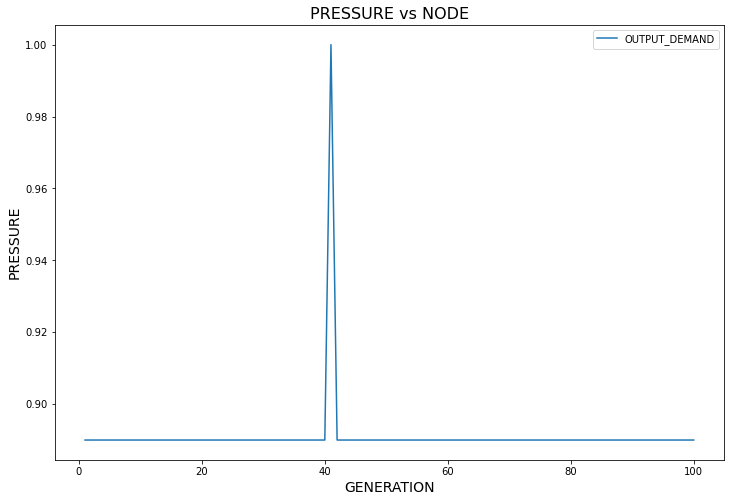

In [61]:
final_data.groupby(['GENERATION'])['OUTPUT_DEMAND'].min().to_frame().plot()
plt.xlabel('GENERATION',fontsize=14)
plt.ylabel('PRESSURE',fontsize=14)
plt.title('PRESSURE vs NODE',fontsize=16)
plt.show();
plt.savefig(f"{water_model.plots_dir}/PRESSURE_vs_NODE.png");
plt.close()

## Visualize the Rest of the Fitness for other nodes as well

In [ ]:
# water_model.plots_dir = 'each-node-optimization-plots'

In [ ]:
# # Fitness across all nodes
# fitness_plots = [os.path.join(water_model.plots_dir,file) \
#                  for file in os.listdir(water_model.plots_dir) \
#                  if file.endswith('.png') or file.endswith('.jpg')]
# fitness_plots

In [ ]:
# plt.rcParams['figure.figsize'] = (10,7)

In [ ]:
# # subplot 16 images
# i = 4
# j = 0

# for _ in range(len(fitness_plots)//4):
#     fig, axs = plt.subplots(2, 2, figsize=(20,20), constrained_layout = True)
#     axs = axs.ravel()

#     for index, val in enumerate(fitness_plots[j:i]):
#         img = plt.imread(val)
#         axs[index].imshow(img)
#         axs[index].axis('off')
#     fig.suptitle('Solution Across Nodes - Post Optimization', fontsize=16)
#     plt.savefig(water_model.plots_dir+str(f'/fitness/Fitness_group_{j}.png'))
#     plt.subplots_adjust(left=0, bottom=0, right=None, top=None, wspace=None, hspace=None)
#     j=i
#     i+=4
        
